# Load the dataset and separate out the training and test data sets

In [1]:
# point to the appropriate directory containing the dataset split into train/val/test
import os
os.chdir ('/home/karthiksankar2/Desktop/CompoundDiversification/DataSplit')

In [3]:
import pandas as pd
data = pd.read_csv ('dataset_input.csv', index_col = 0)
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 464161 entries, 0 to 479034
Data columns (total 8 columns):
Reaction SMILES                       464161 non-null object
reactionID                            464161 non-null int64
react_smiles                          464161 non-null object
rxn_smiles                            464161 non-null object
template                              464161 non-null object
Template Verification (True/False)    464161 non-null bool
dataset                               464161 non-null object
str_Reaction_Partner                  464161 non-null object
dtypes: bool(1), int64(1), object(6)
memory usage: 28.8+ MB


In [4]:
# convert str_Reaction_Partner into a list
from ast import literal_eval

#convert the string in the dataframe into list (result of storing the dataframe as csv!)
data['Reaction Partner (s)'] =  data.str_Reaction_Partner.apply(lambda x: literal_eval(str(x)))

#drop the string column str_Reaction_Partner
data.drop(columns = ['str_Reaction_Partner'], inplace = True)

data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 464161 entries, 0 to 479034
Data columns (total 8 columns):
Reaction SMILES                       464161 non-null object
reactionID                            464161 non-null int64
react_smiles                          464161 non-null object
rxn_smiles                            464161 non-null object
template                              464161 non-null object
Template Verification (True/False)    464161 non-null bool
dataset                               464161 non-null object
Reaction Partner (s)                  464161 non-null object
dtypes: bool(1), int64(1), object(6)
memory usage: 28.8+ MB


In [5]:
datasub = data[data['dataset']== 'train']

In [6]:
datasub_val = data[data['dataset']== 'test']

# Add fingerprint information to training and validation data sets

In [7]:
# import all necessary packages
import rdkit.Chem as Chem
import rdkit.Chem.AllChem as AllChem
from rdkit import DataStructs

# Set up fingerprinting of molecules, this is the final fingerprint decided after hyperparameter optimization
getfp = lambda smi: AllChem.GetMorganFingerprint(Chem.MolFromSmiles(smi),2, useFeatures=True)

# Set up similarity label, this is the final similarity label decided after hyperparameter optimization
similarity_metric = DataStructs.BulkTanimotoSimilarity

RDKit WARNING: [11:50:36] Enabling RDKit 2019.09.3 jupyter extensions


In [8]:
# Gets Morgan Fingerprints for all products
all_fps = []

for smi in datasub['react_smiles']:
    all_fps.append(getfp(smi))

#Append the fingerprints of all products
datasub['react_fp'] = all_fps

/home/karthiksankar2/anaconda3/envs/my-rdkit-env/lib/python3.7/site-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [9]:
# Gets Morgan Fingerprints for all products
all_fps = []

for smi in datasub_val ['react_smiles']:
    all_fps.append(getfp(smi))

#Append the fingerprints of all products
datasub_val ['react_fp'] = all_fps

/home/karthiksankar2/anaconda3/envs/my-rdkit-env/lib/python3.7/site-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


# Diversification and fastfilter computations

In [10]:
import sys 
import os
import re
import copy
import numpy as np
import rdkit.Chem as Chem
import rdkit.Chem.AllChem as AllChem
from rdkit.Chem.rdchem import ChiralType, BondType, BondDir
from rdchiral.utils import vprint, PLEVEL, atoms_are_different
from rdchiral.initialization import rdchiralReaction, rdchiralReactants
from rdchiral.chiral import template_atom_could_have_been_tetra, copy_chirality,\
    atom_chirality_matches
from rdchiral.clean import canonicalize_outcome_smiles, combine_enantiomers_into_racemic
from rdchiral.bonds import BondDirOpposite, restore_bond_stereo_to_sp2_atom
from rdchiral.template_extractor import extract_from_reaction
from rdchiral.main import rdchiralRun

### Drawing tools

In [11]:
from rdkit.Chem.Draw import rdMolDraw2D

from IPython.display import SVG

from rdkit.Chem import rdChemReactions

def draw_rxn(rxn, unmap=True, width=800, height=200):
    if unmap:
        for mol in rxn.GetReactants():
            [a.SetAtomMapNum(0) for a in mol.GetAtoms()]
        for mol in rxn.GetProducts():
            [a.SetAtomMapNum(0) for a in mol.GetAtoms()]
    drawer = rdMolDraw2D.MolDraw2DSVG(width, height)
    drawer.DrawReaction(rxn)
    drawer.FinishDrawing()
    svg = drawer.GetDrawingText().replace('svg:', '')
    display(SVG(svg))

def draw_rxn_smi(rxn_smi, unmap=True, width=800, height=200):
    rxn = AllChem.ReactionFromSmarts(rxn_smi, useSmiles=True)
    draw_rxn(rxn, unmap=unmap, width=width, height=height)

### Fast filter tools

In [12]:
from api_client import APIClient

hostname = 'https://askcos-demo.mit.edu'
client = APIClient(hostname, verify=False)  # verify=True also works for askcos-demo since we have a valid certificate
client.client.auth = ('askcos', 'MML4chem')

### Diverisification module
This will take the index associated with the test set as input. It will use fastfilter to evaluate reaction feasibility. Setting draw = True will draw out the suggestions. Setting debug = True will print the output out in text format. Setting result_print = True will print out the information that will go into the pandas dataframe. Setting coupling_partner_figure = True can help in making figures.

In [13]:
#jx_cache = {} #jx_cache is a dictionary
draw = True            
debug = False
result_print = False
coupling_partner_figure = False

def do_one_v4 (ix, draw=draw, debug=debug, max_prec=100, testlimit = 100, result_print = result_print):
    
    #get reactant smiles
    react_smiles = []
    react_smiles.append (datasub_val ['react_smiles'][ix])
    
    # for the moment, it is just an empty string
    rec_for_printing = '' 
    
    #loads reactant SMILES into RDKit object
    ex = Chem.MolFromSmiles(datasub_val ['react_smiles'][ix]) 
    
    #loads reactant SMILES into RDChiral object
    rct = rdchiralReactants(datasub_val ['react_smiles'][ix])
    
    #if Draw = True, then Print Mol {Index}
    if draw:
        print ('Mol {}, reactant input:'.format(ix))
        display (ex)
        
    #if Debug = True, then Print {Product SMILES} + go to new line +
    # True reaction: {reaction smiles}
    
    if debug:
        rec_for_printing += 'Desired Reactant:' + '\n'
        rec_for_printing += datasub_val ['react_smiles'][ix] + '\n'
        rec_for_printing += 'True reaction:' + '\n'
        rec_for_printing += datasub_val ['rxn_smiles'] [ix] + '\n'
        
  
    #get the fingerprint of the product
    fp = datasub_val['react_fp'][ix]
    
    #calculates similarity metric between fingerprint 
    # and all fingerprints in the database
    sims = similarity_metric (fp, [fp_ for fp_ in datasub['react_fp']])
    
    #sort the similarity metric in reverse order
    js = np.argsort(sims) [::-1]
    
    #draw the reaction smiles out
    if draw:
        print ('Desired Reaction:')
        draw_rxn_smi (datasub_val['rxn_smiles'][ix])
    
    #get the product goal from the reaction smiles string
    prod_goal = Chem.MolFromSmiles (datasub_val['rxn_smiles'][ix].split('>')[2])
    [a.ClearProp('molAtomMapNumber') for a in prod_goal.GetAtoms()]
    prod_goal = Chem.MolToSmiles(prod_goal, True)
    
    #sometimes stereochem takes another canonicalization
    prod_goal = Chem.MolToSmiles(Chem.MolFromSmiles(prod_goal), True)
    
    #print out the product goal
    if debug:
        rec_for_printing += 'prod_goal: {}\n'.format(prod_goal)
    
    #draw out the product
    if draw:
        print ('Desired Product:')
        display (Chem.MolFromSmiles (prod_goal))
    
    # Get probability of precursors
    probs = {}
    coreact = {}
    
    for ji,j in enumerate (js[:max_prec]):
        
        #get the index in the similarity search
        jx = datasub.index[j]
        
        #draw out the most similar reactions
        if draw: 
            print('\n\n'+'-'*50+'\n')
            print ('Train index: {}'.format (jx))
            print ('RANK {} PRECEDENT'.format(ji+1))
            print ('REACTANT MATCH SCORE: {}'.format(sims[j]))
            draw_rxn_smi (datasub['rxn_smiles'][jx])
        
        #debug statement- Reaction precedent rank, similarity score, and reaction smiles addition!
        if debug:
            rec_for_printing += '\nReaction precedent {}, prod similarity {}\n'.format(ji+1, sims[j])
            rec_for_printing += '-> rxn_smiles {}\n'.format(datasub['rxn_smiles'][jx])
        
        try:  
            #extract the template
            template = datasub['template'][jx]

            #get product reference fingerprint
            prods_ref_fp = getfp(datasub['rxn_smiles'][jx].split('>')[2])

            #load the reaction into an rdchiral object
            rxn = rdchiralReaction(template)

            #save it to the cache
            #jx_cache[jx] = (rxn, template, prods_ref_fp)

            #debug statement- print the reaction template and index
            if debug:
                rec_for_printing += '-> template: {}\n'.format(template)
                rec_for_printing += '-> jx/ index: {}\n'.format(jx)

            #draw: draw out the template
            if draw:
                print('-> template: {}'.format(template))
                rxn_for_display = rdChemReactions.ReactionFromSmarts(template)
                display (rxn_for_display)

        except:

            if debug:
                rec_for_printing += '-> Template extraction failed! \n'

            if draw:
                print ('-> Template extraction failed!')

            #if it fails, move to the next reaction
            continue 

        try:
            # try running the rdchiral reaction
            outcomes = rdchiralRun (rxn, rct, combine_enantiomers=False)
        
        #if running the rdchiral reaction is not possible go into this exception routine
        except Exception as e:
            print(e)
            outcomes = []
            continue
        
        #if you are unable to generate outcomes and draw -> print an error message
        if not outcomes and draw:
            print('->No precursors could be generated!')
            
        #if you are unable to generate outcomes and debug -> print an error message
        if not outcomes and debug:
            rec_for_printing += '-> Template application failed! \n'
            
        for products in outcomes:
            
            #proposed product fingerprint
            products_fp = getfp(products)
            
            #compare proposed and precedent product fp
            products_sim = similarity_metric(products_fp, [prods_ref_fp])[0]
            
            #debug statement
            if debug:
                rec_for_printing += 'prod sim {}, overall {}, smiles {}\n'.format(products_sim, products_sim*sims[j], products)
            
            #draw statement
            if draw:
                print('Product similarity {}, overall {}, smiles {}'.format(
                    products_sim, products_sim*sims[j], products))
                display(Chem.MolFromSmiles(products))
                
            #assemble the reaction
            rxn_to_print = ''

            #add core reactant
            rxn_to_print += datasub_val ['react_smiles'][ix]

            #add coreactants
            coreactants_draw = datasub ['Reaction Partner (s)'][jx]
            for reactant in coreactants_draw:
                rxn_to_print += '.' + reactant

            #add products
            rxn_to_print += '>>' + products
                  
            #compute fast filter scores
            endpoint = 'fast-filter'
            allreactants_ff,allproducts_ff = rxn_to_print.split ('>>')
            input_ff = {
                        'reactants': allreactants_ff,
                        'products' : allproducts_ff
                        }
            result = client.post (endpoint, input_ff)
            tid = result ['task_id']
            task_result = client.get_result (tid, timeout = 600, interval = 5)
                
            if draw:
                #display the reaction
                print ('The proposed reaction is:')
                draw_rxn_smi(rxn_to_print)
                print ('The reaction SMILES string is: {}'.format (rxn_to_print))
                print ('The fast filter score is {}'.format (task_result['output']))
                
                
            if products in probs:
                if (products_sim*sims[j]) > probs[products][0]:
                    probs[products] = [products_sim*sims[j],task_result['output']]
                    coreact[products] = datasub ['Reaction Partner (s)'][jx]
            else:
                probs[products] = [products_sim*sims[j],task_result['output']]
                coreact[products] = datasub ['Reaction Partner (s)'][jx]
    
    found_rank = 9999
    
    sim_to_idealProdPrevious = -1
    
    #convert prod_goal to its fingerprint
    prod_goal_fp = getfp(prod_goal)

        
    for r, (prod, prob) in enumerate(sorted(probs.items(), key=lambda x:x[1], reverse=True)[:testlimit]):         
        
        #convert prod to its fingeprint
        prod_fp = getfp (prod)
        
        #compute similarity to ideal product
        sim_to_idealProd = similarity_metric (prod_fp, [prod_goal_fp])[0]
        
        if coupling_partner_figure and r == 0:
            print ('Desired Reaction (in test set): {}'.format (datasub_val['Reaction SMILES'][ix]))
            draw_rxn_smi (datasub_val['rxn_smiles'][ix])
                        
        if coupling_partner_figure:
            print('\n\n'+'-'*50+'\n')
            print ('The Product SMILES is: {}'.format (prod))
            display (Chem.MolFromSmiles (prod))
            print ('The overall similarity score is: {}'. format (prob[0]))
            print ('The fast filter score is: {}'. format (prob[1]))
            for reactant in coreact[prod]:
                print ('The coupling partner is {}'.format (reactant))
                display (Chem.MolFromSmiles (reactant))
        
        if sim_to_idealProd > sim_to_idealProdPrevious:
            sim_to_idealProdPrevious = sim_to_idealProd
            found_rank = r + 1
            recoveredProduct = prod
            coreactant = coreact[prod]
    
    #get reactant fingerprint
    reactant_fp = getfp(datasub_val ['react_smiles'][ix])
    sim_reactant_to_idealProd = similarity_metric (reactant_fp, [prod_goal_fp])[0]
    
    #assemble the reaction
    return_rxn = ''
    
    return_rxn += datasub_val ['react_smiles'][ix]
    

                
    for reactant in coreactant:
        return_rxn += '.' + reactant
    
    return_rxn += '>>' + recoveredProduct
    
    if debug:
        print(rec_for_printing)
        
    if result_print:
        print ('******RESULTS******')
        print ('Mol {}, reactant input:'.format(ix))
        display (ex)
        print ('Desired Reaction:')
        draw_rxn_smi (datasub_val['rxn_smiles'][ix])
        print ('Desired Product:')
        display (Chem.MolFromSmiles (prod_goal))
        print ('Identified Product:')
        display (Chem.MolFromSmiles (recoveredProduct))
        print ('Rank: {}'.format (found_rank))
        print ('Similarity of proposed product to ideal product: {}'.format (sim_to_idealProdPrevious))
        print ('Similarity of original reactant to ideal product: {}'. format (sim_reactant_to_idealProd))
    
    if sim_to_idealProdPrevious <= sim_reactant_to_idealProd:
        found_rank = 9999
        return_rxn = 9999

    return (found_rank, return_rxn, sim_to_idealProdPrevious, sim_reactant_to_idealProd)

### DIversification module (without fastfilter)
This will take the index associated with the test set as input. For speed, it doesn't use fastfilter to evaluate reaction feasibility. Setting draw = True will draw out the suggestions. Setting debug = True will print the output out in text format. Setting result_print = True will print out the information that will go into the pandas dataframe. Setting coupling_partner_figure = True can help in making figures (it will explicity draw out the reaction partners associated with the template and provide their SMILES string).

In [14]:
#jx_cache = {} #jx_cache is a dictionary
draw = True            
debug = False
result_print = False
coupling_partner_figure = False

def do_one_v4_woFastFilter (ix, draw=draw, debug=debug, max_prec=200, testlimit = 200, result_print = result_print):
    
    #get reactant smiles
    react_smiles = []
    react_smiles.append (datasub_val ['react_smiles'][ix])
    
    # for the moment, it is just an empty string
    rec_for_printing = '' 
    
    #loads reactant SMILES into RDKit object
    ex = Chem.MolFromSmiles(datasub_val ['react_smiles'][ix]) 
    
    #loads reactant SMILES into RDChiral object
    rct = rdchiralReactants(datasub_val ['react_smiles'][ix])
    
    #if Draw = True, then Print Mol {Index}
    if draw:
        print ('Mol {}, reactant input:'.format(ix))
        display (ex)
        
    #if Debug = True, then Print {Product SMILES} + go to new line +
    # True reaction: {reaction smiles}
    
    if debug:
        rec_for_printing += 'Desired Reactant:' + '\n'
        rec_for_printing += datasub_val ['react_smiles'][ix] + '\n'
        rec_for_printing += 'True reaction:' + '\n'
        rec_for_printing += datasub_val ['rxn_smiles'] [ix] + '\n'
        
  
    #get the fingerprint of the product
    fp = datasub_val['react_fp'][ix]
    
    #calculates similarity metric between fingerprint 
    # and all fingerprints in the database
    sims = similarity_metric (fp, [fp_ for fp_ in datasub['react_fp']])
    
    #sort the similarity metric in reverse order
    js = np.argsort(sims) [::-1]
    
    #draw the reaction smiles out
    if draw:
        print ('Desired Reaction:')
        draw_rxn_smi (datasub_val['rxn_smiles'][ix])
    
    #get the product goal from the reaction smiles string
    prod_goal = Chem.MolFromSmiles (datasub_val['rxn_smiles'][ix].split('>')[2])
    [a.ClearProp('molAtomMapNumber') for a in prod_goal.GetAtoms()]
    prod_goal = Chem.MolToSmiles(prod_goal, True)
    
    #sometimes stereochem takes another canonicalization
    prod_goal = Chem.MolToSmiles(Chem.MolFromSmiles(prod_goal), True)
    
    #print out the product goal
    if debug:
        rec_for_printing += 'prod_goal: {}\n'.format(prod_goal)
    
    #draw out the product
    if draw:
        print ('Desired Product:')
        display (Chem.MolFromSmiles (prod_goal))
    
    # Get probability of precursors
    probs = {}
    coreact = {}
    
    for ji,j in enumerate (js[:max_prec]):
        
        #get the index in the similarity search
        jx = datasub.index[j]
        
        #draw out the most similar reactions
        if draw: 
            print('\n\n'+'-'*50+'\n')
            print ('Train index: {}'.format (jx))
            print ('RANK {} PRECEDENT'.format(ji+1))
            print ('REACTANT MATCH SCORE: {}'.format(sims[j]))
            print ('Reaction SMILES (Precedent): {}'.format (datasub['rxn_smiles'][jx]))
            draw_rxn_smi (datasub['rxn_smiles'][jx])
        
        #debug statement- Reaction precedent rank, similarity score, and reaction smiles addition!
        if debug:
            rec_for_printing += '\nReaction precedent {}, prod similarity {}\n'.format(ji+1, sims[j])
            rec_for_printing += '-> rxn_smiles {}\n'.format(datasub['rxn_smiles'][jx])
        
        try:  
            #extract the template
            template = datasub['template'][jx]

            #get product reference fingerprint
            prods_ref_fp = getfp(datasub['rxn_smiles'][jx].split('>')[2])

            #load the reaction into an rdchiral object
            rxn = rdchiralReaction(template)

            #save it to the cache
            #jx_cache[jx] = (rxn, template, prods_ref_fp)

            #debug statement- print the reaction template and index
            if debug:
                rec_for_printing += '-> template: {}\n'.format(template)
                rec_for_printing += '-> jx/ index: {}\n'.format(jx)

            #draw: draw out the template
            if draw:
                print('-> template: {}'.format(template))
                rxn_for_display = rdChemReactions.ReactionFromSmarts(template)
                display (rxn_for_display)

        except:

            if debug:
                rec_for_printing += '-> Template extraction failed! \n'

            if draw:
                print ('-> Template extraction failed!')

            #if it fails, move to the next reaction
            continue 

        try:
            # try running the rdchiral reaction
            outcomes = rdchiralRun (rxn, rct, combine_enantiomers=False)
        
        #if running the rdchiral reaction is not possible go into this exception routine
        except Exception as e:
            print(e)
            outcomes = []
            continue
        
        #if you are unable to generate outcomes and draw -> print an error message
        if not outcomes and draw:
            print('->No precursors could be generated!')
            
        #if you are unable to generate outcomes and debug -> print an error message
        if not outcomes and debug:
            rec_for_printing += '-> Template application failed! \n'
            
        for products in outcomes:
            
            #proposed product fingerprint
            products_fp = getfp(products)
            
            #compare proposed and precedent product fp
            products_sim = similarity_metric(products_fp, [prods_ref_fp])[0]
            
            #debug statement
            if debug:
                rec_for_printing += 'prod sim {}, overall {}, smiles {}\n'.format(products_sim, products_sim*sims[j], products)
            
            #draw statement
            if draw:
                print('Product similarity {}, overall {}, smiles {}'.format(
                    products_sim, products_sim*sims[j], products))
                display(Chem.MolFromSmiles(products))
                
            #assemble the reaction
            rxn_to_print = ''

            #add core reactant
            rxn_to_print += datasub_val ['react_smiles'][ix]

            #add coreactants
            coreactants_draw = datasub ['Reaction Partner (s)'][jx]
            for reactant in coreactants_draw:
                rxn_to_print += '.' + reactant

            #add products
            rxn_to_print += '>>' + products
                  
                
            if draw:
                #display the reaction
                print ('The proposed reaction is:')
                draw_rxn_smi(rxn_to_print)
                print ('The reaction SMILES string is: {}'.format (rxn_to_print))
                
                
            if products in probs:
                if (products_sim*sims[j]) > probs[products][0]:
                    probs[products] = [products_sim*sims[j]]
                    coreact[products] = datasub ['Reaction Partner (s)'][jx]
            else:
                probs[products] = [products_sim*sims[j]]
                coreact[products] = datasub ['Reaction Partner (s)'][jx]
    
    found_rank = 9999
    
    sim_to_idealProdPrevious = -1
    
    #convert prod_goal to its fingerprint
    prod_goal_fp = getfp(prod_goal)

        
    for r, (prod, prob) in enumerate(sorted(probs.items(), key=lambda x:x[1], reverse=True)[:testlimit]):         
        
        #convert prod to its fingeprint
        prod_fp = getfp (prod)
        
        #compute similarity to ideal product
        sim_to_idealProd = similarity_metric (prod_fp, [prod_goal_fp])[0]
        
        if coupling_partner_figure and r == 0:
            print ('Desired Reaction (in test set): {}'.format (datasub_val['Reaction SMILES'][ix]))
            draw_rxn_smi (datasub_val['rxn_smiles'][ix])
                        
        if coupling_partner_figure:
            print('\n\n'+'-'*50+'\n')
            print ('The Product SMILES is: {}'.format (prod))
            display (Chem.MolFromSmiles (prod))
            print ('The overall similarity score is: {}'. format (prob[0]))
            for reactant in coreact[prod]:
                print ('The coupling partner is {}'.format (reactant))
                display (Chem.MolFromSmiles (reactant))
        
        if sim_to_idealProd > sim_to_idealProdPrevious:
            sim_to_idealProdPrevious = sim_to_idealProd
            found_rank = r + 1
            recoveredProduct = prod
            coreactant = coreact[prod]
    
    #get reactant fingerprint
    reactant_fp = getfp(datasub_val ['react_smiles'][ix])
    sim_reactant_to_idealProd = similarity_metric (reactant_fp, [prod_goal_fp])[0]
    
    #assemble the reaction
    return_rxn = ''
    
    return_rxn += datasub_val ['react_smiles'][ix]
    

                
    for reactant in coreactant:
        return_rxn += '.' + reactant
    
    return_rxn += '>>' + recoveredProduct
    
    if debug:
        print(rec_for_printing)
        
    if result_print:
        print ('******RESULTS******')
        print ('Mol {}, reactant input:'.format(ix))
        display (ex)
        print ('Desired Reaction:')
        draw_rxn_smi (datasub_val['rxn_smiles'][ix])
        print ('Desired Product:')
        display (Chem.MolFromSmiles (prod_goal))
        print ('Identified Product:')
        display (Chem.MolFromSmiles (recoveredProduct))
        print ('Rank: {}'.format (found_rank))
        print ('Similarity of proposed product to ideal product: {}'.format (sim_to_idealProdPrevious))
        print ('Similarity of original reactant to ideal product: {}'. format (sim_reactant_to_idealProd))
    
    if sim_to_idealProdPrevious <= sim_reactant_to_idealProd:
        found_rank = 9999
        return_rxn = 9999

    return (found_rank, return_rxn, sim_to_idealProdPrevious, sim_reactant_to_idealProd) 

### Diversification module using SMILES string
This module will take in SMILES string as input for the diversification. For speed, it doesn't use fastfilter to evaluate reaction feasibility. Setting draw = True will draw out the suggestions. Setting debug = True will print the output out in text format. Setting result_print = True will print out the information that will go into the pandas dataframe. Setting coupling_partner_figure = True can help in making figures (it will explicity draw out the reaction partners associated with the template and provide their SMILES string).

In [15]:
#jx_cache = {} #jx_cache is a dictionary
draw = True            
debug = False
result_print = False
coupling_partner_figure = False

getfp = lambda smi: AllChem.GetMorganFingerprint(Chem.MolFromSmiles(smi),2, useFeatures=True)

def do_one_v4_SMILES (smiles, draw=draw, debug=debug, max_prec=100, testlimit = 100, result_print = result_print):
    
    #get reactant smiles
    react_smiles = []
    react_smiles.append (smiles)
    
    # for the moment, it is just an empty string
    rec_for_printing = '' 
    
    #loads reactant SMILES into RDKit object
    ex = Chem.MolFromSmiles(smiles) 
    
    #loads reactant SMILES into RDChiral object
    rct = rdchiralReactants(smiles)
    
    #if Draw = True, then Print Mol {Index}
    if draw:
        print ('Reactant input:')
        display (ex)
        
    #if Debug = True, then Print {Product SMILES} + go to new line +
    # True reaction: {reaction smiles}
    
    if debug:
        rec_for_printing += 'Desired Reactant:' + '\n'
        rec_for_printing += smiles + '\n'
        
  
    #get the fingerprint of the reactant
    fp = getfp(smiles)
    
    #calculates similarity metric between fingerprint 
    # and all fingerprints in the database
    sims = similarity_metric (fp, [fp_ for fp_ in datasub['react_fp']])
    
    #sort the similarity metric in reverse order
    js = np.argsort(sims) [::-1]
    
    
    # Get probability of precursors
    probs = {}
    coreact = {}
    
    for ji,j in enumerate (js[:max_prec]):
        
        #get the index in the similarity search
        jx = datasub.index[j]
        
        #draw out the most similar reactions
        if draw: 
            print('\n\n'+'-'*50+'\n')
            print ('Train index: {}'.format (jx))
            print ('RANK {} PRECEDENT'.format(ji+1))
            print ('REACTANT MATCH SCORE: {}'.format(sims[j]))
            draw_rxn_smi (datasub['rxn_smiles'][jx])
        
        #debug statement- Reaction precedent rank, similarity score, and reaction smiles addition!
        if debug:
            rec_for_printing += '\nReaction precedent {}, prod similarity {}\n'.format(ji+1, sims[j])
            rec_for_printing += '-> rxn_smiles {}\n'.format(datasub['rxn_smiles'][jx])
        
        try:  
            #extract the template
            template = datasub['template'][jx]

            #get product reference fingerprint
            prods_ref_fp = getfp(datasub['rxn_smiles'][jx].split('>')[2])

            #load the reaction into an rdchiral object
            rxn = rdchiralReaction(template)

            #save it to the cache
            #jx_cache[jx] = (rxn, template, prods_ref_fp)

            #debug statement- print the reaction template and index
            if debug:
                rec_for_printing += '-> template: {}\n'.format(template)
                rec_for_printing += '-> jx/ index: {}\n'.format(jx)

            #draw: draw out the template
            if draw:
                print('-> template: {}'.format(template))
                rxn_for_display = rdChemReactions.ReactionFromSmarts(template)
                display (rxn_for_display)

        except:

            if debug:
                rec_for_printing += '-> Template extraction failed! \n'

            if draw:
                print ('-> Template extraction failed!')

            #if it fails, move to the next reaction
            continue 

        try:
            # try running the rdchiral reaction
            outcomes = rdchiralRun (rxn, rct, combine_enantiomers=False)
        
        #if running the rdchiral reaction is not possible go into this exception routine
        except Exception as e:
            print(e)
            outcomes = []
            continue
        
        #if you are unable to generate outcomes and draw -> print an error message
        if not outcomes and draw:
            print('->No precursors could be generated!')
            
        #if you are unable to generate outcomes and debug -> print an error message
        if not outcomes and debug:
            rec_for_printing += '-> Template application failed! \n'
            
        for products in outcomes:
            
            #proposed product fingerprint
            products_fp = getfp(products)
            
            #compare proposed and precedent product fp
            products_sim = similarity_metric(products_fp, [prods_ref_fp])[0]
            
            #debug statement
            if debug:
                rec_for_printing += 'prod sim {}, overall {}, smiles {}\n'.format(products_sim, products_sim*sims[j], products)
            
            #draw statement
            if draw:
                print('Product similarity {}, overall {}, smiles {}'.format(
                    products_sim, products_sim*sims[j], products))
                display(Chem.MolFromSmiles(products))
                
            #assemble the reaction
            rxn_to_print = ''

            #add core reactant
            rxn_to_print += smiles

            #add coreactants
            coreactants_draw = datasub ['Reaction Partner (s)'][jx]
            for reactant in coreactants_draw:
                rxn_to_print += '.' + reactant

            #add products
            rxn_to_print += '>>' + products
                  
                
            if draw:
                #display the reaction
                print ('The proposed reaction is:')
                draw_rxn_smi(rxn_to_print)
                print ('The reaction SMILES string is: {}'.format (rxn_to_print))
                
                
            if products in probs:
                if (products_sim*sims[j]) > probs[products][0]:
                    probs[products] = [products_sim*sims[j]]
                    coreact[products] = datasub ['Reaction Partner (s)'][jx]
            else:
                probs[products] = [products_sim*sims[j]]
                coreact[products] = datasub ['Reaction Partner (s)'][jx]
    
    
    return None

# A few examples ...

Mol 194874, reactant input:


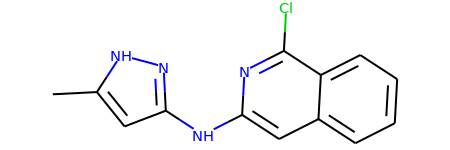

Desired Reaction:


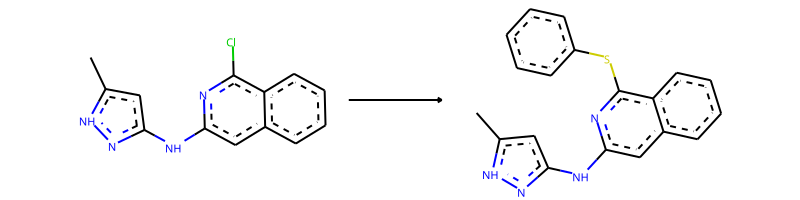

Desired Product:


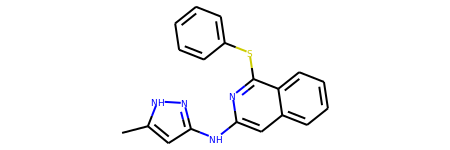



--------------------------------------------------

Train index: 33607
RANK 1 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:9]1[n:10][c:11]([NH:19][c:20]2[n:21][nH:22][c:23]([CH3:25])[cH:24]2)[cH:12][c:13]2[cH:14][cH:15][cH:16][cH:17][c:18]12>>c1ccc(O[c:9]2[n:10][c:11]([NH:19][c:20]3[n:21][nH:22][c:23]([CH3:25])[cH:24]3)[cH:12][c:13]3[cH:14][cH:15][cH:16][cH:17][c:18]23)cc1


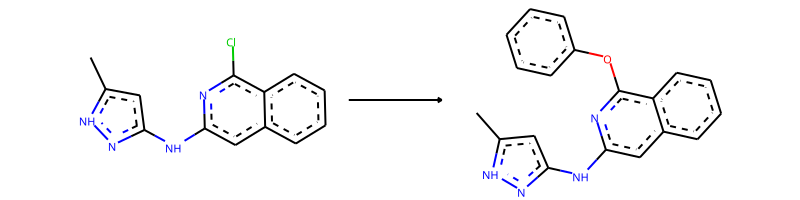

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-c1:c:c:c:c:c:1


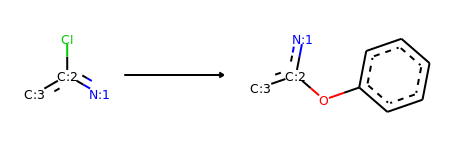

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


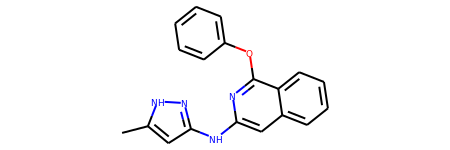

The proposed reaction is:


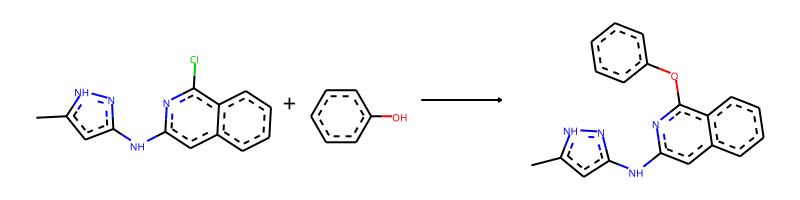

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 388873
RANK 2 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>c1cc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cs1


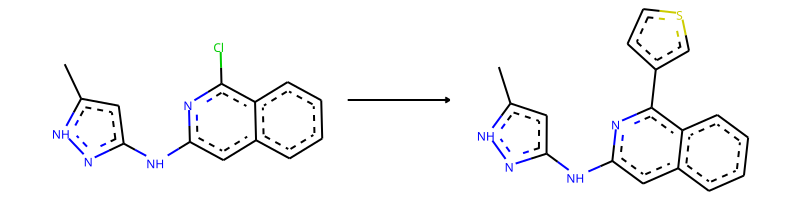

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:c:s:c:1


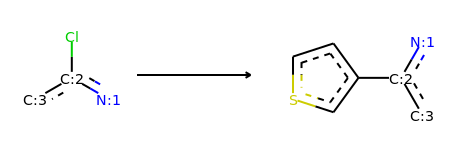

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccsc3)n2)n[nH]1


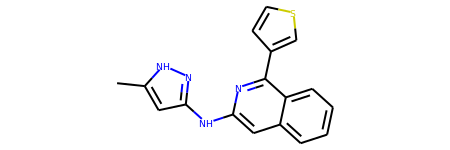

The proposed reaction is:


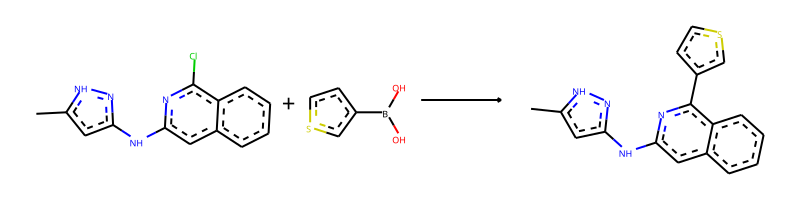

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccsc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccsc3)n2)n[nH]1


--------------------------------------------------

Train index: 164941
RANK 3 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>c1cncc(N[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)c1


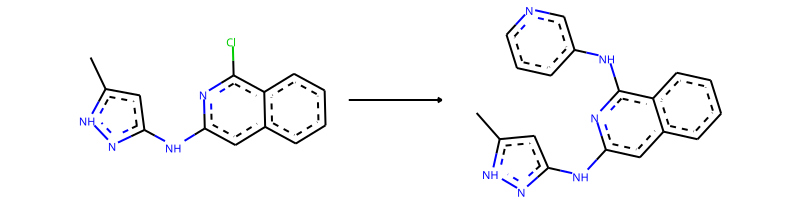

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-N-c1:c:c:c:n:c:1


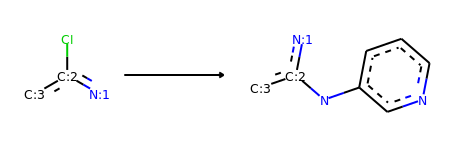

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Nc3cccnc3)n2)n[nH]1


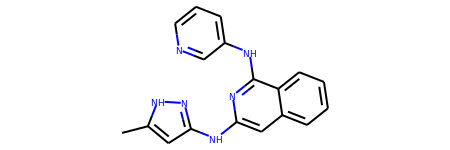

The proposed reaction is:


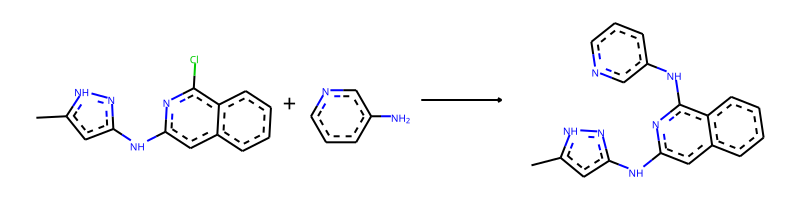

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Nc1cccnc1>>Cc1cc(Nc2cc3ccccc3c(Nc3cccnc3)n2)n[nH]1


--------------------------------------------------

Train index: 154439
RANK 4 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:13][c:14]2[cH:15][cH:16][cH:17][cH:18][c:19]12>>Clc1ccc(O[c:10]2[n:11][c:12]([NH:20][c:21]3[n:22][nH:23][c:24]([CH3:26])[cH:25]3)[cH:13][c:14]3[cH:15][cH:16][cH:17][cH:18][c:19]23)cc1


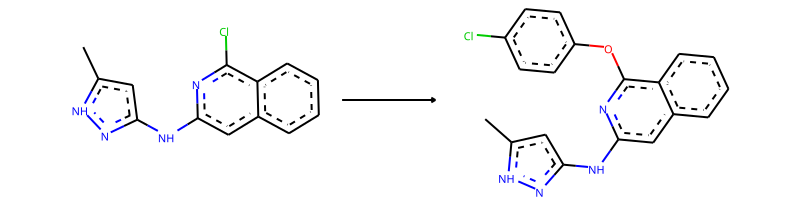

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


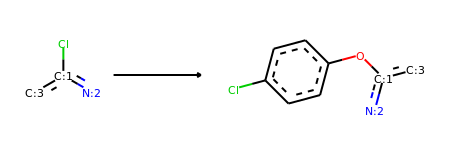

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(Cl)cc3)n2)n[nH]1


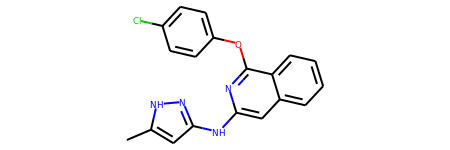

The proposed reaction is:


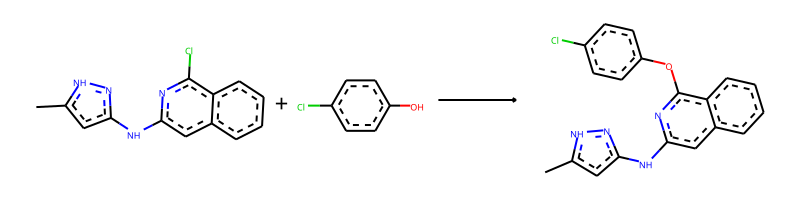

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(Cl)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(Cl)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 136016
RANK 5 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>COc1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


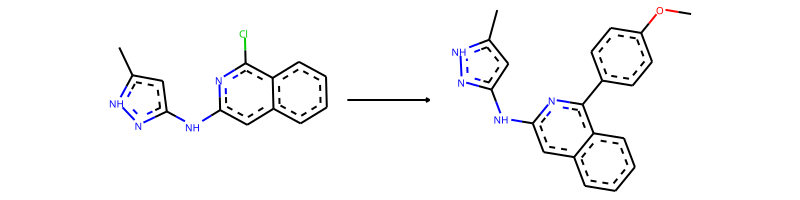

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


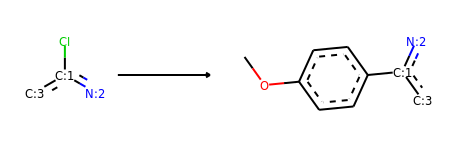

Product similarity 1.0, overall 1.0, smiles COc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


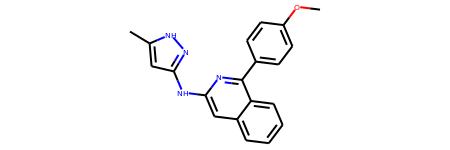

The proposed reaction is:


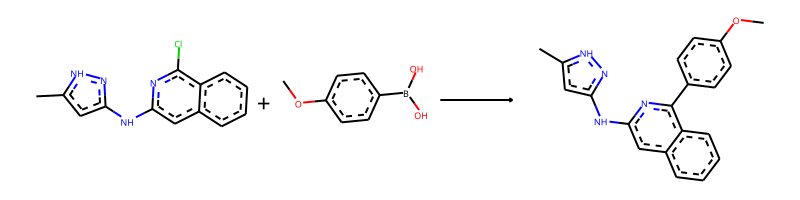

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.COc1ccc(B(O)O)cc1>>COc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 35385
RANK 6 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>N#Cc1ccc(N[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


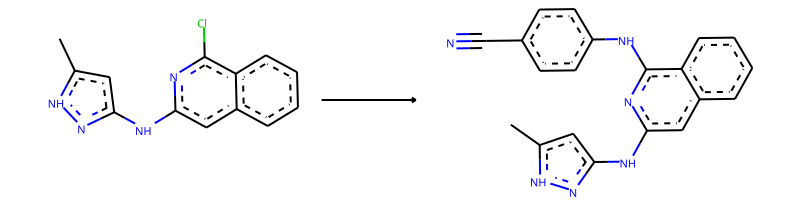

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>N#C-c1:c:c:c(-N-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


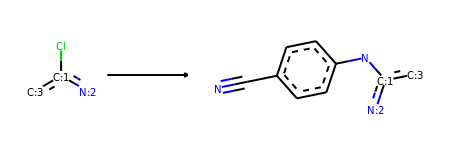

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Nc3ccc(C#N)cc3)n2)n[nH]1


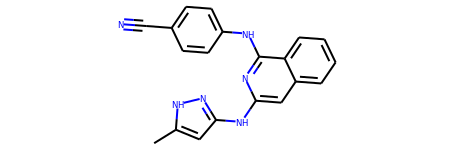

The proposed reaction is:


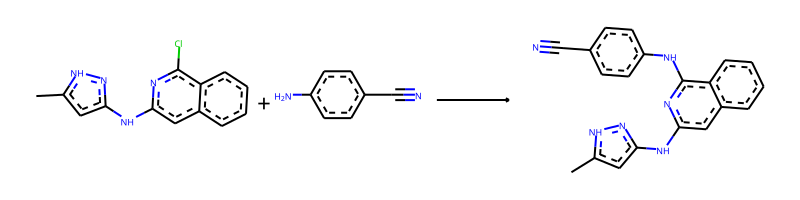

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.N#Cc1ccc(N)cc1>>Cc1cc(Nc2cc3ccccc3c(Nc3ccc(C#N)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 231805
RANK 7 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:13][c:14]2[cH:15][cH:16][cH:17][cH:18][c:19]12>>Fc1ccc(O[c:10]2[n:11][c:12]([NH:20][c:21]3[n:22][nH:23][c:24]([CH3:26])[cH:25]3)[cH:13][c:14]3[cH:15][cH:16][cH:17][cH:18][c:19]23)cc1


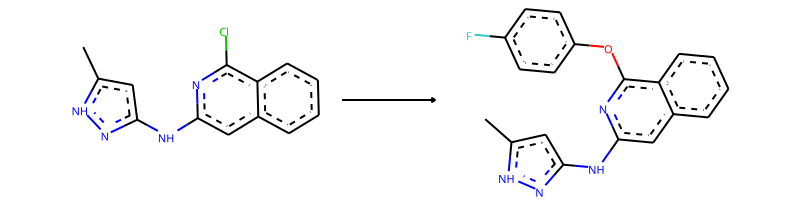

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


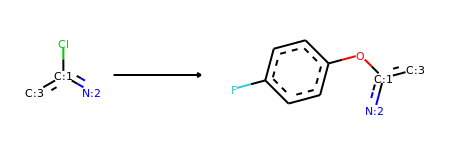

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


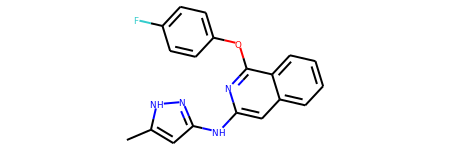

The proposed reaction is:


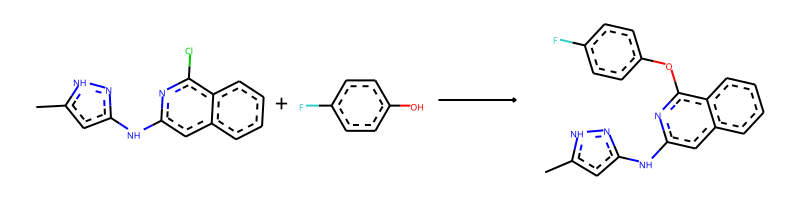

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(F)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 130755
RANK 8 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:13][c:14]2[cH:15][cH:16][cH:17][cH:18][c:19]12>>Clc1ccc(S[c:10]2[n:11][c:12]([NH:20][c:21]3[n:22][nH:23][c:24]([CH3:26])[cH:25]3)[cH:13][c:14]3[cH:15][cH:16][cH:17][cH:18][c:19]23)cc1


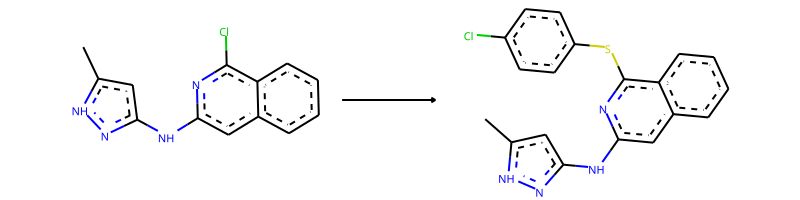

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c(-S-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


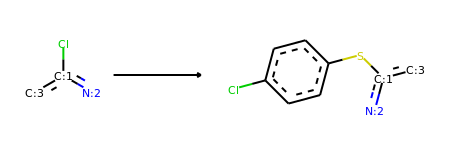

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Sc3ccc(Cl)cc3)n2)n[nH]1


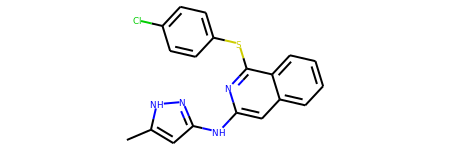

The proposed reaction is:


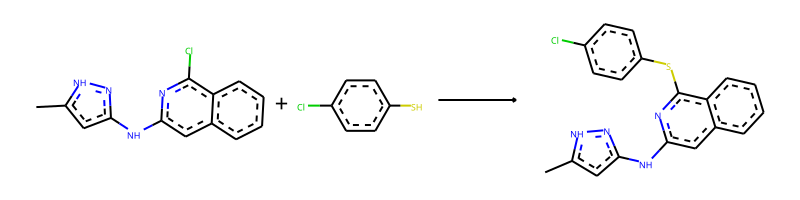

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Sc1ccc(Cl)cc1>>Cc1cc(Nc2cc3ccccc3c(Sc3ccc(Cl)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 186558
RANK 9 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>CCc1cccc(N[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)c1


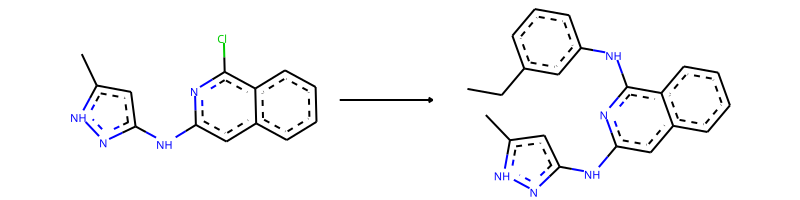

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C-c1:c:c:c:c(-N-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


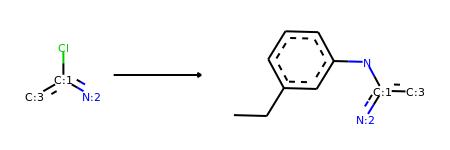

Product similarity 1.0, overall 1.0, smiles CCc1cccc(Nc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


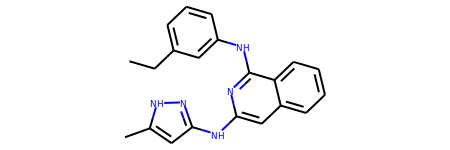

The proposed reaction is:


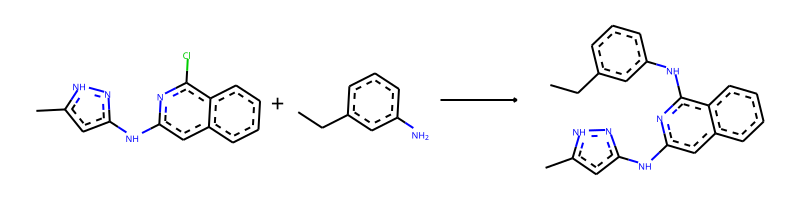

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CCc1cccc(N)c1>>CCc1cccc(Nc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


--------------------------------------------------

Train index: 50501
RANK 10 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Clc1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


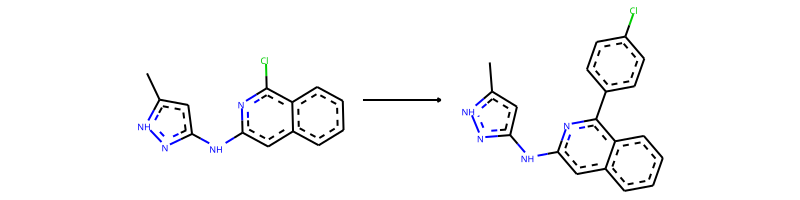

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


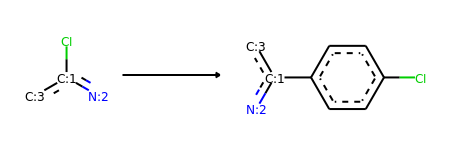

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(Cl)cc3)n2)n[nH]1


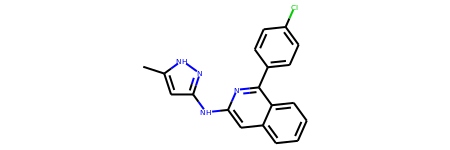

The proposed reaction is:


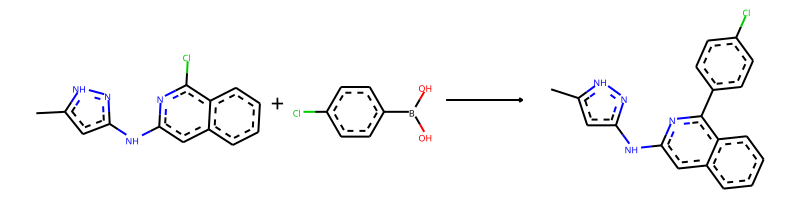

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(Cl)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(Cl)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 58716
RANK 11 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>CC(C)(C)c1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


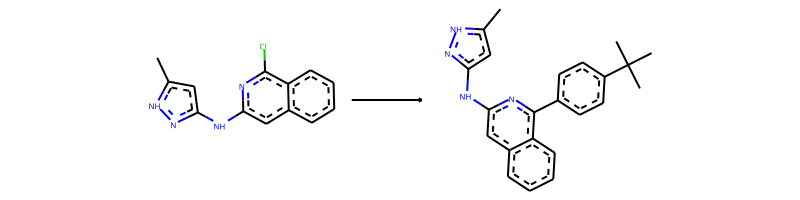

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(-C)(-C)-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


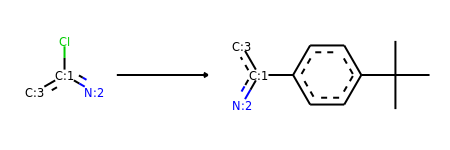

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(C(C)(C)C)cc3)n2)n[nH]1


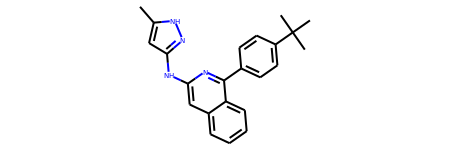

The proposed reaction is:


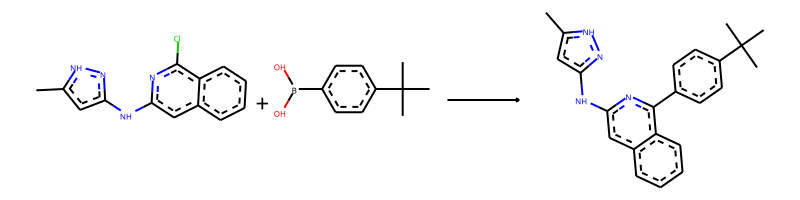

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(C)(C)c1ccc(B(O)O)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(C(C)(C)C)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 47753
RANK 12 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:11]1[n:12][c:13]([NH:21][c:22]2[n:23][nH:24][c:25]([CH3:27])[cH:26]2)[cH:14][c:15]2[cH:16][cH:17][cH:18][cH:19][c:20]12>>COc1ccccc1O[c:11]1[n:12][c:13]([NH:21][c:22]2[n:23][nH:24][c:25]([CH3:27])[cH:26]2)[cH:14][c:15]2[cH:16][cH:17][cH:18][cH:19][c:20]12


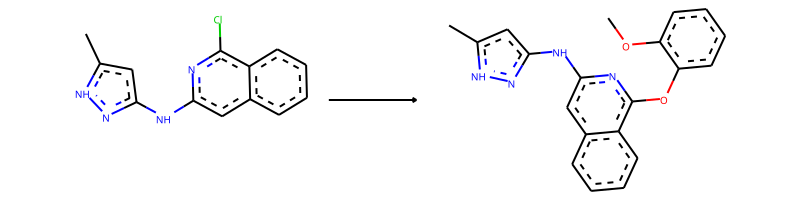

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-c1:c:c:c:c:c:1-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


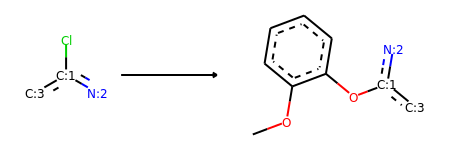

Product similarity 1.0, overall 1.0, smiles COc1ccccc1Oc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


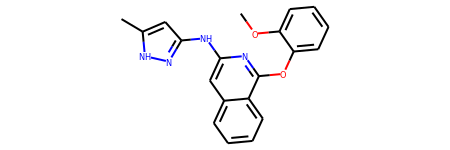

The proposed reaction is:


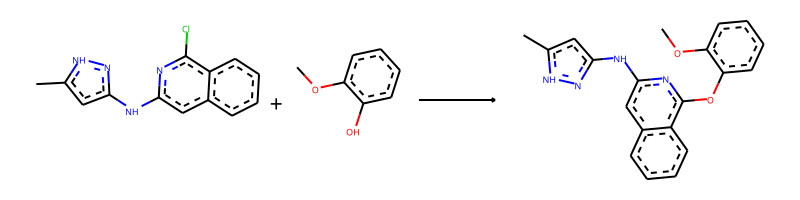

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.COc1ccccc1O>>COc1ccccc1Oc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


--------------------------------------------------

Train index: 287641
RANK 13 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:13][c:14]2[cH:15][cH:16][cH:17][cH:18][c:19]12>>Cc1cccc(O[c:10]2[n:11][c:12]([NH:20][c:21]3[n:22][nH:23][c:24]([CH3:26])[cH:25]3)[cH:13][c:14]3[cH:15][cH:16][cH:17][cH:18][c:19]23)c1


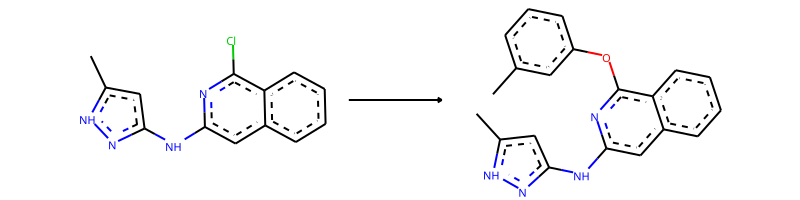

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


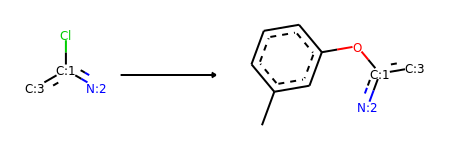

Product similarity 1.0, overall 1.0, smiles Cc1cccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


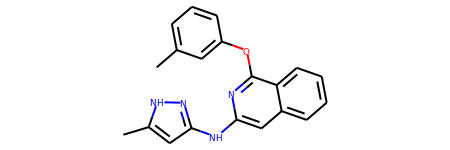

The proposed reaction is:


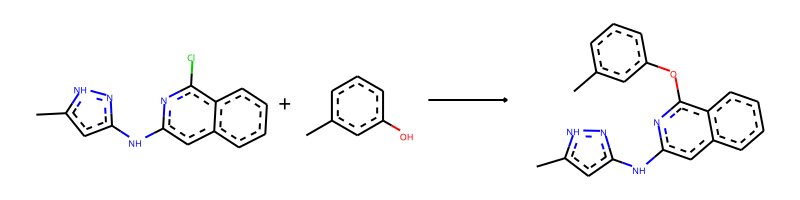

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1cccc(O)c1>>Cc1cccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


--------------------------------------------------

Train index: 167576
RANK 14 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>c1ccc2c(-[c:2]3[n:3][c:4]([NH:12][c:13]4[n:14][nH:15][c:16]([CH3:18])[cH:17]4)[cH:5][c:6]4[cH:7][cH:8][cH:9][cH:10][c:11]34)csc2c1


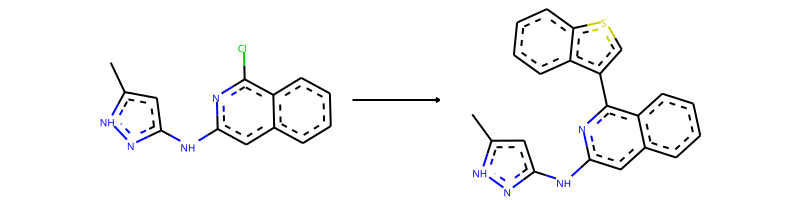

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:s:c2:c:c:c:c:c:1:2


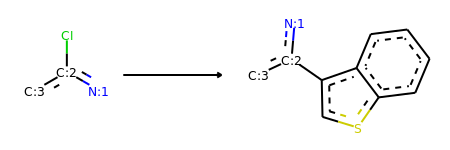

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(-c3csc4ccccc34)n2)n[nH]1


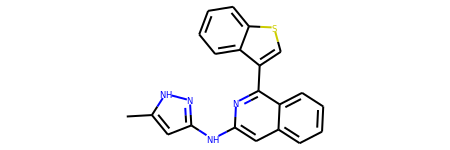

The proposed reaction is:


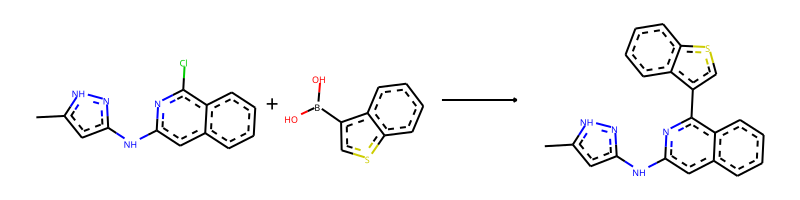

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1csc2ccccc12>>Cc1cc(Nc2cc3ccccc3c(-c3csc4ccccc34)n2)n[nH]1


--------------------------------------------------

Train index: 459056
RANK 15 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:13][c:14]2[cH:15][cH:16][cH:17][cH:18][c:19]12>>Fc1cccc(S[c:10]2[n:11][c:12]([NH:20][c:21]3[n:22][nH:23][c:24]([CH3:26])[cH:25]3)[cH:13][c:14]3[cH:15][cH:16][cH:17][cH:18][c:19]23)c1


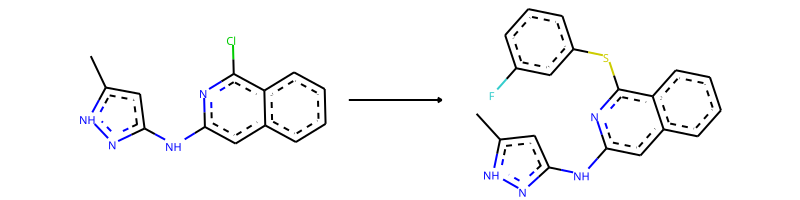

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c(-S-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


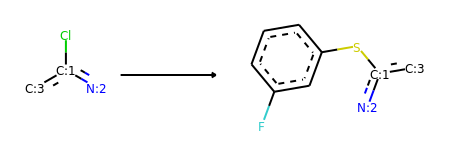

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Sc3cccc(F)c3)n2)n[nH]1


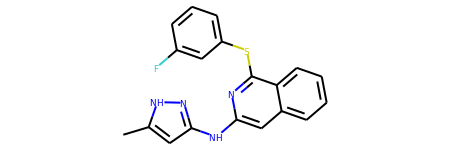

The proposed reaction is:


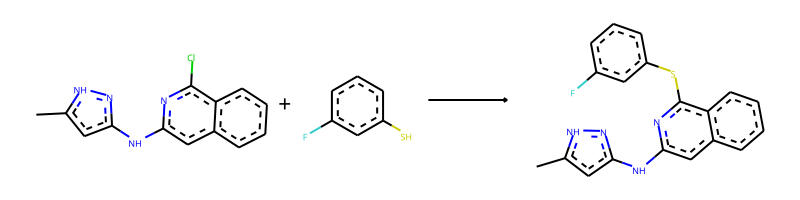

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Fc1cccc(S)c1>>Cc1cc(Nc2cc3ccccc3c(Sc3cccc(F)c3)n2)n[nH]1


--------------------------------------------------

Train index: 340315
RANK 16 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:13]1[n:14][c:15]([NH:23][c:24]2[n:25][nH:26][c:27]([CH3:29])[cH:28]2)[cH:16][c:17]2[cH:18][cH:19][cH:20][cH:21][c:22]12>>FC(F)(F)c1cccc(O[c:13]2[n:14][c:15]([NH:23][c:24]3[n:25][nH:26][c:27]([CH3:29])[cH:28]3)[cH:16][c:17]3[cH:18][cH:19][cH:20][cH:21][c:22]23)c1


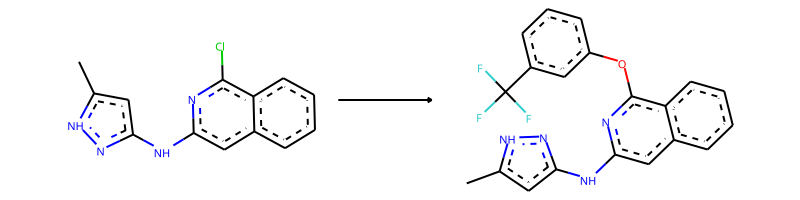

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-C(-F)(-F)-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


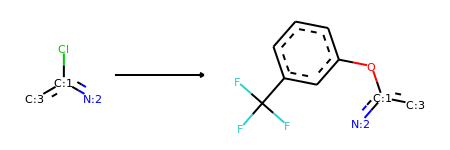

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Oc3cccc(C(F)(F)F)c3)n2)n[nH]1


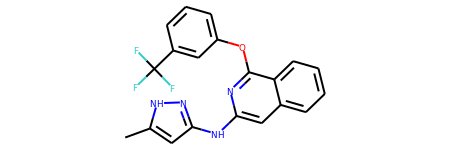

The proposed reaction is:


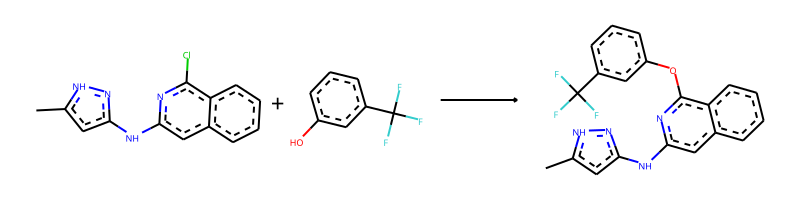

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1cccc(C(F)(F)F)c1>>Cc1cc(Nc2cc3ccccc3c(Oc3cccc(C(F)(F)F)c3)n2)n[nH]1


--------------------------------------------------

Train index: 164575
RANK 17 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:13][c:14]2[cH:15][cH:16][cH:17][cH:18][c:19]12>>Cc1ccccc1O[c:10]1[n:11][c:12]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:13][c:14]2[cH:15][cH:16][cH:17][cH:18][c:19]12


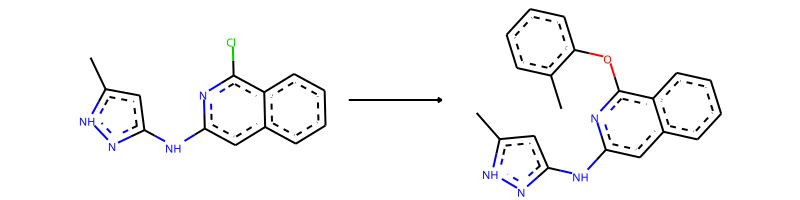

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:c:c:c:c:1-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


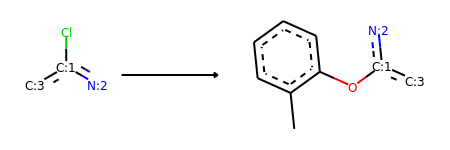

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3C)n2)n[nH]1


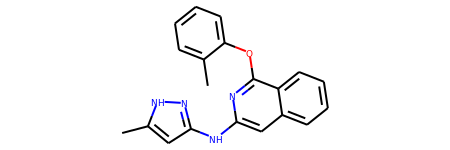

The proposed reaction is:


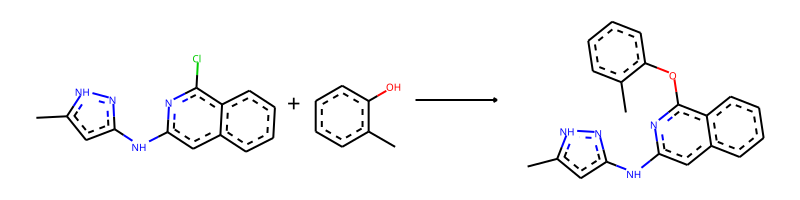

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1ccccc1O>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3C)n2)n[nH]1


--------------------------------------------------

Train index: 114594
RANK 18 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:13]1[n:14][c:15]([NH:23][c:24]2[n:25][nH:26][c:27]([CH3:29])[cH:28]2)[cH:16][c:17]2[cH:18][cH:19][cH:20][cH:21][c:22]12>>COc1ccc(O[c:13]2[n:14][c:15]([NH:23][c:24]3[n:25][nH:26][c:27]([CH3:29])[cH:28]3)[cH:16][c:17]3[cH:18][cH:19][cH:20][cH:21][c:22]23)cc1


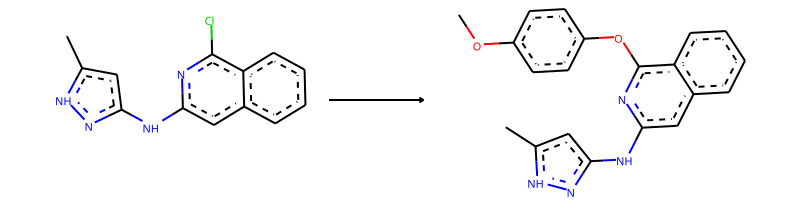

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


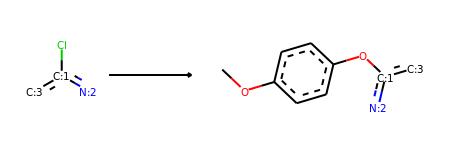

Product similarity 1.0, overall 1.0, smiles COc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


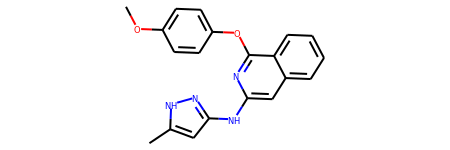

The proposed reaction is:


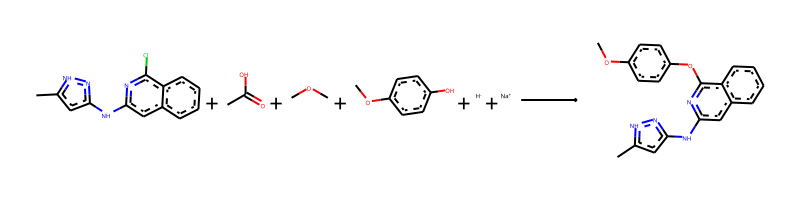

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(=O)O.COC.COc1ccc(O)cc1.[H-].[Na+]>>COc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 344225
RANK 19 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:13][c:14]2[cH:15][cH:16][cH:17][cH:18][c:19]12>>Clc1ccccc1O[c:10]1[n:11][c:12]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:13][c:14]2[cH:15][cH:16][cH:17][cH:18][c:19]12


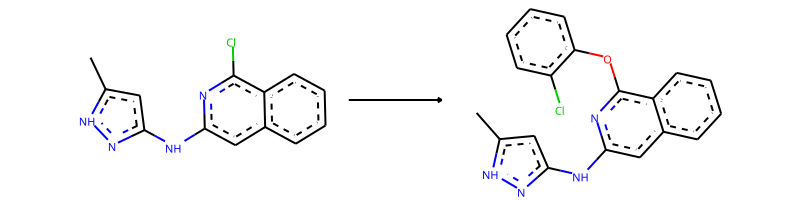

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c:c:c:1-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


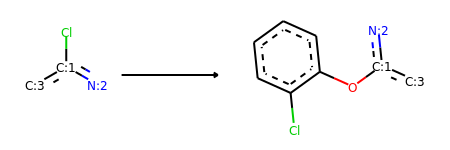

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3Cl)n2)n[nH]1


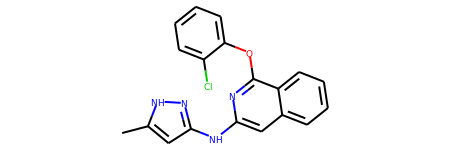

The proposed reaction is:


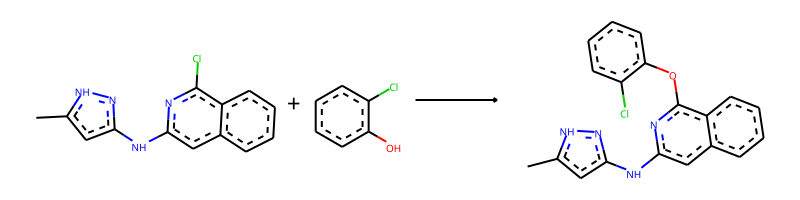

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1Cl>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3Cl)n2)n[nH]1


--------------------------------------------------

Train index: 83875
RANK 20 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:11]1[n:12][c:13]([NH:21][c:22]2[n:23][nH:24][c:25]([CH3:27])[cH:26]2)[cH:14][c:15]2[cH:16][cH:17][cH:18][cH:19][c:20]12>>N#Cc1ccc(O[c:11]2[n:12][c:13]([NH:21][c:22]3[n:23][nH:24][c:25]([CH3:27])[cH:26]3)[cH:14][c:15]3[cH:16][cH:17][cH:18][cH:19][c:20]23)cc1


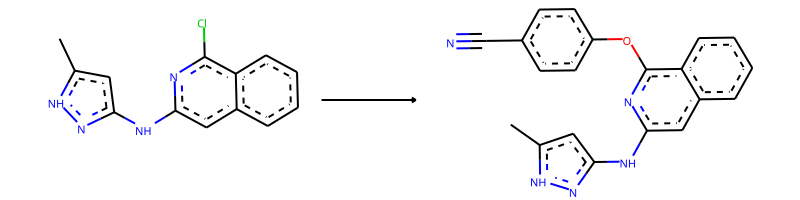

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>N#C-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


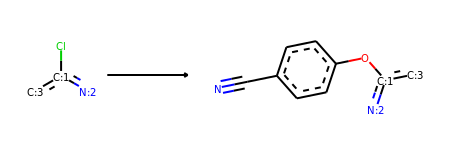

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(C#N)cc3)n2)n[nH]1


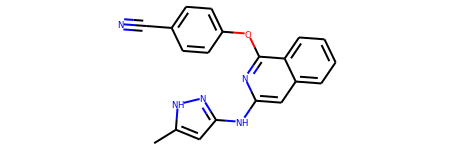

The proposed reaction is:


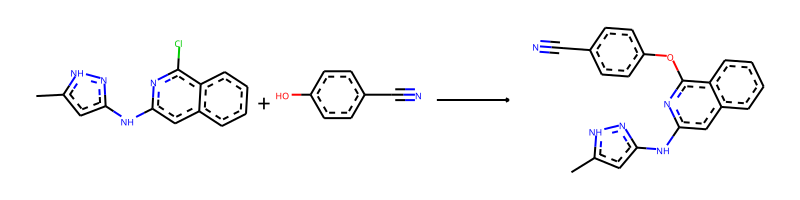

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.N#Cc1ccc(O)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(C#N)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 64427
RANK 21 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:11]1[n:12][c:13]([NH:21][c:22]2[n:23][nH:24][c:25]([CH3:27])[cH:26]2)[cH:14][c:15]2[cH:16][cH:17][cH:18][cH:19][c:20]12>>C1CCN(CCO[c:11]2[n:12][c:13]([NH:21][c:22]3[n:23][nH:24][c:25]([CH3:27])[cH:26]3)[cH:14][c:15]3[cH:16][cH:17][cH:18][cH:19][c:20]23)CC1


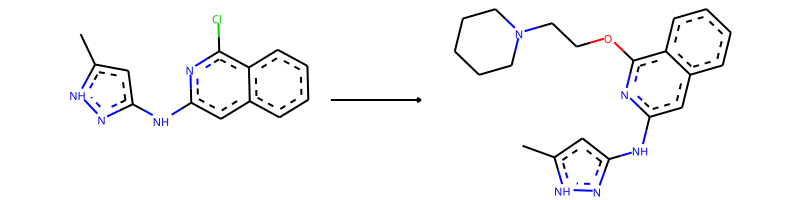

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-C-C-N1-C-C-C-C-C-1


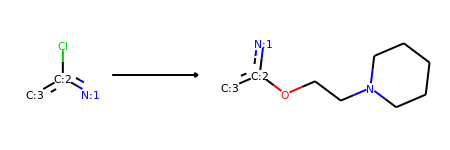

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(OCCN3CCCCC3)n2)n[nH]1


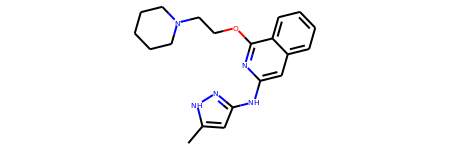

The proposed reaction is:


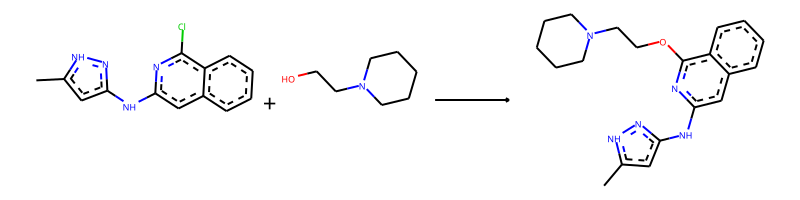

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OCCN1CCCCC1>>Cc1cc(Nc2cc3ccccc3c(OCCN3CCCCC3)n2)n[nH]1


--------------------------------------------------

Train index: 449583
RANK 22 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>c1cc(N[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)ccn1


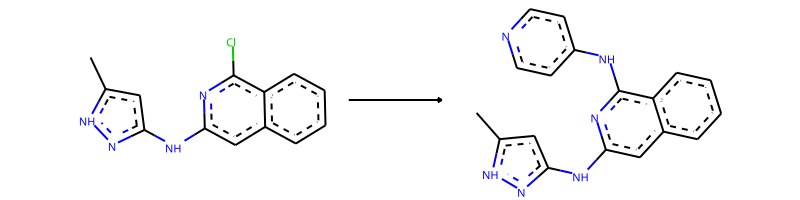

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-N-c1:c:c:n:c:c:1


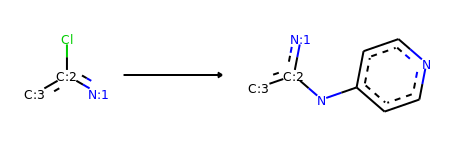

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Nc3ccncc3)n2)n[nH]1


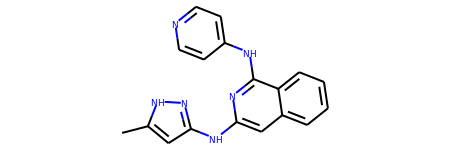

The proposed reaction is:


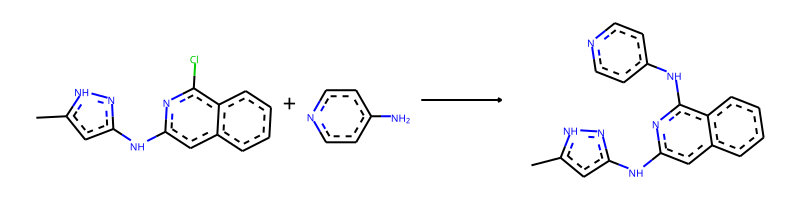

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Nc1ccncc1>>Cc1cc(Nc2cc3ccccc3c(Nc3ccncc3)n2)n[nH]1


--------------------------------------------------

Train index: 147826
RANK 23 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:9]1[n:10][c:11]([NH:19][c:20]2[n:21][nH:22][c:23]([CH3:25])[cH:24]2)[cH:12][c:13]2[cH:14][cH:15][cH:16][cH:17][c:18]12>>C1CCC(O[c:9]2[n:10][c:11]([NH:19][c:20]3[n:21][nH:22][c:23]([CH3:25])[cH:24]3)[cH:12][c:13]3[cH:14][cH:15][cH:16][cH:17][c:18]23)CC1


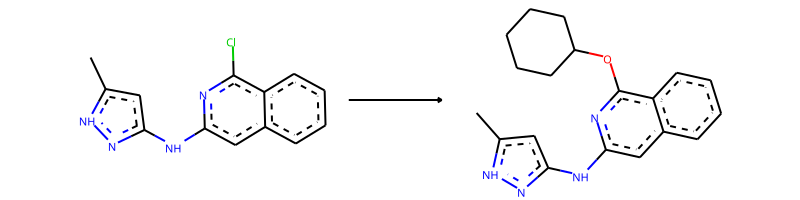

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-C1-C-C-C-C-C-1


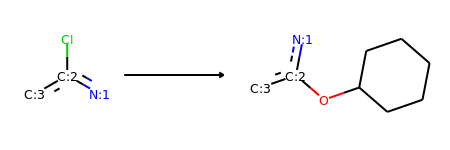

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(OC3CCCCC3)n2)n[nH]1


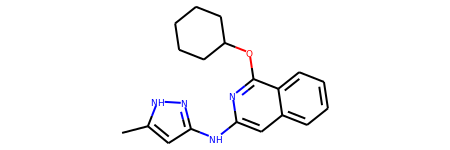

The proposed reaction is:


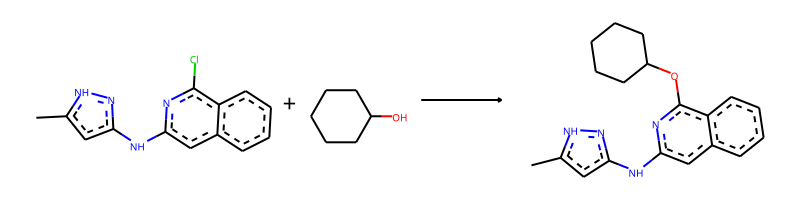

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OC1CCCCC1>>Cc1cc(Nc2cc3ccccc3c(OC3CCCCC3)n2)n[nH]1


--------------------------------------------------

Train index: 397694
RANK 24 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>N#Cc1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


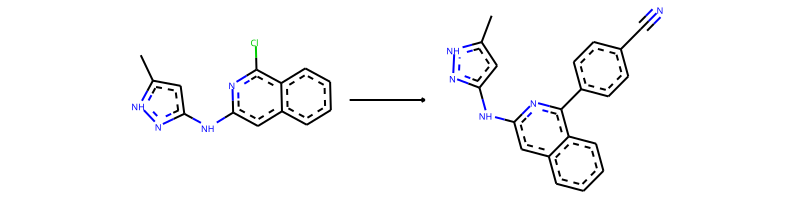

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>N#C-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


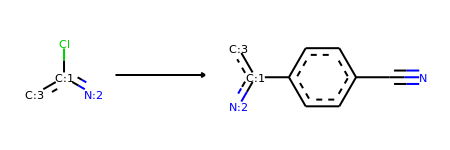

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(C#N)cc3)n2)n[nH]1


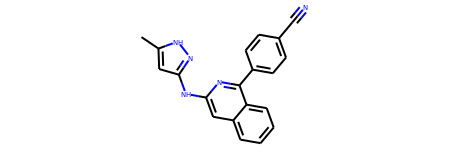

The proposed reaction is:


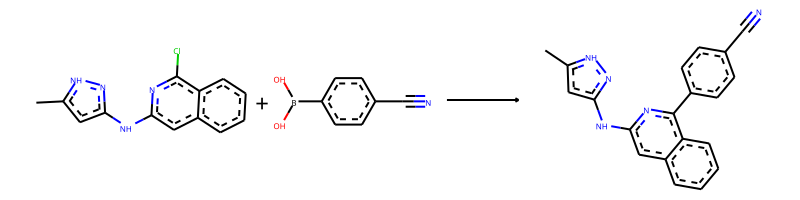

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.N#Cc1ccc(B(O)O)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(C#N)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 20715
RANK 25 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:13][c:14]2[cH:15][cH:16][cH:17][cH:18][c:19]12>>Clc1cccc(O[c:10]2[n:11][c:12]([NH:20][c:21]3[n:22][nH:23][c:24]([CH3:26])[cH:25]3)[cH:13][c:14]3[cH:15][cH:16][cH:17][cH:18][c:19]23)c1


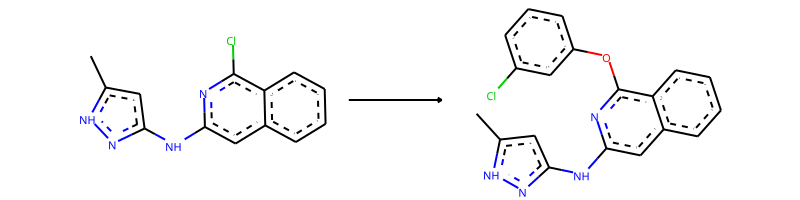

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


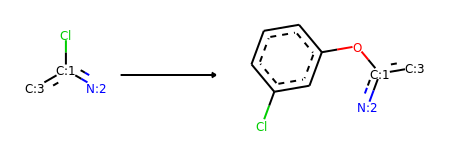

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Oc3cccc(Cl)c3)n2)n[nH]1


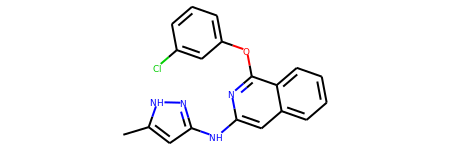

The proposed reaction is:


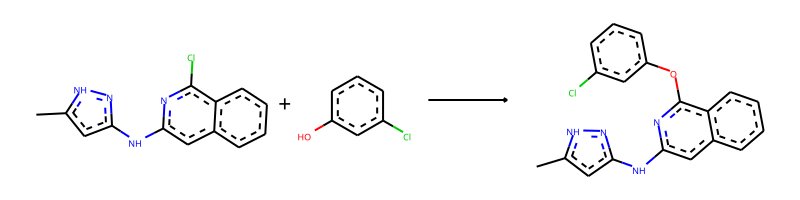

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1cccc(Cl)c1>>Cc1cc(Nc2cc3ccccc3c(Oc3cccc(Cl)c3)n2)n[nH]1


--------------------------------------------------

Train index: 428636
RANK 26 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Fc1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


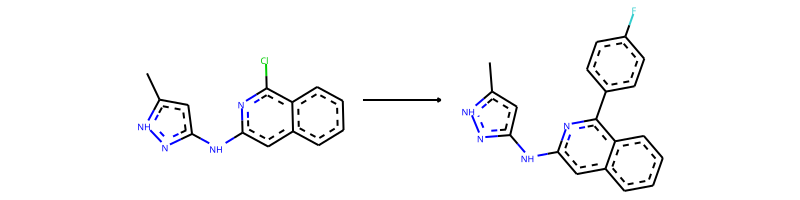

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


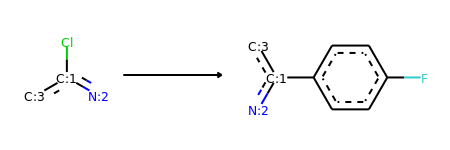

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3)n2)n[nH]1


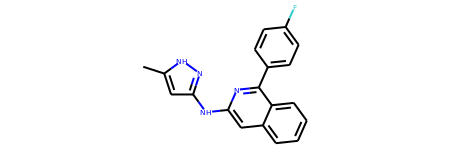

The proposed reaction is:


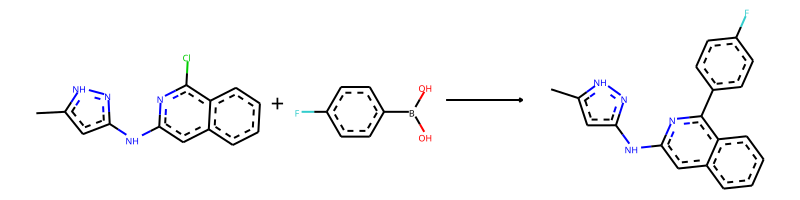

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(F)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 296652
RANK 27 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Clc1cccc(N[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)c1


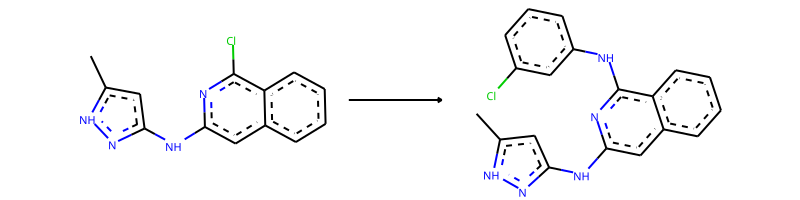

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c:c(-N-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


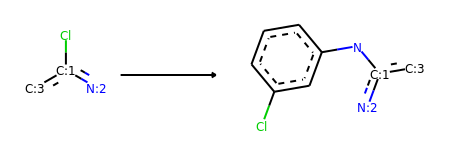

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Nc3cccc(Cl)c3)n2)n[nH]1


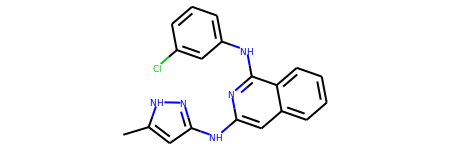

The proposed reaction is:


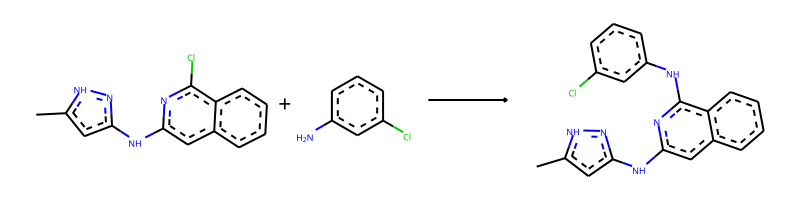

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Nc1cccc(Cl)c1>>Cc1cc(Nc2cc3ccccc3c(Nc3cccc(Cl)c3)n2)n[nH]1


--------------------------------------------------

Train index: 117645
RANK 28 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:13][c:14]2[cH:15][cH:16][cH:17][cH:18][c:19]12>>Fc1cccc(O[c:10]2[n:11][c:12]([NH:20][c:21]3[n:22][nH:23][c:24]([CH3:26])[cH:25]3)[cH:13][c:14]3[cH:15][cH:16][cH:17][cH:18][c:19]23)c1


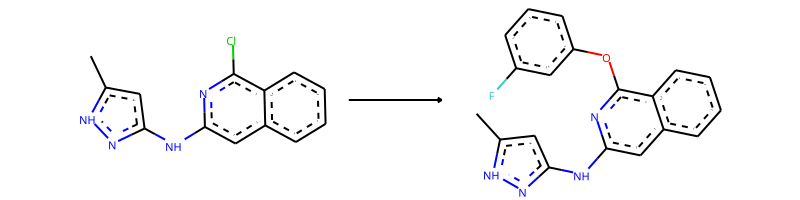

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


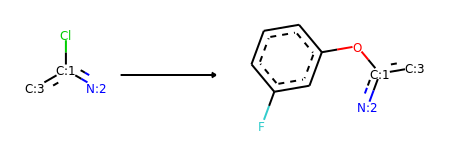

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Oc3cccc(F)c3)n2)n[nH]1


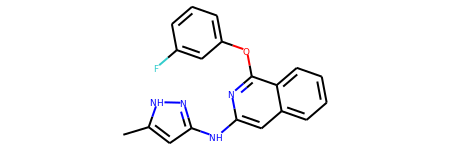

The proposed reaction is:


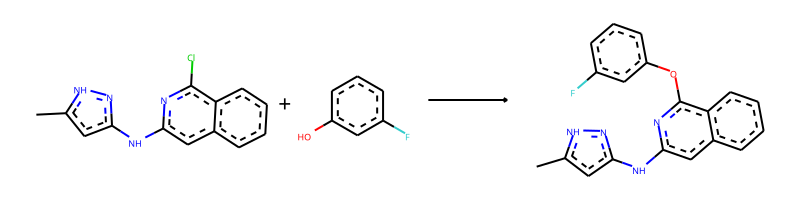

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1cccc(F)c1>>Cc1cc(Nc2cc3ccccc3c(Oc3cccc(F)c3)n2)n[nH]1


--------------------------------------------------

Train index: 118937
RANK 29 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:13][c:14]2[cH:15][cH:16][cH:17][cH:18][c:19]12>>Cc1ccc(O[c:10]2[n:11][c:12]([NH:20][c:21]3[n:22][nH:23][c:24]([CH3:26])[cH:25]3)[cH:13][c:14]3[cH:15][cH:16][cH:17][cH:18][c:19]23)cc1


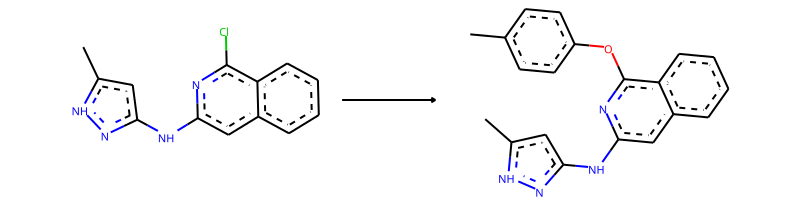

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


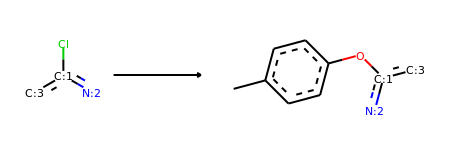

Product similarity 1.0, overall 1.0, smiles Cc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


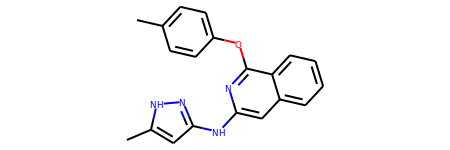

The proposed reaction is:


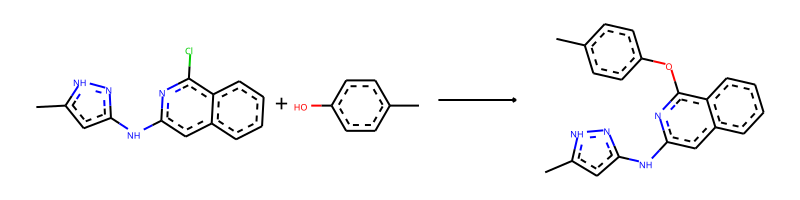

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1ccc(O)cc1>>Cc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 411858
RANK 30 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Fc1ccccc1-[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12


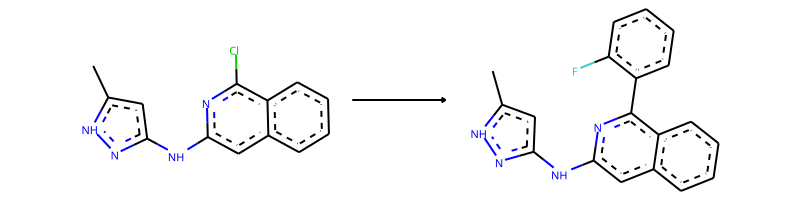

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c:c:1-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


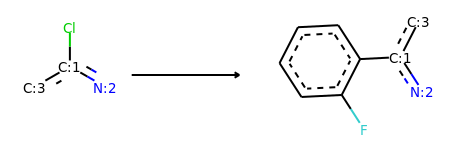

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccccc3F)n2)n[nH]1


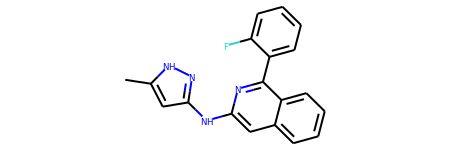

The proposed reaction is:


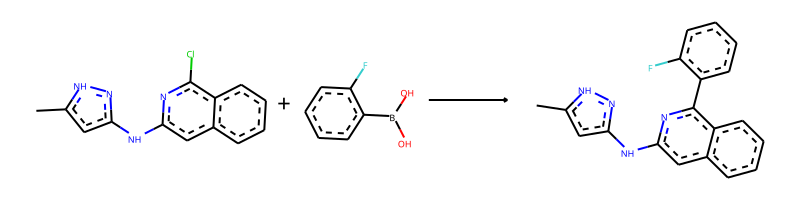

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccccc1F>>Cc1cc(Nc2cc3ccccc3c(-c3ccccc3F)n2)n[nH]1


--------------------------------------------------

Train index: 280476
RANK 31 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:13]1[n:14][c:15]([NH:23][c:24]2[n:25][nH:26][c:27]([CH3:29])[cH:28]2)[cH:16][c:17]2[cH:18][cH:19][cH:20][cH:21][c:22]12>>CC(=O)Nc1ccc(O[c:13]2[n:14][c:15]([NH:23][c:24]3[n:25][nH:26][c:27]([CH3:29])[cH:28]3)[cH:16][c:17]3[cH:18][cH:19][cH:20][cH:21][c:22]23)cc1


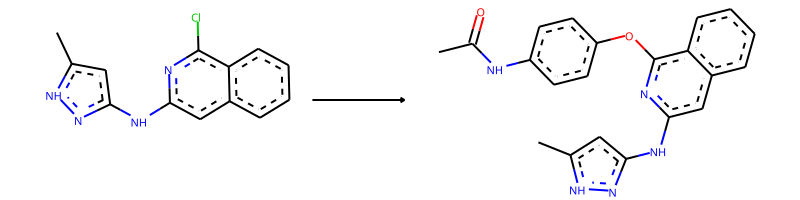

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(=O)-N-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


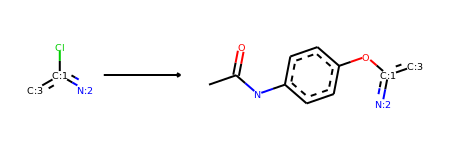

Product similarity 1.0, overall 1.0, smiles CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


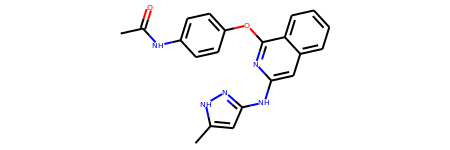

The proposed reaction is:


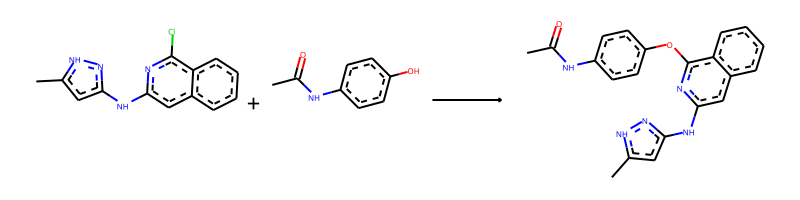

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(=O)Nc1ccc(O)cc1>>CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 150398
RANK 32 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>CC(=O)Nc1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


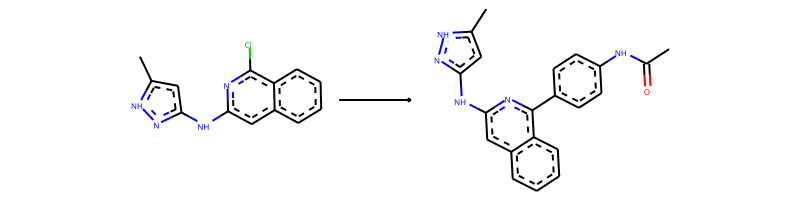

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(=O)-N-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


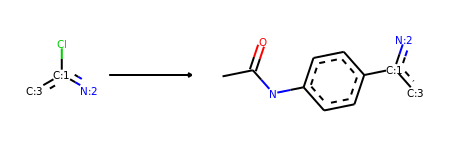

Product similarity 1.0, overall 1.0, smiles CC(=O)Nc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


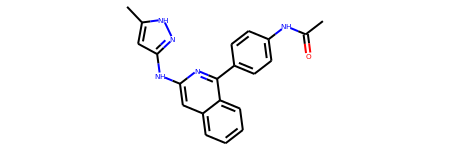

The proposed reaction is:


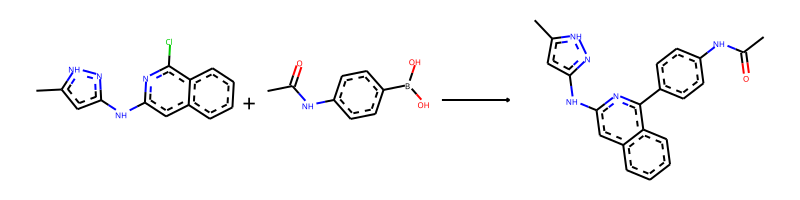

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(=O)Nc1ccc(B(O)O)cc1>>CC(=O)Nc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 438187
RANK 33 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>CC(C)O[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12


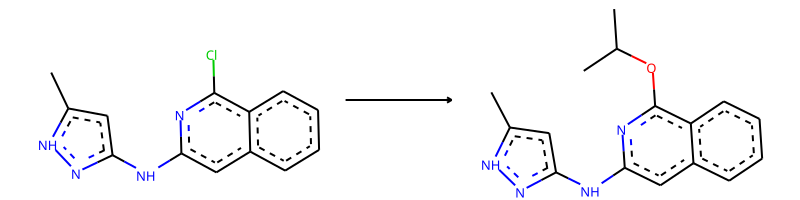

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(-C)-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


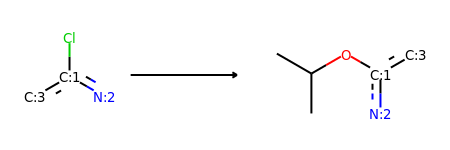

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(OC(C)C)n2)n[nH]1


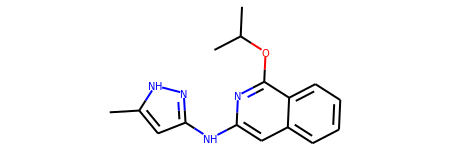

The proposed reaction is:


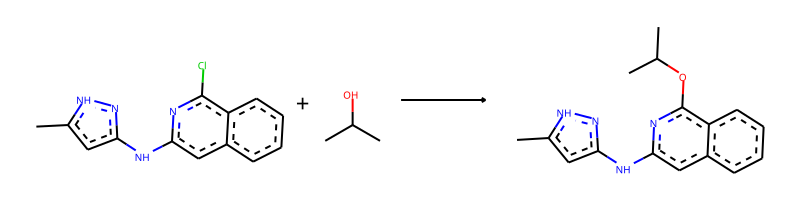

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(C)O>>Cc1cc(Nc2cc3ccccc3c(OC(C)C)n2)n[nH]1


--------------------------------------------------

Train index: 472762
RANK 34 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>COc1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1OC


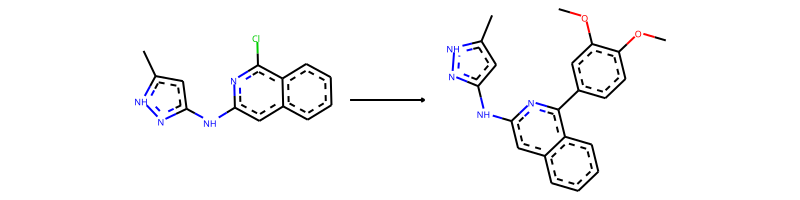

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1-O-C


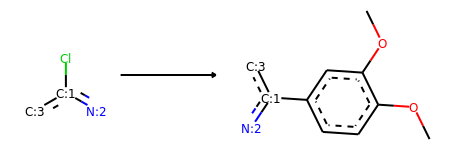

Product similarity 1.0, overall 1.0, smiles COc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1OC


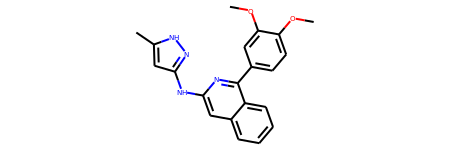

The proposed reaction is:


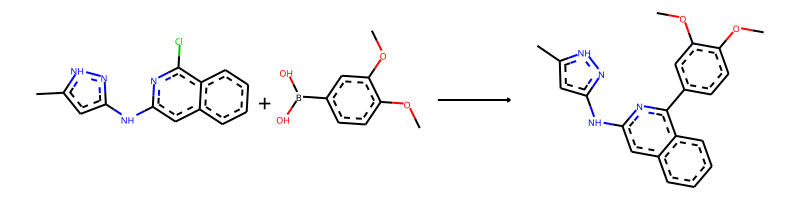

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.COc1ccc(B(O)O)cc1OC>>COc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1OC


--------------------------------------------------

Train index: 264770
RANK 35 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>CCCCOc1ccc(N[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


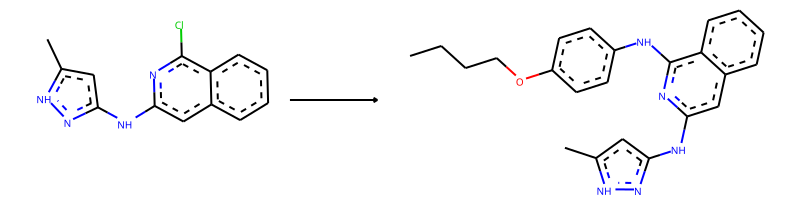

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C-C-C-O-c1:c:c:c(-N-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


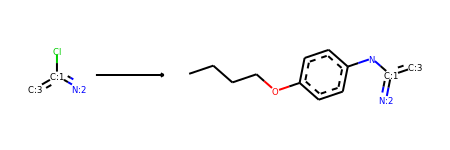

Product similarity 1.0, overall 1.0, smiles CCCCOc1ccc(Nc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


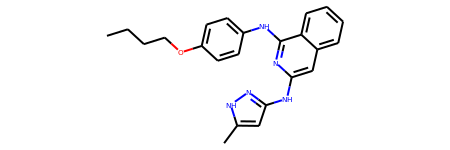

The proposed reaction is:


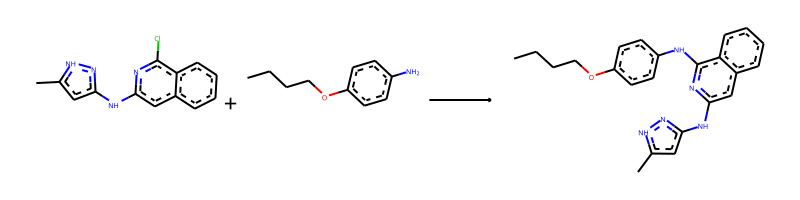

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CCCCOc1ccc(N)cc1>>CCCCOc1ccc(Nc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 148903
RANK 36 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:11]1[n:12][c:13]([NH:21][c:22]2[n:23][nH:24][c:25]([CH3:27])[cH:26]2)[cH:14][c:15]2[cH:16][cH:17][cH:18][cH:19][c:20]12>>COc1cccc(O[c:11]2[n:12][c:13]([NH:21][c:22]3[n:23][nH:24][c:25]([CH3:27])[cH:26]3)[cH:14][c:15]3[cH:16][cH:17][cH:18][cH:19][c:20]23)c1


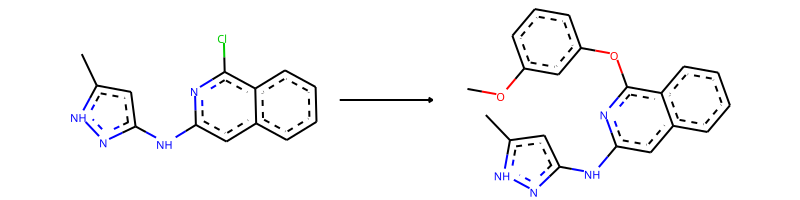

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


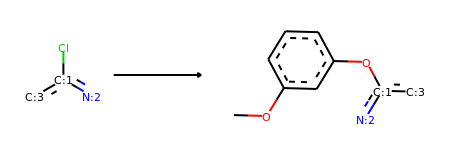

Product similarity 1.0, overall 1.0, smiles COc1cccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


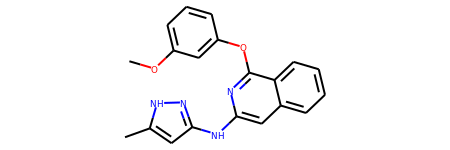

The proposed reaction is:


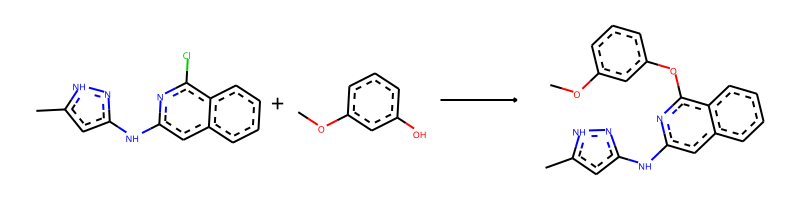

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.COc1cccc(O)c1>>COc1cccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


--------------------------------------------------

Train index: 374427
RANK 37 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Fc1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][c:16]([CH3:18])[cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)c(F)c1


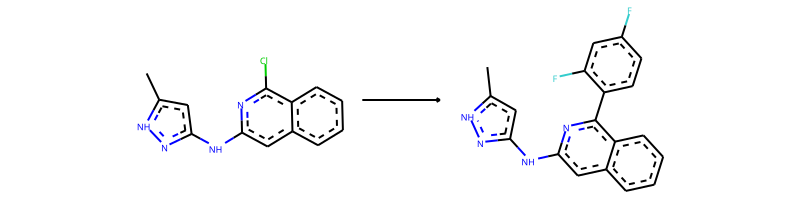

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c(-F):c:1


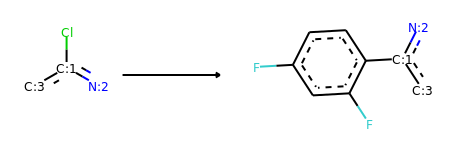

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3F)n2)n[nH]1


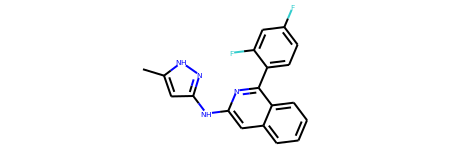

The proposed reaction is:


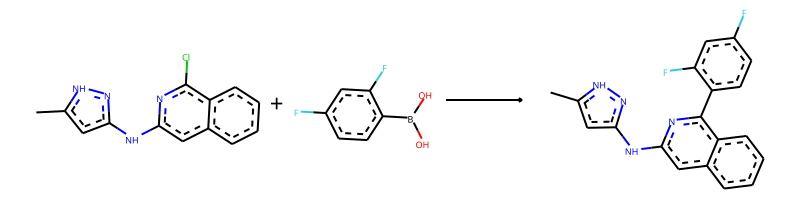

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(F)cc1F>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3F)n2)n[nH]1


--------------------------------------------------

Train index: 168651
RANK 38 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>c1n[nH]cc1-[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][c:16]([CH3:18])[cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12


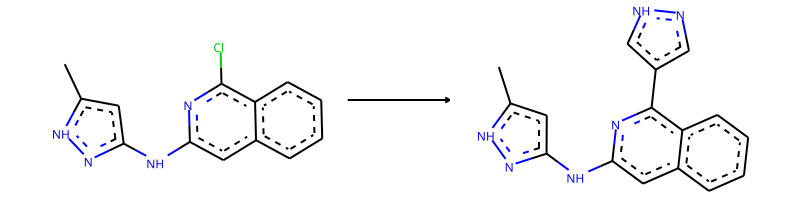

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:[nH]:n:c:1


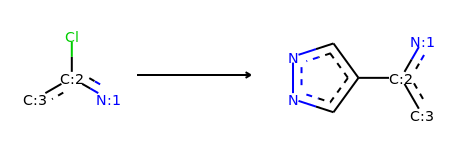

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(-c3cn[nH]c3)n2)n[nH]1


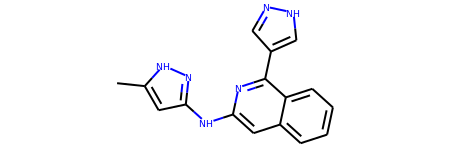

The proposed reaction is:


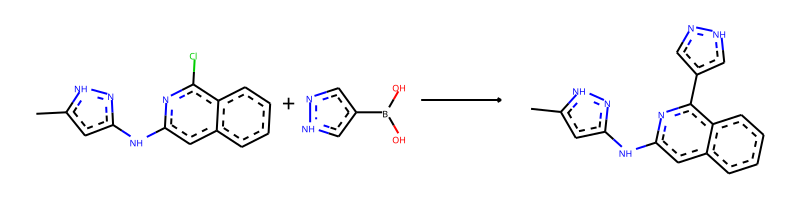

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1cn[nH]c1>>Cc1cc(Nc2cc3ccccc3c(-c3cn[nH]c3)n2)n[nH]1


--------------------------------------------------

Train index: 69434
RANK 39 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:13][c:14]2[cH:15][cH:16][cH:17][cH:18][c:19]12>>Fc1ccc(S[c:10]2[n:11][c:12]([NH:20][c:21]3[n:22][nH:23][c:24]([CH3:26])[cH:25]3)[cH:13][c:14]3[cH:15][cH:16][cH:17][cH:18][c:19]23)cc1


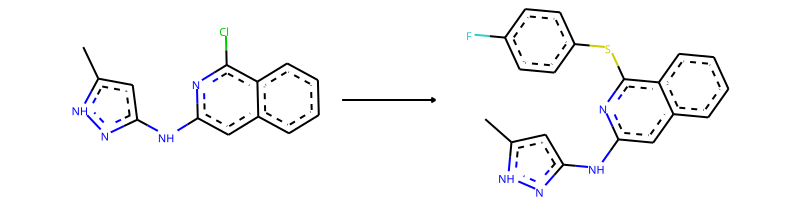

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-S-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


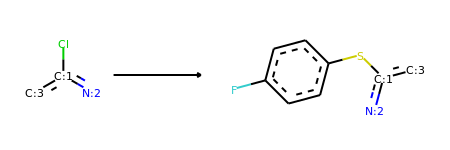

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(Sc3ccc(F)cc3)n2)n[nH]1


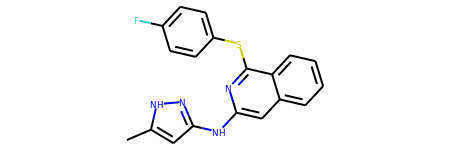

The proposed reaction is:


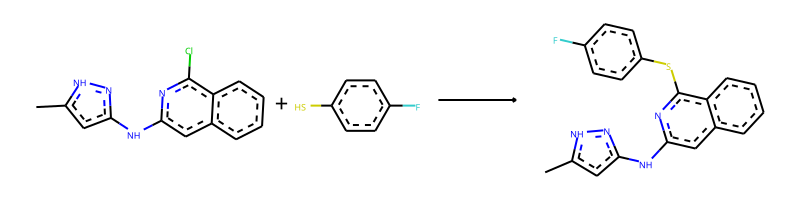

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Fc1ccc(S)cc1>>Cc1cc(Nc2cc3ccccc3c(Sc3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 143786
RANK 40 PRECEDENT
REACTANT MATCH SCORE: 1.0
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:13][c:14]2[cH:15][cH:16][cH:17][cH:18][c:19]12>>c1ccc(CO[c:10]2[n:11][c:12]([NH:20][c:21]3[n:22][nH:23][c:24]([CH3:26])[cH:25]3)[cH:13][c:14]3[cH:15][cH:16][cH:17][cH:18][c:19]23)cc1


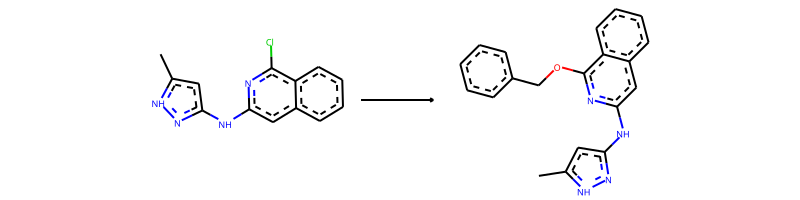

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-C-c1:c:c:c:c:c:1


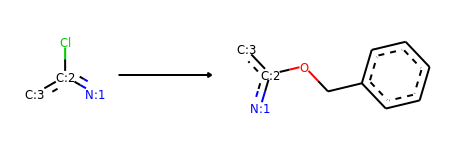

Product similarity 1.0, overall 1.0, smiles Cc1cc(Nc2cc3ccccc3c(OCc3ccccc3)n2)n[nH]1


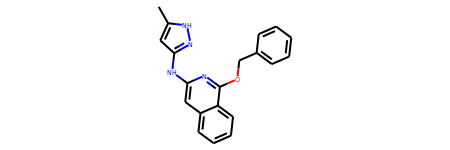

The proposed reaction is:


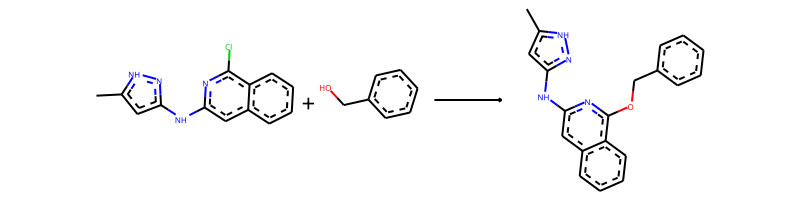

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OCc1ccccc1>>Cc1cc(Nc2cc3ccccc3c(OCc3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 368182
RANK 41 PRECEDENT
REACTANT MATCH SCORE: 0.8275862068965517
Reaction SMILES (Precedent): Cl[c:9]1[n:10][c:11]([NH:20][c:21]2[n:22][nH:23][c:24]([CH3:26])[cH:25]2)[cH:12][c:13]2[c:14]([CH3:19])[cH:15][cH:16][cH:17][c:18]12>>c1ccc(O[c:9]2[n:10][c:11]([NH:20][c:21]3[n:22][nH:23][c:24]([CH3:26])[cH:25]3)[cH:12][c:13]3[c:14]([CH3:19])[cH:15][cH:16][cH:17][c:18]23)cc1


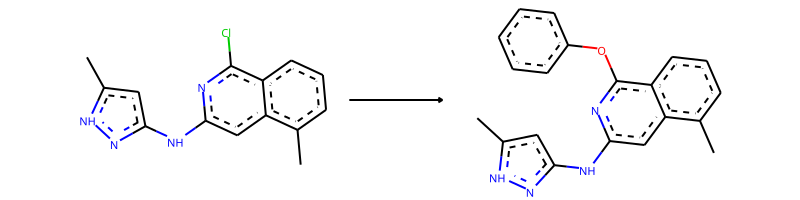

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-c1:c:c:c:c:c:1


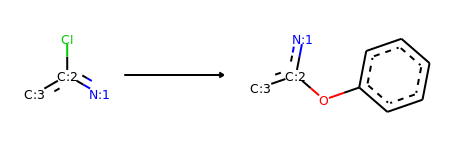

Product similarity 0.8701298701298701, overall 0.7201074787281684, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


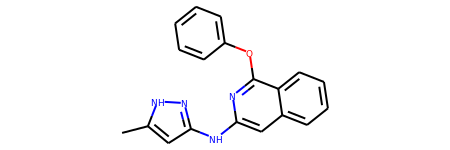

The proposed reaction is:


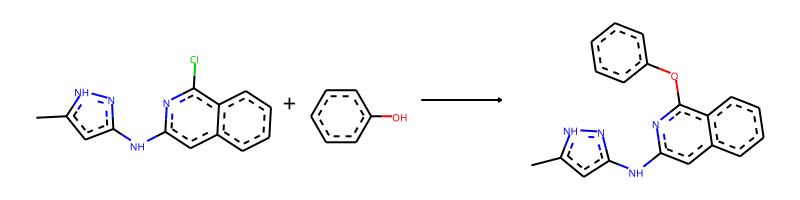

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 248380
RANK 42 PRECEDENT
REACTANT MATCH SCORE: 0.8275862068965517
Reaction SMILES (Precedent): Cl[c:9]1[n:8][c:7]([NH:13][c:14]2[n:15][nH:16][c:17]([CH3:19])[cH:18]2)[cH:6][c:5]2[cH:4][cH:3][c:2]([Br:1])[cH:11][c:10]21>>CC(C)O[c:9]1[n:8][c:7]([NH:13][c:14]2[n:15][nH:16][c:17]([CH3:19])[cH:18]2)[cH:6][c:5]2[cH:4][cH:3][c:2]([Br:1])[cH:11][c:10]21


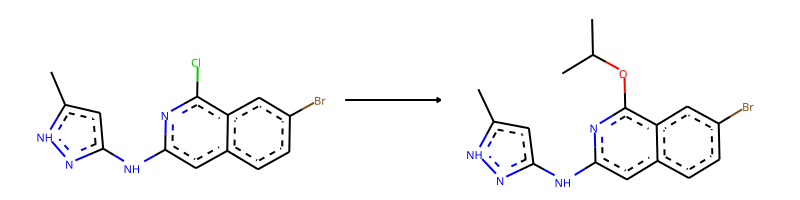

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(-C)-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


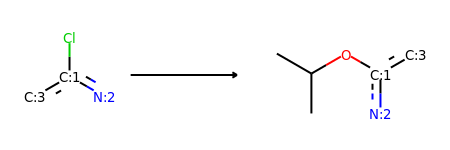

Product similarity 0.8484848484848485, overall 0.7021943573667712, smiles Cc1cc(Nc2cc3ccccc3c(OC(C)C)n2)n[nH]1


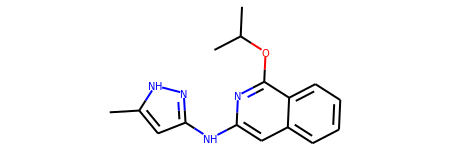

The proposed reaction is:


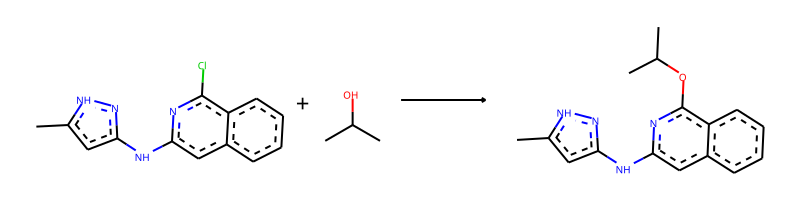

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(C)O>>Cc1cc(Nc2cc3ccccc3c(OC(C)C)n2)n[nH]1


--------------------------------------------------

Train index: 461645
RANK 43 PRECEDENT
REACTANT MATCH SCORE: 0.8275862068965517
Reaction SMILES (Precedent): Cl[c:8]1[n:7][c:6]([NH:13][c:14]2[n:15][nH:16][c:17]([CH3:19])[cH:18]2)[cH:5][c:4]2[cH:3][c:2]([Br:1])[cH:11][cH:10][c:9]21>>CC(C)O[c:8]1[n:7][c:6]([NH:13][c:14]2[n:15][nH:16][c:17]([CH3:19])[cH:18]2)[cH:5][c:4]2[cH:3][c:2]([Br:1])[cH:11][cH:10][c:9]21


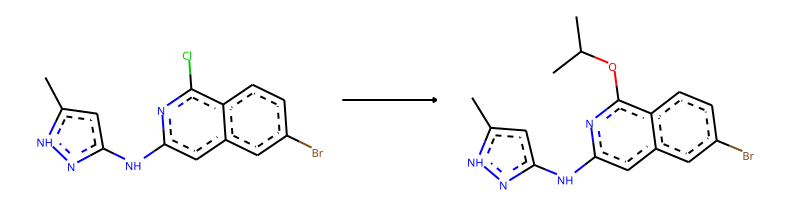

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(-C)-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


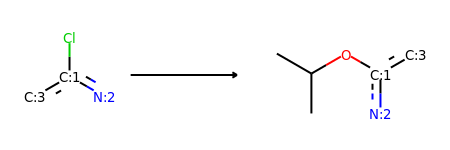

Product similarity 0.8484848484848485, overall 0.7021943573667712, smiles Cc1cc(Nc2cc3ccccc3c(OC(C)C)n2)n[nH]1


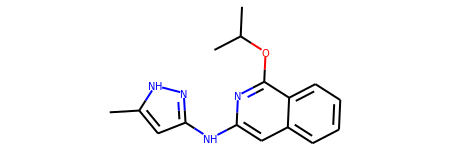

The proposed reaction is:


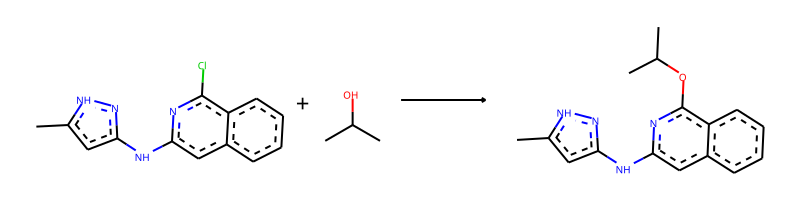

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(C)O>>Cc1cc(Nc2cc3ccccc3c(OC(C)C)n2)n[nH]1


--------------------------------------------------

Train index: 449472
RANK 44 PRECEDENT
REACTANT MATCH SCORE: 0.8275862068965517
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:13][c:14]2[n:15][nH:16][c:17]([CH3:19])[cH:18]2)[cH:5][c:6]2[c:7]([CH3:12])[cH:8][cH:9][cH:10][c:11]12>>CO[c:2]1[n:3][c:4]([NH:13][c:14]2[n:15][nH:16][c:17]([CH3:19])[cH:18]2)[cH:5][c:6]2[c:7]([CH3:12])[cH:8][cH:9][cH:10][c:11]12


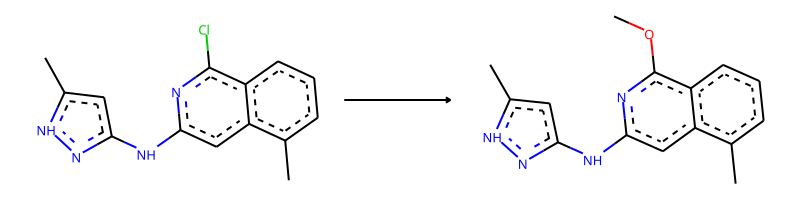

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


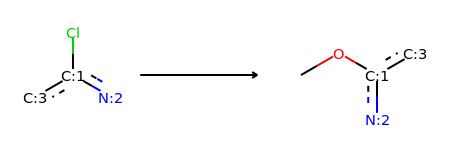

Product similarity 0.8360655737704918, overall 0.6919163369135105, smiles COc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


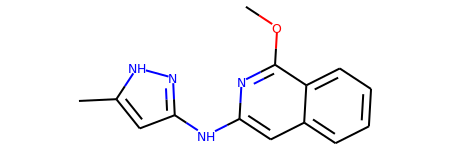

The proposed reaction is:


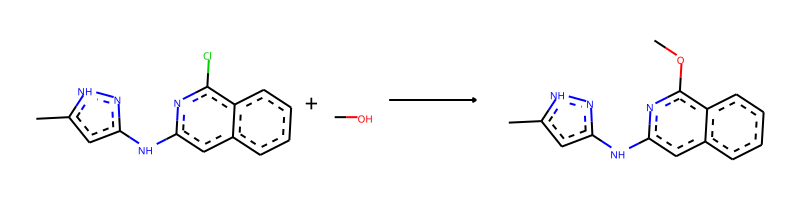

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CO>>COc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


--------------------------------------------------

Train index: 362085
RANK 45 PRECEDENT
REACTANT MATCH SCORE: 0.8275862068965517
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:21][c:22]2[n:23][nH:24][c:25]([CH3:27])[cH:26]2)[cH:13][c:14]2[c:15]([CH3:20])[cH:16][cH:17][cH:18][c:19]12>>Cc1ccc(O[c:10]2[n:11][c:12]([NH:21][c:22]3[n:23][nH:24][c:25]([CH3:27])[cH:26]3)[cH:13][c:14]3[c:15]([CH3:20])[cH:16][cH:17][cH:18][c:19]23)cc1


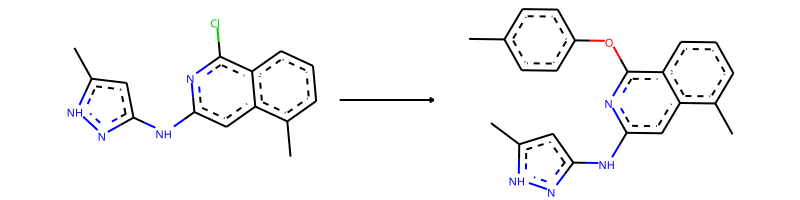

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


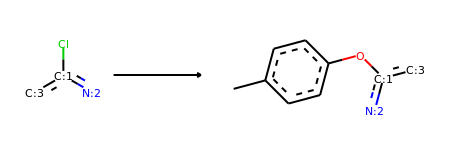

Product similarity 0.8734177215189873, overall 0.7228284591881274, smiles Cc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


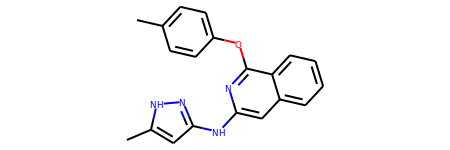

The proposed reaction is:


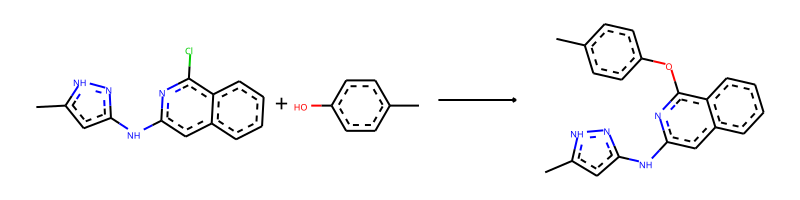

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1ccc(O)cc1>>Cc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 317705
RANK 46 PRECEDENT
REACTANT MATCH SCORE: 0.8275862068965517
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:13][c:14]2[n:15][nH:16][c:17]([CH3:19])[cH:18]2)[cH:5][c:6]2[c:7]([CH3:12])[cH:8][cH:9][cH:10][c:11]12>>CC(C)O[c:2]1[n:3][c:4]([NH:13][c:14]2[n:15][nH:16][c:17]([CH3:19])[cH:18]2)[cH:5][c:6]2[c:7]([CH3:12])[cH:8][cH:9][cH:10][c:11]12


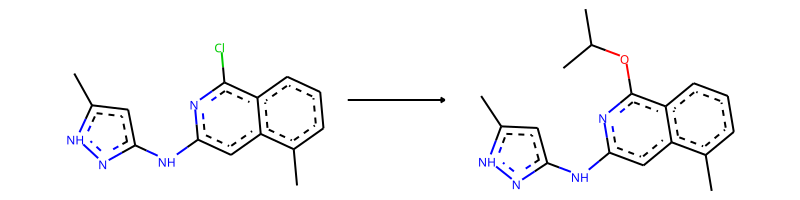

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(-C)-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


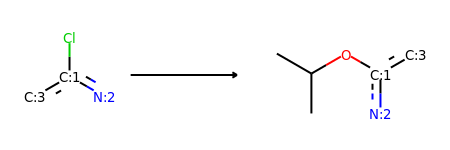

Product similarity 0.8484848484848485, overall 0.7021943573667712, smiles Cc1cc(Nc2cc3ccccc3c(OC(C)C)n2)n[nH]1


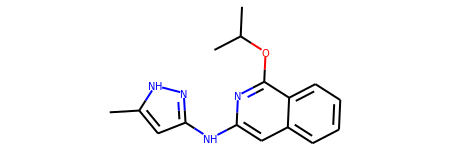

The proposed reaction is:


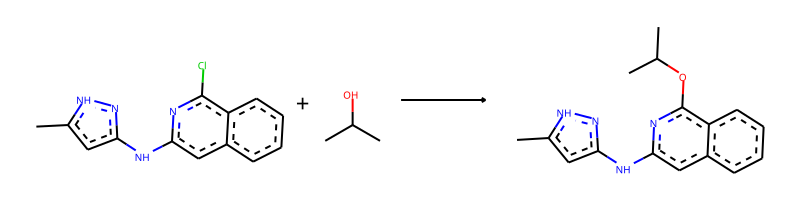

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(C)O>>Cc1cc(Nc2cc3ccccc3c(OC(C)C)n2)n[nH]1


--------------------------------------------------

Train index: 68492
RANK 47 PRECEDENT
REACTANT MATCH SCORE: 0.8275862068965517
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:21][c:22]2[n:23][nH:24][c:25]([CH3:27])[cH:26]2)[cH:13][c:14]2[c:15]([CH3:20])[cH:16][cH:17][cH:18][c:19]12>>Clc1ccc(O[c:10]2[n:11][c:12]([NH:21][c:22]3[n:23][nH:24][c:25]([CH3:27])[cH:26]3)[cH:13][c:14]3[c:15]([CH3:20])[cH:16][cH:17][cH:18][c:19]23)cc1


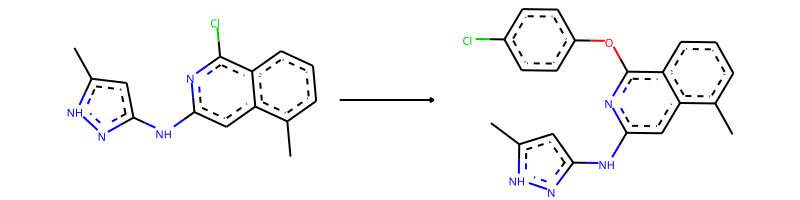

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


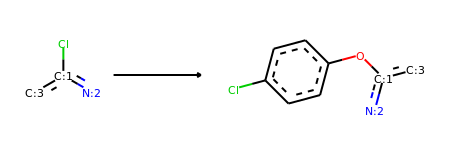

Product similarity 0.8734177215189873, overall 0.7228284591881274, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(Cl)cc3)n2)n[nH]1


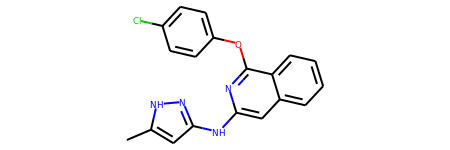

The proposed reaction is:


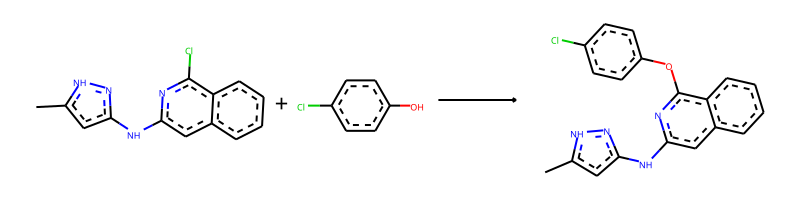

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(Cl)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(Cl)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 17886
RANK 48 PRECEDENT
REACTANT MATCH SCORE: 0.8275862068965517
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:21][c:22]2[n:23][nH:24][c:25]([CH3:27])[cH:26]2)[cH:13][c:14]2[c:15]([CH3:20])[cH:16][cH:17][cH:18][c:19]12>>Fc1ccc(O[c:10]2[n:11][c:12]([NH:21][c:22]3[n:23][nH:24][c:25]([CH3:27])[cH:26]3)[cH:13][c:14]3[c:15]([CH3:20])[cH:16][cH:17][cH:18][c:19]23)cc1


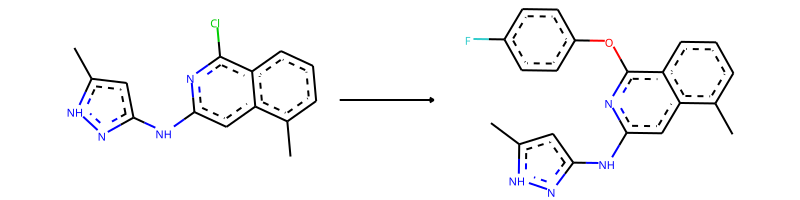

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


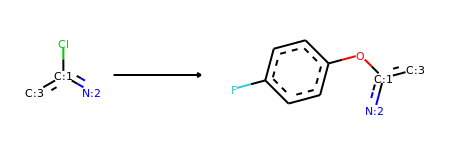

Product similarity 0.8734177215189873, overall 0.7228284591881274, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


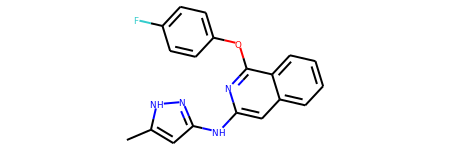

The proposed reaction is:


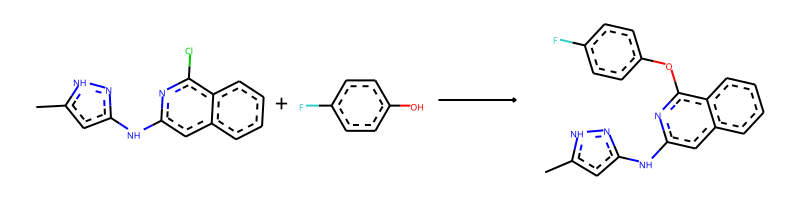

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(F)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 398944
RANK 49 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Cc1ccc(O[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


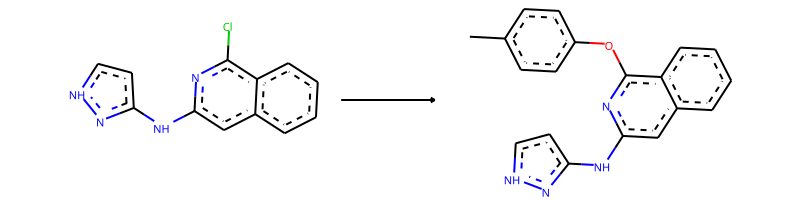

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


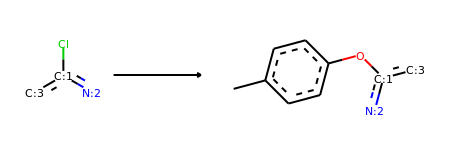

Product similarity 0.8701298701298701, overall 0.7147495361781075, smiles Cc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


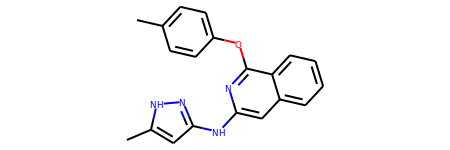

The proposed reaction is:


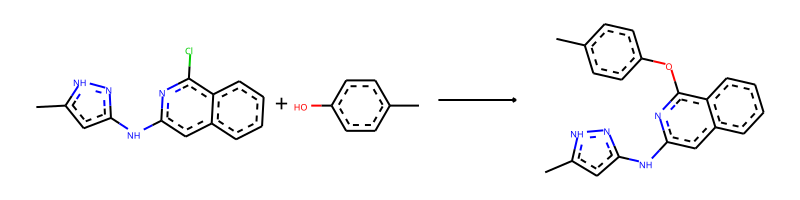

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1ccc(O)cc1>>Cc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 326331
RANK 50 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:13]1[n:14][c:15]([NH:23][c:24]2[n:25][nH:26][cH:27][cH:28]2)[cH:16][c:17]2[cH:18][cH:19][cH:20][cH:21][c:22]12>>CC(=O)Nc1ccc(O[c:13]2[n:14][c:15]([NH:23][c:24]3[n:25][nH:26][cH:27][cH:28]3)[cH:16][c:17]3[cH:18][cH:19][cH:20][cH:21][c:22]23)cc1


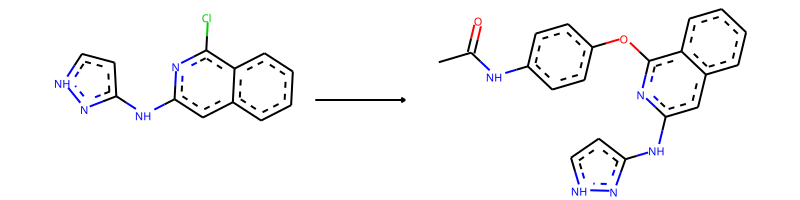

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(=O)-N-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


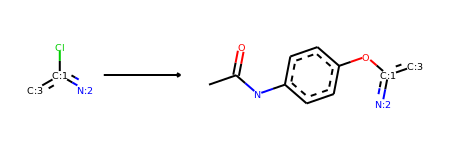

Product similarity 0.8823529411764706, overall 0.7247899159663865, smiles CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


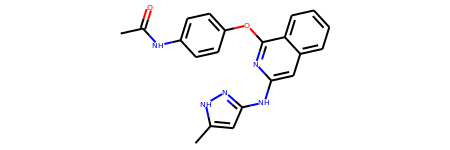

The proposed reaction is:


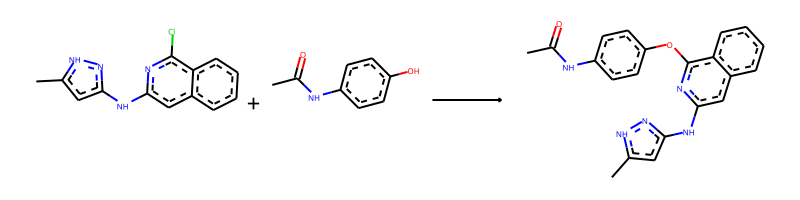

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(=O)Nc1ccc(O)cc1>>CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 308741
RANK 51 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>N#Cc1ccc(O[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


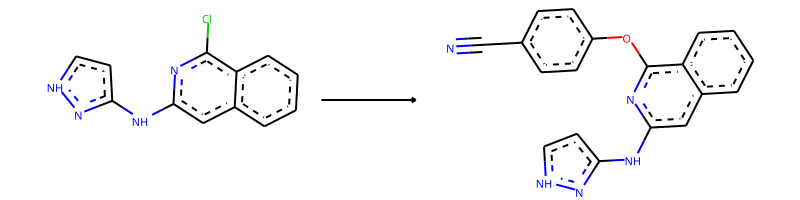

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>N#C-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


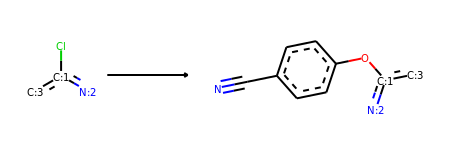

Product similarity 0.875, overall 0.71875, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(C#N)cc3)n2)n[nH]1


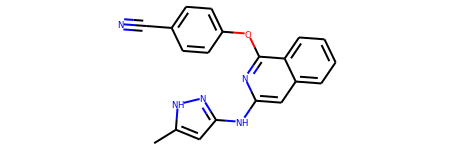

The proposed reaction is:


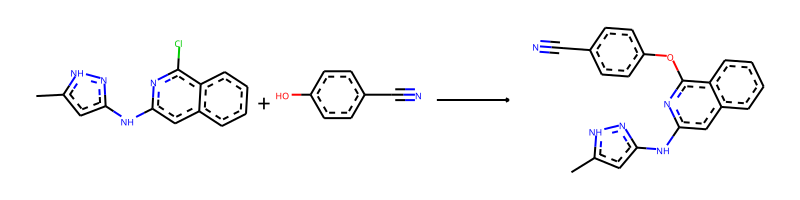

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.N#Cc1ccc(O)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(C#N)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 360285
RANK 52 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>CCOCCOCCO[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12


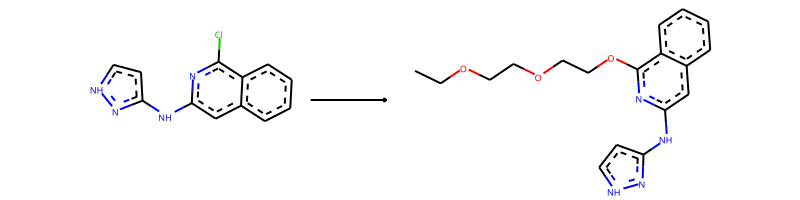

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C-O-C-C-O-C-C-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


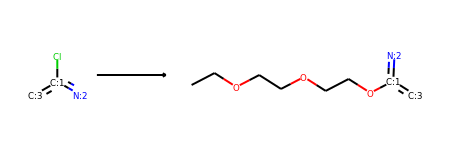

Product similarity 0.875, overall 0.71875, smiles CCOCCOCCOc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


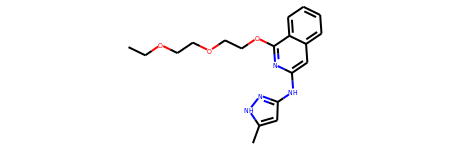

The proposed reaction is:


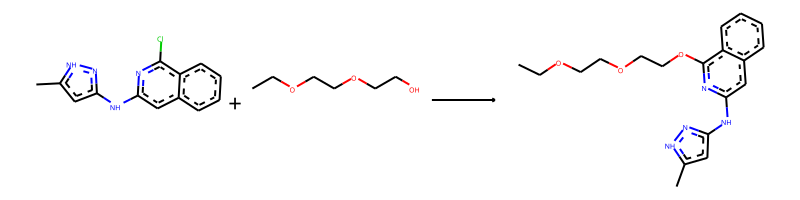

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CCOCCOCCO>>CCOCCOCCOc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


--------------------------------------------------

Train index: 166225
RANK 53 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>c1ccc(O[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


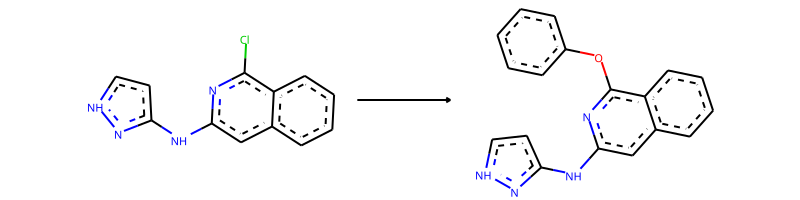

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-c1:c:c:c:c:c:1


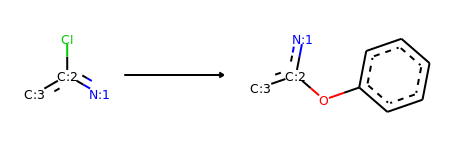

Product similarity 0.8666666666666667, overall 0.7119047619047619, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


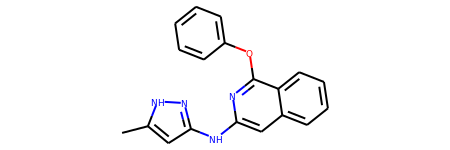

The proposed reaction is:


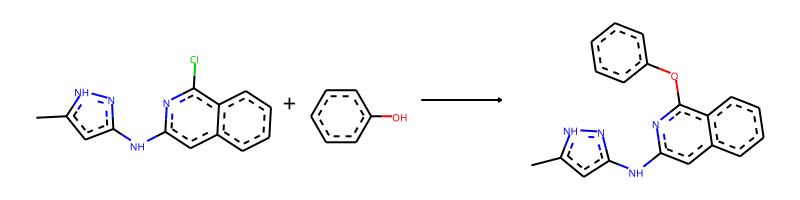

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 267017
RANK 54 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Clc1cccc(O[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)c1


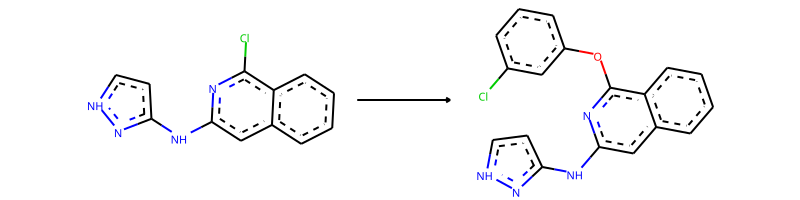

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


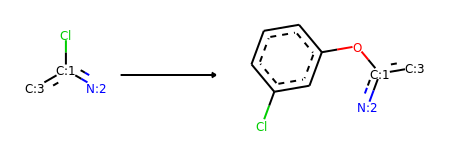

Product similarity 0.8701298701298701, overall 0.7147495361781075, smiles Cc1cc(Nc2cc3ccccc3c(Oc3cccc(Cl)c3)n2)n[nH]1


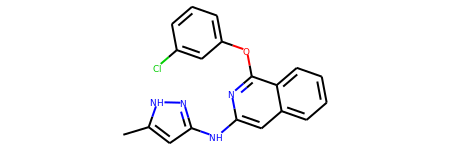

The proposed reaction is:


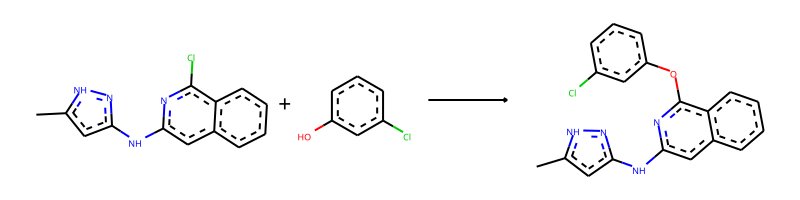

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1cccc(Cl)c1>>Cc1cc(Nc2cc3ccccc3c(Oc3cccc(Cl)c3)n2)n[nH]1


--------------------------------------------------

Train index: 74570
RANK 55 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Fc1ccccc1O[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12


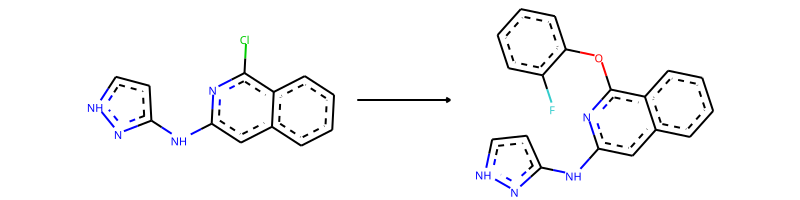

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c:c:1-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


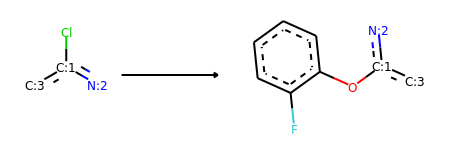

Product similarity 0.8701298701298701, overall 0.7147495361781075, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3F)n2)n[nH]1


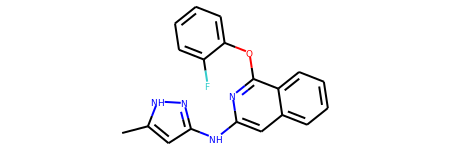

The proposed reaction is:


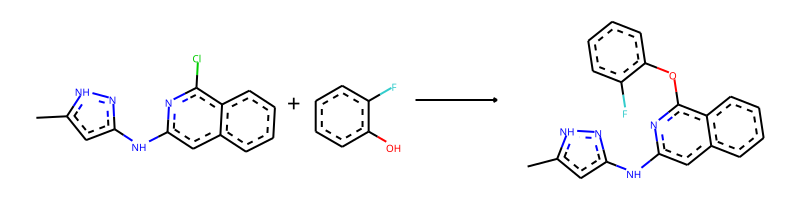

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1F>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3F)n2)n[nH]1


--------------------------------------------------

Train index: 371974
RANK 56 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Fc1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1F


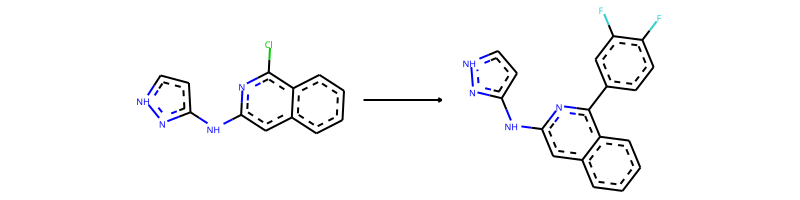

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1-F


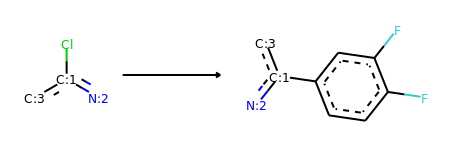

Product similarity 0.868421052631579, overall 0.7133458646616542, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)c(F)c3)n2)n[nH]1


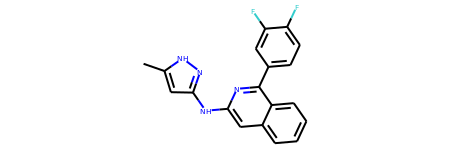

The proposed reaction is:


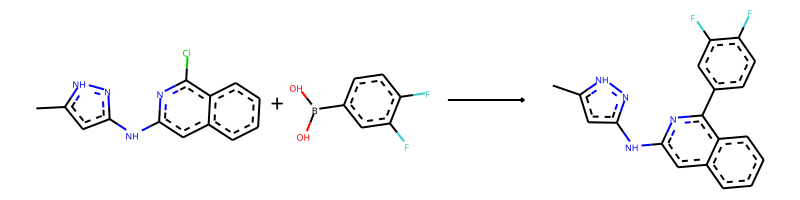

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(F)c(F)c1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)c(F)c3)n2)n[nH]1


--------------------------------------------------

Train index: 377390
RANK 57 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>CC(C)(C)c1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


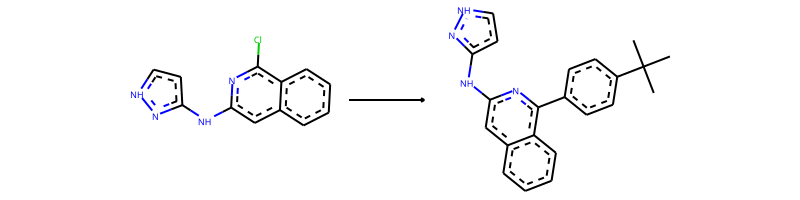

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(-C)(-C)-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


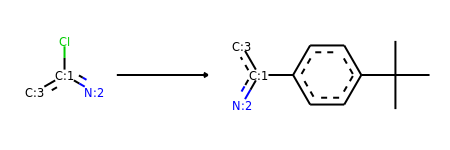

Product similarity 0.8765432098765432, overall 0.7200176366843033, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(C(C)(C)C)cc3)n2)n[nH]1


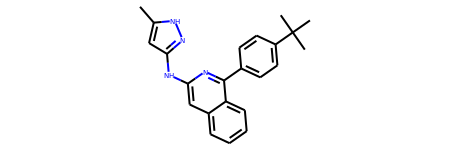

The proposed reaction is:


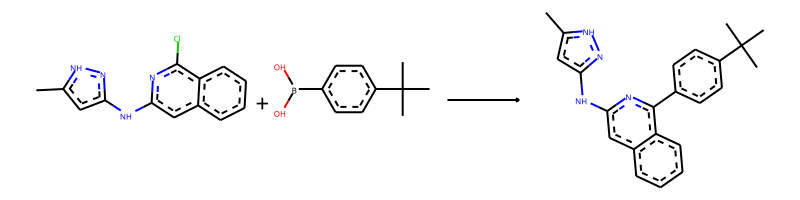

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(C)(C)c1ccc(B(O)O)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(C(C)(C)C)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 324490
RANK 58 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>COc1ccccc1O[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12


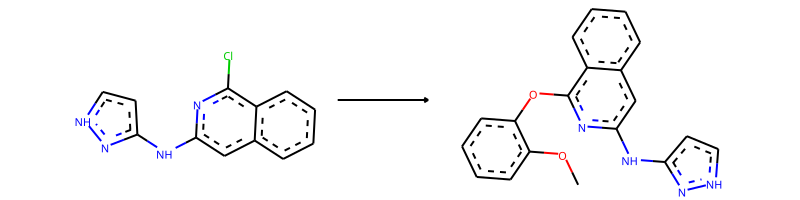

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-c1:c:c:c:c:c:1-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


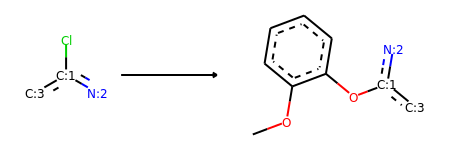

Product similarity 0.875, overall 0.71875, smiles COc1ccccc1Oc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


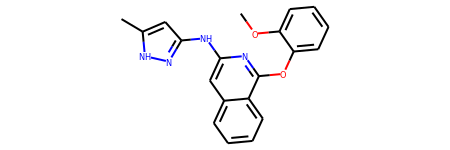

The proposed reaction is:


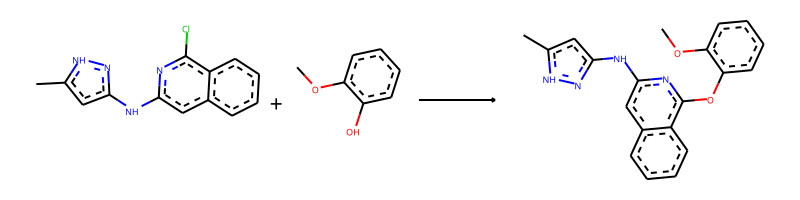

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.COc1ccccc1O>>COc1ccccc1Oc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


--------------------------------------------------

Train index: 66105
RANK 59 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>c1ccc(CO[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


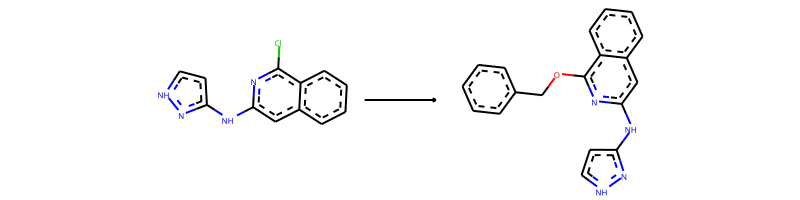

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-C-c1:c:c:c:c:c:1


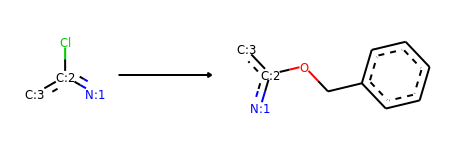

Product similarity 0.8717948717948718, overall 0.7161172161172161, smiles Cc1cc(Nc2cc3ccccc3c(OCc3ccccc3)n2)n[nH]1


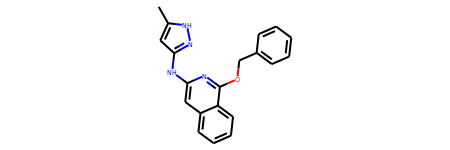

The proposed reaction is:


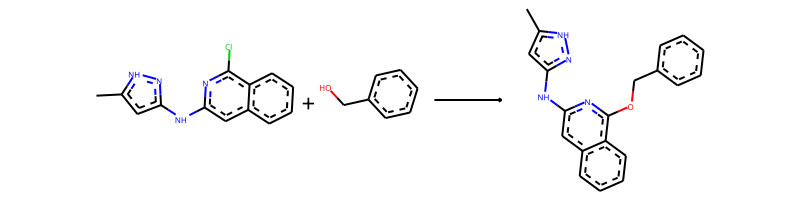

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OCc1ccccc1>>Cc1cc(Nc2cc3ccccc3c(OCc3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 248393
RANK 60 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>c1n[nH]cc1-[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12


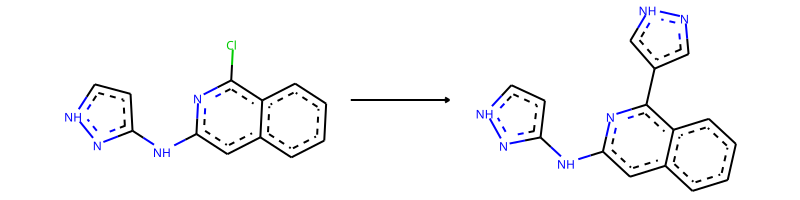

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:[nH]:n:c:1


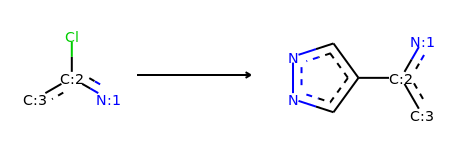

Product similarity 0.855072463768116, overall 0.7023809523809523, smiles Cc1cc(Nc2cc3ccccc3c(-c3cn[nH]c3)n2)n[nH]1


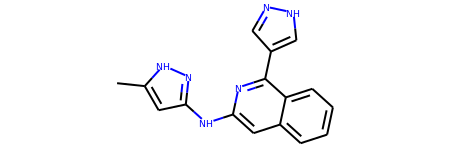

The proposed reaction is:


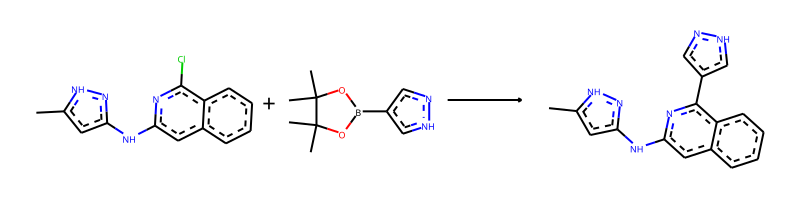

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC1(C)OB(c2cn[nH]c2)OC1(C)C>>Cc1cc(Nc2cc3ccccc3c(-c3cn[nH]c3)n2)n[nH]1


--------------------------------------------------

Train index: 106848
RANK 61 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>CO[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12


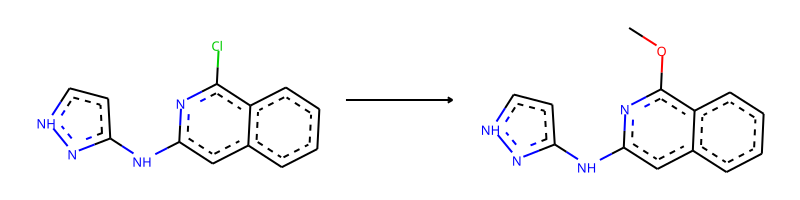

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


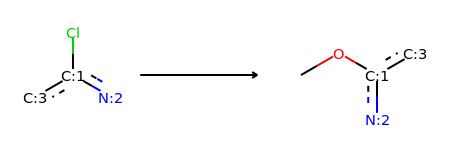

Product similarity 0.8305084745762712, overall 0.6822033898305084, smiles COc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


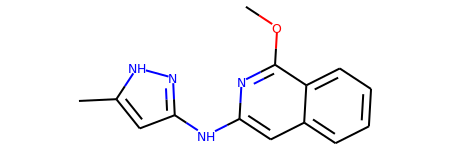

The proposed reaction is:


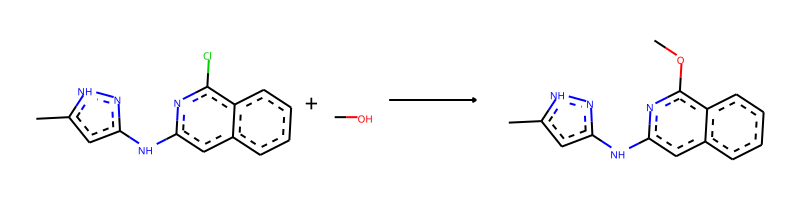

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CO>>COc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


--------------------------------------------------

Train index: 411443
RANK 62 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Fc1ccc(O[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


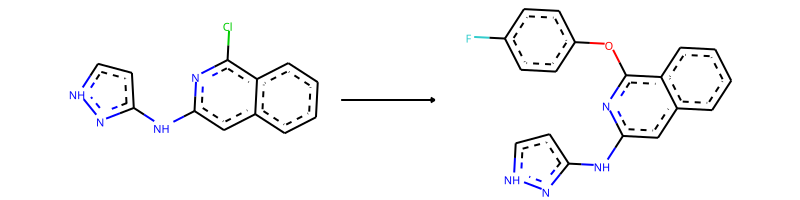

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


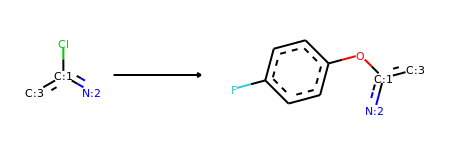

Product similarity 0.8701298701298701, overall 0.7147495361781075, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


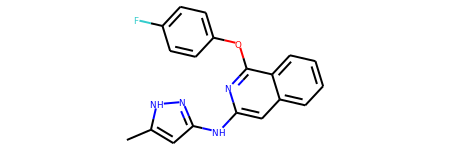

The proposed reaction is:


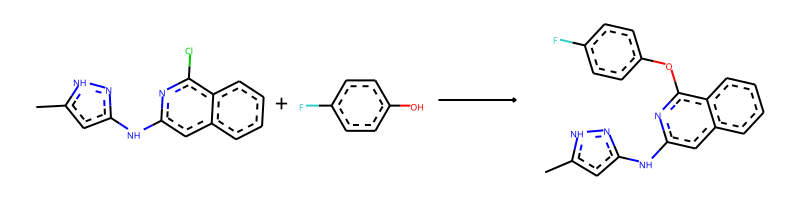

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(F)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 305392
RANK 63 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Cc1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


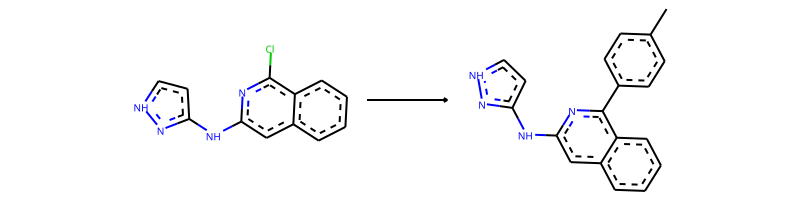

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


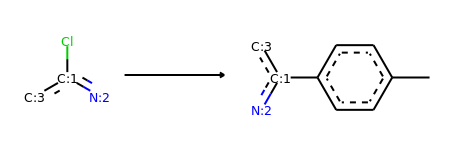

Product similarity 0.8648648648648649, overall 0.7104247104247104, smiles Cc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


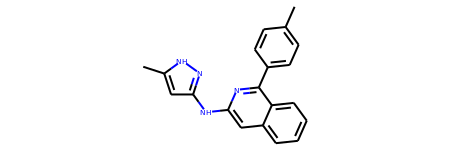

The proposed reaction is:


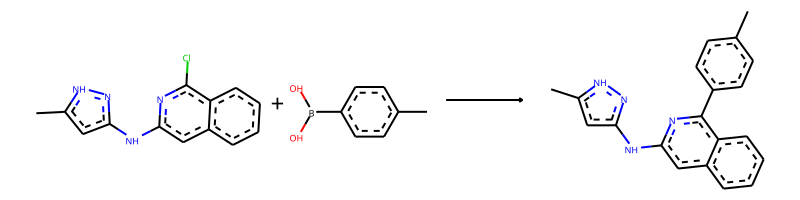

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1ccc(B(O)O)cc1>>Cc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 26989
RANK 64 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>CC(C)O[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12


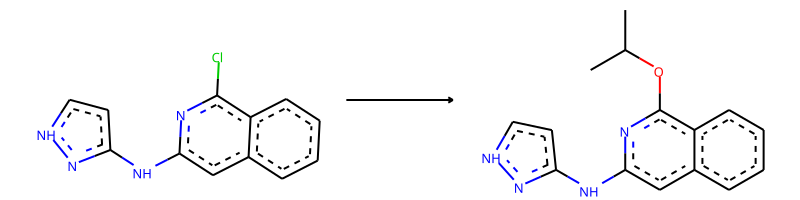

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(-C)-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


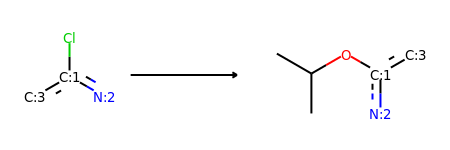

Product similarity 0.84375, overall 0.6930803571428571, smiles Cc1cc(Nc2cc3ccccc3c(OC(C)C)n2)n[nH]1


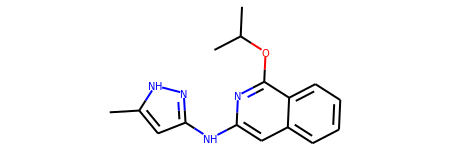

The proposed reaction is:


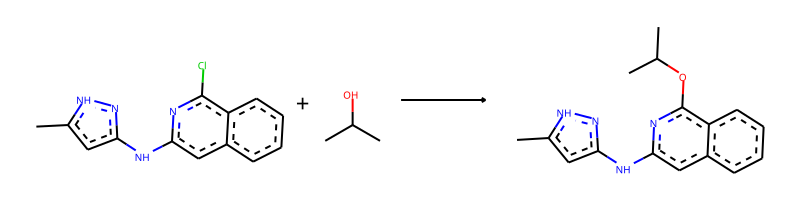

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(C)O>>Cc1cc(Nc2cc3ccccc3c(OC(C)C)n2)n[nH]1


--------------------------------------------------

Train index: 15347
RANK 65 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Fc1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)c(F)c1


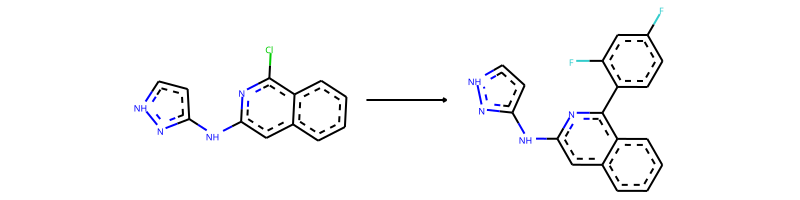

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c(-F):c:1


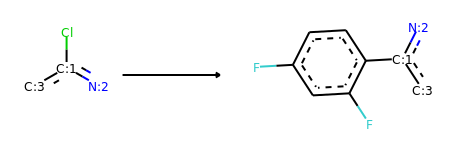

Product similarity 0.868421052631579, overall 0.7133458646616542, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3F)n2)n[nH]1


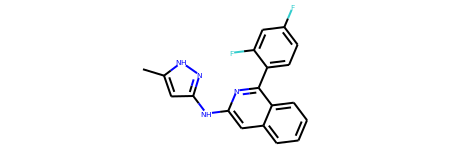

The proposed reaction is:


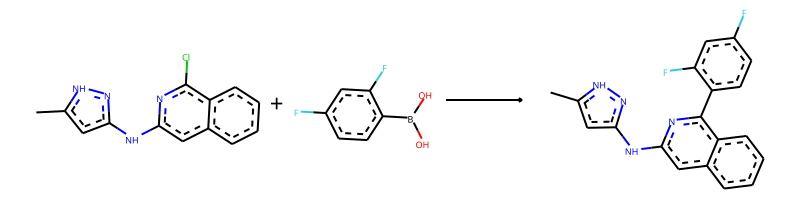

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(F)cc1F>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3F)n2)n[nH]1


--------------------------------------------------

Train index: 258474
RANK 66 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>FC(F)(F)c1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


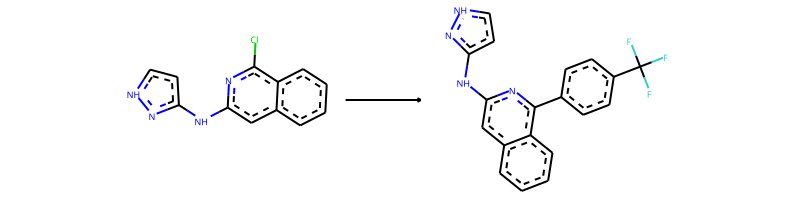

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-C(-F)(-F)-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


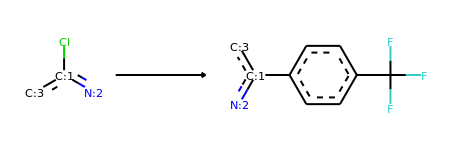

Product similarity 0.8765432098765432, overall 0.7200176366843033, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(C(F)(F)F)cc3)n2)n[nH]1


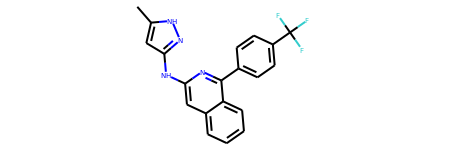

The proposed reaction is:


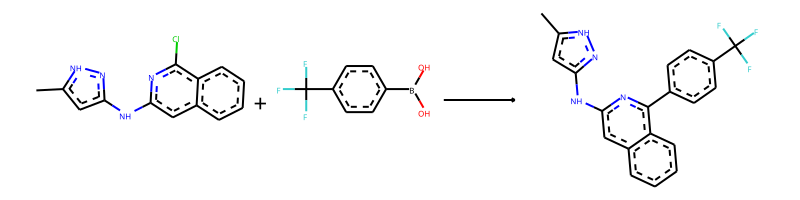

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(C(F)(F)F)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(C(F)(F)F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 3704
RANK 67 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>CC(=O)c1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


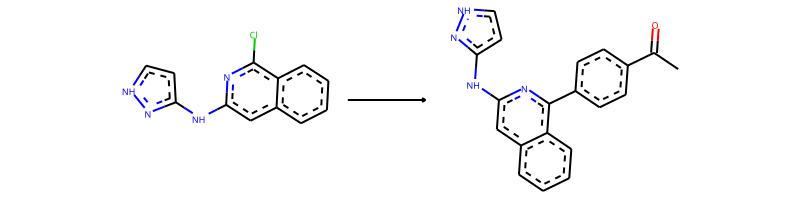

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(=O)-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


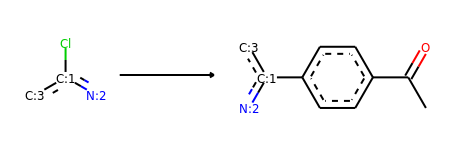

Product similarity 0.8734177215189873, overall 0.7174502712477395, smiles CC(=O)c1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


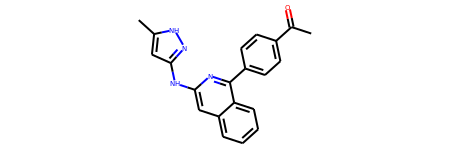

The proposed reaction is:


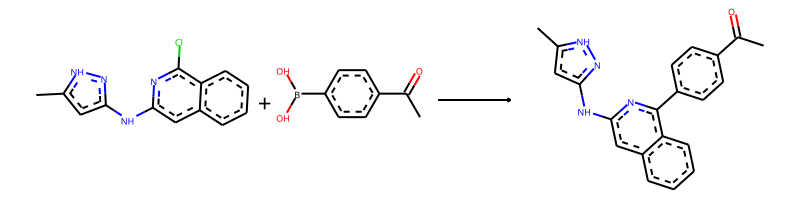

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(=O)c1ccc(B(O)O)cc1>>CC(=O)c1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 91067
RANK 68 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Clc1ccc(O[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


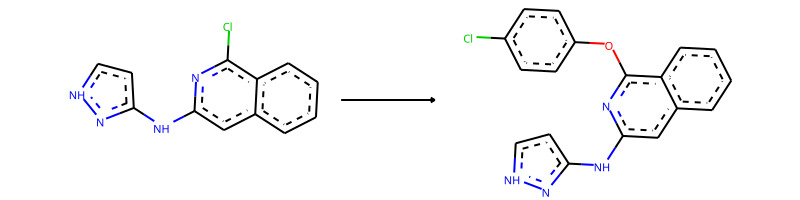

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


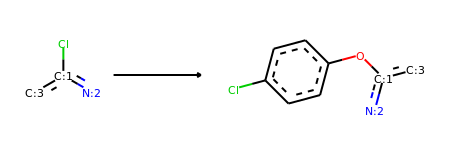

Product similarity 0.8701298701298701, overall 0.7147495361781075, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(Cl)cc3)n2)n[nH]1


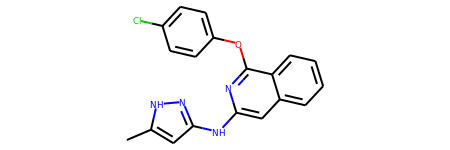

The proposed reaction is:


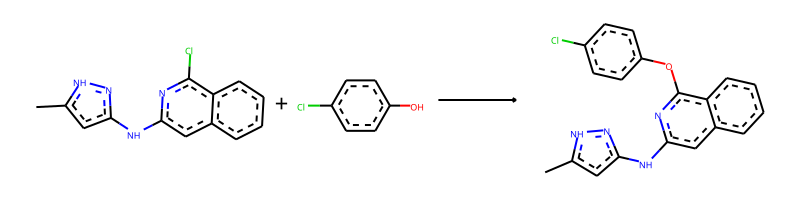

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(Cl)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(Cl)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 275729
RANK 69 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Fc1cccc(O[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)c1


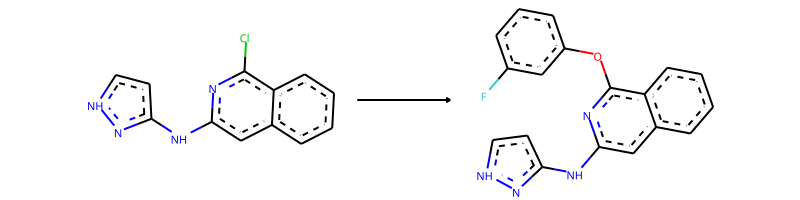

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


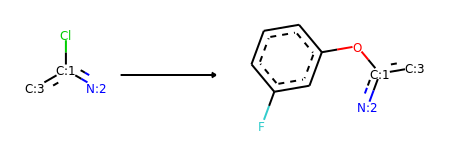

Product similarity 0.8701298701298701, overall 0.7147495361781075, smiles Cc1cc(Nc2cc3ccccc3c(Oc3cccc(F)c3)n2)n[nH]1


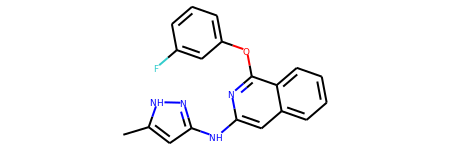

The proposed reaction is:


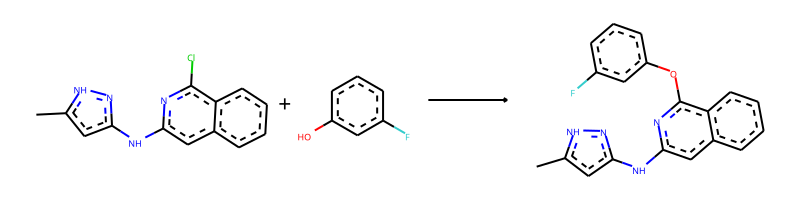

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1cccc(F)c1>>Cc1cc(Nc2cc3ccccc3c(Oc3cccc(F)c3)n2)n[nH]1


--------------------------------------------------

Train index: 476017
RANK 70 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>c1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


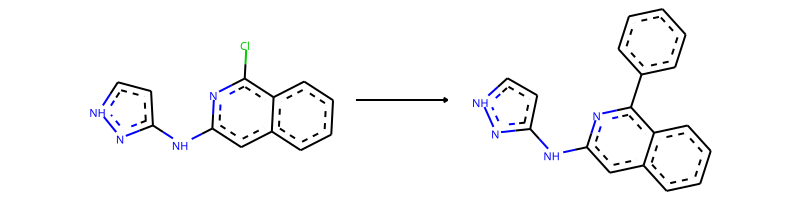

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:c:c:c:c:1


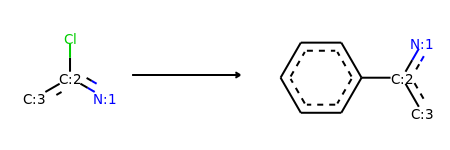

Product similarity 0.8611111111111112, overall 0.7073412698412699, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccccc3)n2)n[nH]1


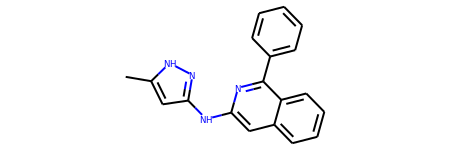

The proposed reaction is:


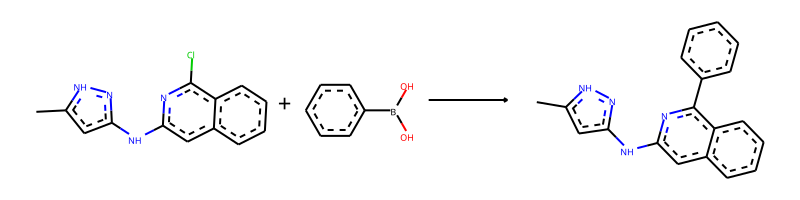

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccccc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 150241
RANK 71 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>CCOc1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


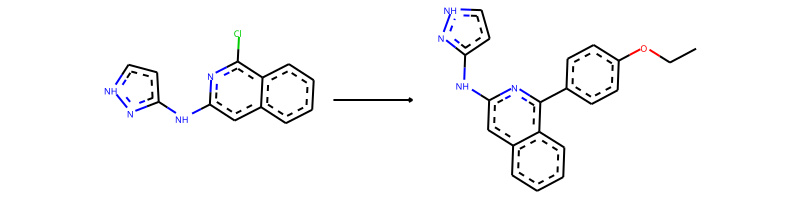

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C-O-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


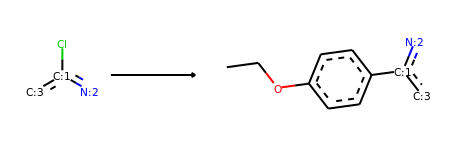

Product similarity 0.875, overall 0.71875, smiles CCOc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


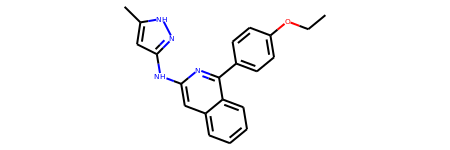

The proposed reaction is:


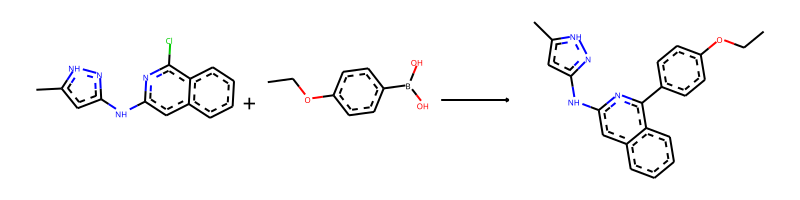

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CCOc1ccc(B(O)O)cc1>>CCOc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 135631
RANK 72 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>c1cc(N[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)ccn1


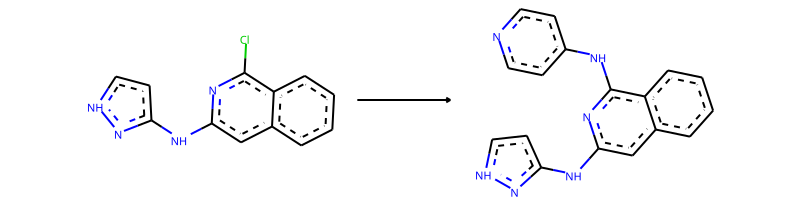

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-N-c1:c:c:n:c:c:1


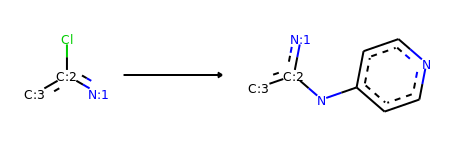

Product similarity 0.8666666666666667, overall 0.7119047619047619, smiles Cc1cc(Nc2cc3ccccc3c(Nc3ccncc3)n2)n[nH]1


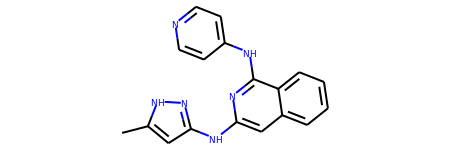

The proposed reaction is:


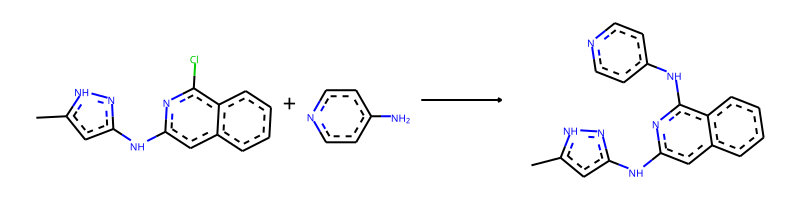

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Nc1ccncc1>>Cc1cc(Nc2cc3ccccc3c(Nc3ccncc3)n2)n[nH]1


--------------------------------------------------

Train index: 286744
RANK 73 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Fc1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


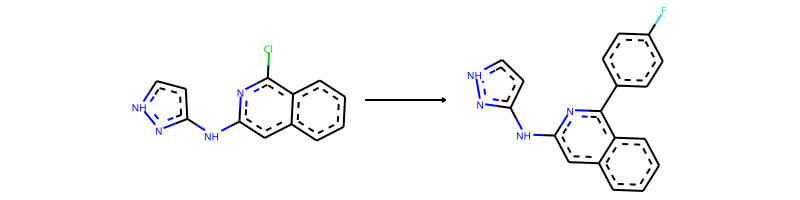

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


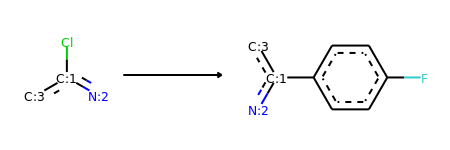

Product similarity 0.8648648648648649, overall 0.7104247104247104, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3)n2)n[nH]1


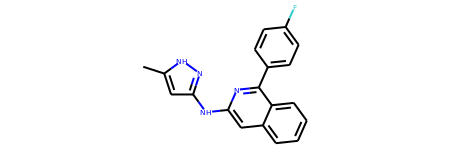

The proposed reaction is:


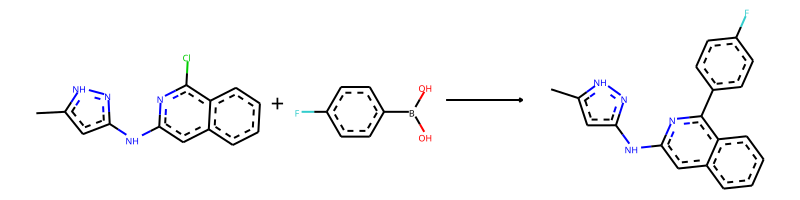

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(F)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 192547
RANK 74 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>COc1ccccc1-[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12


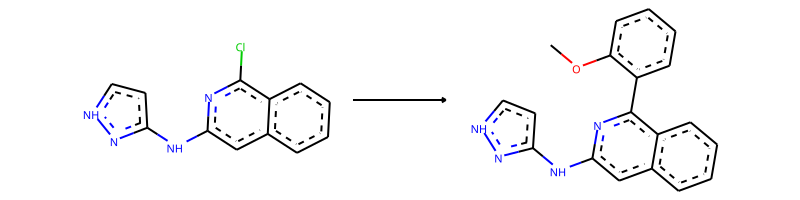

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-c1:c:c:c:c:c:1-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


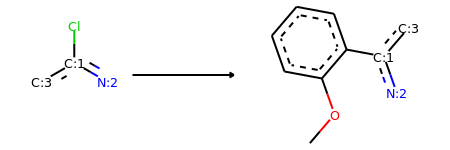

Product similarity 0.8701298701298701, overall 0.7147495361781075, smiles COc1ccccc1-c1nc(Nc2cc(C)[nH]n2)cc2ccccc12


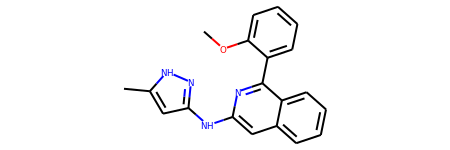

The proposed reaction is:


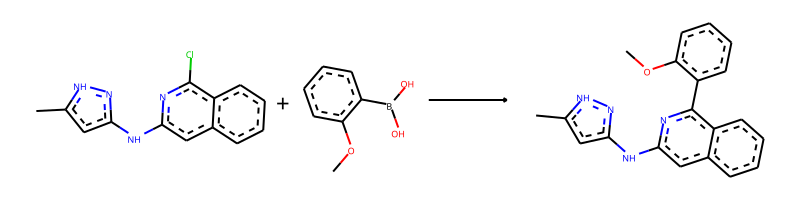

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.COc1ccccc1B(O)O>>COc1ccccc1-c1nc(Nc2cc(C)[nH]n2)cc2ccccc12


--------------------------------------------------

Train index: 255681
RANK 75 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>N#Cc1ccc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cc1


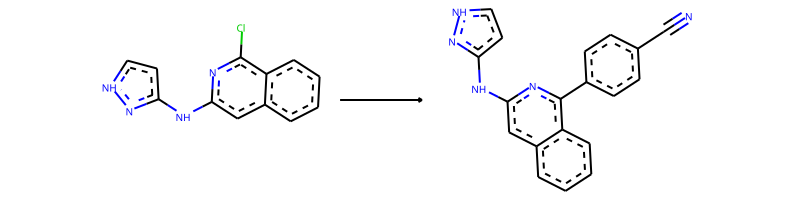

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>N#C-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


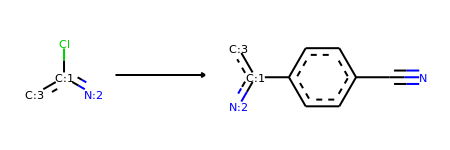

Product similarity 0.8701298701298701, overall 0.7147495361781075, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(C#N)cc3)n2)n[nH]1


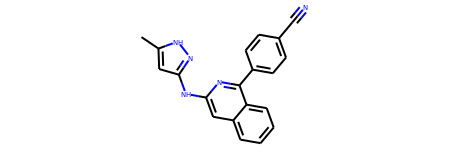

The proposed reaction is:


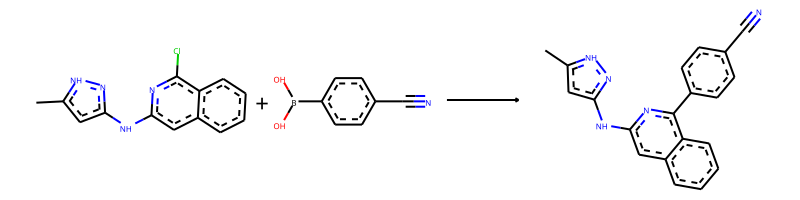

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.N#Cc1ccc(B(O)O)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(C#N)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 107254
RANK 76 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>N#Cc1cccc(O[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)c1


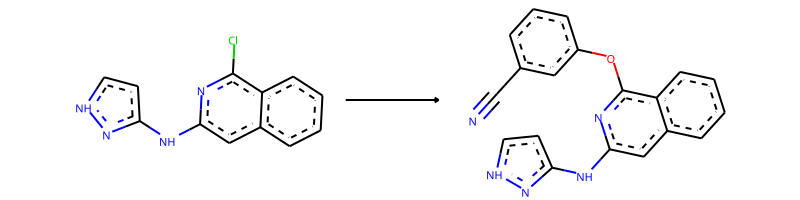

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>N#C-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


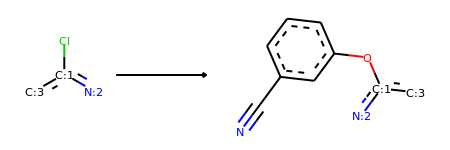

Product similarity 0.875, overall 0.71875, smiles Cc1cc(Nc2cc3ccccc3c(Oc3cccc(C#N)c3)n2)n[nH]1


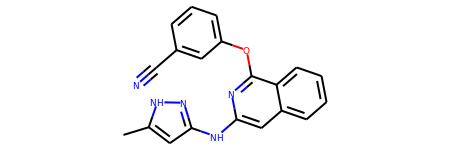

The proposed reaction is:


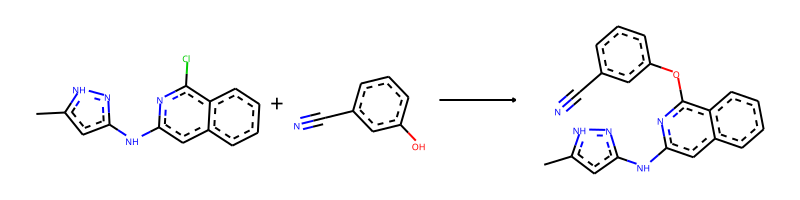

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.N#Cc1cccc(O)c1>>Cc1cc(Nc2cc3ccccc3c(Oc3cccc(C#N)c3)n2)n[nH]1


--------------------------------------------------

Train index: 7314
RANK 77 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>c1cc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)ccn1


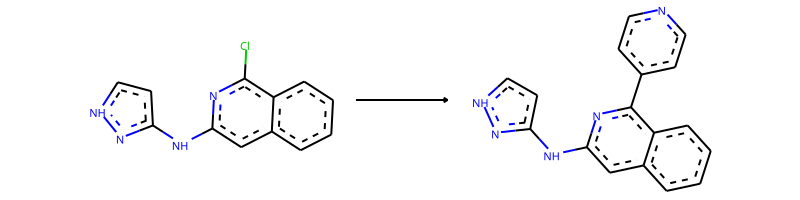

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:c:n:c:c:1


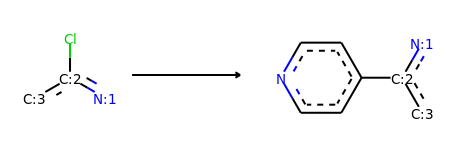

Product similarity 0.8611111111111112, overall 0.7073412698412699, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccncc3)n2)n[nH]1


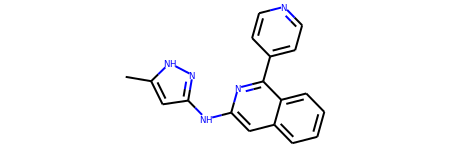

The proposed reaction is:


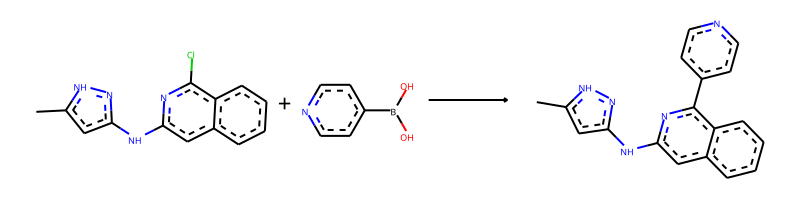

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccncc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccncc3)n2)n[nH]1


--------------------------------------------------

Train index: 18349
RANK 78 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Cn1cc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)cn1


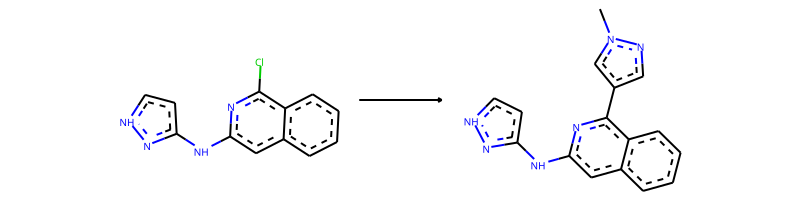

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-n1:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:n:1


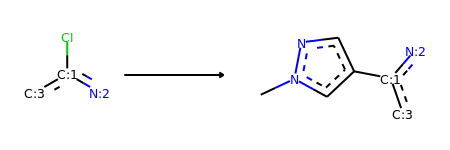

Product similarity 0.8591549295774648, overall 0.7057344064386317, smiles Cc1cc(Nc2cc3ccccc3c(-c3cnn(C)c3)n2)n[nH]1


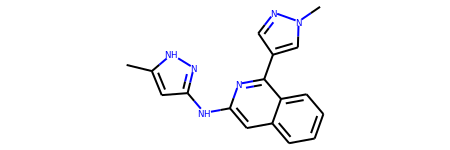

The proposed reaction is:


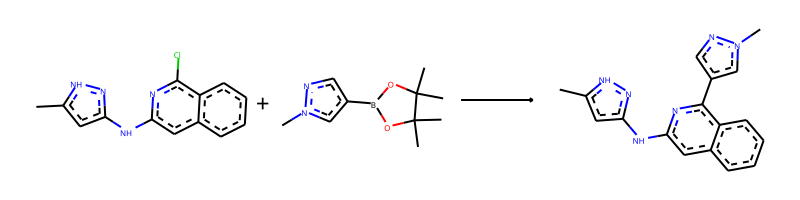

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cn1cc(B2OC(C)(C)C(C)(C)O2)cn1>>Cc1cc(Nc2cc3ccccc3c(-c3cnn(C)c3)n2)n[nH]1


--------------------------------------------------

Train index: 183143
RANK 79 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>c1cncc(-[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)c1


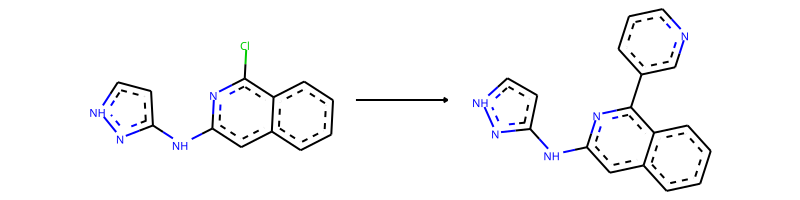

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:c:c:n:c:1


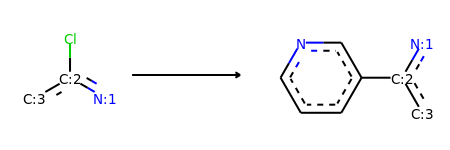

Product similarity 0.8611111111111112, overall 0.7073412698412699, smiles Cc1cc(Nc2cc3ccccc3c(-c3cccnc3)n2)n[nH]1


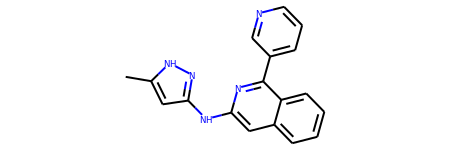

The proposed reaction is:


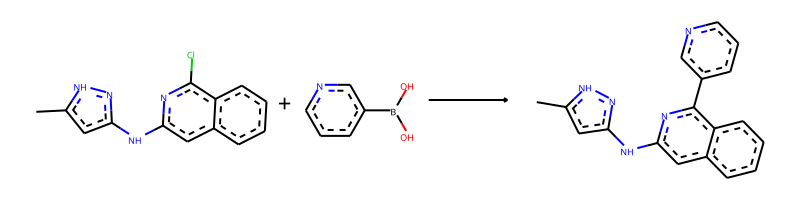

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1cccnc1>>Cc1cc(Nc2cc3ccccc3c(-c3cccnc3)n2)n[nH]1


--------------------------------------------------

Train index: 133801
RANK 80 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>CC(C)CO[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12


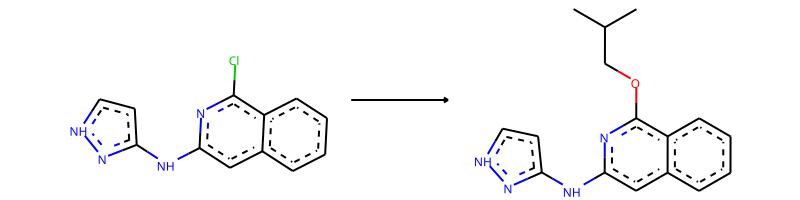

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(-C)-C-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


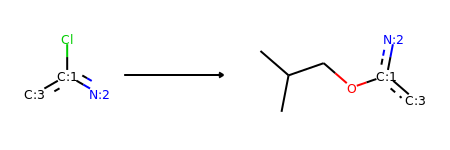

Product similarity 0.8507462686567164, overall 0.6988272921108741, smiles Cc1cc(Nc2cc3ccccc3c(OCC(C)C)n2)n[nH]1


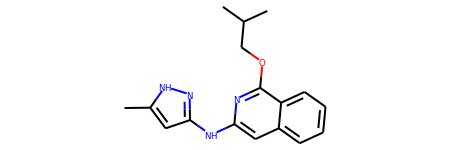

The proposed reaction is:


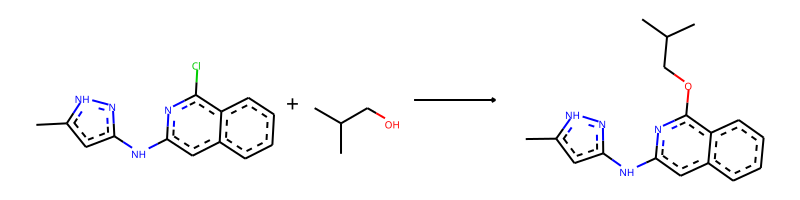

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(C)CO>>Cc1cc(Nc2cc3ccccc3c(OCC(C)C)n2)n[nH]1


--------------------------------------------------

Train index: 260790
RANK 81 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Clc1ccccc1O[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12


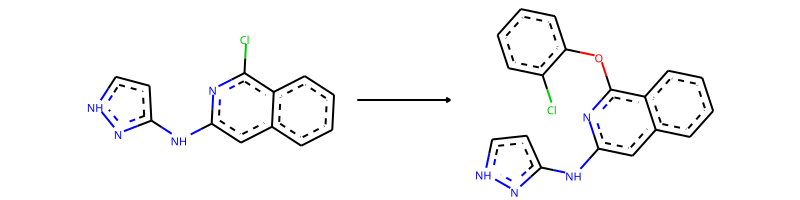

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c:c:c:1-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


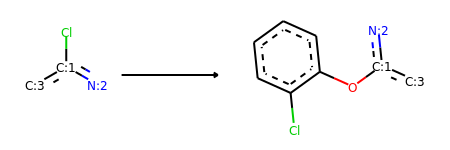

Product similarity 0.8701298701298701, overall 0.7147495361781075, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3Cl)n2)n[nH]1


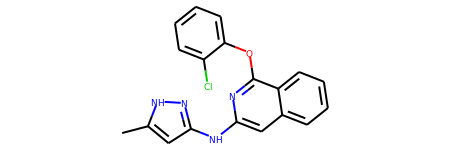

The proposed reaction is:


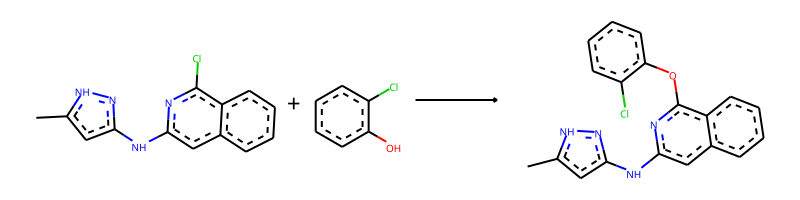

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1Cl>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3Cl)n2)n[nH]1


--------------------------------------------------

Train index: 245382
RANK 82 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>Fc1ccccc1-[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12


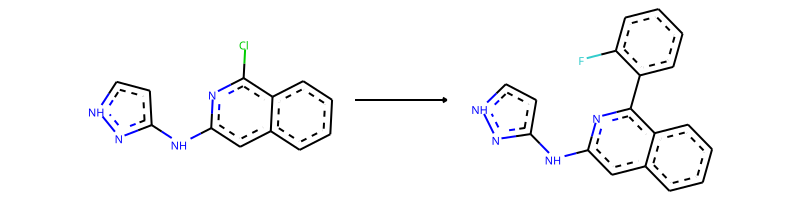

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c:c:1-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


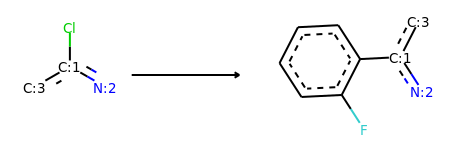

Product similarity 0.8648648648648649, overall 0.7104247104247104, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccccc3F)n2)n[nH]1


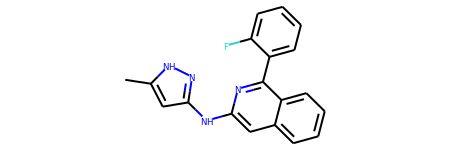

The proposed reaction is:


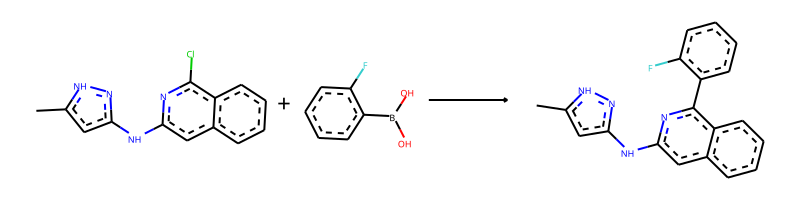

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccccc1F>>Cc1cc(Nc2cc3ccccc3c(-c3ccccc3F)n2)n[nH]1


--------------------------------------------------

Train index: 413963
RANK 83 PRECEDENT
REACTANT MATCH SCORE: 0.8214285714285714
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:12][c:13]2[n:14][nH:15][cH:16][cH:17]2)[cH:5][c:6]2[cH:7][cH:8][cH:9][cH:10][c:11]12>>COc1cccc(O[c:2]2[n:3][c:4]([NH:12][c:13]3[n:14][nH:15][cH:16][cH:17]3)[cH:5][c:6]3[cH:7][cH:8][cH:9][cH:10][c:11]23)c1


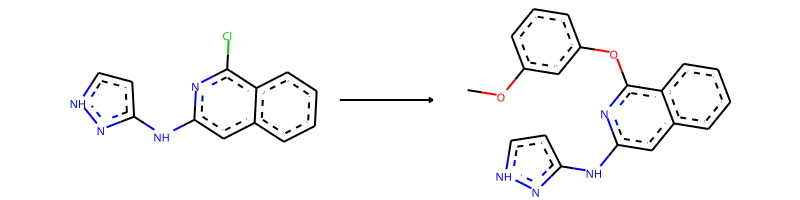

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


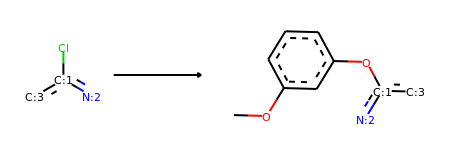

Product similarity 0.875, overall 0.71875, smiles COc1cccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


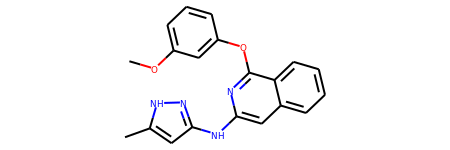

The proposed reaction is:


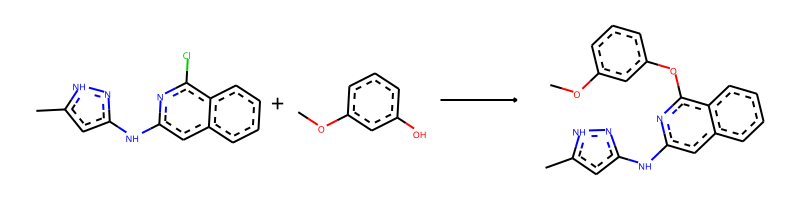

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.COc1cccc(O)c1>>COc1cccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


--------------------------------------------------

Train index: 458900
RANK 84 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>N#Cc1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


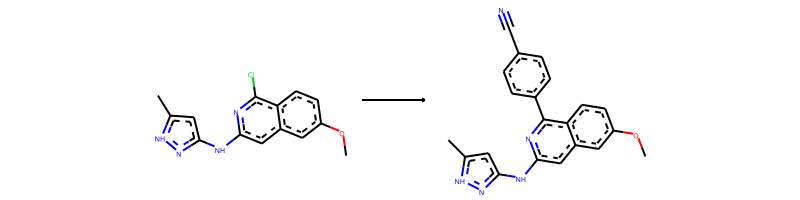

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>N#C-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


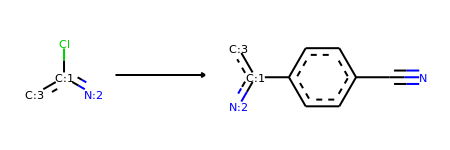

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(C#N)cc3)n2)n[nH]1


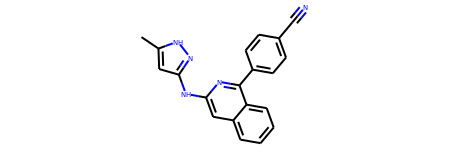

The proposed reaction is:


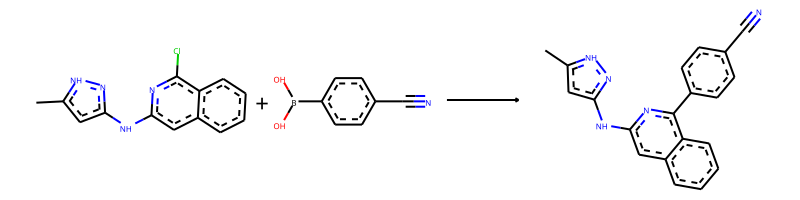

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.N#Cc1ccc(B(O)O)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(C#N)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 221581
RANK 85 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:11]1[n:12][c:13]([NH:23][c:24]2[n:25][nH:26][c:27]([CH3:29])[cH:28]2)[cH:14][c:15]2[cH:16][c:17]([O:21][CH3:22])[cH:18][cH:19][c:20]12>>C1CCN(CCO[c:11]2[n:12][c:13]([NH:23][c:24]3[n:25][nH:26][c:27]([CH3:29])[cH:28]3)[cH:14][c:15]3[cH:16][c:17]([O:21][CH3:22])[cH:18][cH:19][c:20]23)CC1


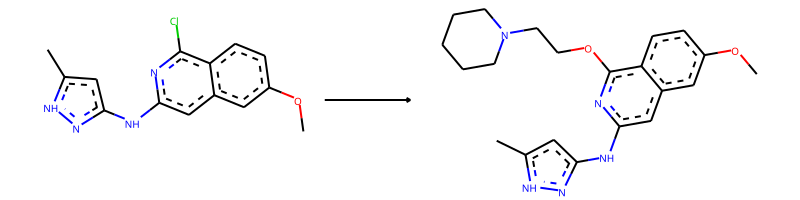

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-C-C-N1-C-C-C-C-C-1


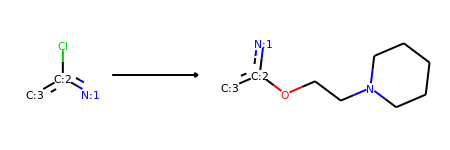

Product similarity 0.8488372093023255, overall 0.6679374761723217, smiles Cc1cc(Nc2cc3ccccc3c(OCCN3CCCCC3)n2)n[nH]1


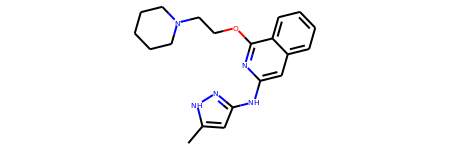

The proposed reaction is:


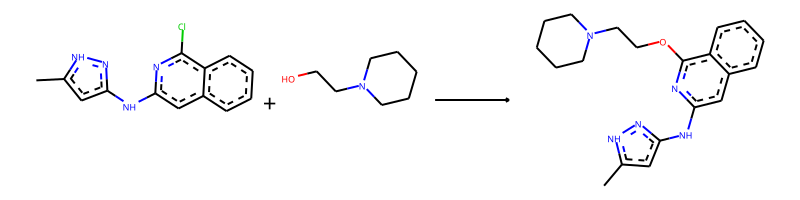

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OCCN1CCCCC1>>Cc1cc(Nc2cc3ccccc3c(OCCN3CCCCC3)n2)n[nH]1


--------------------------------------------------

Train index: 396611
RANK 86 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12>>Clc1ccc(S[c:10]2[n:11][c:12]([NH:22][c:23]3[n:24][nH:25][c:26]([CH3:28])[cH:27]3)[cH:13][c:14]3[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]23)cc1


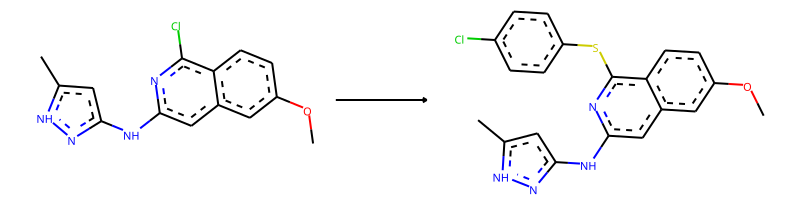

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c(-S-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


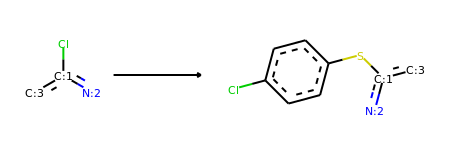

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(Sc3ccc(Cl)cc3)n2)n[nH]1


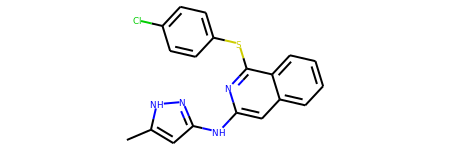

The proposed reaction is:


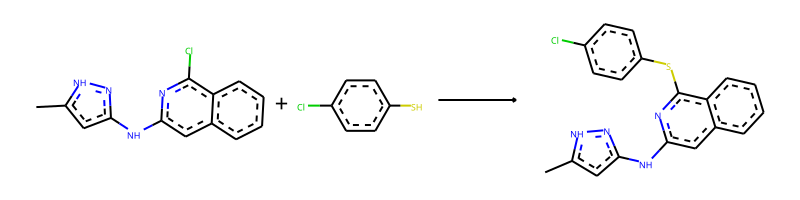

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Sc1ccc(Cl)cc1>>Cc1cc(Nc2cc3ccccc3c(Sc3ccc(Cl)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 310641
RANK 87 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12>>c1ccc(CO[c:10]2[n:11][c:12]([NH:22][c:23]3[n:24][nH:25][c:26]([CH3:28])[cH:27]3)[cH:13][c:14]3[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]23)cc1


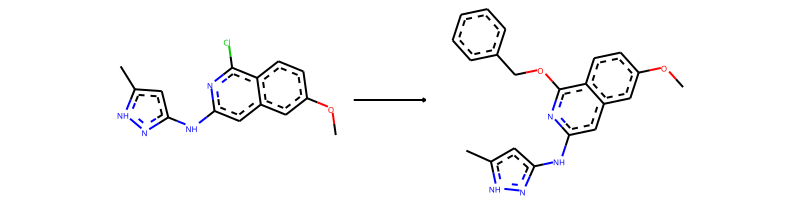

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-C-c1:c:c:c:c:c:1


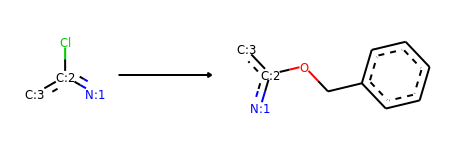

Product similarity 0.8433734939759037, overall 0.6636381591941537, smiles Cc1cc(Nc2cc3ccccc3c(OCc3ccccc3)n2)n[nH]1


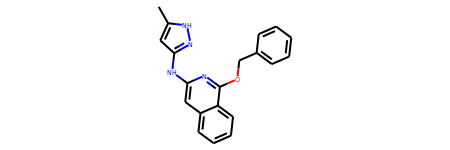

The proposed reaction is:


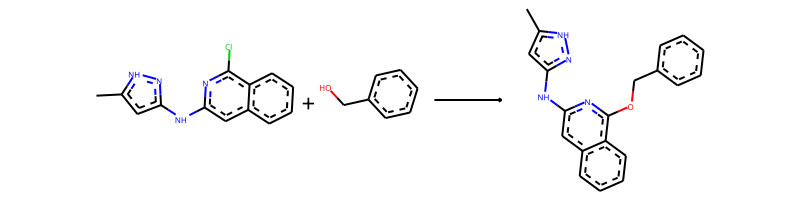

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OCc1ccccc1>>Cc1cc(Nc2cc3ccccc3c(OCc3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 134830
RANK 88 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[c:7]([O:12][CH3:13])[cH:8][cH:9][cH:10][c:11]12>>Fc1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[c:7]([O:12][CH3:13])[cH:8][cH:9][cH:10][c:11]23)c(F)c1


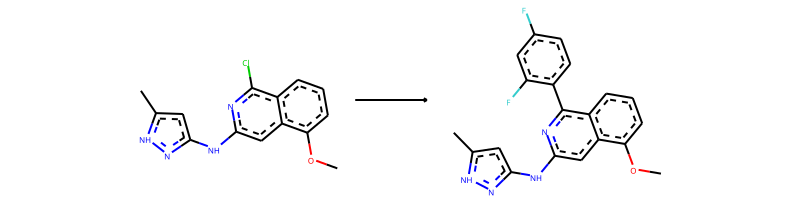

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c(-F):c:1


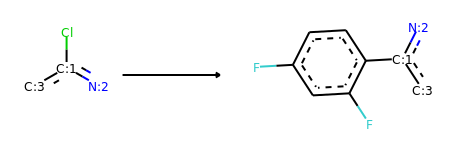

Product similarity 0.8395061728395061, overall 0.6605950212507589, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3F)n2)n[nH]1


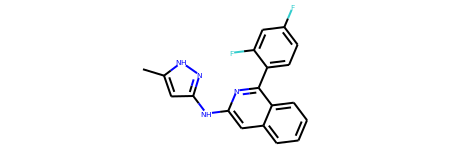

The proposed reaction is:


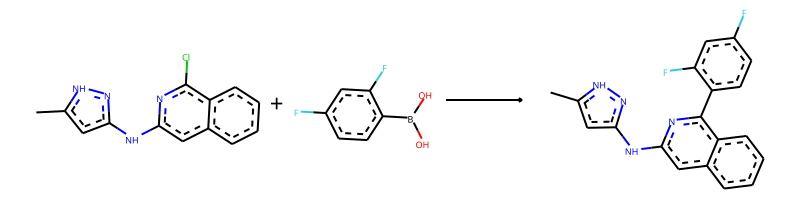

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(F)cc1F>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3F)n2)n[nH]1


--------------------------------------------------

Train index: 128142
RANK 89 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>CCOc1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


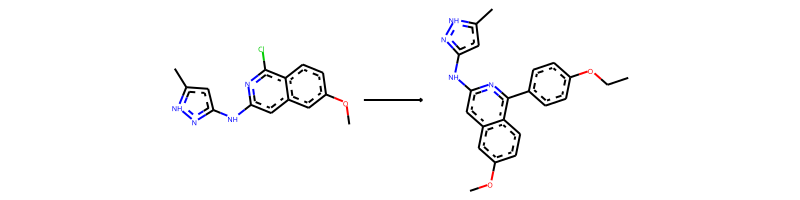

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C-O-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


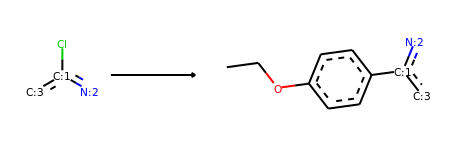

Product similarity 0.8470588235294118, overall 0.6665380906460945, smiles CCOc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


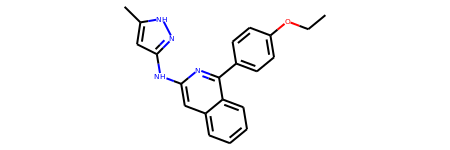

The proposed reaction is:


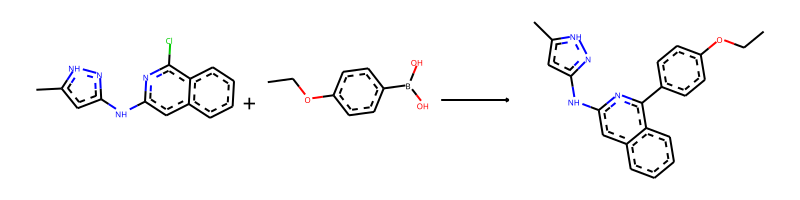

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CCOc1ccc(B(O)O)cc1>>CCOc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 356012
RANK 90 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>c1n[nH]cc1-[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12


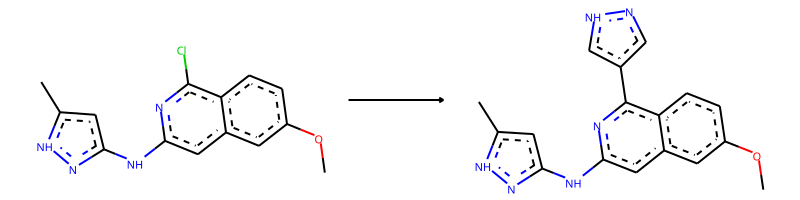

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:[nH]:n:c:1


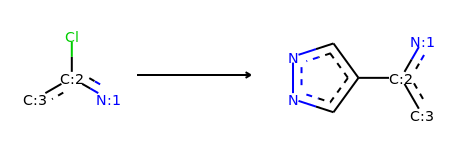

Product similarity 0.8243243243243243, overall 0.6486486486486487, smiles Cc1cc(Nc2cc3ccccc3c(-c3cn[nH]c3)n2)n[nH]1


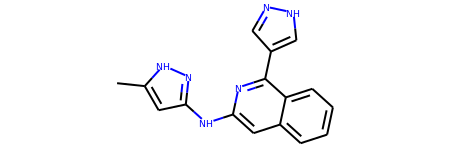

The proposed reaction is:


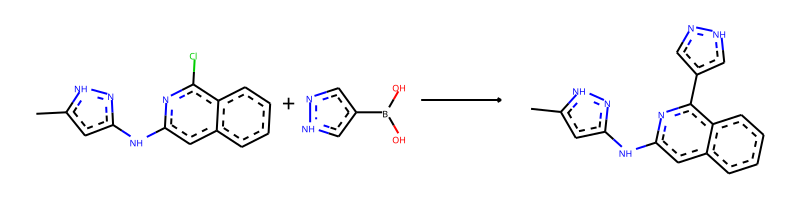

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1cn[nH]c1>>Cc1cc(Nc2cc3ccccc3c(-c3cn[nH]c3)n2)n[nH]1


--------------------------------------------------

Train index: 199393
RANK 91 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:13]1[n:14][c:15]([NH:25][c:26]2[n:27][nH:28][c:29]([CH3:31])[cH:30]2)[cH:16][c:17]2[c:18]([O:23][CH3:24])[cH:19][cH:20][cH:21][c:22]12>>CC(=O)Nc1ccc(O[c:13]2[n:14][c:15]([NH:25][c:26]3[n:27][nH:28][c:29]([CH3:31])[cH:30]3)[cH:16][c:17]3[c:18]([O:23][CH3:24])[cH:19][cH:20][cH:21][c:22]23)cc1


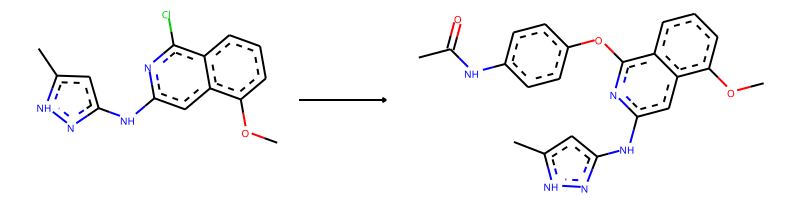

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(=O)-N-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


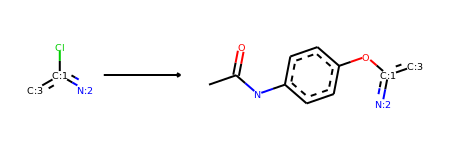

Product similarity 0.8555555555555555, overall 0.673224043715847, smiles CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


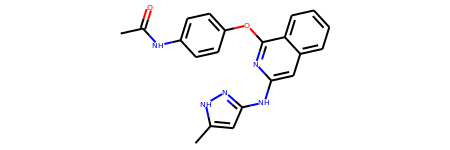

The proposed reaction is:


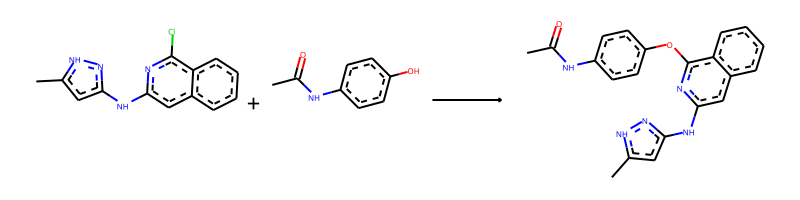

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(=O)Nc1ccc(O)cc1>>CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 145474
RANK 92 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>COc1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1OC


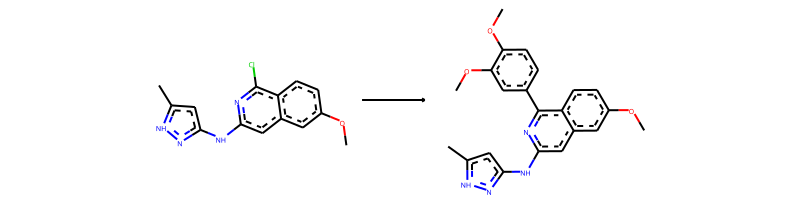

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1-O-C


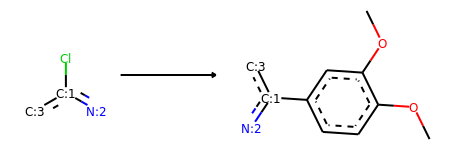

Product similarity 0.8505747126436781, overall 0.6693046919163369, smiles COc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1OC


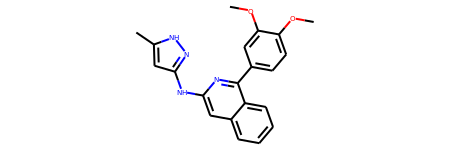

The proposed reaction is:


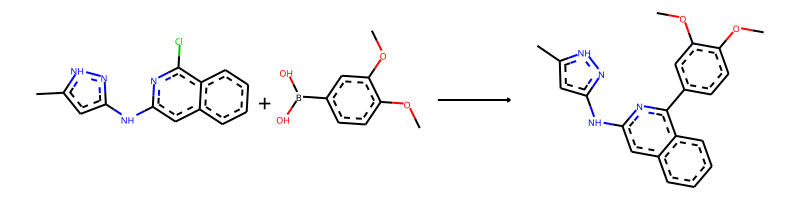

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.COc1ccc(B(O)O)cc1OC>>COc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1OC


--------------------------------------------------

Train index: 312199
RANK 93 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>COc1ccccc1-[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12


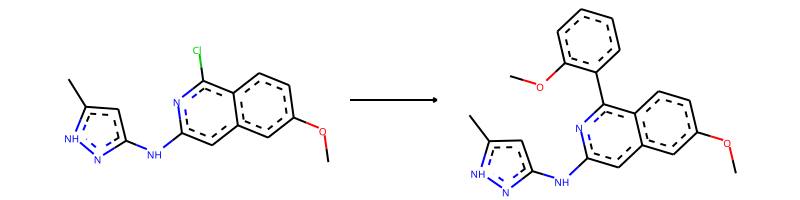

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-c1:c:c:c:c:c:1-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


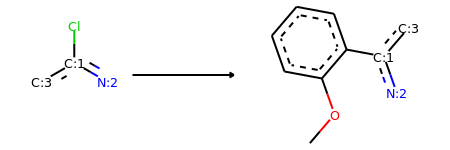

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles COc1ccccc1-c1nc(Nc2cc(C)[nH]n2)cc2ccccc12


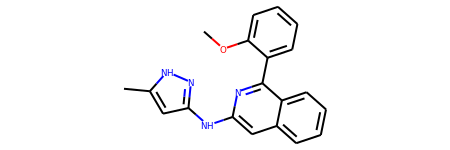

The proposed reaction is:


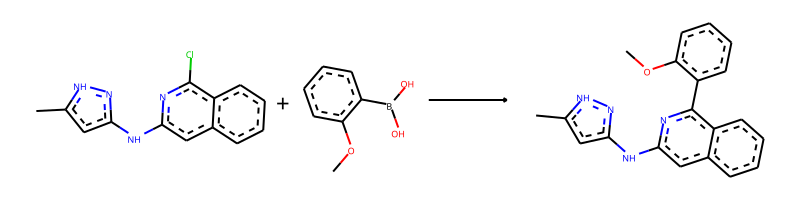

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.COc1ccccc1B(O)O>>COc1ccccc1-c1nc(Nc2cc(C)[nH]n2)cc2ccccc12


--------------------------------------------------

Train index: 410592
RANK 94 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>CC(C)C[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12


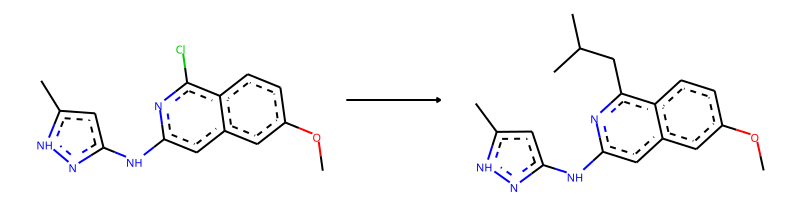

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(-C)-C-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


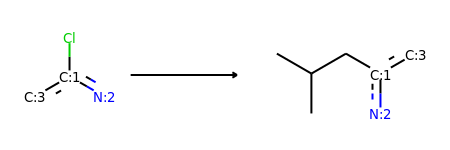

Product similarity 0.8115942028985508, overall 0.6386315039201711, smiles Cc1cc(Nc2cc3ccccc3c(CC(C)C)n2)n[nH]1


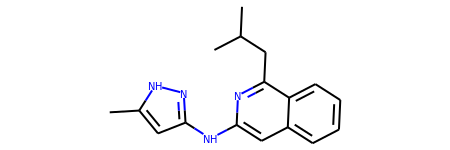

The proposed reaction is:


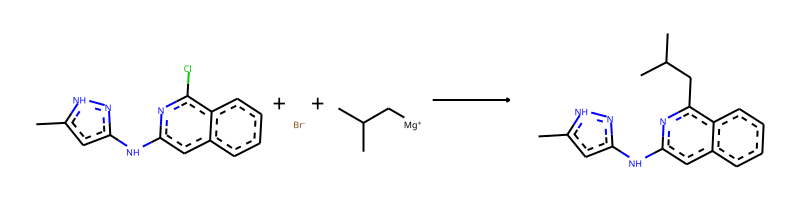

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.[Br-].CC(C)C[Mg+]>>Cc1cc(Nc2cc3ccccc3c(CC(C)C)n2)n[nH]1


--------------------------------------------------

Train index: 14512
RANK 95 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[c:7]([O:12][CH3:13])[cH:8][cH:9][cH:10][c:11]12>>c1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[c:7]([O:12][CH3:13])[cH:8][cH:9][cH:10][c:11]23)cc1


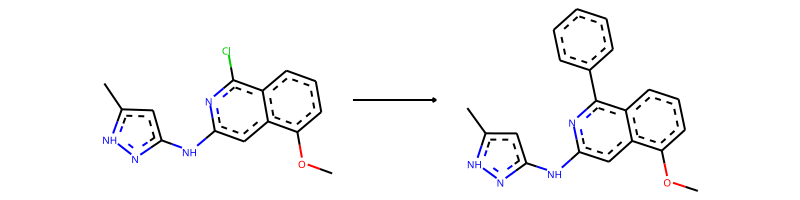

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:c:c:c:c:1


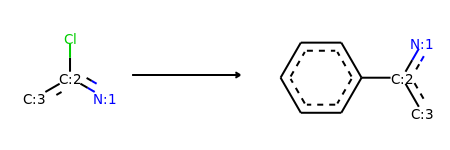

Product similarity 0.8311688311688312, overall 0.6540344901000639, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccccc3)n2)n[nH]1


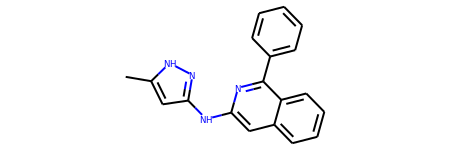

The proposed reaction is:


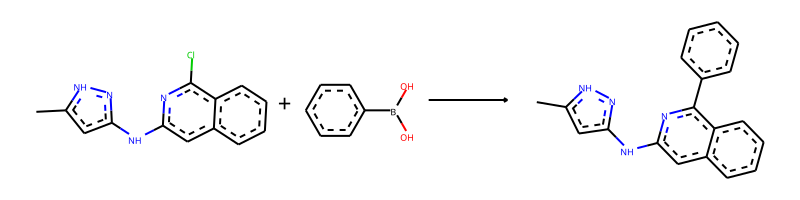

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccccc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 442838
RANK 96 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Clc1cccc(N[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)c1


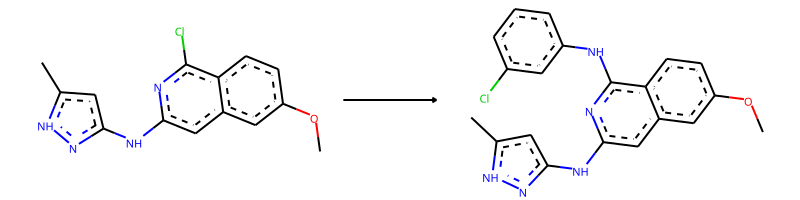

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c:c(-N-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


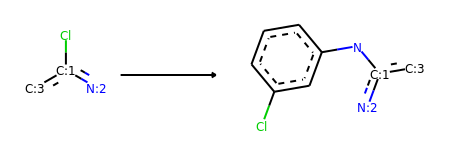

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(Nc3cccc(Cl)c3)n2)n[nH]1


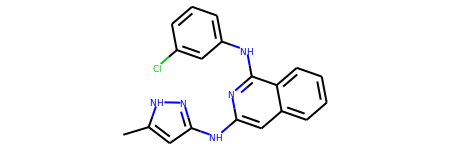

The proposed reaction is:


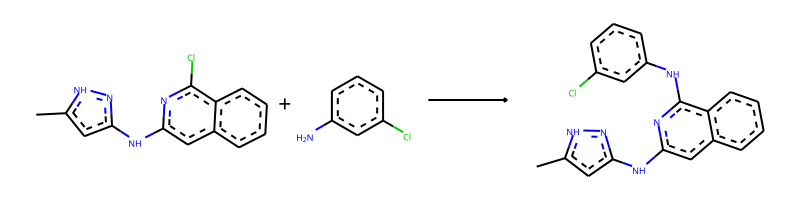

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Nc1cccc(Cl)c1>>Cc1cc(Nc2cc3ccccc3c(Nc3cccc(Cl)c3)n2)n[nH]1


--------------------------------------------------

Train index: 471345
RANK 97 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][cH:8][c:9]([O:12][CH3:13])[cH:10][c:11]12>>N#Cc1ccc(N[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][cH:8][c:9]([O:12][CH3:13])[cH:10][c:11]23)cc1


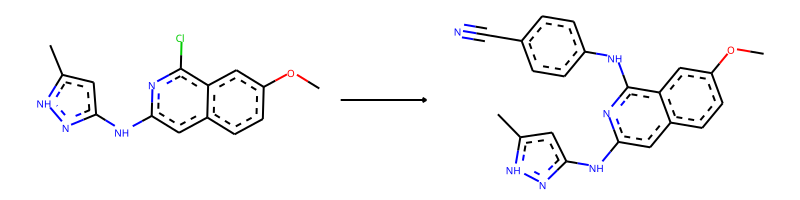

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>N#C-c1:c:c:c(-N-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


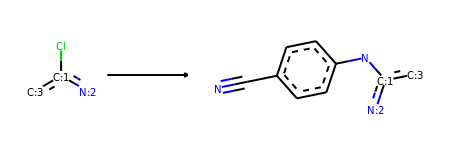

Product similarity 0.8470588235294118, overall 0.6665380906460945, smiles Cc1cc(Nc2cc3ccccc3c(Nc3ccc(C#N)cc3)n2)n[nH]1


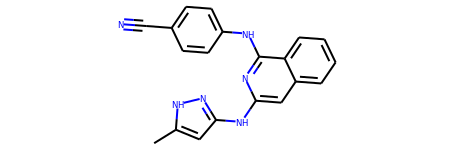

The proposed reaction is:


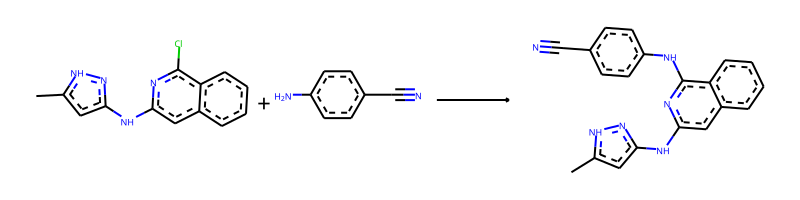

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.N#Cc1ccc(N)cc1>>Cc1cc(Nc2cc3ccccc3c(Nc3ccc(C#N)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 190952
RANK 98 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[c:7]([O:12][CH3:13])[cH:8][cH:9][cH:10][c:11]12>>Fc1ccccc1-[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[c:7]([O:12][CH3:13])[cH:8][cH:9][cH:10][c:11]12


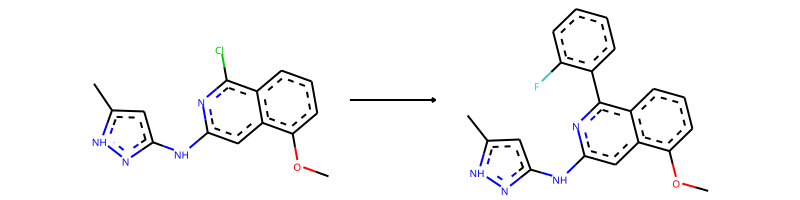

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c:c:1-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


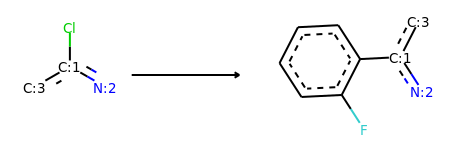

Product similarity 0.8354430379746836, overall 0.6573978003735215, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccccc3F)n2)n[nH]1


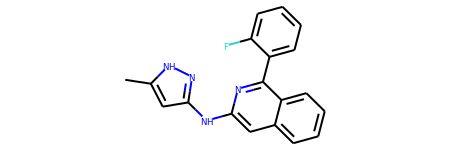

The proposed reaction is:


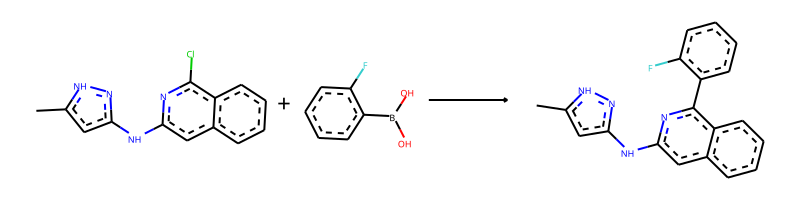

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccccc1F>>Cc1cc(Nc2cc3ccccc3c(-c3ccccc3F)n2)n[nH]1


--------------------------------------------------

Train index: 134730
RANK 99 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:13]1[n:14][c:15]([NH:25][c:26]2[n:27][nH:28][c:29]([CH3:31])[cH:30]2)[cH:16][c:17]2[cH:18][cH:19][c:20]([O:23][CH3:24])[cH:21][c:22]12>>CC(=O)Nc1ccc(O[c:13]2[n:14][c:15]([NH:25][c:26]3[n:27][nH:28][c:29]([CH3:31])[cH:30]3)[cH:16][c:17]3[cH:18][cH:19][c:20]([O:23][CH3:24])[cH:21][c:22]23)cc1


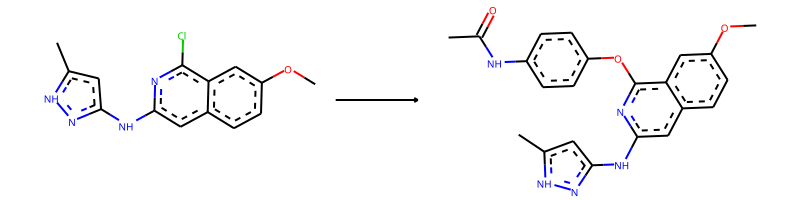

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(=O)-N-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


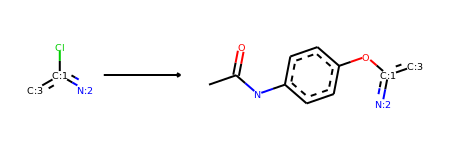

Product similarity 0.8555555555555555, overall 0.673224043715847, smiles CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


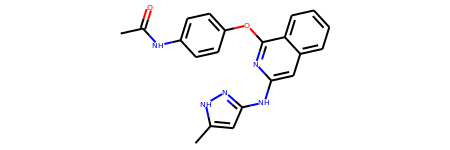

The proposed reaction is:


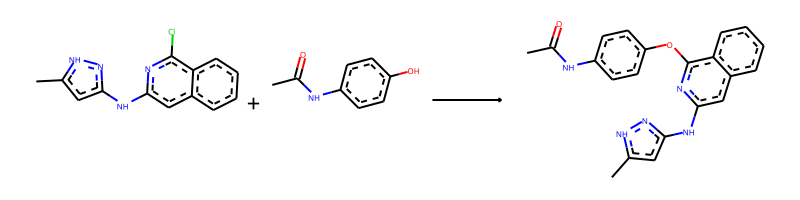

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(=O)Nc1ccc(O)cc1>>CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 384625
RANK 100 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:11]1[n:12][c:13]([NH:23][c:24]2[n:25][nH:26][c:27]([CH3:29])[cH:28]2)[cH:14][c:15]2[cH:16][c:17]([O:21][CH3:22])[cH:18][cH:19][c:20]12>>N#Cc1ccc(O[c:11]2[n:12][c:13]([NH:23][c:24]3[n:25][nH:26][c:27]([CH3:29])[cH:28]3)[cH:14][c:15]3[cH:16][c:17]([O:21][CH3:22])[cH:18][cH:19][c:20]23)cc1


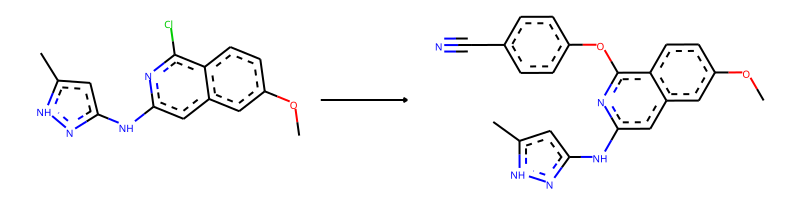

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>N#C-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


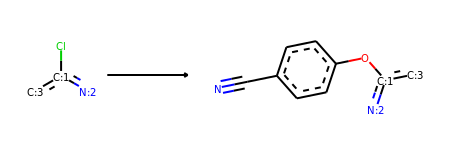

Product similarity 0.8470588235294118, overall 0.6665380906460945, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(C#N)cc3)n2)n[nH]1


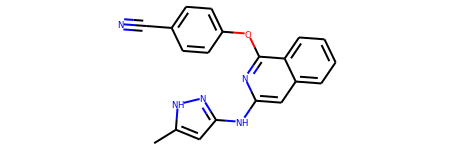

The proposed reaction is:


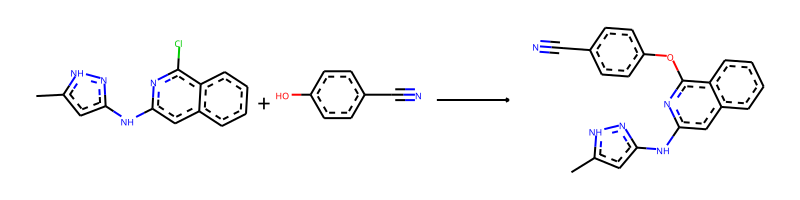

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.N#Cc1ccc(O)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(C#N)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 326189
RANK 101 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[cH:15][cH:16][c:17]([O:20][CH3:21])[cH:18][c:19]12>>Fc1ccc(O[c:10]2[n:11][c:12]([NH:22][c:23]3[n:24][nH:25][c:26]([CH3:28])[cH:27]3)[cH:13][c:14]3[cH:15][cH:16][c:17]([O:20][CH3:21])[cH:18][c:19]23)cc1


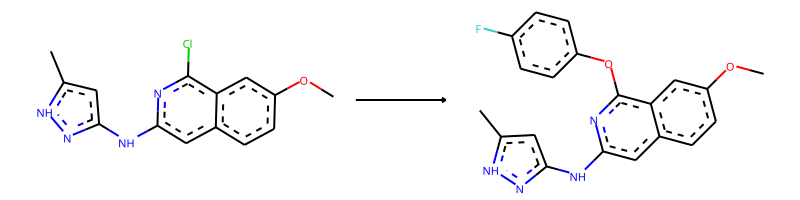

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


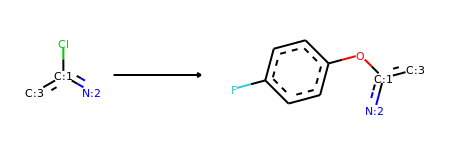

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


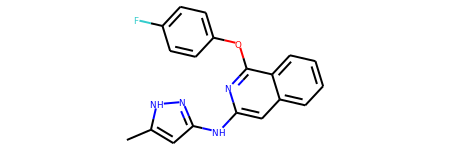

The proposed reaction is:


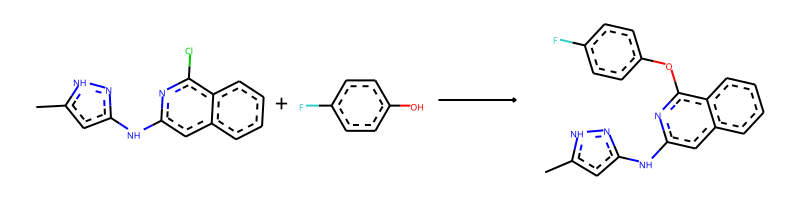

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(F)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 155692
RANK 102 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12>>Clc1ccc(O[c:10]2[n:11][c:12]([NH:22][c:23]3[n:24][nH:25][c:26]([CH3:28])[cH:27]3)[cH:13][c:14]3[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]23)cc1


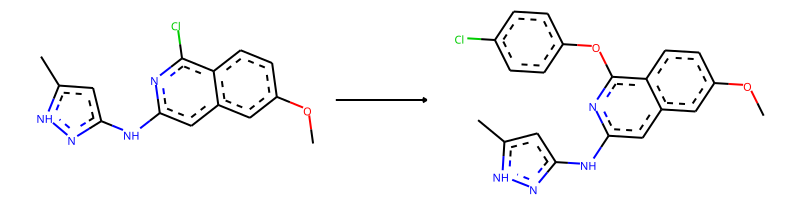

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


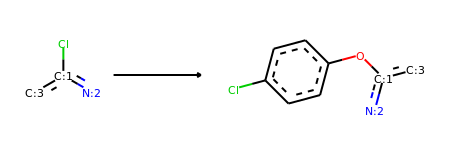

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(Cl)cc3)n2)n[nH]1


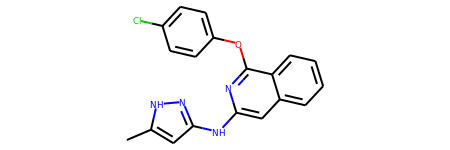

The proposed reaction is:


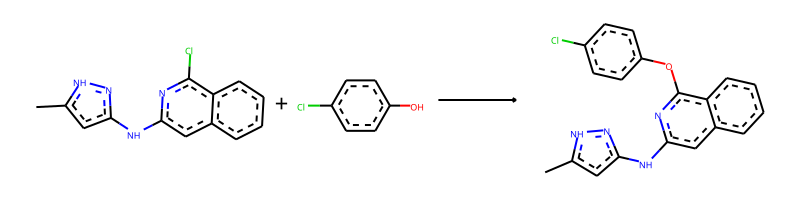

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(Cl)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(Cl)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 231268
RANK 103 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>c1ccc(N[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)nc1


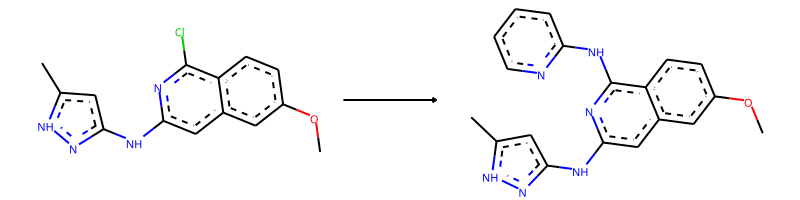

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-N-c1:c:c:c:c:n:1


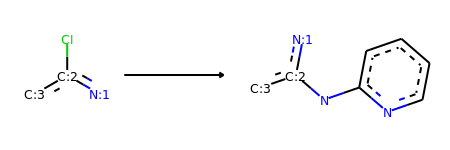

Product similarity 0.8375, overall 0.659016393442623, smiles Cc1cc(Nc2cc3ccccc3c(Nc3ccccn3)n2)n[nH]1


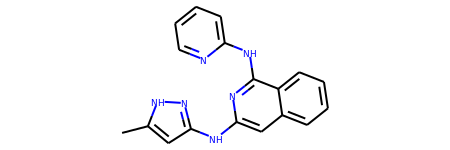

The proposed reaction is:


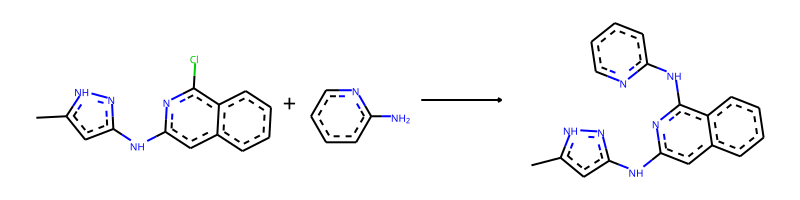

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Nc1ccccn1>>Cc1cc(Nc2cc3ccccc3c(Nc3ccccn3)n2)n[nH]1


--------------------------------------------------

Train index: 241858
RANK 104 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12>>Cc1cccc(O[c:10]2[n:11][c:12]([NH:22][c:23]3[n:24][nH:25][c:26]([CH3:28])[cH:27]3)[cH:13][c:14]3[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]23)c1


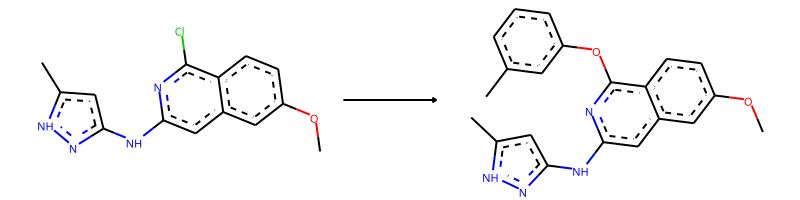

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


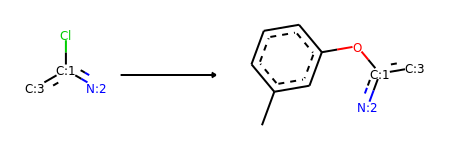

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


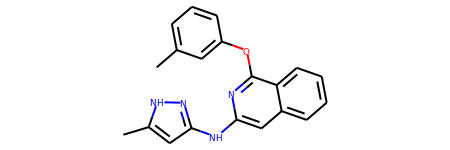

The proposed reaction is:


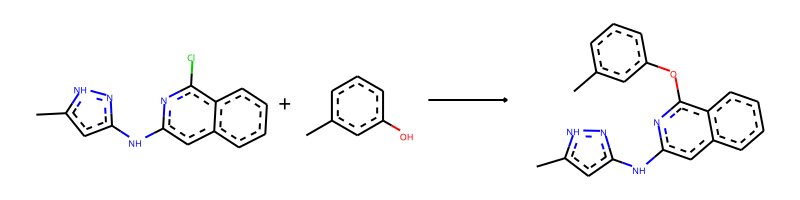

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1cccc(O)c1>>Cc1cccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


--------------------------------------------------

Train index: 204815
RANK 105 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12>>Fc1ccc(S[c:10]2[n:11][c:12]([NH:22][c:23]3[n:24][nH:25][c:26]([CH3:28])[cH:27]3)[cH:13][c:14]3[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]23)cc1


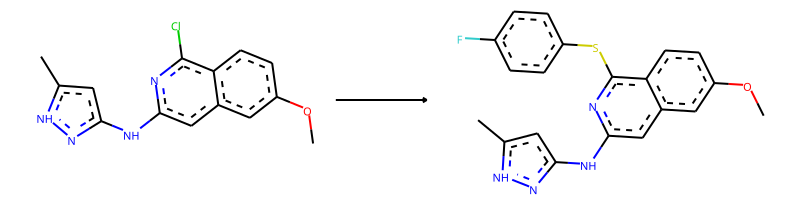

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-S-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


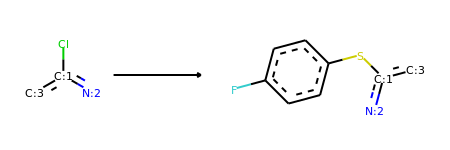

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(Sc3ccc(F)cc3)n2)n[nH]1


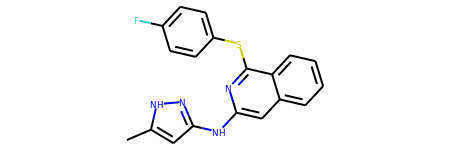

The proposed reaction is:


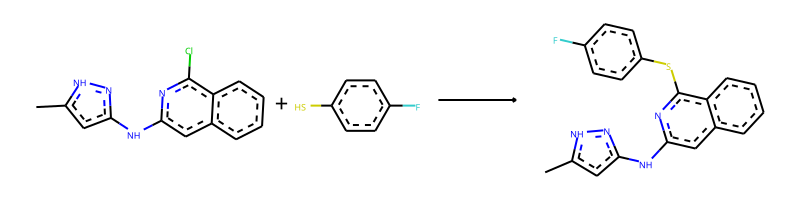

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Fc1ccc(S)cc1>>Cc1cc(Nc2cc3ccccc3c(Sc3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 371102
RANK 106 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>c1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


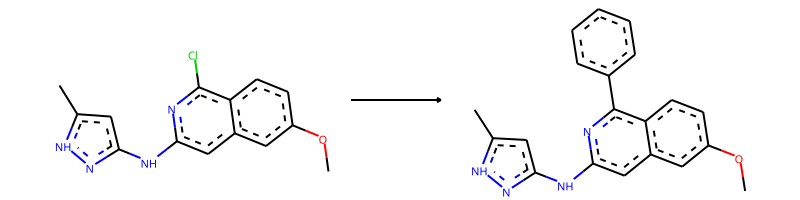

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:c:c:c:c:1


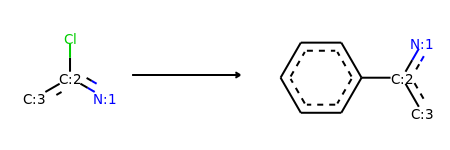

Product similarity 0.8311688311688312, overall 0.6540344901000639, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccccc3)n2)n[nH]1


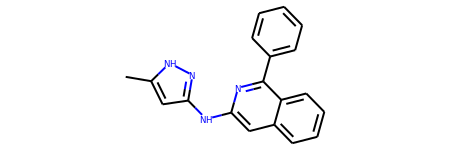

The proposed reaction is:


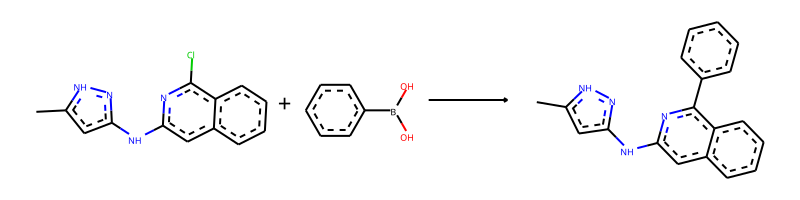

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccccc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 350378
RANK 107 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:9]1[n:10][c:11]([NH:21][c:22]2[n:23][nH:24][c:25]([CH3:27])[cH:26]2)[cH:12][c:13]2[cH:14][c:15]([O:19][CH3:20])[cH:16][cH:17][c:18]12>>C1CCC(O[c:9]2[n:10][c:11]([NH:21][c:22]3[n:23][nH:24][c:25]([CH3:27])[cH:26]3)[cH:12][c:13]3[cH:14][c:15]([O:19][CH3:20])[cH:16][cH:17][c:18]23)CC1


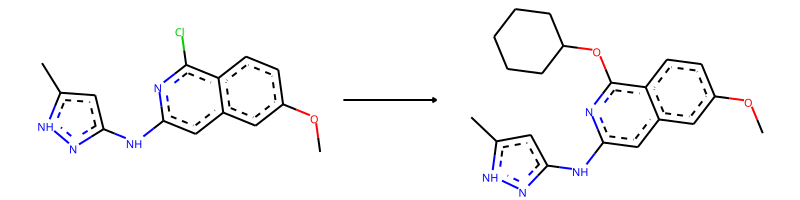

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-C1-C-C-C-C-C-1


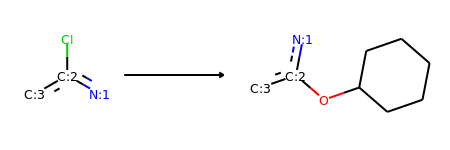

Product similarity 0.8375, overall 0.659016393442623, smiles Cc1cc(Nc2cc3ccccc3c(OC3CCCCC3)n2)n[nH]1


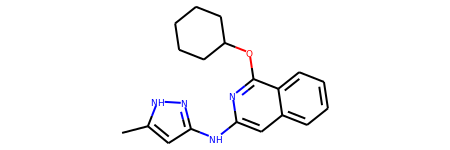

The proposed reaction is:


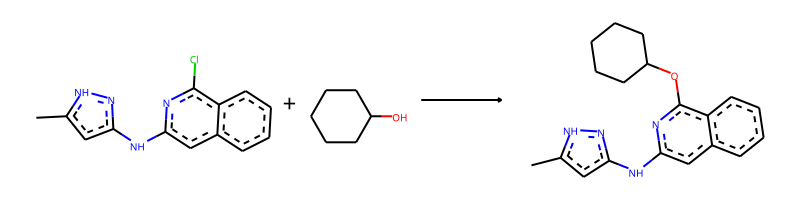

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OC1CCCCC1>>Cc1cc(Nc2cc3ccccc3c(OC3CCCCC3)n2)n[nH]1


--------------------------------------------------

Train index: 325367
RANK 108 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[c:7]([O:12][CH3:13])[cH:8][cH:9][cH:10][c:11]12>>c1cc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[c:7]([O:12][CH3:13])[cH:8][cH:9][cH:10][c:11]23)cs1


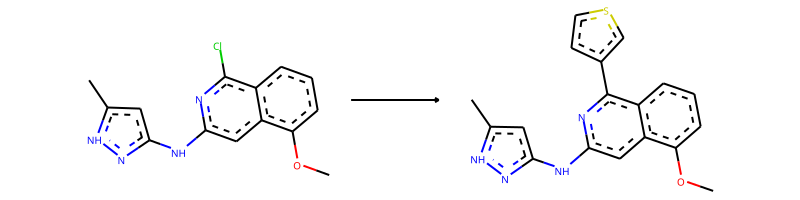

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:c:s:c:1


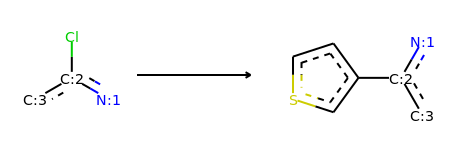

Product similarity 0.8243243243243243, overall 0.6486486486486487, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccsc3)n2)n[nH]1


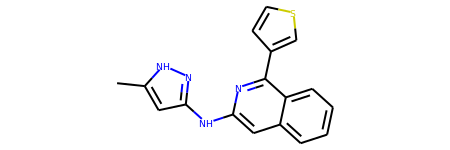

The proposed reaction is:


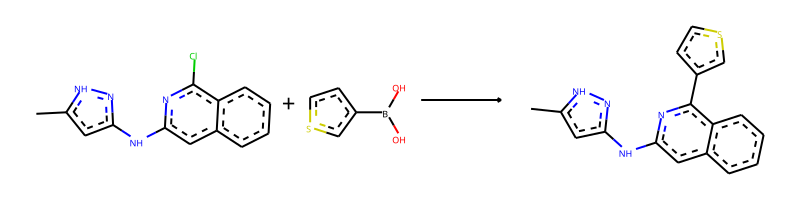

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccsc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccsc3)n2)n[nH]1


--------------------------------------------------

Train index: 300083
RANK 109 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[c:15]([O:20][CH3:21])[cH:16][cH:17][cH:18][c:19]12>>Cc1ccc(O[c:10]2[n:11][c:12]([NH:22][c:23]3[n:24][nH:25][c:26]([CH3:28])[cH:27]3)[cH:13][c:14]3[c:15]([O:20][CH3:21])[cH:16][cH:17][cH:18][c:19]23)cc1


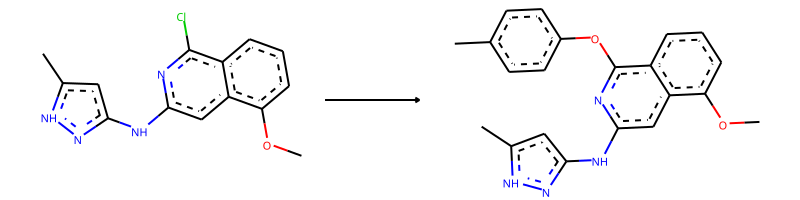

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


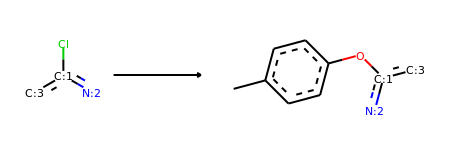

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


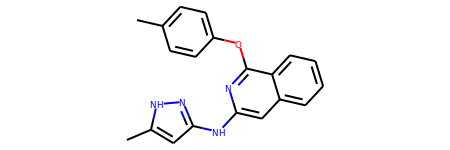

The proposed reaction is:


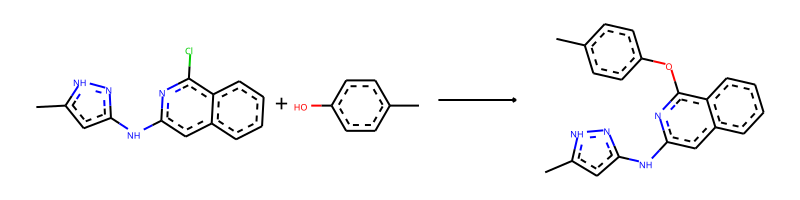

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1ccc(O)cc1>>Cc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 59292
RANK 110 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:13]1[n:14][c:15]([NH:25][c:26]2[n:27][nH:28][c:29]([CH3:31])[cH:30]2)[cH:16][c:17]2[cH:18][c:19]([O:23][CH3:24])[cH:20][cH:21][c:22]12>>CC(=O)Nc1ccc(O[c:13]2[n:14][c:15]([NH:25][c:26]3[n:27][nH:28][c:29]([CH3:31])[cH:30]3)[cH:16][c:17]3[cH:18][c:19]([O:23][CH3:24])[cH:20][cH:21][c:22]23)cc1


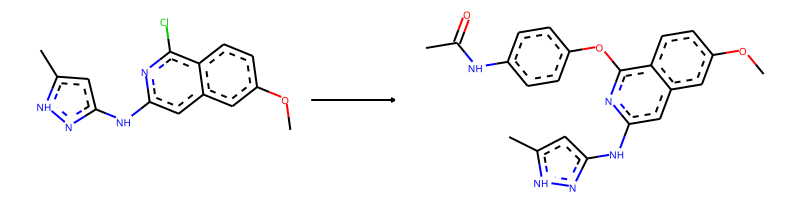

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(=O)-N-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


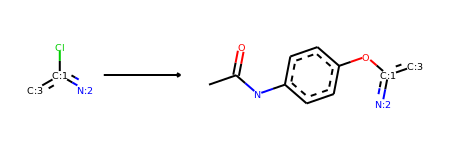

Product similarity 0.8555555555555555, overall 0.673224043715847, smiles CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


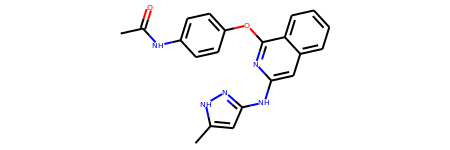

The proposed reaction is:


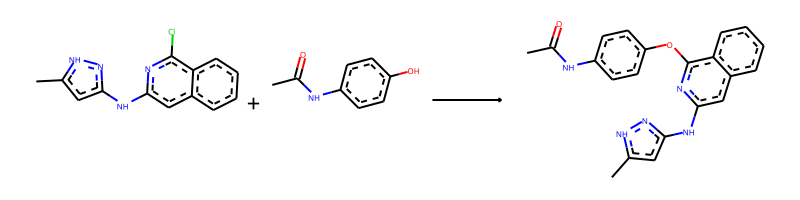

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(=O)Nc1ccc(O)cc1>>CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 385693
RANK 111 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:9]1[n:10][c:11]([NH:21][c:22]2[n:23][nH:24][c:25]([CH3:27])[cH:26]2)[cH:12][c:13]2[cH:14][c:15]([O:19][CH3:20])[cH:16][cH:17][c:18]12>>c1ccc(O[c:9]2[n:10][c:11]([NH:21][c:22]3[n:23][nH:24][c:25]([CH3:27])[cH:26]3)[cH:12][c:13]3[cH:14][c:15]([O:19][CH3:20])[cH:16][cH:17][c:18]23)cc1


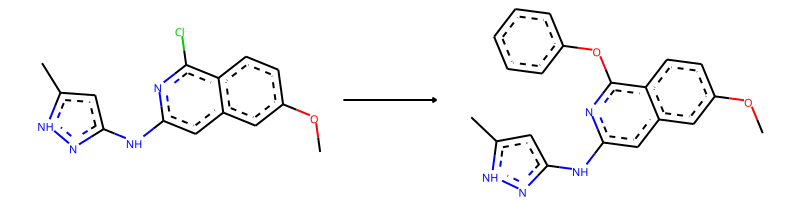

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-c1:c:c:c:c:c:1


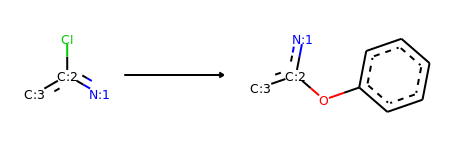

Product similarity 0.8375, overall 0.659016393442623, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


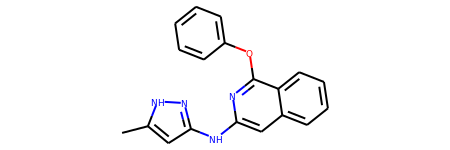

The proposed reaction is:


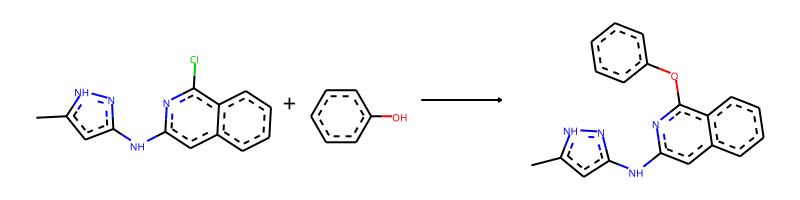

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 260908
RANK 112 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][cH:8][c:9]([O:12][CH3:13])[cH:10][c:11]12>>Fc1ccccc1-[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][cH:8][c:9]([O:12][CH3:13])[cH:10][c:11]12


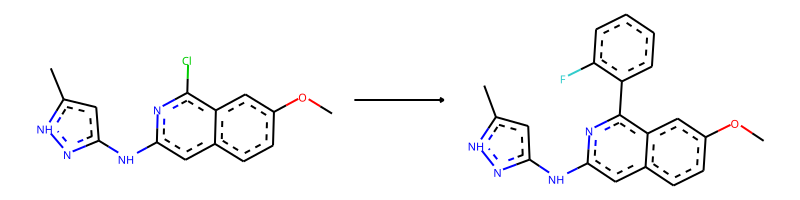

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c:c:1-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


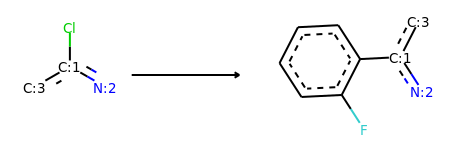

Product similarity 0.8354430379746836, overall 0.6573978003735215, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccccc3F)n2)n[nH]1


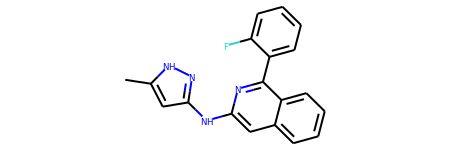

The proposed reaction is:


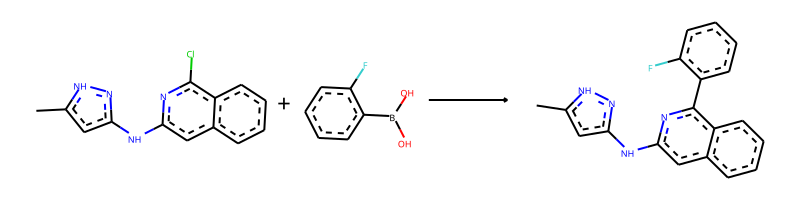

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccccc1F>>Cc1cc(Nc2cc3ccccc3c(-c3ccccc3F)n2)n[nH]1


--------------------------------------------------

Train index: 307828
RANK 113 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>c1ccc(C[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


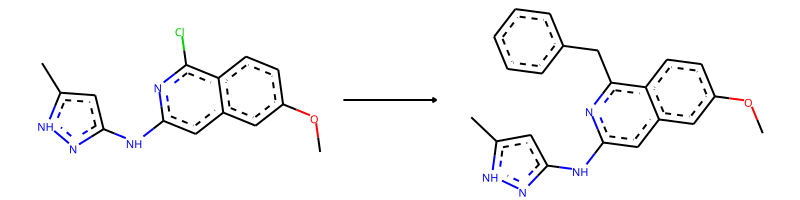

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-C-c1:c:c:c:c:c:1


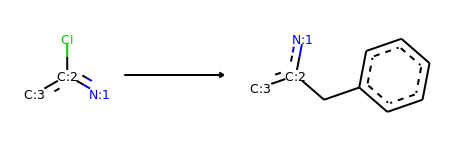

Product similarity 0.8375, overall 0.659016393442623, smiles Cc1cc(Nc2cc3ccccc3c(Cc3ccccc3)n2)n[nH]1


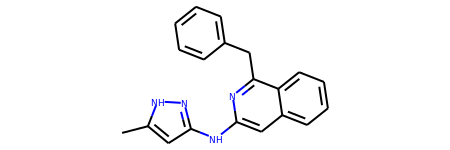

The proposed reaction is:


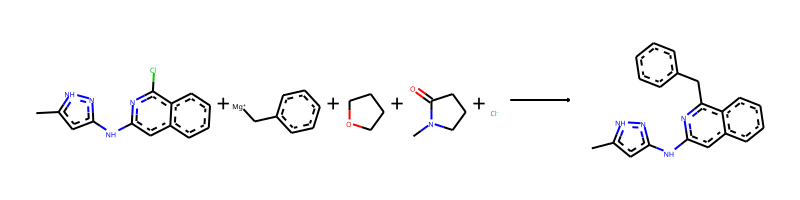

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.[Mg+]Cc1ccccc1.C1CCOC1.CN1CCCC1=O.[Cl-]>>Cc1cc(Nc2cc3ccccc3c(Cc3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 48924
RANK 114 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12>>Fc1cccc(S[c:10]2[n:11][c:12]([NH:22][c:23]3[n:24][nH:25][c:26]([CH3:28])[cH:27]3)[cH:13][c:14]3[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]23)c1


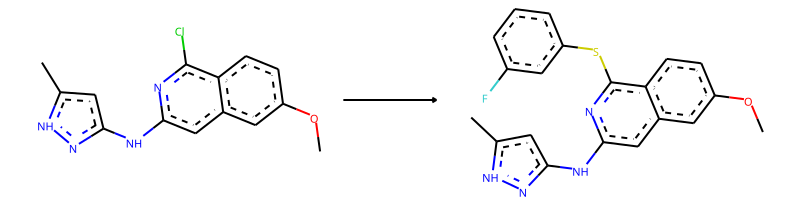

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c(-S-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


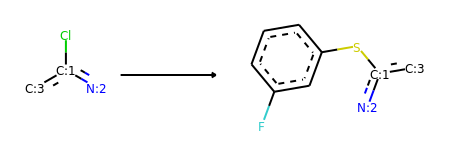

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(Sc3cccc(F)c3)n2)n[nH]1


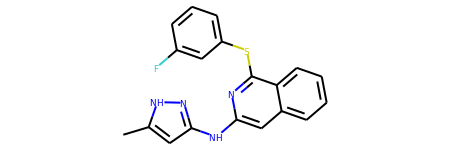

The proposed reaction is:


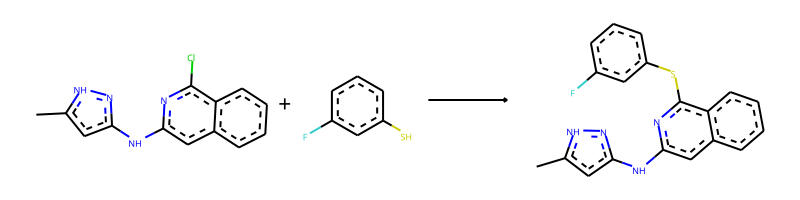

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Fc1cccc(S)c1>>Cc1cc(Nc2cc3ccccc3c(Sc3cccc(F)c3)n2)n[nH]1


--------------------------------------------------

Train index: 427949
RANK 115 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>c1ccc2c(-[c:2]3[n:3][c:4]([NH:14][c:15]4[n:16][nH:17][c:18]([CH3:20])[cH:19]4)[cH:5][c:6]4[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]34)csc2c1


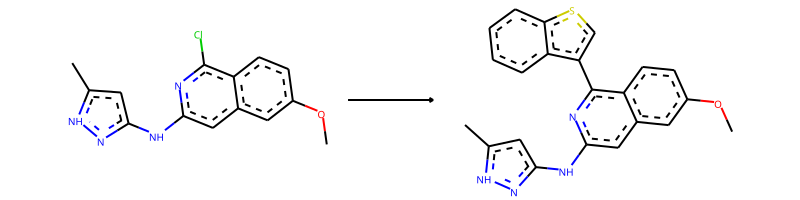

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:s:c2:c:c:c:c:c:1:2


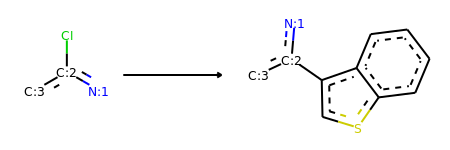

Product similarity 0.8488372093023255, overall 0.6679374761723217, smiles Cc1cc(Nc2cc3ccccc3c(-c3csc4ccccc34)n2)n[nH]1


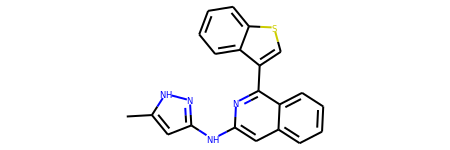

The proposed reaction is:


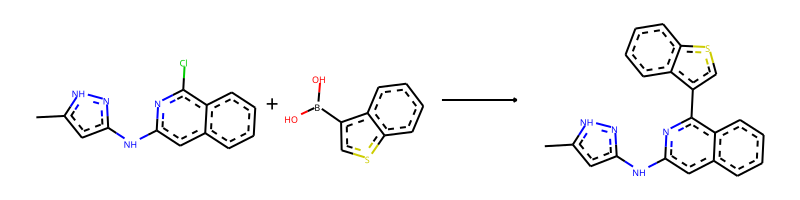

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1csc2ccccc12>>Cc1cc(Nc2cc3ccccc3c(-c3csc4ccccc34)n2)n[nH]1


--------------------------------------------------

Train index: 268590
RANK 116 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Fc1ccc(N[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


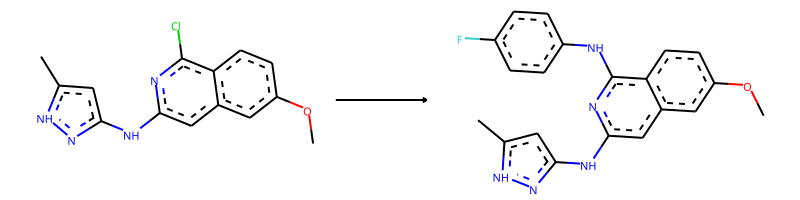

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-N-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


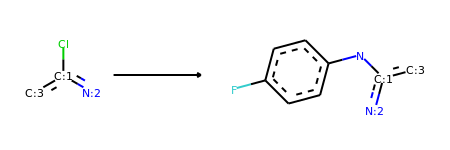

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(Nc3ccc(F)cc3)n2)n[nH]1


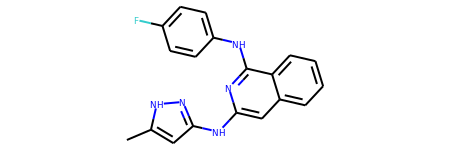

The proposed reaction is:


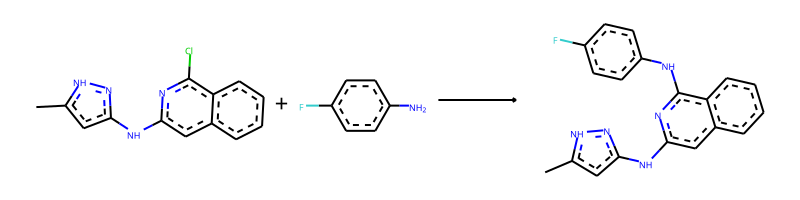

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Nc1ccc(F)cc1>>Cc1cc(Nc2cc3ccccc3c(Nc3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 179422
RANK 117 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>CC(=O)Nc1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


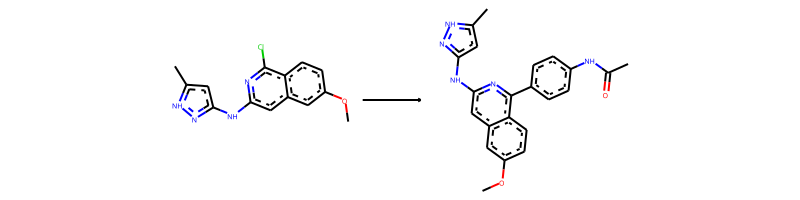

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(=O)-N-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


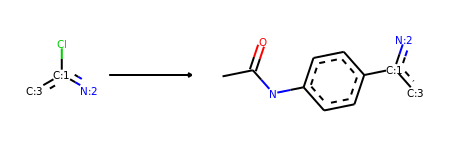

Product similarity 0.8505747126436781, overall 0.6693046919163369, smiles CC(=O)Nc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


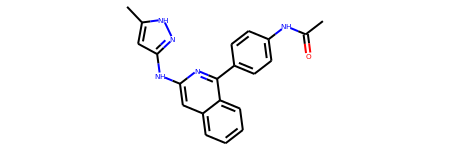

The proposed reaction is:


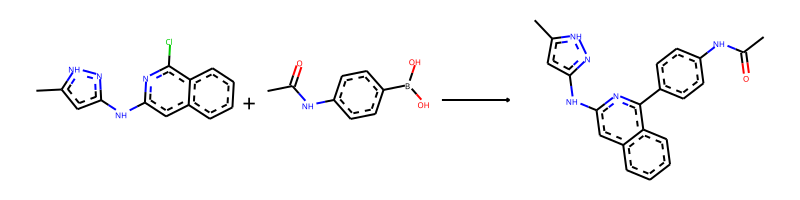

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(=O)Nc1ccc(B(O)O)cc1>>CC(=O)Nc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 359304
RANK 118 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:11]1[n:12][c:13]([NH:23][c:24]2[n:25][nH:26][c:27]([CH3:29])[cH:28]2)[cH:14][c:15]2[c:16]([O:21][CH3:22])[cH:17][cH:18][cH:19][c:20]12>>COc1ccc(O[c:11]2[n:12][c:13]([NH:23][c:24]3[n:25][nH:26][c:27]([CH3:29])[cH:28]3)[cH:14][c:15]3[c:16]([O:21][CH3:22])[cH:17][cH:18][cH:19][c:20]23)cc1


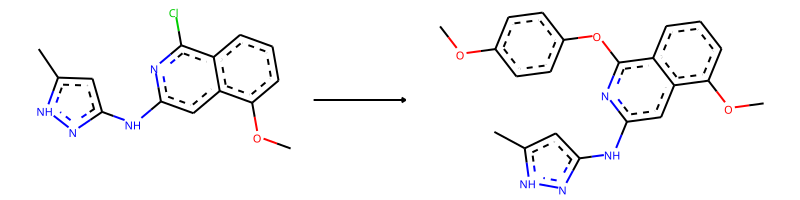

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


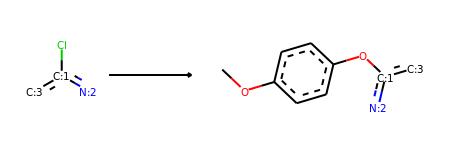

Product similarity 0.8470588235294118, overall 0.6665380906460945, smiles COc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


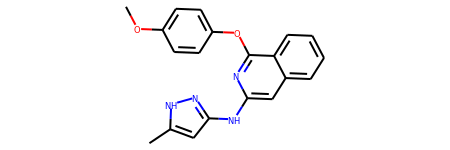

The proposed reaction is:


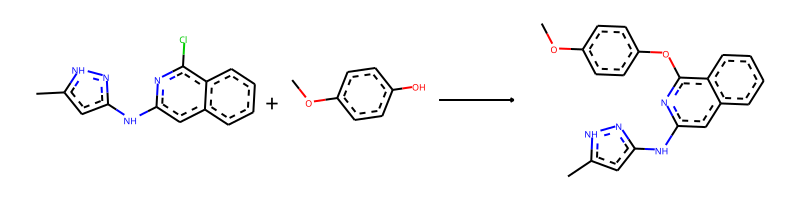

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.COc1ccc(O)cc1>>COc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 278924
RANK 119 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:11]1[n:12][c:13]([NH:23][c:24]2[n:25][nH:26][c:27]([CH3:29])[cH:28]2)[cH:14][c:15]2[cH:16][c:17]([O:21][CH3:22])[cH:18][cH:19][c:20]12>>C1CN(CCO[c:11]2[n:12][c:13]([NH:23][c:24]3[n:25][nH:26][c:27]([CH3:29])[cH:28]3)[cH:14][c:15]3[cH:16][c:17]([O:21][CH3:22])[cH:18][cH:19][c:20]23)CCO1


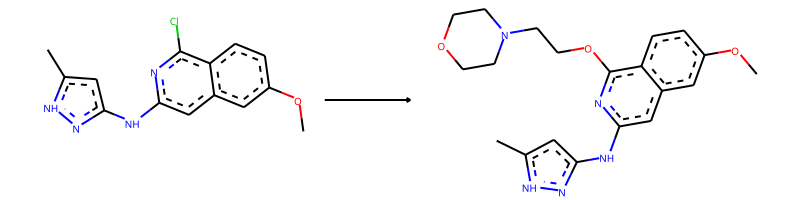

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-C-C-N1-C-C-O-C-C-1


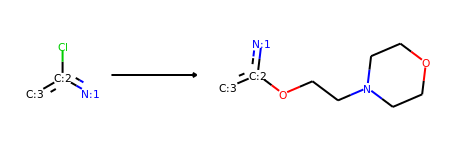

Product similarity 0.8488372093023255, overall 0.6679374761723217, smiles Cc1cc(Nc2cc3ccccc3c(OCCN3CCOCC3)n2)n[nH]1


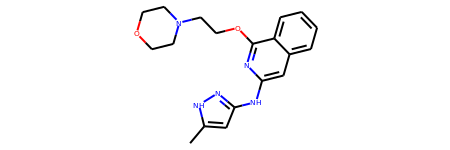

The proposed reaction is:


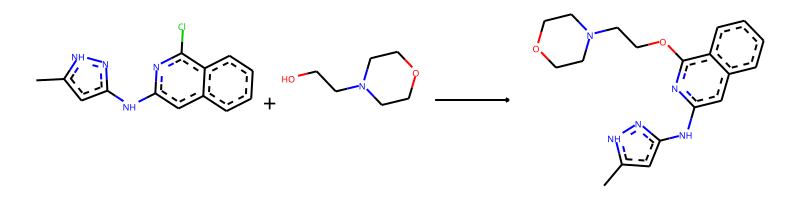

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OCCN1CCOCC1>>Cc1cc(Nc2cc3ccccc3c(OCCN3CCOCC3)n2)n[nH]1


--------------------------------------------------

Train index: 101096
RANK 120 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Brc1ccc(N[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


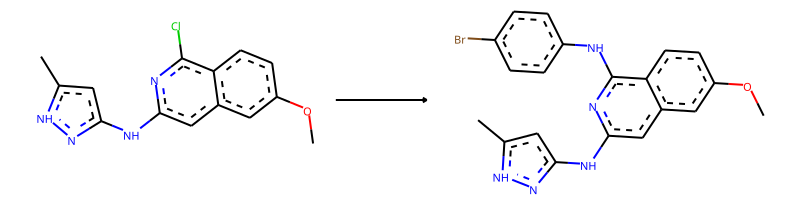

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Br-c1:c:c:c(-N-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


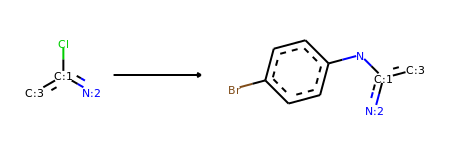

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(Nc3ccc(Br)cc3)n2)n[nH]1


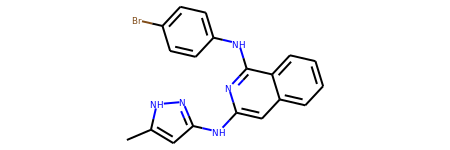

The proposed reaction is:


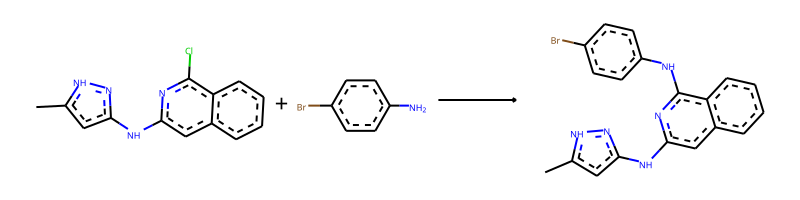

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Nc1ccc(Br)cc1>>Cc1cc(Nc2cc3ccccc3c(Nc3ccc(Br)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 267717
RANK 121 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Cc1cscc1-[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12


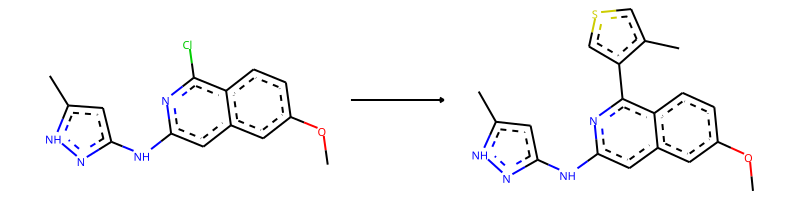

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:s:c:c:1-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


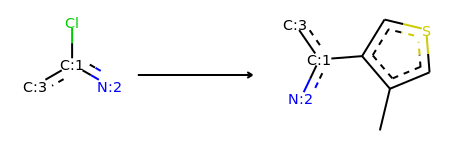

Product similarity 0.8289473684210527, overall 0.6522864538395168, smiles Cc1cc(Nc2cc3ccccc3c(-c3cscc3C)n2)n[nH]1


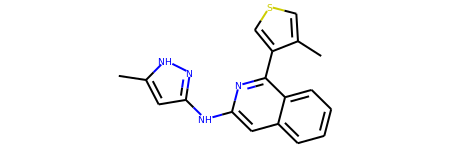

The proposed reaction is:


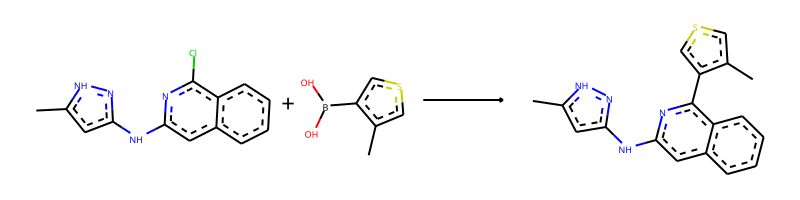

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1cscc1B(O)O>>Cc1cc(Nc2cc3ccccc3c(-c3cscc3C)n2)n[nH]1


--------------------------------------------------

Train index: 477915
RANK 122 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>CC(C)(C)c1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


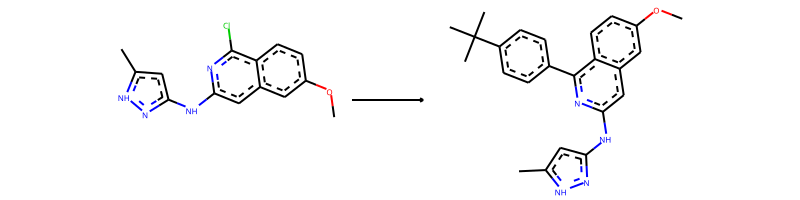

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(-C)(-C)-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


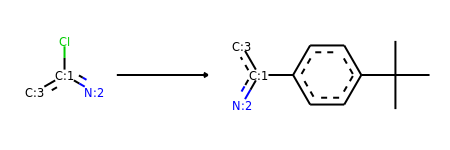

Product similarity 0.8488372093023255, overall 0.6679374761723217, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(C(C)(C)C)cc3)n2)n[nH]1


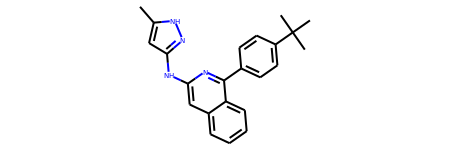

The proposed reaction is:


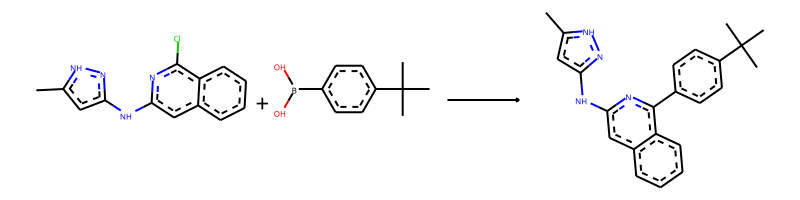

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(C)(C)c1ccc(B(O)O)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(C(C)(C)C)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 123372
RANK 123 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:9]1[n:10][c:11]([NH:21][c:22]2[n:23][nH:24][c:25]([CH3:27])[cH:26]2)[cH:12][c:13]2[c:14]([O:19][CH3:20])[cH:15][cH:16][cH:17][c:18]12>>c1ccc(O[c:9]2[n:10][c:11]([NH:21][c:22]3[n:23][nH:24][c:25]([CH3:27])[cH:26]3)[cH:12][c:13]3[c:14]([O:19][CH3:20])[cH:15][cH:16][cH:17][c:18]23)cc1


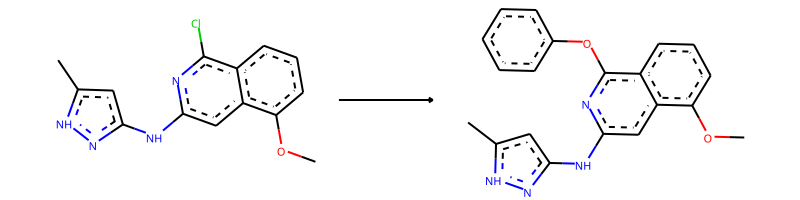

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-c1:c:c:c:c:c:1


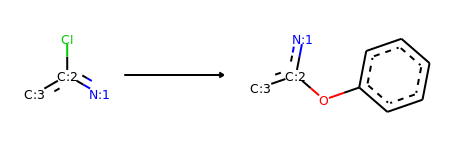

Product similarity 0.8375, overall 0.659016393442623, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


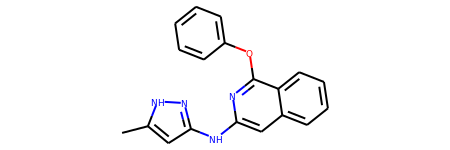

The proposed reaction is:


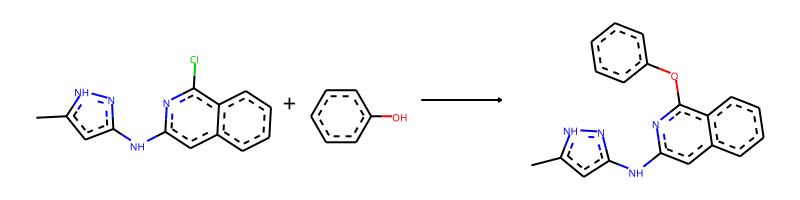

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 175928
RANK 124 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>C1CCC([c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)CC1


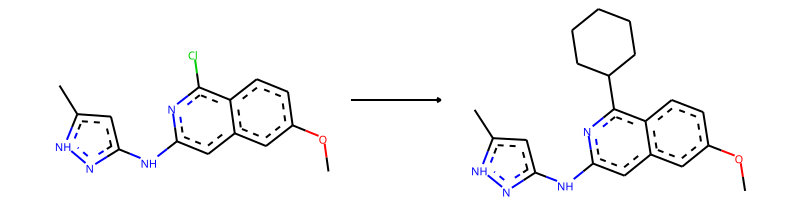

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-C1-C-C-C-C-C-1


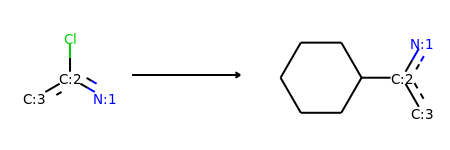

Product similarity 0.8311688311688312, overall 0.6540344901000639, smiles Cc1cc(Nc2cc3ccccc3c(C3CCCCC3)n2)n[nH]1


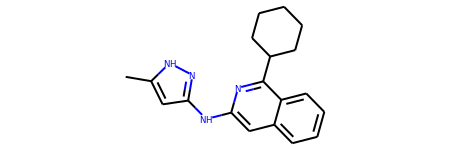

The proposed reaction is:


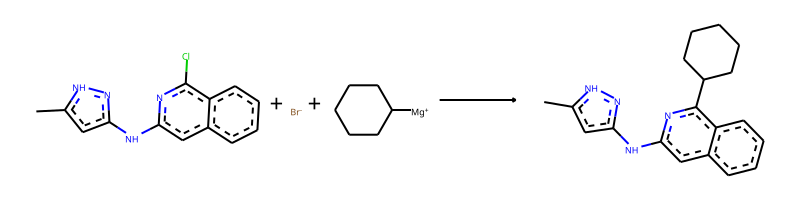

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.[Br-].[Mg+]C1CCCCC1>>Cc1cc(Nc2cc3ccccc3c(C3CCCCC3)n2)n[nH]1


--------------------------------------------------

Train index: 278721
RANK 125 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>c1cc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cs1


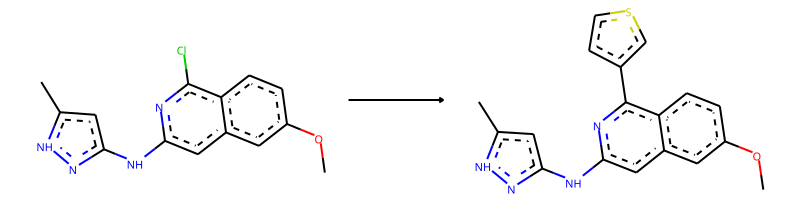

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:c:s:c:1


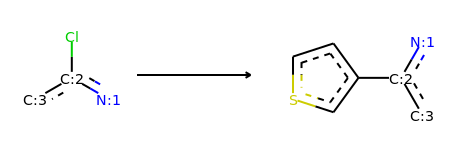

Product similarity 0.8243243243243243, overall 0.6486486486486487, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccsc3)n2)n[nH]1


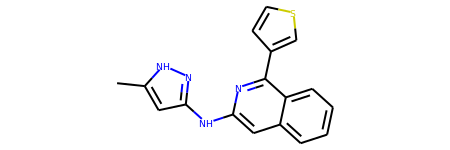

The proposed reaction is:


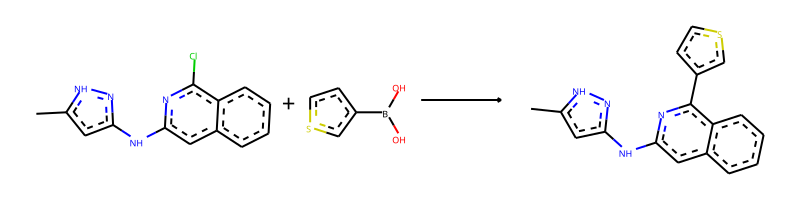

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccsc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccsc3)n2)n[nH]1


--------------------------------------------------

Train index: 398320
RANK 126 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Clc1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


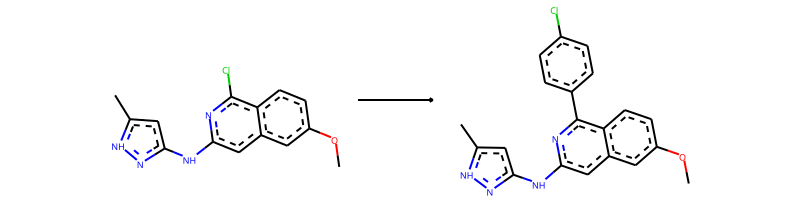

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


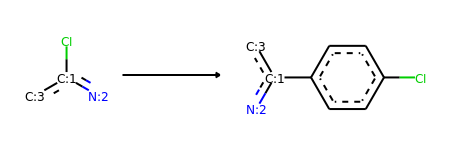

Product similarity 0.8354430379746836, overall 0.6573978003735215, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(Cl)cc3)n2)n[nH]1


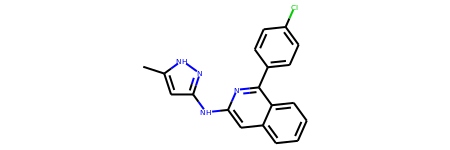

The proposed reaction is:


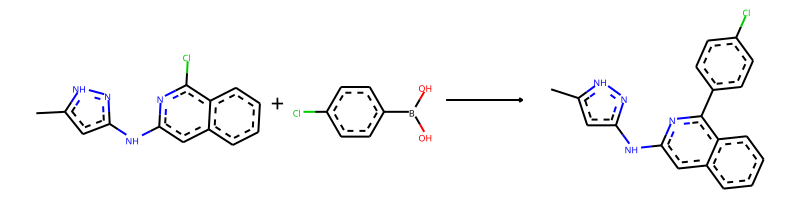

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(Cl)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(Cl)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 85089
RANK 127 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12>>Fc1ccc(O[c:10]2[n:11][c:12]([NH:22][c:23]3[n:24][nH:25][c:26]([CH3:28])[cH:27]3)[cH:13][c:14]3[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]23)cc1


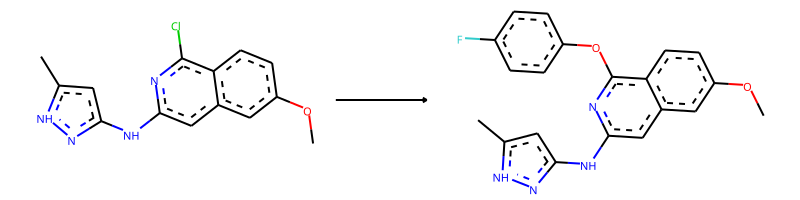

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


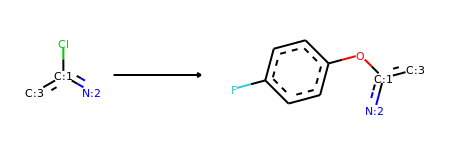

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


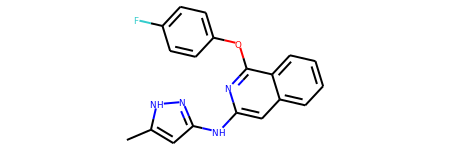

The proposed reaction is:


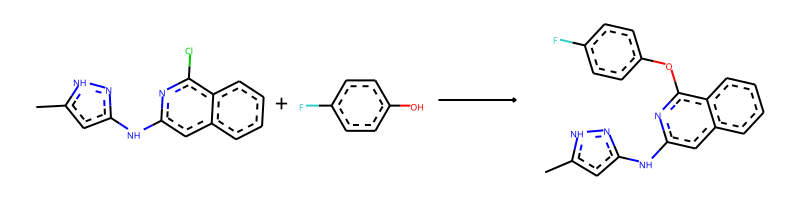

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(F)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 315337
RANK 128 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Clc1ccc(N[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


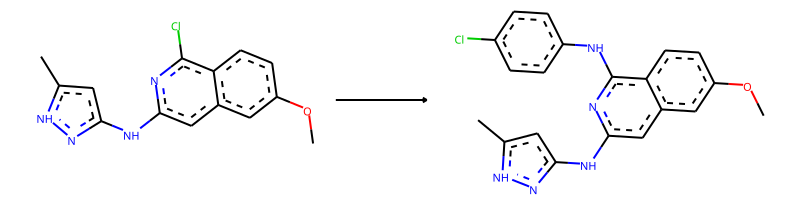

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c(-N-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


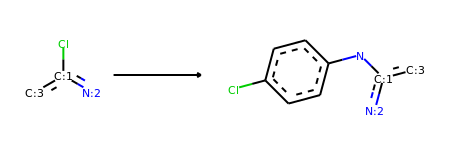

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(Nc3ccc(Cl)cc3)n2)n[nH]1


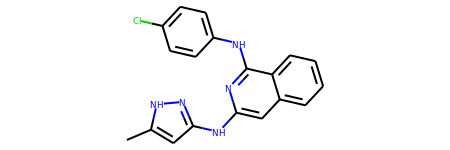

The proposed reaction is:


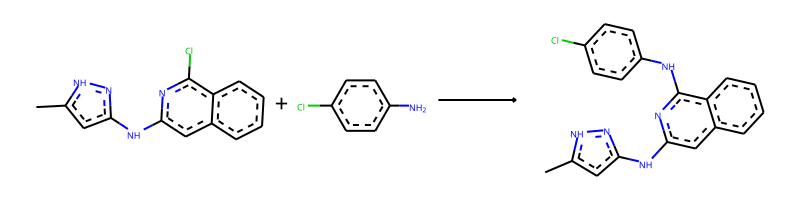

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Nc1ccc(Cl)cc1>>Cc1cc(Nc2cc3ccccc3c(Nc3ccc(Cl)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 412781
RANK 129 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][cH:8][c:9]([O:12][CH3:13])[cH:10][c:11]12>>Fc1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][cH:8][c:9]([O:12][CH3:13])[cH:10][c:11]23)c(F)c1


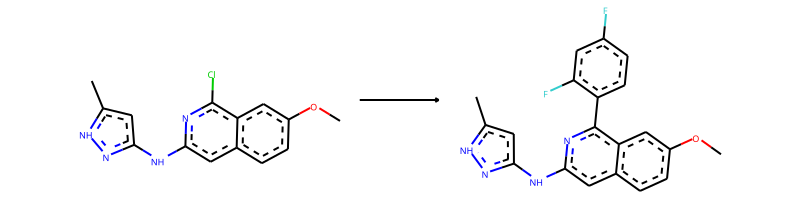

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c(-F):c:1


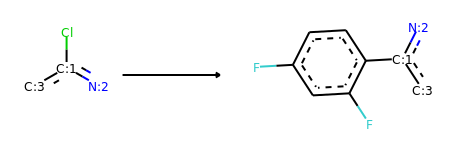

Product similarity 0.8395061728395061, overall 0.6605950212507589, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3F)n2)n[nH]1


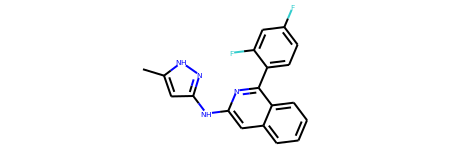

The proposed reaction is:


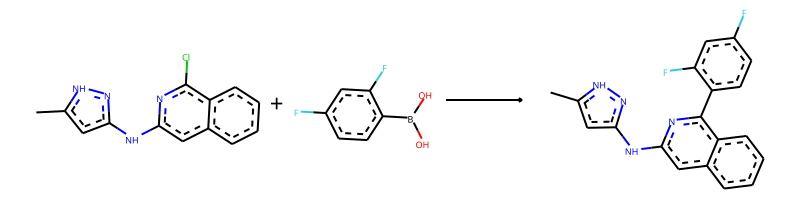

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(F)cc1F>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3F)n2)n[nH]1


--------------------------------------------------

Train index: 400172
RANK 130 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[c:15]([O:20][CH3:21])[cH:16][cH:17][cH:18][c:19]12>>Fc1ccc(O[c:10]2[n:11][c:12]([NH:22][c:23]3[n:24][nH:25][c:26]([CH3:28])[cH:27]3)[cH:13][c:14]3[c:15]([O:20][CH3:21])[cH:16][cH:17][cH:18][c:19]23)cc1


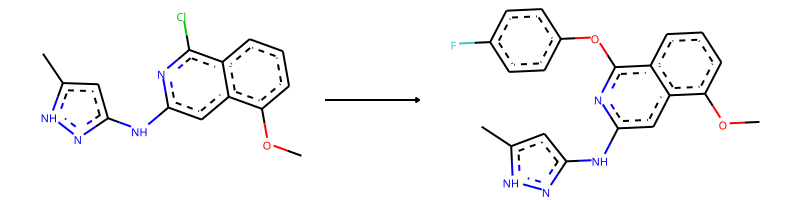

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


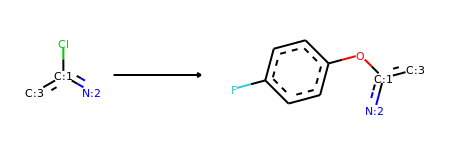

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


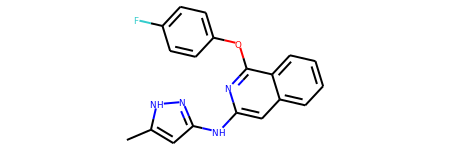

The proposed reaction is:


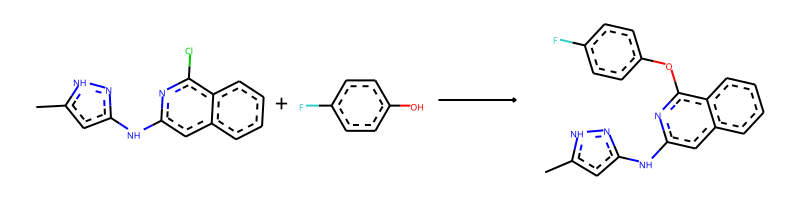

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(F)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 24621
RANK 131 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:11]1[n:12][c:13]([NH:23][c:24]2[n:25][nH:26][c:27]([CH3:29])[cH:28]2)[cH:14][c:15]2[c:16]([O:21][CH3:22])[cH:17][cH:18][cH:19][c:20]12>>N#Cc1ccc(O[c:11]2[n:12][c:13]([NH:23][c:24]3[n:25][nH:26][c:27]([CH3:29])[cH:28]3)[cH:14][c:15]3[c:16]([O:21][CH3:22])[cH:17][cH:18][cH:19][c:20]23)cc1


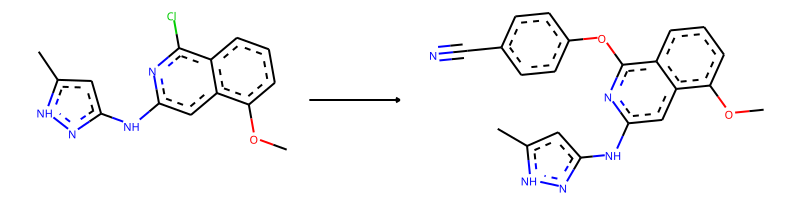

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>N#C-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


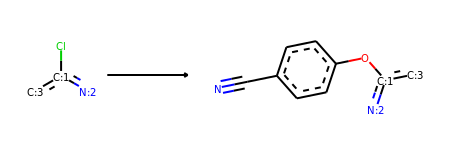

Product similarity 0.8470588235294118, overall 0.6665380906460945, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(C#N)cc3)n2)n[nH]1


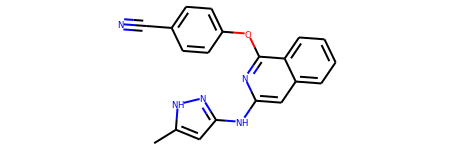

The proposed reaction is:


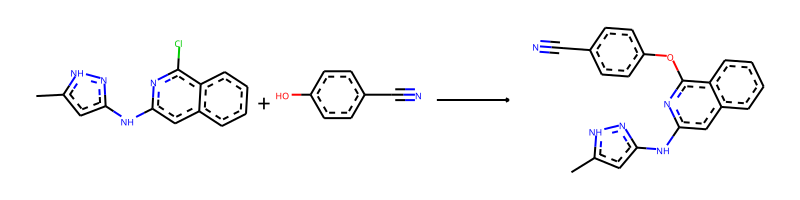

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.N#Cc1ccc(O)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(C#N)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 397749
RANK 132 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:9]1[n:10][c:11]([NH:21][c:22]2[n:23][nH:24][c:25]([CH3:27])[cH:26]2)[cH:12][c:13]2[cH:14][cH:15][c:16]([O:19][CH3:20])[cH:17][c:18]12>>c1ccc(O[c:9]2[n:10][c:11]([NH:21][c:22]3[n:23][nH:24][c:25]([CH3:27])[cH:26]3)[cH:12][c:13]3[cH:14][cH:15][c:16]([O:19][CH3:20])[cH:17][c:18]23)cc1


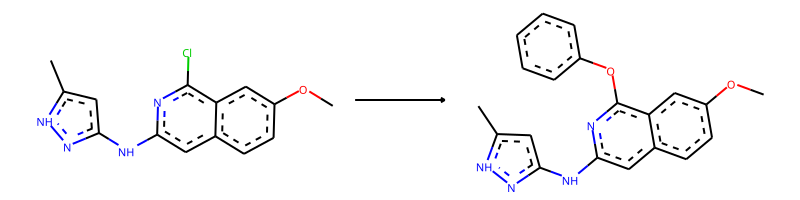

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-c1:c:c:c:c:c:1


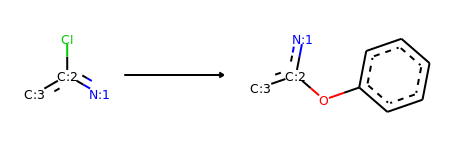

Product similarity 0.8375, overall 0.659016393442623, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


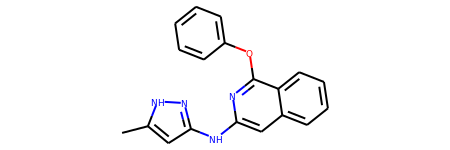

The proposed reaction is:


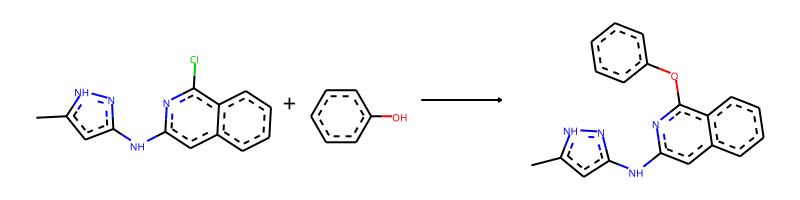

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 43897
RANK 133 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Fc1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)c(F)c1


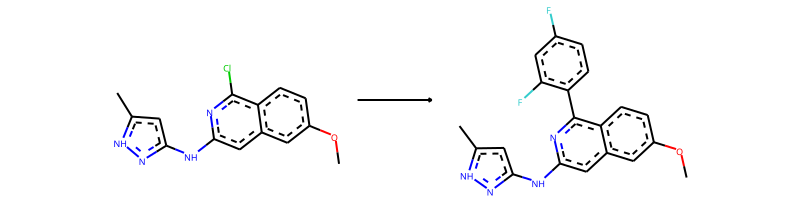

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c(-F):c:1


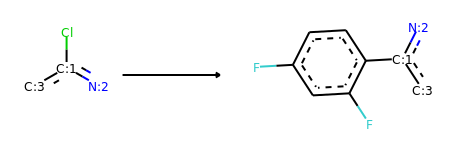

Product similarity 0.8395061728395061, overall 0.6605950212507589, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3F)n2)n[nH]1


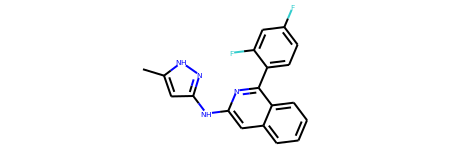

The proposed reaction is:


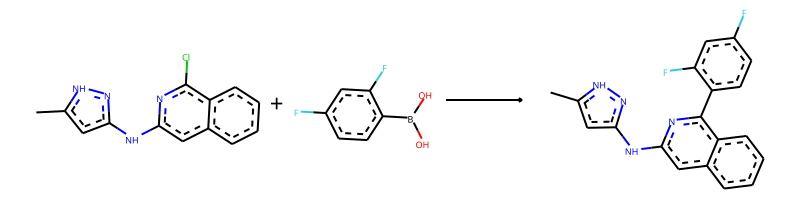

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(F)cc1F>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3F)n2)n[nH]1


--------------------------------------------------

Train index: 39592
RANK 134 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Fc1ccccc1-[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12


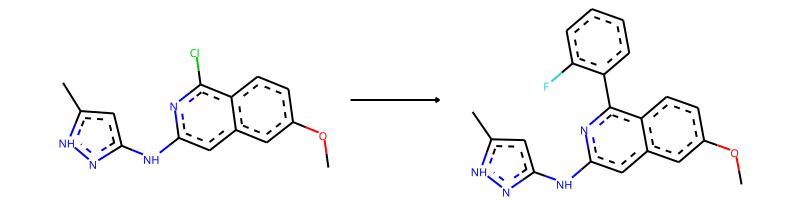

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c:c:1-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


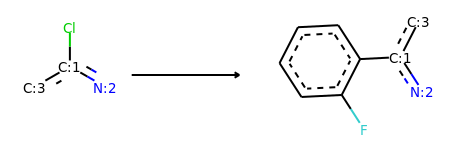

Product similarity 0.8354430379746836, overall 0.6573978003735215, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccccc3F)n2)n[nH]1


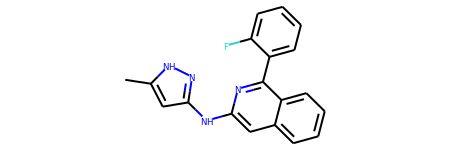

The proposed reaction is:


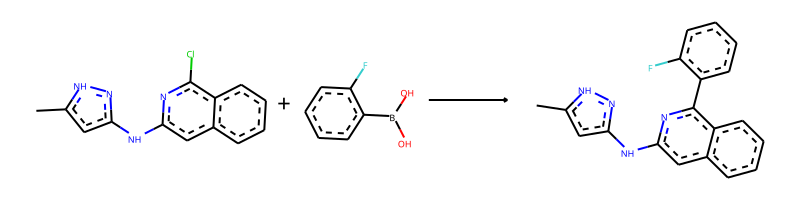

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccccc1F>>Cc1cc(Nc2cc3ccccc3c(-c3ccccc3F)n2)n[nH]1


--------------------------------------------------

Train index: 409041
RANK 135 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12>>Cc1ccc(O[c:10]2[n:11][c:12]([NH:22][c:23]3[n:24][nH:25][c:26]([CH3:28])[cH:27]3)[cH:13][c:14]3[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]23)cc1


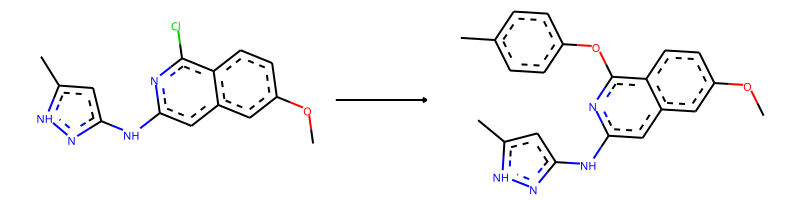

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


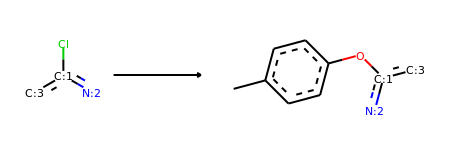

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


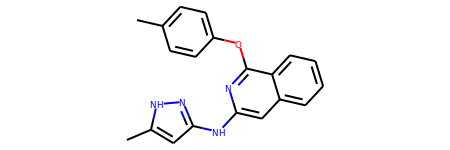

The proposed reaction is:


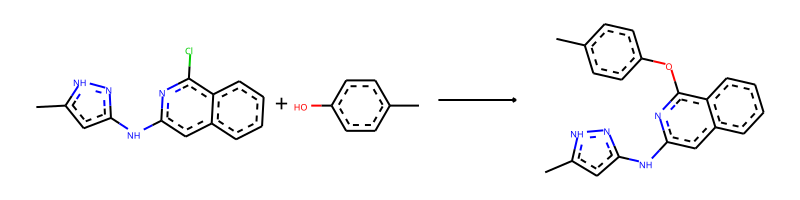

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1ccc(O)cc1>>Cc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 112606
RANK 136 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>CCc1cccc(N[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)c1


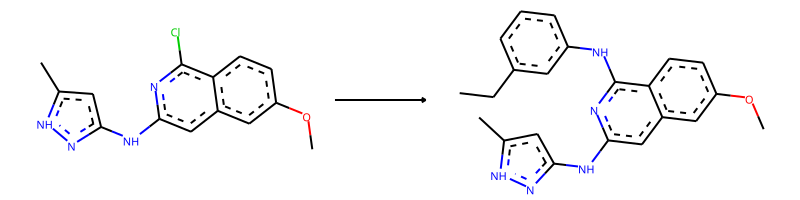

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C-c1:c:c:c:c(-N-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


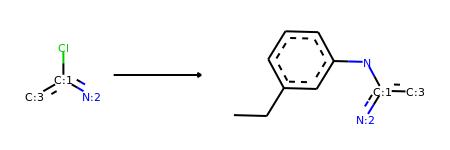

Product similarity 0.8470588235294118, overall 0.6665380906460945, smiles CCc1cccc(Nc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


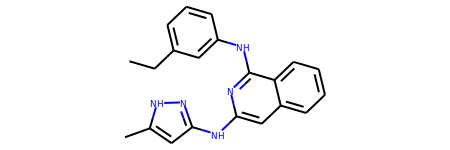

The proposed reaction is:


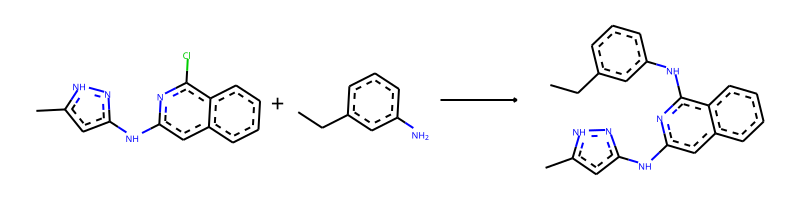

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CCc1cccc(N)c1>>CCc1cccc(Nc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


--------------------------------------------------

Train index: 287708
RANK 137 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[c:7]([O:12][CH3:13])[cH:8][cH:9][cH:10][c:11]12>>CO[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[c:7]([O:12][CH3:13])[cH:8][cH:9][cH:10][c:11]12


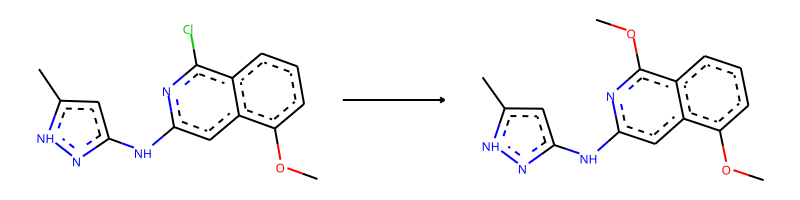

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


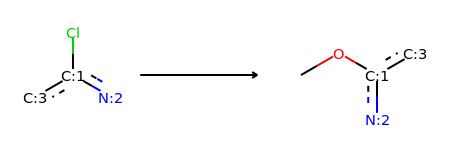

Product similarity 0.796875, overall 0.6270491803278688, smiles COc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


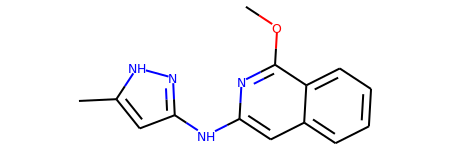

The proposed reaction is:


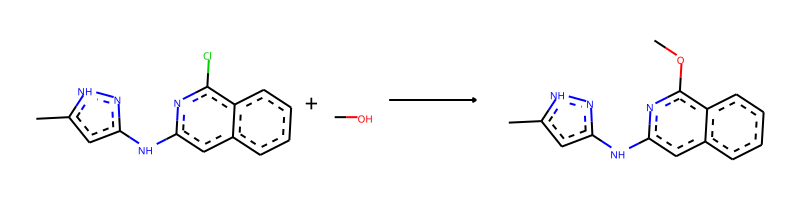

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CO>>COc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


--------------------------------------------------

Train index: 273788
RANK 138 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>C1CC1[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12


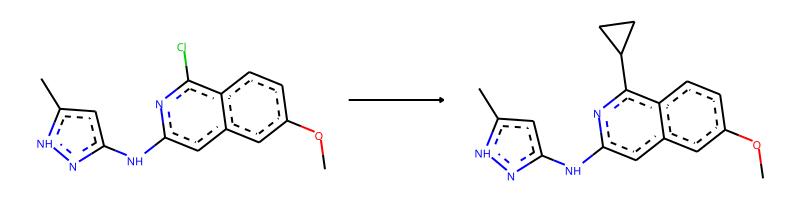

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-C1-C-C-1


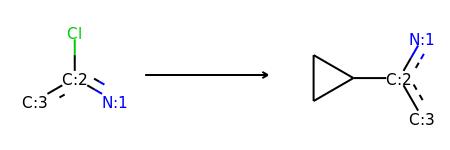

Product similarity 0.8059701492537313, overall 0.6342060190849034, smiles Cc1cc(Nc2cc3ccccc3c(C3CC3)n2)n[nH]1


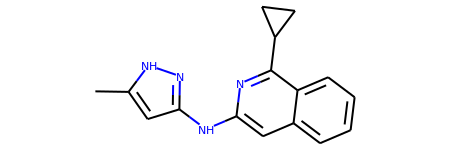

The proposed reaction is:


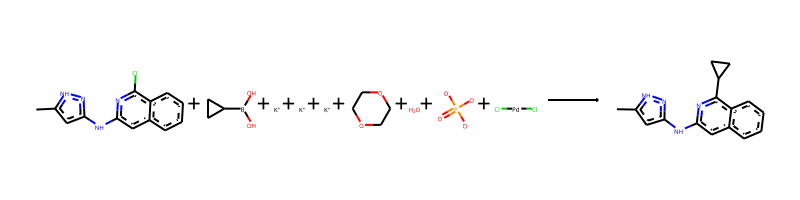

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)C1CC1.[K+].[K+].[K+].C1COCCO1.O.O=P([O-])([O-])[O-].Cl[Pd]Cl>>Cc1cc(Nc2cc3ccccc3c(C3CC3)n2)n[nH]1


--------------------------------------------------

Train index: 240187
RANK 139 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12>>Cc1ccccc1O[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12


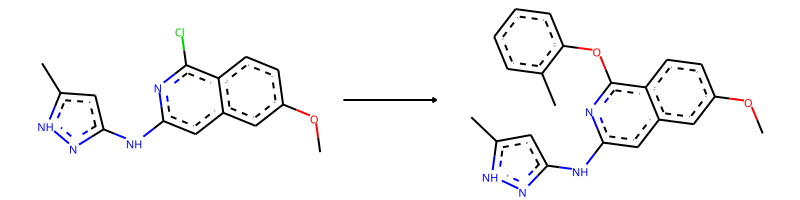

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:c:c:c:c:1-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


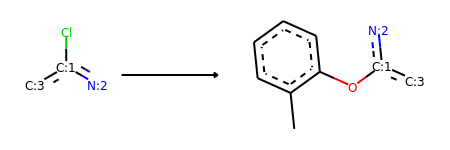

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3C)n2)n[nH]1


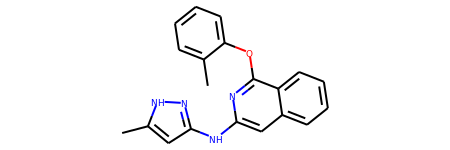

The proposed reaction is:


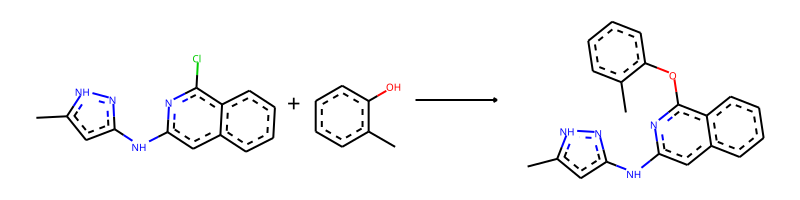

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1ccccc1O>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3C)n2)n[nH]1


--------------------------------------------------

Train index: 29974
RANK 140 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][cH:8][c:9]([O:12][CH3:13])[cH:10][c:11]12>>CO[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][cH:8][c:9]([O:12][CH3:13])[cH:10][c:11]12


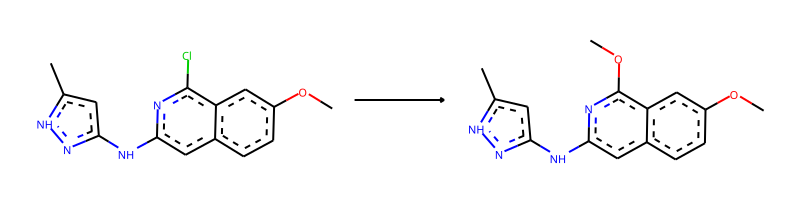

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


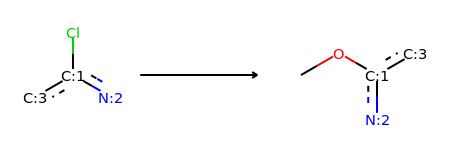

Product similarity 0.796875, overall 0.6270491803278688, smiles COc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


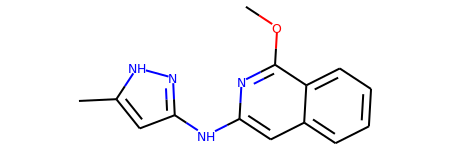

The proposed reaction is:


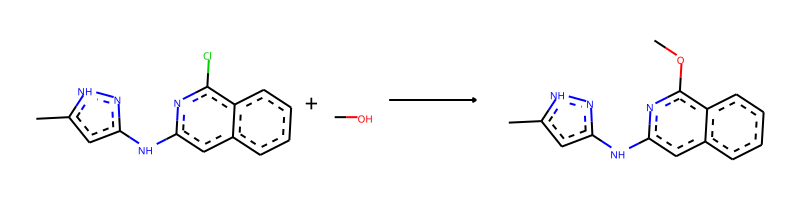

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CO>>COc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


--------------------------------------------------

Train index: 172770
RANK 141 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12>>Fc1ccccc1O[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12


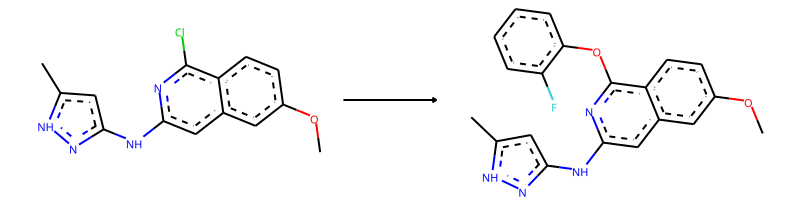

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c:c:1-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


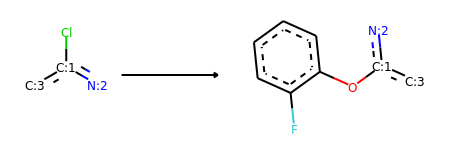

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3F)n2)n[nH]1


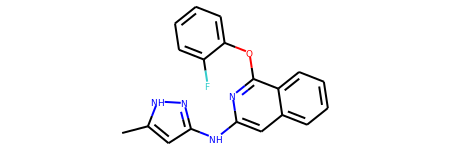

The proposed reaction is:


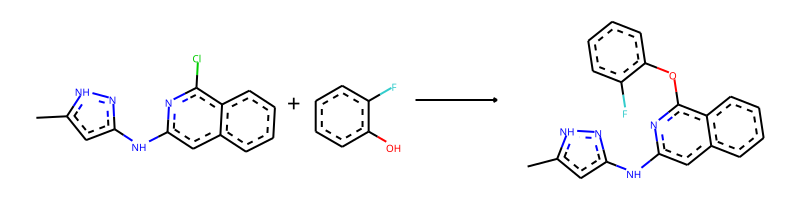

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1F>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3F)n2)n[nH]1


--------------------------------------------------

Train index: 361532
RANK 142 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>FC(F)(F)c1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


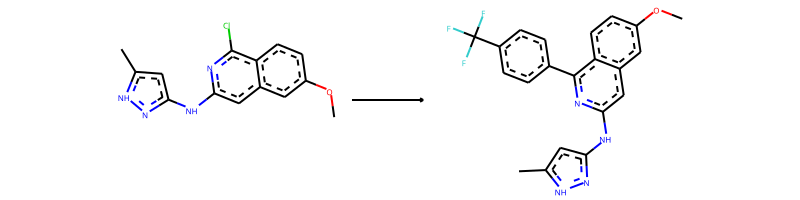

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-C(-F)(-F)-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


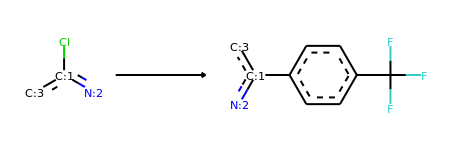

Product similarity 0.8488372093023255, overall 0.6679374761723217, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(C(F)(F)F)cc3)n2)n[nH]1


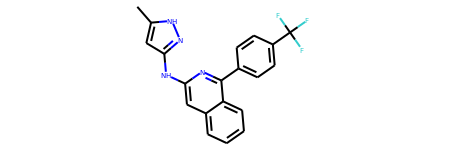

The proposed reaction is:


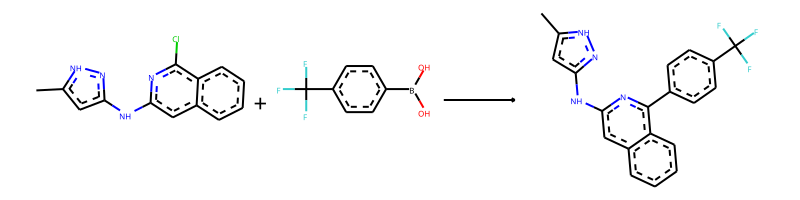

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(C(F)(F)F)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(C(F)(F)F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 268515
RANK 143 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:11]1[n:12][c:13]([NH:23][c:24]2[n:25][nH:26][c:27]([CH3:29])[cH:28]2)[cH:14][c:15]2[cH:16][cH:17][c:18]([O:21][CH3:22])[cH:19][c:20]12>>N#Cc1ccc(O[c:11]2[n:12][c:13]([NH:23][c:24]3[n:25][nH:26][c:27]([CH3:29])[cH:28]3)[cH:14][c:15]3[cH:16][cH:17][c:18]([O:21][CH3:22])[cH:19][c:20]23)cc1


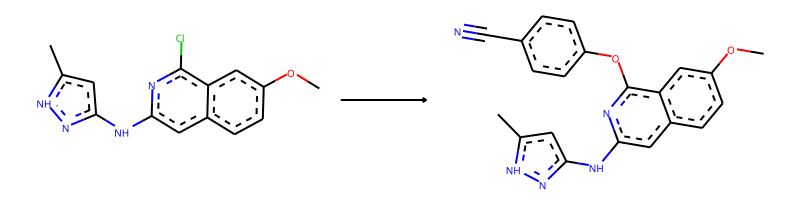

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>N#C-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


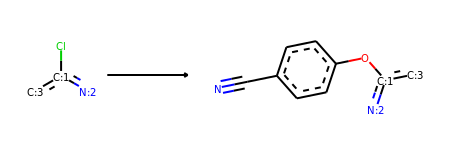

Product similarity 0.8470588235294118, overall 0.6665380906460945, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(C#N)cc3)n2)n[nH]1


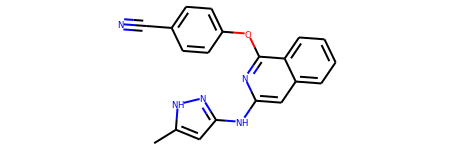

The proposed reaction is:


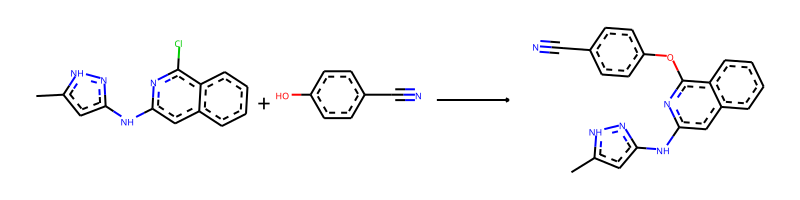

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.N#Cc1ccc(O)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(C#N)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 65661
RANK 144 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:13][c:14]2[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12>>Fc1cccc(O[c:10]2[n:11][c:12]([NH:22][c:23]3[n:24][nH:25][c:26]([CH3:28])[cH:27]3)[cH:13][c:14]3[cH:15][c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]23)c1


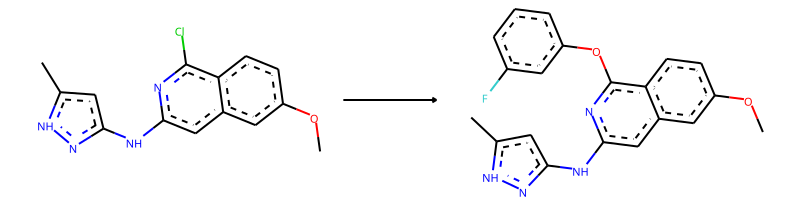

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


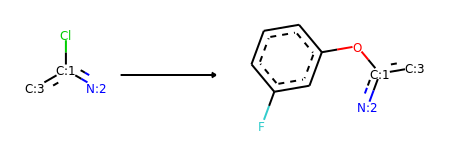

Product similarity 0.8414634146341463, overall 0.6621351459416233, smiles Cc1cc(Nc2cc3ccccc3c(Oc3cccc(F)c3)n2)n[nH]1


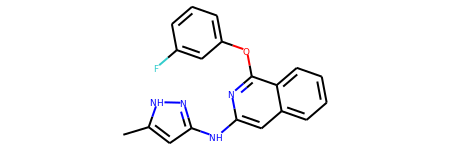

The proposed reaction is:


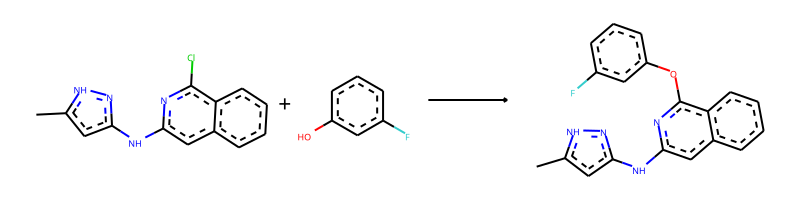

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1cccc(F)c1>>Cc1cc(Nc2cc3ccccc3c(Oc3cccc(F)c3)n2)n[nH]1


--------------------------------------------------

Train index: 316477
RANK 145 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:11]1[n:12][c:13]([NH:23][c:24]2[n:25][nH:26][c:27]([CH3:29])[cH:28]2)[cH:14][c:15]2[cH:16][c:17]([O:21][CH3:22])[cH:18][cH:19][c:20]12>>COc1ccc(O[c:11]2[n:12][c:13]([NH:23][c:24]3[n:25][nH:26][c:27]([CH3:29])[cH:28]3)[cH:14][c:15]3[cH:16][c:17]([O:21][CH3:22])[cH:18][cH:19][c:20]23)cc1


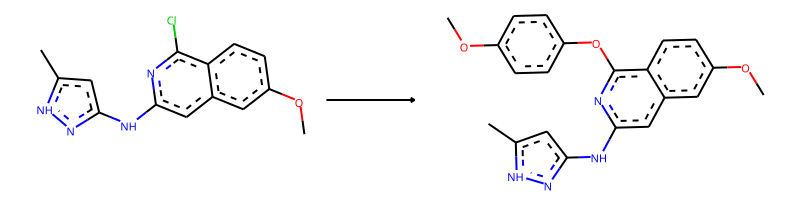

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


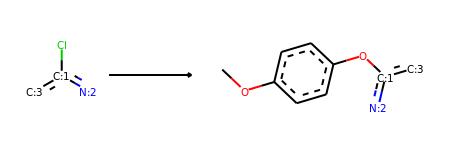

Product similarity 0.8470588235294118, overall 0.6665380906460945, smiles COc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


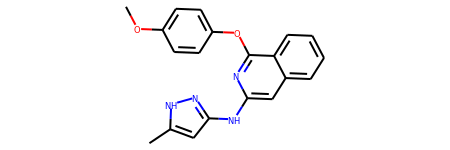

The proposed reaction is:


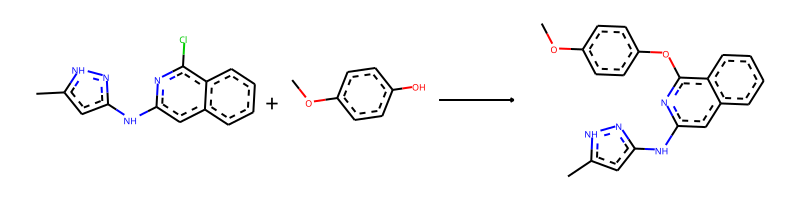

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.COc1ccc(O)cc1>>COc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 130569
RANK 146 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>CC(=O)c1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


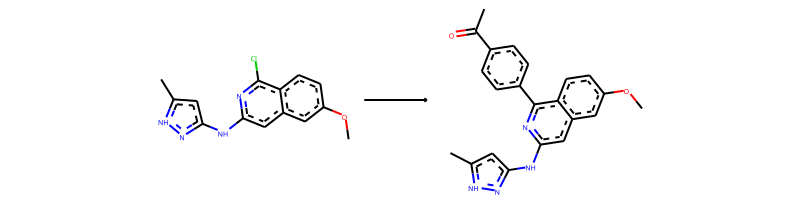

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(=O)-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


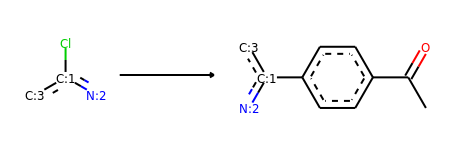

Product similarity 0.8452380952380952, overall 0.6651053864168618, smiles CC(=O)c1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


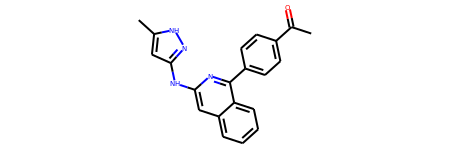

The proposed reaction is:


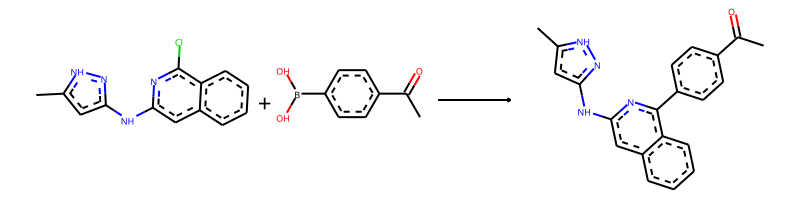

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(=O)c1ccc(B(O)O)cc1>>CC(=O)c1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 26555
RANK 147 PRECEDENT
REACTANT MATCH SCORE: 0.7868852459016393
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][c:18]([CH3:20])[cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>C1CC(O[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][c:18]([CH3:20])[cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)C1


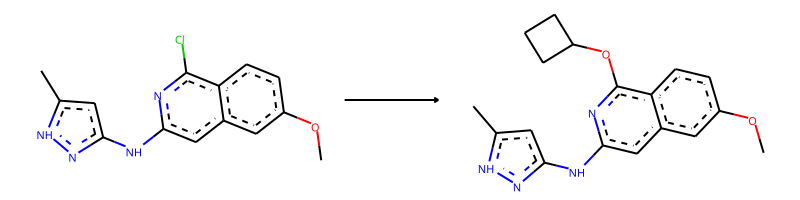

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-C1-C-C-C-1


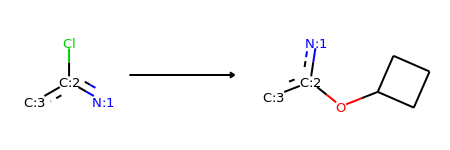

Product similarity 0.821917808219178, overall 0.6467549966314844, smiles Cc1cc(Nc2cc3ccccc3c(OC3CCC3)n2)n[nH]1


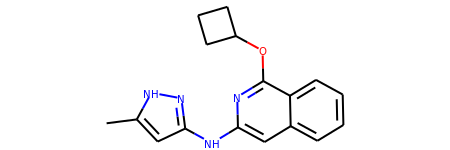

The proposed reaction is:


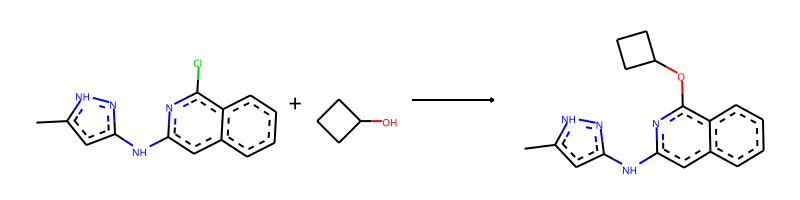

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OC1CCC1>>Cc1cc(Nc2cc3ccccc3c(OC3CCC3)n2)n[nH]1


--------------------------------------------------

Train index: 1597
RANK 148 PRECEDENT
REACTANT MATCH SCORE: 0.7096774193548387
Reaction SMILES (Precedent): O[c:8]1[n:7][c:6]([NH:13][c:14]2[n:15][nH:16][c:17]([CH3:19])[cH:18]2)[cH:5][c:4]2[cH:3][c:2]([Br:1])[cH:11][cH:10][c:9]21>>Cl[c:8]1[n:7][c:6]([NH:13][c:14]2[n:15][nH:16][c:17]([CH3:19])[cH:18]2)[cH:5][c:4]2[cH:3][c:2]([Br:1])[cH:11][cH:10][c:9]21


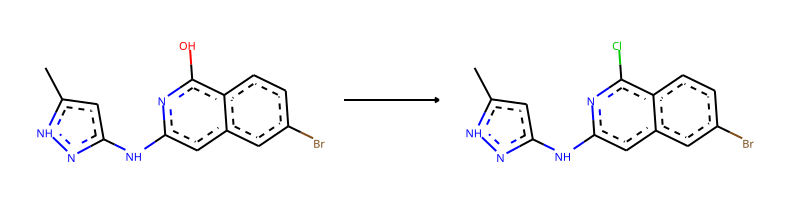

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[O;H1;D1;+0]):[c:3]>>Cl-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


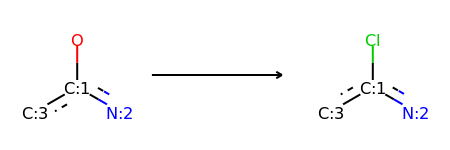

->No precursors could be generated!


--------------------------------------------------

Train index: 47006
RANK 149 PRECEDENT
REACTANT MATCH SCORE: 0.7096774193548387
Reaction SMILES (Precedent): O[c:9]1[n:8][c:7]([NH:13][c:14]2[n:15][nH:16][c:17]([CH3:19])[cH:18]2)[cH:6][c:5]2[cH:4][cH:3][c:2]([Br:1])[cH:11][c:10]21>>Cl[c:9]1[n:8][c:7]([NH:13][c:14]2[n:15][nH:16][c:17]([CH3:19])[cH:18]2)[cH:6][c:5]2[cH:4][cH:3][c:2]([Br:1])[cH:11][c:10]21


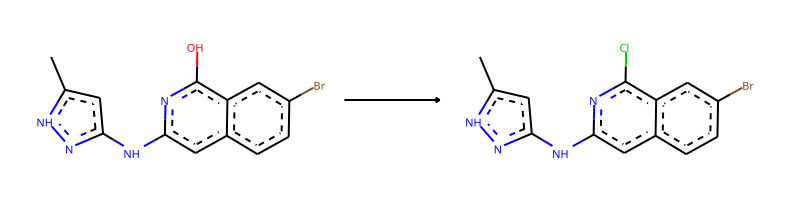

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[O;H1;D1;+0]):[c:3]>>Cl-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


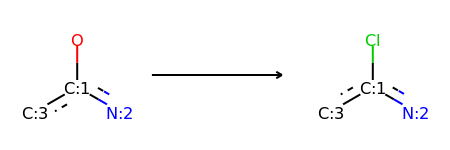

->No precursors could be generated!


--------------------------------------------------

Train index: 461629
RANK 150 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:24][c:25]2[n:26][nH:27][c:28]([CH3:30])[cH:29]2)[cH:13][c:14]2[c:15]([O:22][CH3:23])[c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12>>Clc1ccc(O[c:10]2[n:11][c:12]([NH:24][c:25]3[n:26][nH:27][c:28]([CH3:30])[cH:29]3)[cH:13][c:14]3[c:15]([O:22][CH3:23])[c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]23)cc1


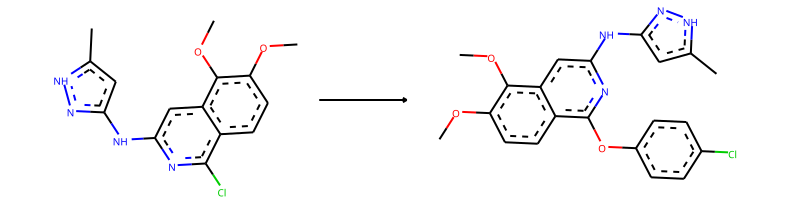

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


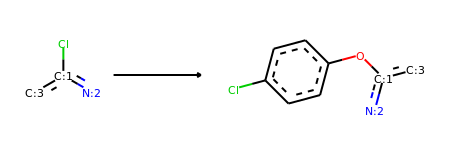

Product similarity 0.7528089887640449, overall 0.5092531394580304, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(Cl)cc3)n2)n[nH]1


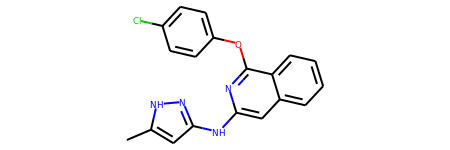

The proposed reaction is:


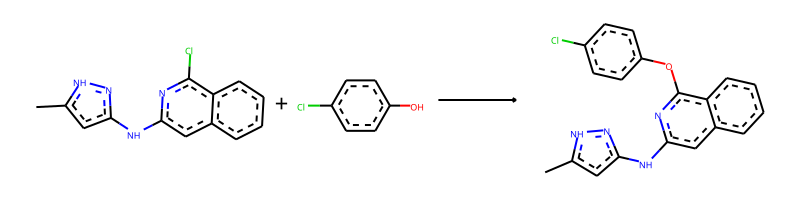

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(Cl)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(Cl)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 197862
RANK 151 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:24][c:25]2[n:26][nH:27][c:28]([CH3:30])[cH:29]2)[cH:13][c:14]2[cH:15][c:16]([O:22][CH3:23])[c:17]([O:20][CH3:21])[cH:18][c:19]12>>Fc1ccc(O[c:10]2[n:11][c:12]([NH:24][c:25]3[n:26][nH:27][c:28]([CH3:30])[cH:29]3)[cH:13][c:14]3[cH:15][c:16]([O:22][CH3:23])[c:17]([O:20][CH3:21])[cH:18][c:19]23)cc1


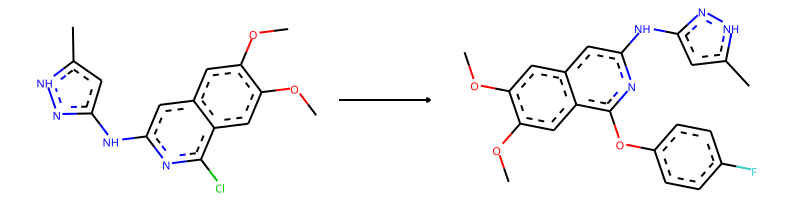

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


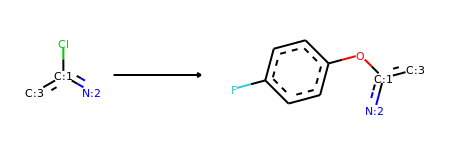

Product similarity 0.7528089887640449, overall 0.5092531394580304, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


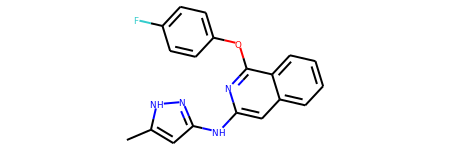

The proposed reaction is:


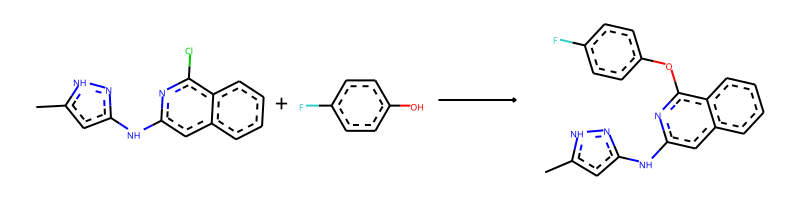

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(F)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 262679
RANK 152 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:11]1[n:12][c:13]([NH:25][c:26]2[n:27][nH:28][c:29]([CH3:31])[cH:30]2)[cH:14][c:15]2[c:16]([O:23][CH3:24])[c:17]([O:21][CH3:22])[cH:18][cH:19][c:20]12>>N#Cc1ccc(O[c:11]2[n:12][c:13]([NH:25][c:26]3[n:27][nH:28][c:29]([CH3:31])[cH:30]3)[cH:14][c:15]3[c:16]([O:23][CH3:24])[c:17]([O:21][CH3:22])[cH:18][cH:19][c:20]23)cc1


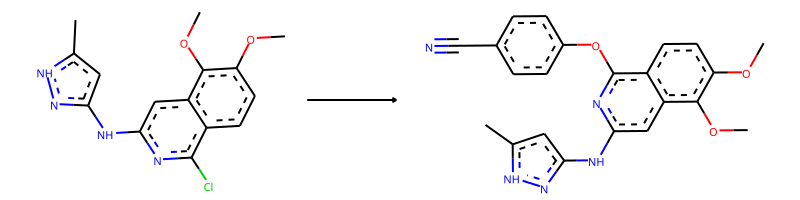

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>N#C-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


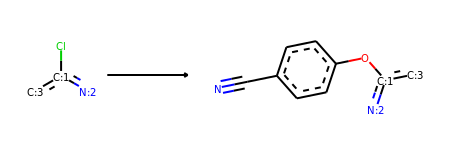

Product similarity 0.7608695652173914, overall 0.5147058823529412, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(C#N)cc3)n2)n[nH]1


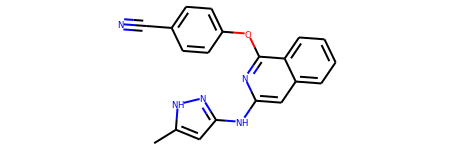

The proposed reaction is:


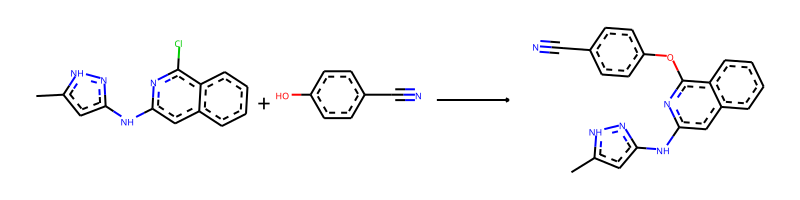

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.N#Cc1ccc(O)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(C#N)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 250118
RANK 153 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:16][c:17]2[n:18][nH:19][c:20]([CH3:22])[cH:21]2)[cH:5][c:6]2[cH:7][c:8]([O:14][CH3:15])[c:9]([O:12][CH3:13])[cH:10][c:11]12>>C1CC(O[c:2]2[n:3][c:4]([NH:16][c:17]3[n:18][nH:19][c:20]([CH3:22])[cH:21]3)[cH:5][c:6]3[cH:7][c:8]([O:14][CH3:15])[c:9]([O:12][CH3:13])[cH:10][c:11]23)CO1


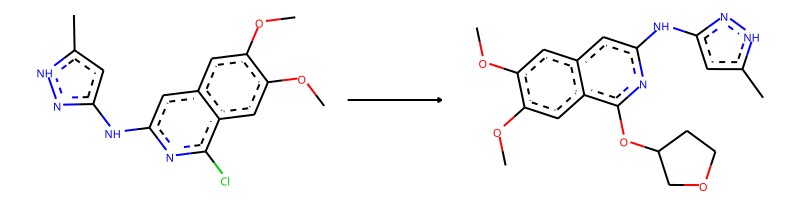

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-C1-C-C-O-C-1


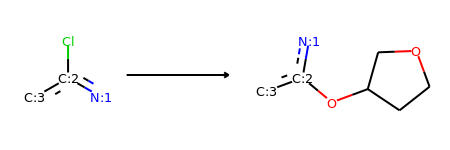

Product similarity 0.7380952380952381, overall 0.49929971988795524, smiles Cc1cc(Nc2cc3ccccc3c(OC3CCOC3)n2)n[nH]1


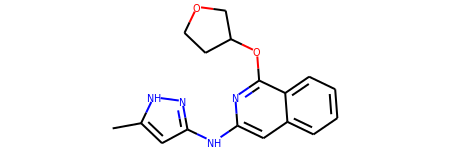

The proposed reaction is:


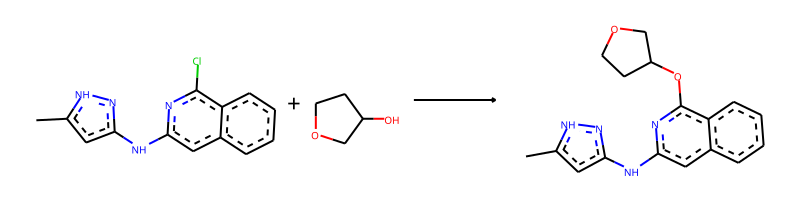

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OC1CCOC1>>Cc1cc(Nc2cc3ccccc3c(OC3CCOC3)n2)n[nH]1


--------------------------------------------------

Train index: 237507
RANK 154 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:9]1[n:10][c:11]([NH:23][c:24]2[n:25][nH:26][c:27]([CH3:29])[cH:28]2)[cH:12][c:13]2[cH:14][c:15]([O:21][CH3:22])[c:16]([O:19][CH3:20])[cH:17][c:18]12>>c1ccc(O[c:9]2[n:10][c:11]([NH:23][c:24]3[n:25][nH:26][c:27]([CH3:29])[cH:28]3)[cH:12][c:13]3[cH:14][c:15]([O:21][CH3:22])[c:16]([O:19][CH3:20])[cH:17][c:18]23)cc1


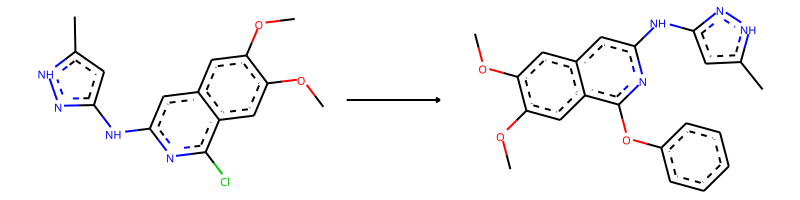

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-c1:c:c:c:c:c:1


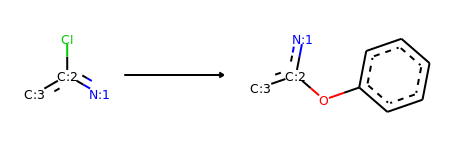

Product similarity 0.7471264367816092, overall 0.5054090601757945, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


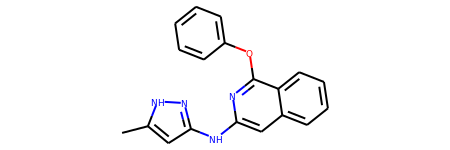

The proposed reaction is:


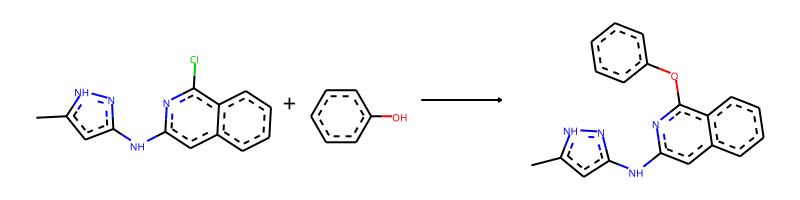

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 54171
RANK 155 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:16][c:17]2[n:18][nH:19][c:20]([CH3:22])[cH:21]2)[cH:5][c:6]2[c:7]([O:14][CH3:15])[c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>c1ccc(-[c:2]2[n:3][c:4]([NH:16][c:17]3[n:18][nH:19][c:20]([CH3:22])[cH:21]3)[cH:5][c:6]3[c:7]([O:14][CH3:15])[c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


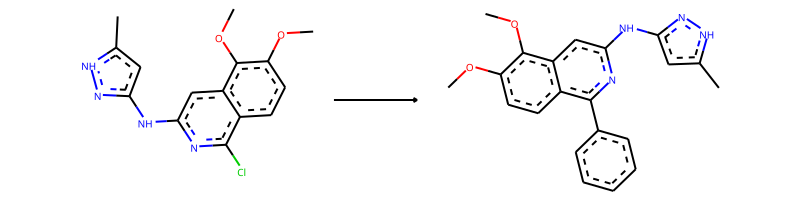

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:c:c:c:c:1


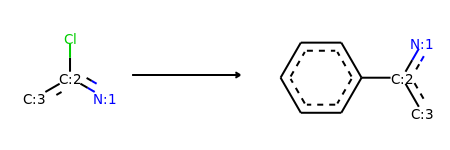

Product similarity 0.7380952380952381, overall 0.49929971988795524, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccccc3)n2)n[nH]1


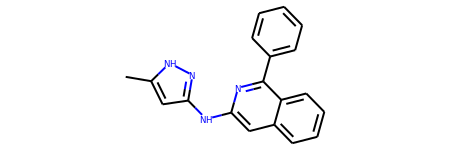

The proposed reaction is:


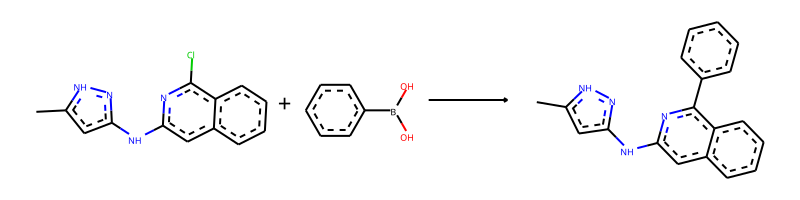

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccccc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 237415
RANK 156 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:16][c:17]2[n:18][nH:19][c:20]([CH3:22])[cH:21]2)[cH:5][c:6]2[cH:7][c:8]([O:14][CH3:15])[c:9]([O:12][CH3:13])[cH:10][c:11]12>>N#Cc1ccc(N[c:2]2[n:3][c:4]([NH:16][c:17]3[n:18][nH:19][c:20]([CH3:22])[cH:21]3)[cH:5][c:6]3[cH:7][c:8]([O:14][CH3:15])[c:9]([O:12][CH3:13])[cH:10][c:11]23)cc1


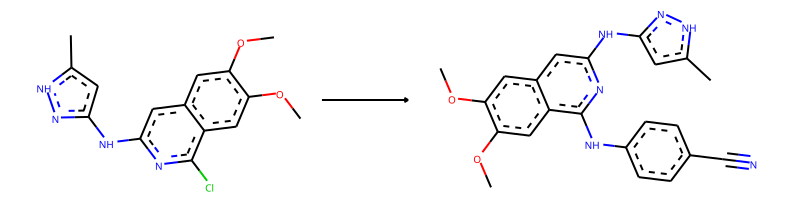

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>N#C-c1:c:c:c(-N-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


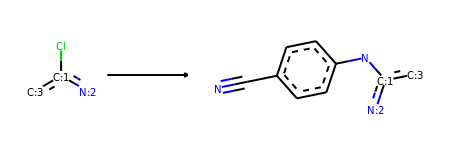

Product similarity 0.7608695652173914, overall 0.5147058823529412, smiles Cc1cc(Nc2cc3ccccc3c(Nc3ccc(C#N)cc3)n2)n[nH]1


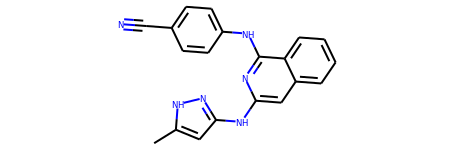

The proposed reaction is:


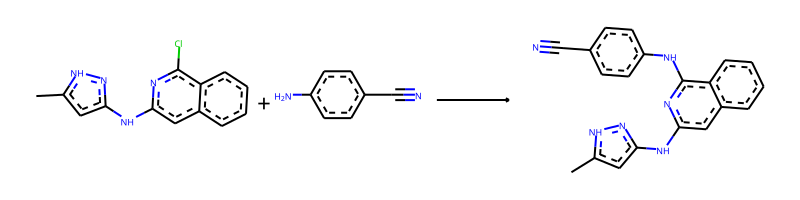

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.N#Cc1ccc(N)cc1>>Cc1cc(Nc2cc3ccccc3c(Nc3ccc(C#N)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 183385
RANK 157 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:24][c:25]2[n:26][nH:27][c:28]([CH3:30])[cH:29]2)[cH:13][c:14]2[c:15]([O:22][CH3:23])[c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]12>>Fc1ccc(O[c:10]2[n:11][c:12]([NH:24][c:25]3[n:26][nH:27][c:28]([CH3:30])[cH:29]3)[cH:13][c:14]3[c:15]([O:22][CH3:23])[c:16]([O:20][CH3:21])[cH:17][cH:18][c:19]23)cc1


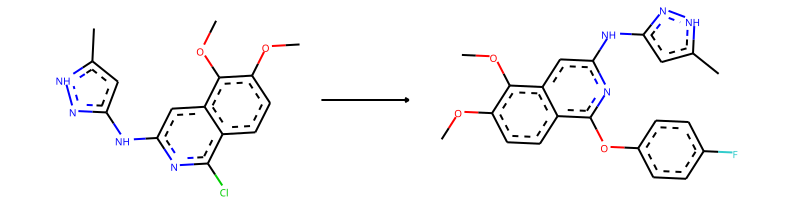

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


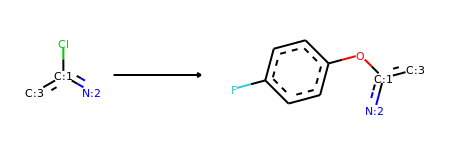

Product similarity 0.7528089887640449, overall 0.5092531394580304, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


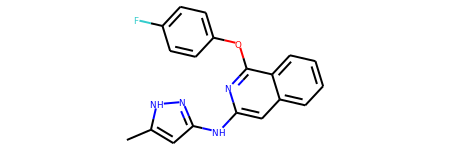

The proposed reaction is:


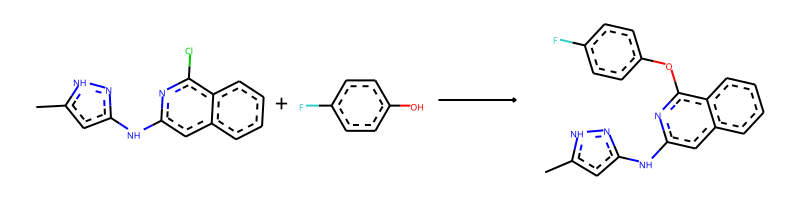

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(F)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 437302
RANK 158 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:16][c:17]2[n:18][nH:19][c:20]([CH3:22])[cH:21]2)[cH:5][c:6]2[cH:7][c:8]([O:14][CH3:15])[c:9]([O:12][CH3:13])[cH:10][c:11]12>>Fc1ccc(-[c:2]2[n:3][c:4]([NH:16][c:17]3[n:18][nH:19][c:20]([CH3:22])[cH:21]3)[cH:5][c:6]3[cH:7][c:8]([O:14][CH3:15])[c:9]([O:12][CH3:13])[cH:10][c:11]23)c(F)c1


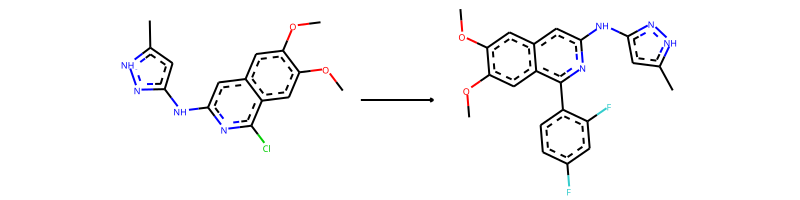

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c(-F):c:1


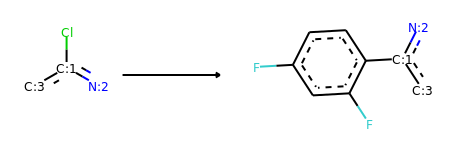

Product similarity 0.75, overall 0.5073529411764706, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3F)n2)n[nH]1


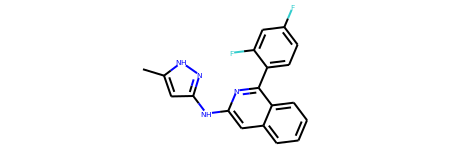

The proposed reaction is:


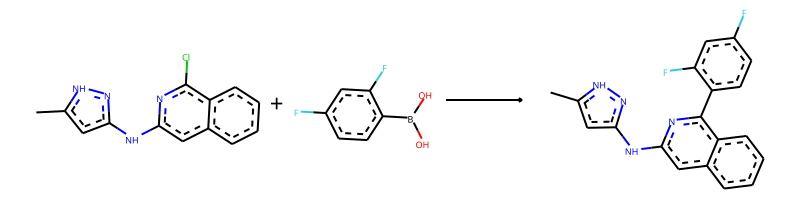

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(F)cc1F>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3F)n2)n[nH]1


--------------------------------------------------

Train index: 140017
RANK 159 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:16][c:17]2[n:18][nH:19][c:20]([CH3:22])[cH:21]2)[cH:5][c:6]2[c:7]([O:14][CH3:15])[c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>CO[c:2]1[n:3][c:4]([NH:16][c:17]2[n:18][nH:19][c:20]([CH3:22])[cH:21]2)[cH:5][c:6]2[c:7]([O:14][CH3:15])[c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12


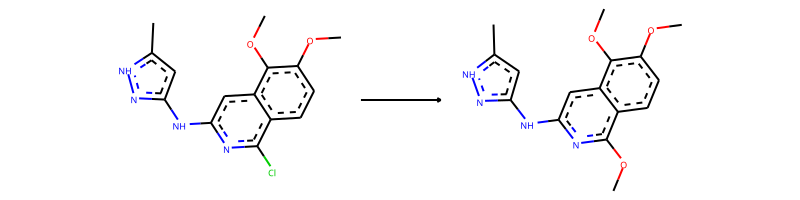

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


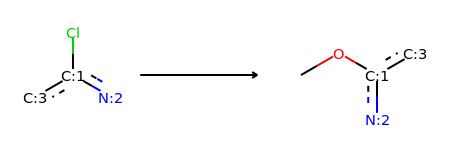

Product similarity 0.6901408450704225, overall 0.46685998342999174, smiles COc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


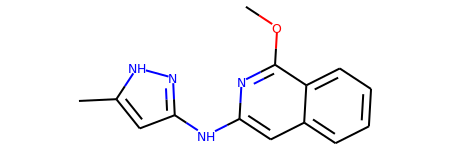

The proposed reaction is:


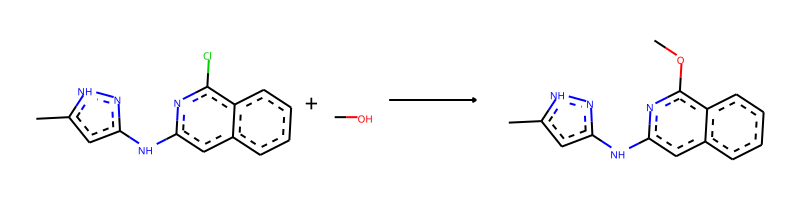

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CO>>COc1nc(Nc2cc(C)[nH]n2)cc2ccccc12


--------------------------------------------------

Train index: 476511
RANK 160 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:13]1[n:14][c:15]([NH:27][c:28]2[n:29][nH:30][c:31]([CH3:33])[cH:32]2)[cH:16][c:17]2[cH:18][c:19]([O:25][CH3:26])[c:20]([O:23][CH3:24])[cH:21][c:22]12>>CC(=O)Nc1ccc(O[c:13]2[n:14][c:15]([NH:27][c:28]3[n:29][nH:30][c:31]([CH3:33])[cH:32]3)[cH:16][c:17]3[cH:18][c:19]([O:25][CH3:26])[c:20]([O:23][CH3:24])[cH:21][c:22]23)cc1


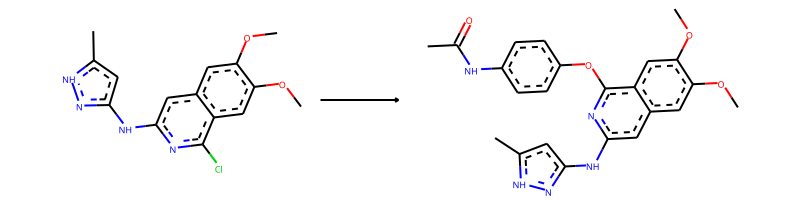

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(=O)-N-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


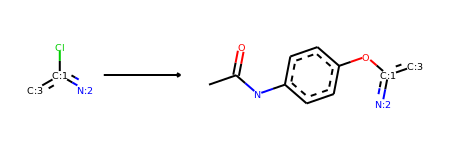

Product similarity 0.7731958762886598, overall 0.5230442692540934, smiles CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


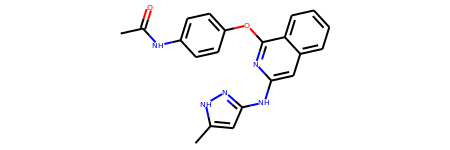

The proposed reaction is:


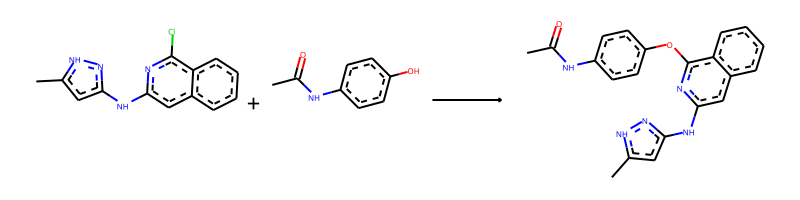

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(=O)Nc1ccc(O)cc1>>CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 443155
RANK 161 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:8]1[n:9][c:10]([NH:22][c:23]2[n:24][nH:25][c:26]([CH3:28])[cH:27]2)[cH:11][c:12]2[cH:13][c:14]([O:20][CH3:21])[c:15]([C:18]#[N:19])[cH:16][c:17]12>>C1CC(O[c:8]2[n:9][c:10]([NH:22][c:23]3[n:24][nH:25][c:26]([CH3:28])[cH:27]3)[cH:11][c:12]3[cH:13][c:14]([O:20][CH3:21])[c:15]([C:18]#[N:19])[cH:16][c:17]23)CO1


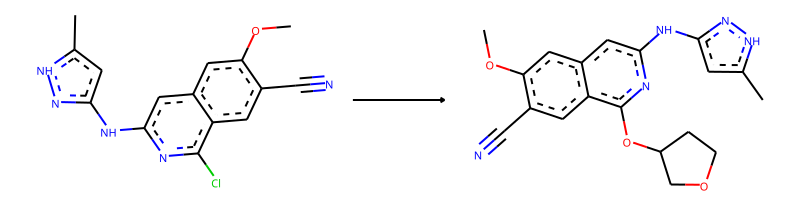

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-C1-C-C-O-C-1


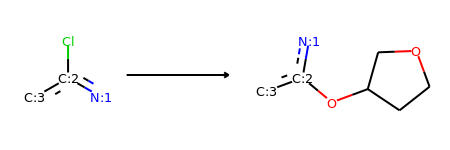

Product similarity 0.7380952380952381, overall 0.49929971988795524, smiles Cc1cc(Nc2cc3ccccc3c(OC3CCOC3)n2)n[nH]1


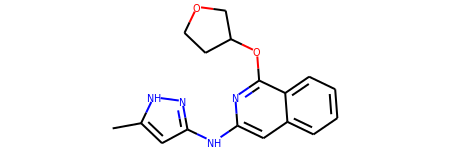

The proposed reaction is:


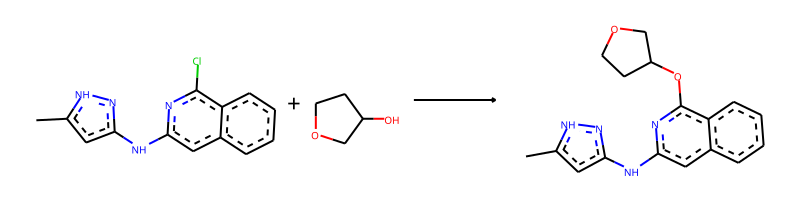

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OC1CCOC1>>Cc1cc(Nc2cc3ccccc3c(OC3CCOC3)n2)n[nH]1


--------------------------------------------------

Train index: 171268
RANK 162 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:16][c:17]2[n:18][nH:19][c:20]([CH3:22])[cH:21]2)[cH:5][c:6]2[cH:7][c:8]([O:14][CH3:15])[c:9]([O:12][CH3:13])[cH:10][c:11]12>>C1CC(O[c:2]2[n:3][c:4]([NH:16][c:17]3[n:18][nH:19][c:20]([CH3:22])[cH:21]3)[cH:5][c:6]3[cH:7][c:8]([O:14][CH3:15])[c:9]([O:12][CH3:13])[cH:10][c:11]23)C1


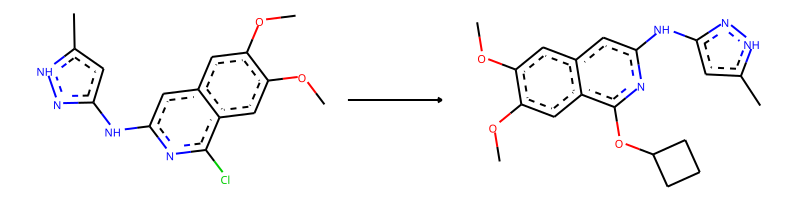

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-C1-C-C-C-1


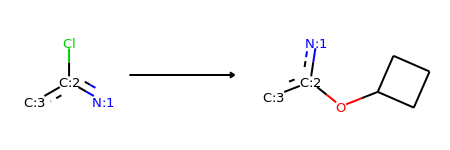

Product similarity 0.725, overall 0.49044117647058827, smiles Cc1cc(Nc2cc3ccccc3c(OC3CCC3)n2)n[nH]1


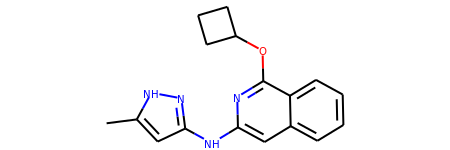

The proposed reaction is:


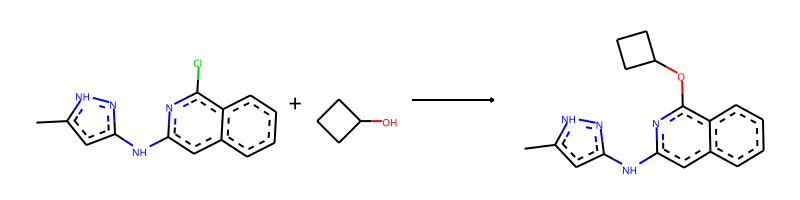

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OC1CCC1>>Cc1cc(Nc2cc3ccccc3c(OC3CCC3)n2)n[nH]1


--------------------------------------------------

Train index: 171412
RANK 163 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:16][c:17]2[n:18][nH:19][c:20]([CH3:22])[cH:21]2)[cH:5][c:6]2[cH:7][c:8]([O:14][CH3:15])[c:9]([O:12][CH3:13])[cH:10][c:11]12>>c1ccc(-[c:2]2[n:3][c:4]([NH:16][c:17]3[n:18][nH:19][c:20]([CH3:22])[cH:21]3)[cH:5][c:6]3[cH:7][c:8]([O:14][CH3:15])[c:9]([O:12][CH3:13])[cH:10][c:11]23)cc1


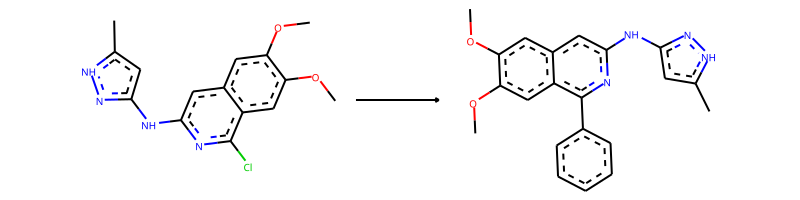

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:c:c:c:c:1


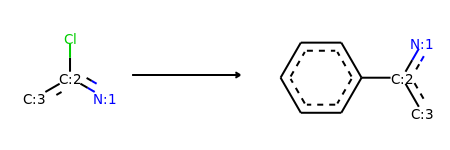

Product similarity 0.7380952380952381, overall 0.49929971988795524, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccccc3)n2)n[nH]1


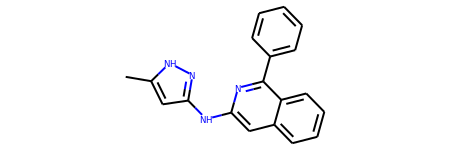

The proposed reaction is:


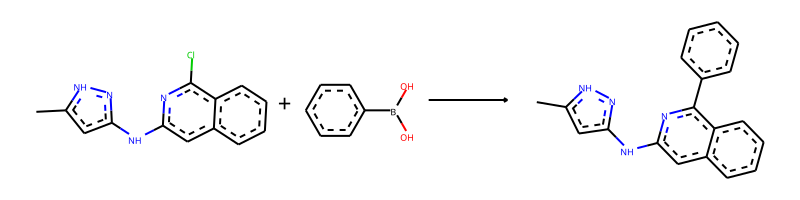

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccccc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 432659
RANK 164 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:13]1[n:14][c:15]([NH:27][c:28]2[n:29][nH:30][c:31]([CH3:33])[cH:32]2)[cH:16][c:17]2[c:18]([O:25][CH3:26])[c:19]([O:23][CH3:24])[cH:20][cH:21][c:22]12>>CC(=O)Nc1ccc(O[c:13]2[n:14][c:15]([NH:27][c:28]3[n:29][nH:30][c:31]([CH3:33])[cH:32]3)[cH:16][c:17]3[c:18]([O:25][CH3:26])[c:19]([O:23][CH3:24])[cH:20][cH:21][c:22]23)cc1


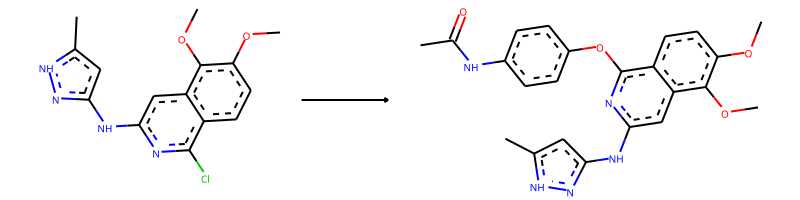

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(=O)-N-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


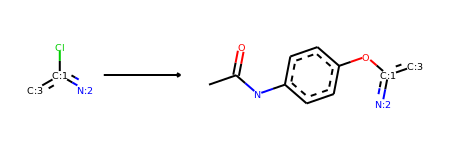

Product similarity 0.7731958762886598, overall 0.5230442692540934, smiles CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


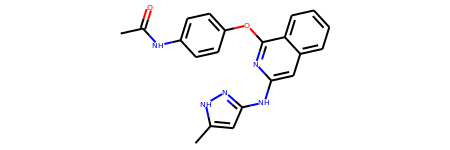

The proposed reaction is:


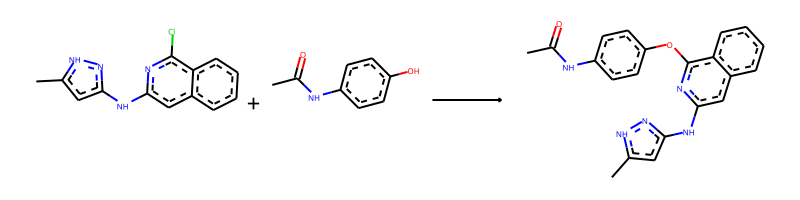

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(=O)Nc1ccc(O)cc1>>CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 450222
RANK 165 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:16][c:17]2[n:18][nH:19][c:20]([CH3:22])[cH:21]2)[cH:5][c:6]2[c:7]([O:14][CH3:15])[c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Fc1ccccc1-[c:2]1[n:3][c:4]([NH:16][c:17]2[n:18][nH:19][c:20]([CH3:22])[cH:21]2)[cH:5][c:6]2[c:7]([O:14][CH3:15])[c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12


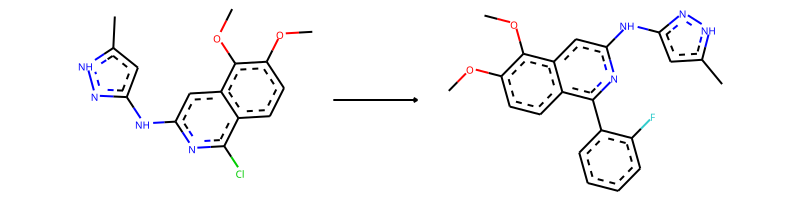

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c:c:1-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


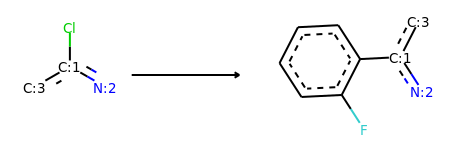

Product similarity 0.7441860465116279, overall 0.5034199726402189, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccccc3F)n2)n[nH]1


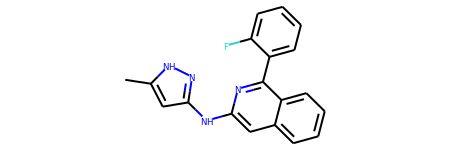

The proposed reaction is:


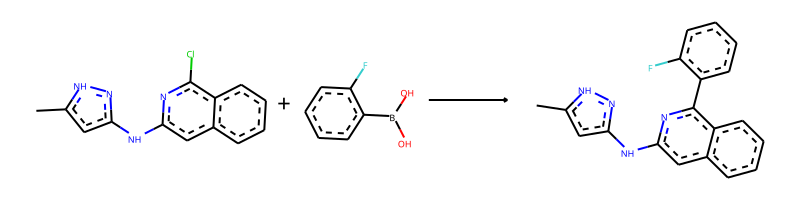

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccccc1F>>Cc1cc(Nc2cc3ccccc3c(-c3ccccc3F)n2)n[nH]1


--------------------------------------------------

Train index: 323952
RANK 166 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:16][c:17]2[n:18][nH:19][c:20]([CH3:22])[cH:21]2)[cH:5][c:6]2[cH:7][c:8]([O:14][CH3:15])[c:9]([O:12][CH3:13])[cH:10][c:11]12>>C1CCC(O[c:2]2[n:3][c:4]([NH:16][c:17]3[n:18][nH:19][c:20]([CH3:22])[cH:21]3)[cH:5][c:6]3[cH:7][c:8]([O:14][CH3:15])[c:9]([O:12][CH3:13])[cH:10][c:11]23)C1


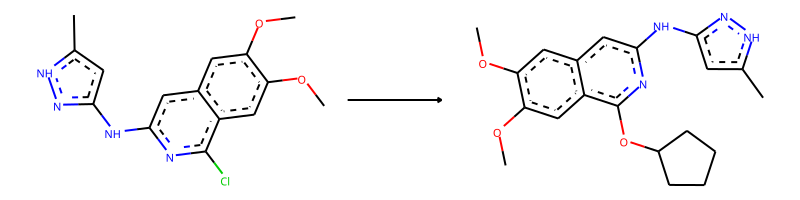

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-C1-C-C-C-C-1


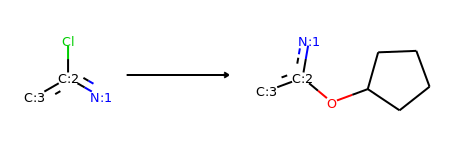

Product similarity 0.7380952380952381, overall 0.49929971988795524, smiles Cc1cc(Nc2cc3ccccc3c(OC3CCCC3)n2)n[nH]1


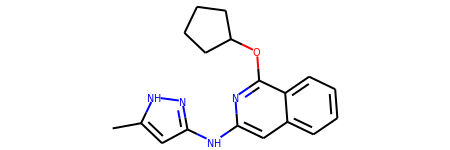

The proposed reaction is:


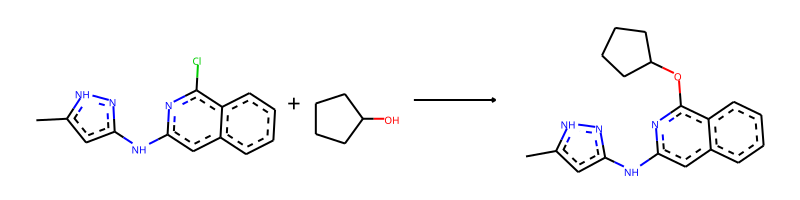

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OC1CCCC1>>Cc1cc(Nc2cc3ccccc3c(OC3CCCC3)n2)n[nH]1


--------------------------------------------------

Train index: 297693
RANK 167 PRECEDENT
REACTANT MATCH SCORE: 0.6764705882352942
Reaction SMILES (Precedent): Cl[c:9]1[n:10][c:11]([NH:23][c:24]2[n:25][nH:26][c:27]([CH3:29])[cH:28]2)[cH:12][c:13]2[c:14]([O:21][CH3:22])[c:15]([O:19][CH3:20])[cH:16][cH:17][c:18]12>>c1ccc(O[c:9]2[n:10][c:11]([NH:23][c:24]3[n:25][nH:26][c:27]([CH3:29])[cH:28]3)[cH:12][c:13]3[c:14]([O:21][CH3:22])[c:15]([O:19][CH3:20])[cH:16][cH:17][c:18]23)cc1


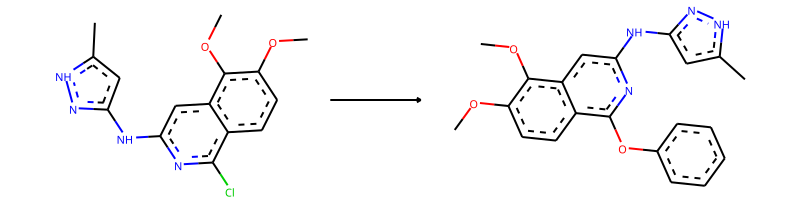

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-c1:c:c:c:c:c:1


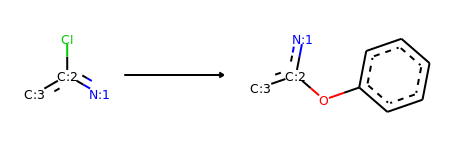

Product similarity 0.7471264367816092, overall 0.5054090601757945, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


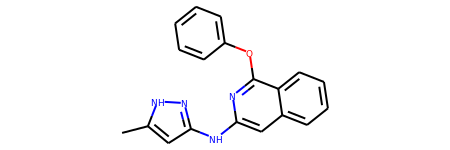

The proposed reaction is:


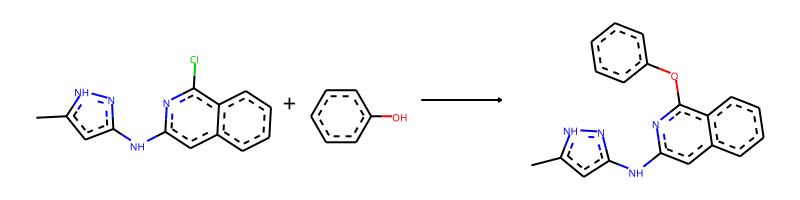

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 173868
RANK 168 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Clc1ccc(O[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


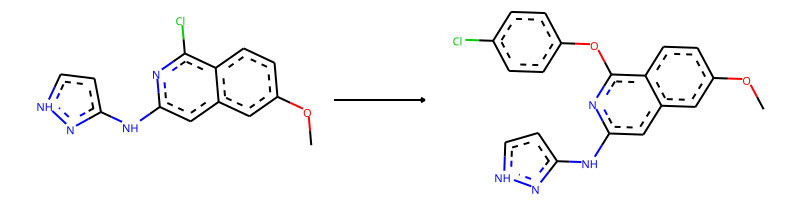

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


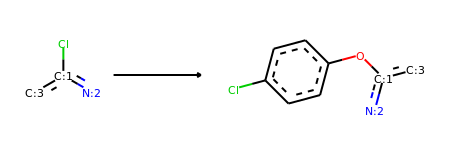

Product similarity 0.7529411764705882, overall 0.5058823529411764, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(Cl)cc3)n2)n[nH]1


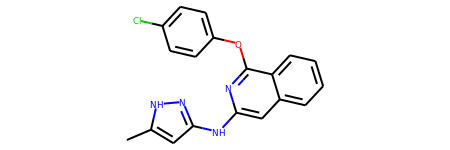

The proposed reaction is:


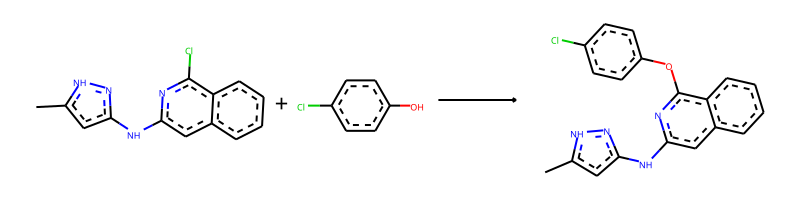

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(Cl)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(Cl)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 369837
RANK 169 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Cc1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


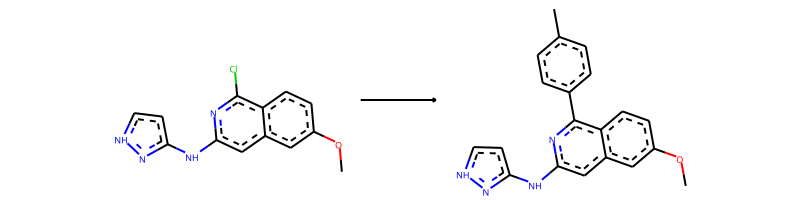

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


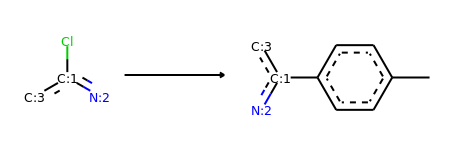

Product similarity 0.7439024390243902, overall 0.4998094512195122, smiles Cc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


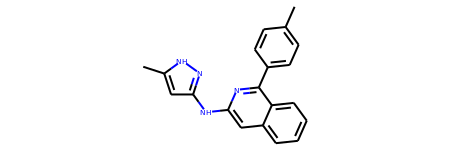

The proposed reaction is:


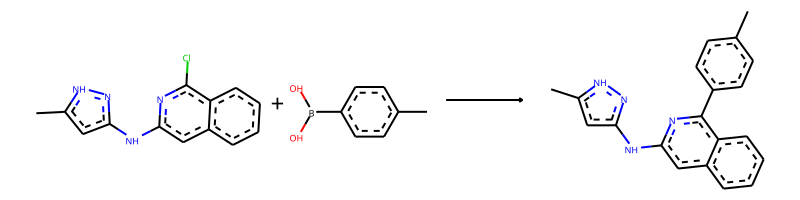

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1ccc(B(O)O)cc1>>Cc1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 359613
RANK 170 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>CC(=O)c1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


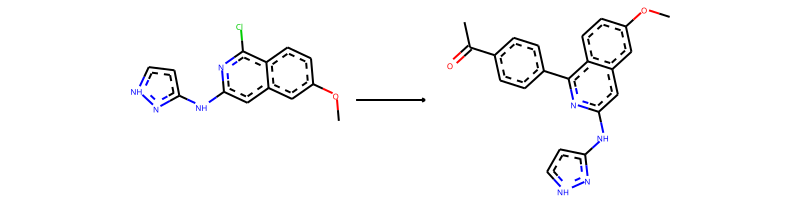

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(=O)-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


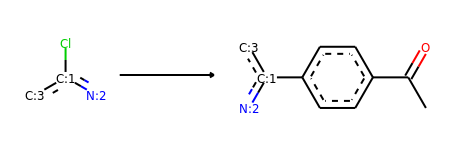

Product similarity 0.7586206896551724, overall 0.509698275862069, smiles CC(=O)c1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


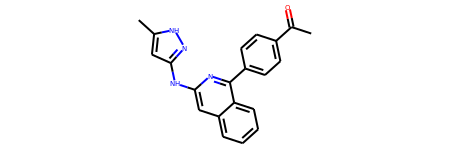

The proposed reaction is:


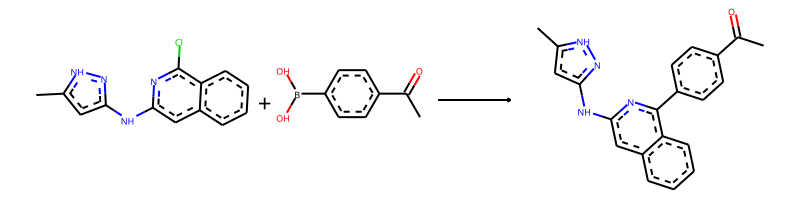

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(=O)c1ccc(B(O)O)cc1>>CC(=O)c1ccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 474979
RANK 171 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Clc1cccc(O[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)c1


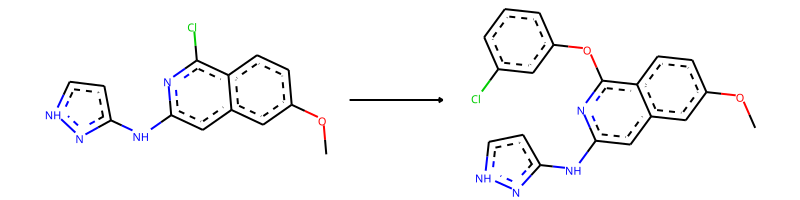

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


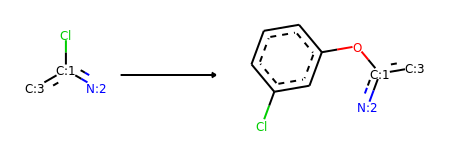

Product similarity 0.7529411764705882, overall 0.5058823529411764, smiles Cc1cc(Nc2cc3ccccc3c(Oc3cccc(Cl)c3)n2)n[nH]1


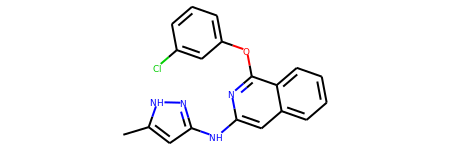

The proposed reaction is:


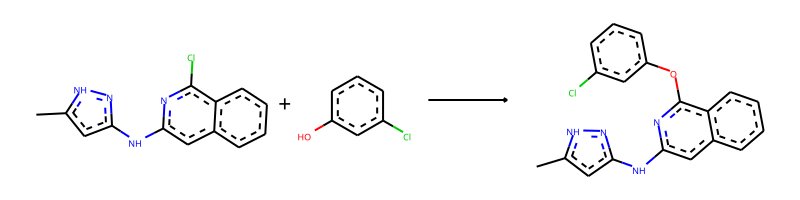

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1cccc(Cl)c1>>Cc1cc(Nc2cc3ccccc3c(Oc3cccc(Cl)c3)n2)n[nH]1


--------------------------------------------------

Train index: 236902
RANK 172 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:13]1[n:14][c:15]([NH:25][c:26]2[n:27][nH:28][cH:29][cH:30]2)[cH:16][c:17]2[cH:18][c:19]([O:23][CH3:24])[cH:20][cH:21][c:22]12>>CC(=O)Nc1ccc(O[c:13]2[n:14][c:15]([NH:25][c:26]3[n:27][nH:28][cH:29][cH:30]3)[cH:16][c:17]3[cH:18][c:19]([O:23][CH3:24])[cH:20][cH:21][c:22]23)cc1


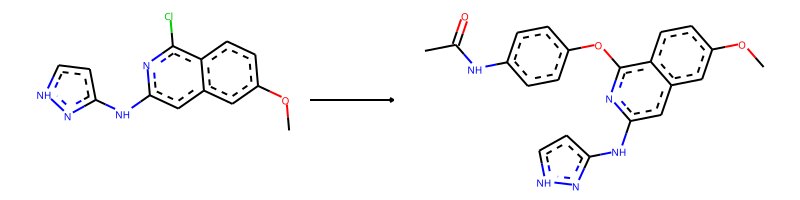

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(=O)-N-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


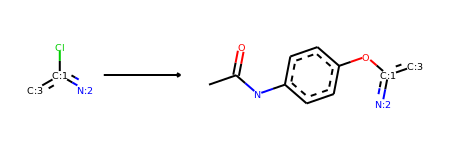

Product similarity 0.7741935483870968, overall 0.5201612903225806, smiles CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


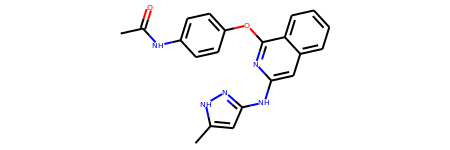

The proposed reaction is:


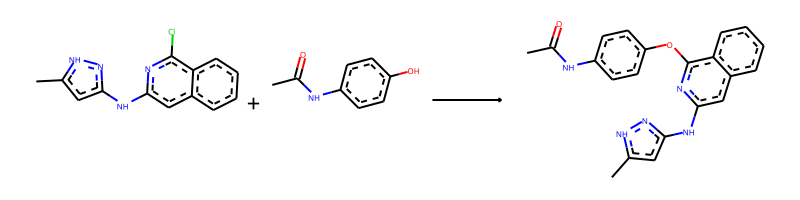

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(=O)Nc1ccc(O)cc1>>CC(=O)Nc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 357403
RANK 173 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Fc1cc(F)cc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)c1


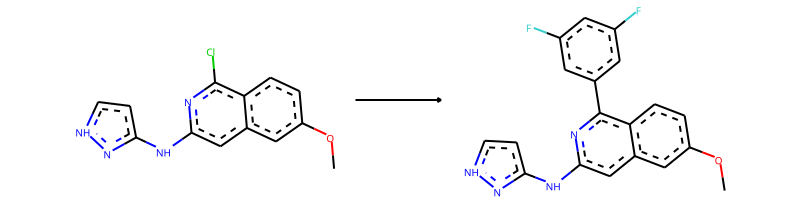

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c(-F):c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


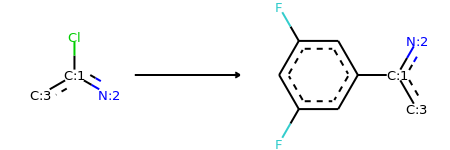

Product similarity 0.75, overall 0.50390625, smiles Cc1cc(Nc2cc3ccccc3c(-c3cc(F)cc(F)c3)n2)n[nH]1


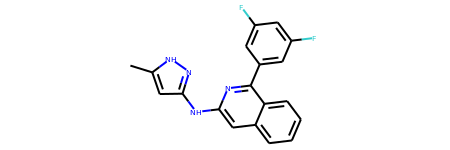

The proposed reaction is:


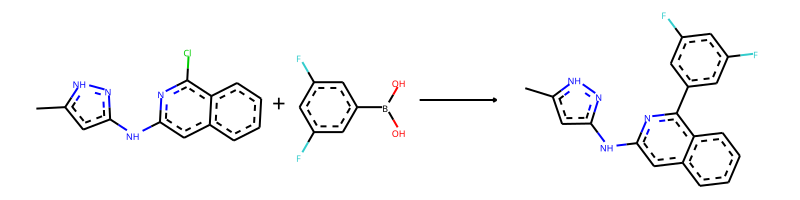

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1cc(F)cc(F)c1>>Cc1cc(Nc2cc3ccccc3c(-c3cc(F)cc(F)c3)n2)n[nH]1


--------------------------------------------------

Train index: 341830
RANK 174 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Cc1cscc1-[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12


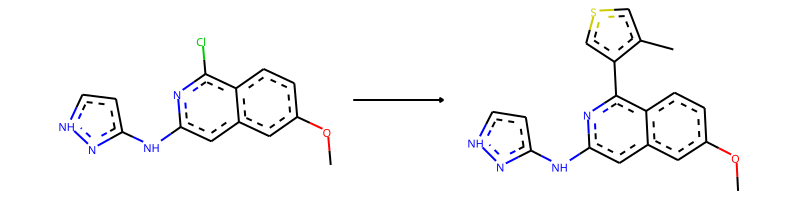

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:s:c:c:1-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


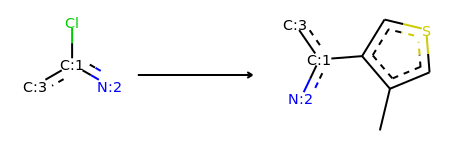

Product similarity 0.7341772151898734, overall 0.4932753164556962, smiles Cc1cc(Nc2cc3ccccc3c(-c3cscc3C)n2)n[nH]1


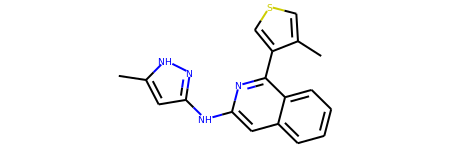

The proposed reaction is:


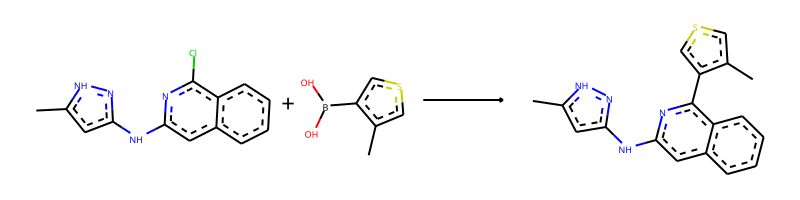

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1cscc1B(O)O>>Cc1cc(Nc2cc3ccccc3c(-c3cscc3C)n2)n[nH]1


--------------------------------------------------

Train index: 273373
RANK 175 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Clc1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


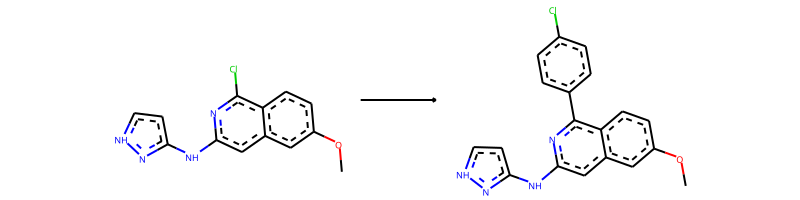

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>Cl-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


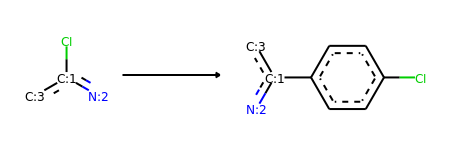

Product similarity 0.7439024390243902, overall 0.4998094512195122, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(Cl)cc3)n2)n[nH]1


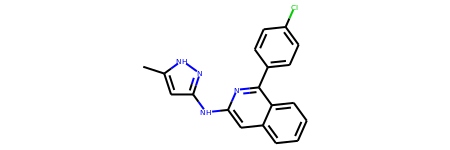

The proposed reaction is:


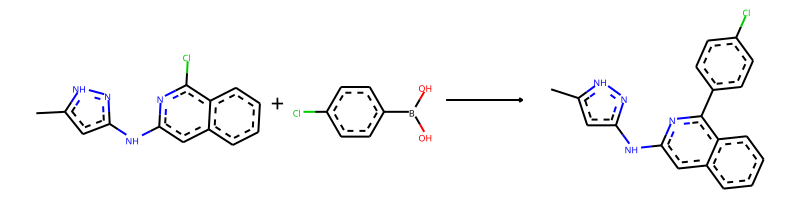

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(Cl)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(Cl)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 144418
RANK 176 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Fc1ccc(O[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


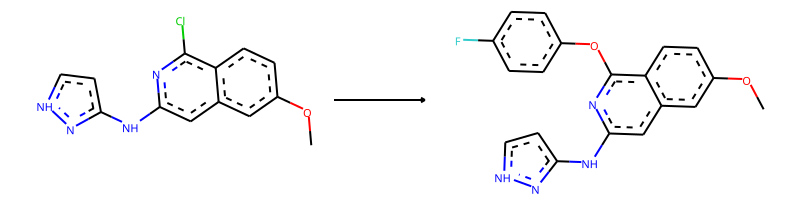

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


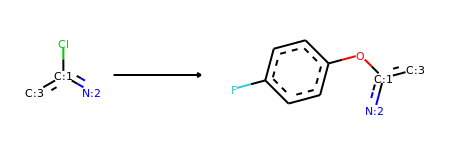

Product similarity 0.7529411764705882, overall 0.5058823529411764, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


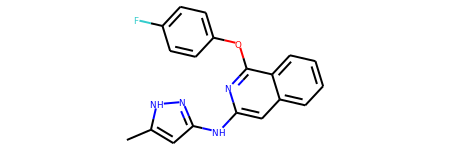

The proposed reaction is:


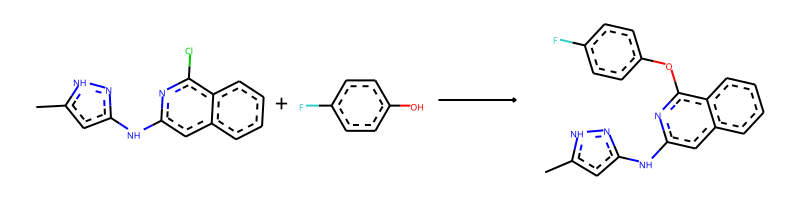

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(F)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 369107
RANK 177 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Fc1ccccc1O[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12


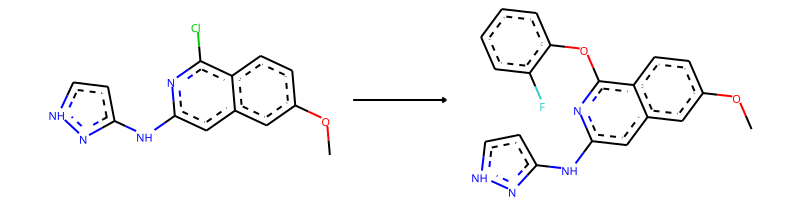

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c:c:1-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


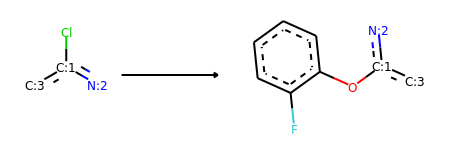

Product similarity 0.7529411764705882, overall 0.5058823529411764, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3F)n2)n[nH]1


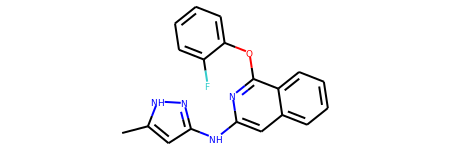

The proposed reaction is:


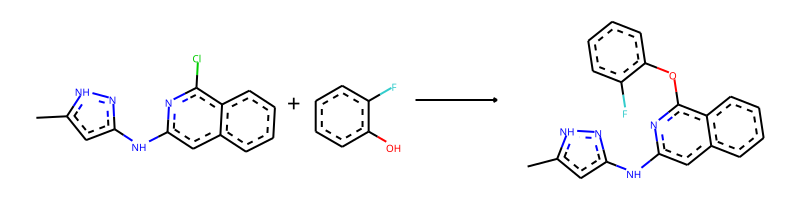

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1F>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3F)n2)n[nH]1


--------------------------------------------------

Train index: 296775
RANK 178 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>COc1ccccc1-[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12


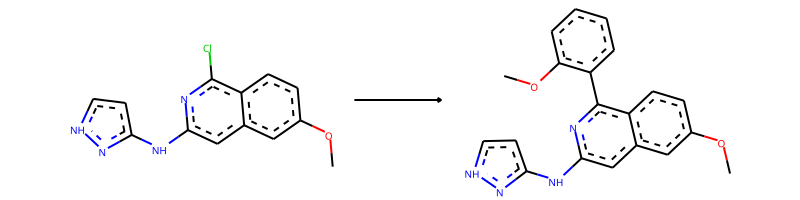

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-c1:c:c:c:c:c:1-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


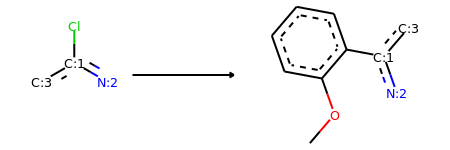

Product similarity 0.7529411764705882, overall 0.5058823529411764, smiles COc1ccccc1-c1nc(Nc2cc(C)[nH]n2)cc2ccccc12


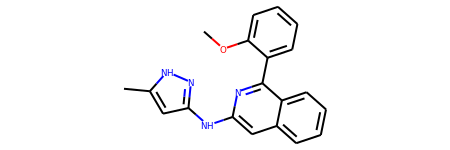

The proposed reaction is:


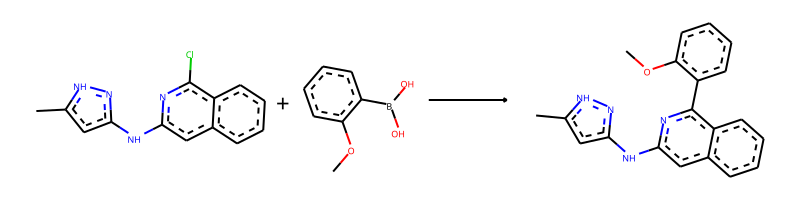

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.COc1ccccc1B(O)O>>COc1ccccc1-c1nc(Nc2cc(C)[nH]n2)cc2ccccc12


--------------------------------------------------

Train index: 195519
RANK 179 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Cc1ccc(O[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


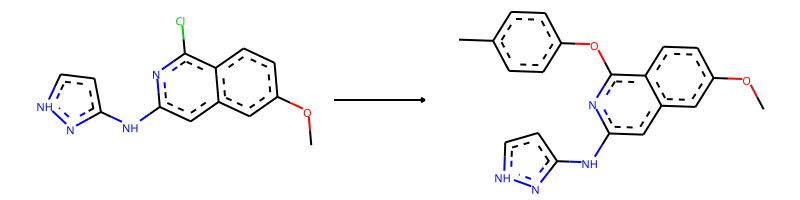

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


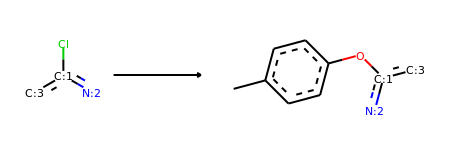

Product similarity 0.7529411764705882, overall 0.5058823529411764, smiles Cc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


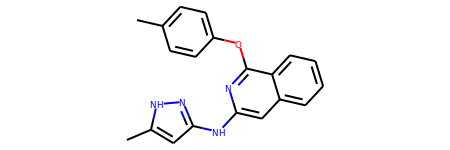

The proposed reaction is:


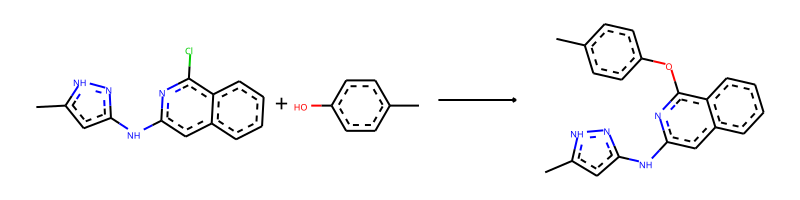

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1ccc(O)cc1>>Cc1ccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)cc1


--------------------------------------------------

Train index: 274921
RANK 180 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>CCc1cccc(N[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)c1


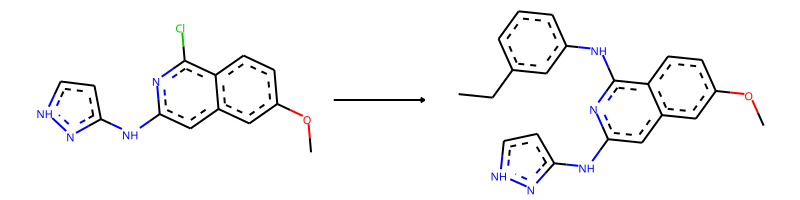

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C-c1:c:c:c:c(-N-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


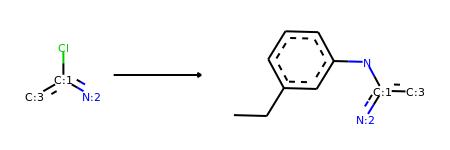

Product similarity 0.7613636363636364, overall 0.5115411931818181, smiles CCc1cccc(Nc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


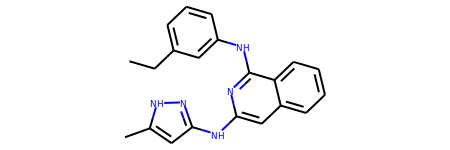

The proposed reaction is:


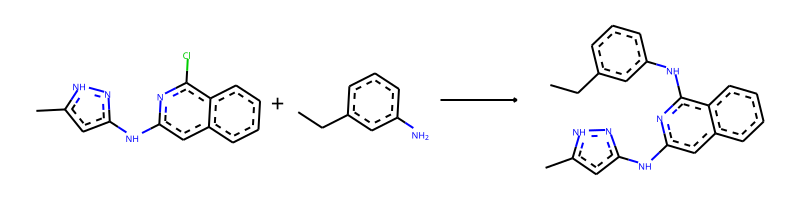

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CCc1cccc(N)c1>>CCc1cccc(Nc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


--------------------------------------------------

Train index: 259722
RANK 181 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Fc1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1F


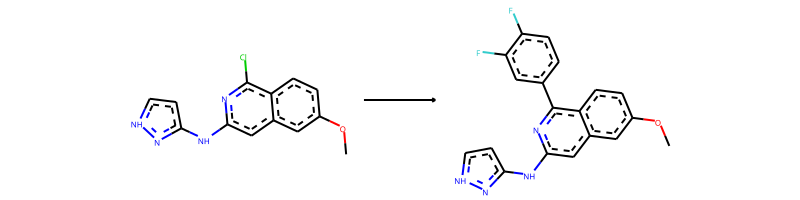

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1-F


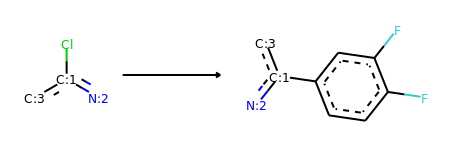

Product similarity 0.75, overall 0.50390625, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)c(F)c3)n2)n[nH]1


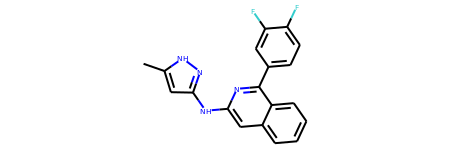

The proposed reaction is:


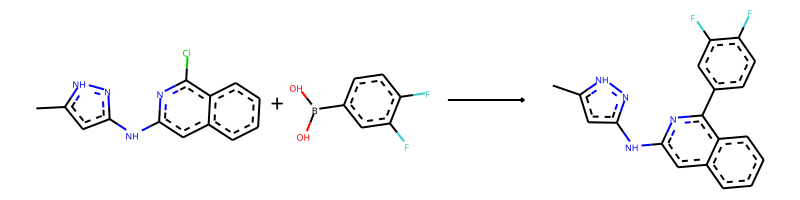

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(F)c(F)c1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)c(F)c3)n2)n[nH]1


--------------------------------------------------

Train index: 33937
RANK 182 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Cc1cccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)c1


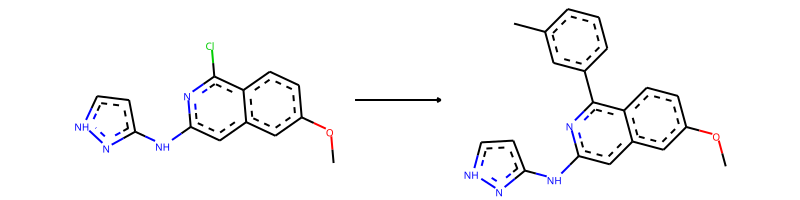

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-c1:c:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


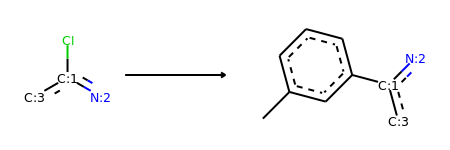

Product similarity 0.7439024390243902, overall 0.4998094512195122, smiles Cc1cccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


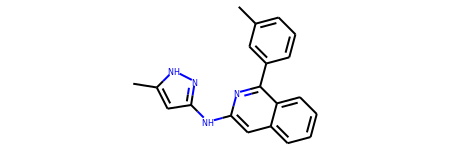

The proposed reaction is:


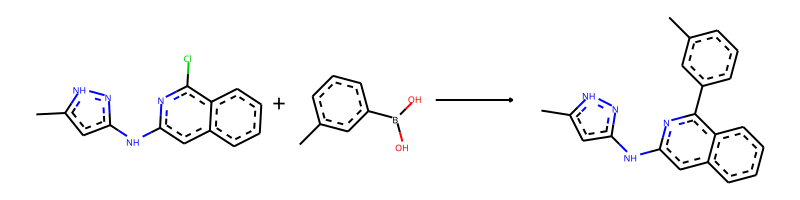

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cc1cccc(B(O)O)c1>>Cc1cccc(-c2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


--------------------------------------------------

Train index: 147756
RANK 183 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>c1cc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)ccn1


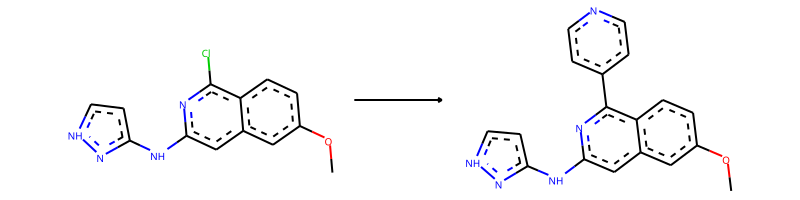

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:c:n:c:c:1


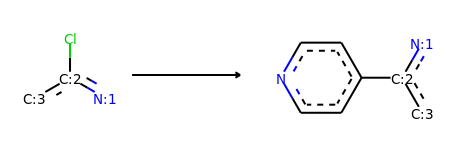

Product similarity 0.7375, overall 0.49550781250000003, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccncc3)n2)n[nH]1


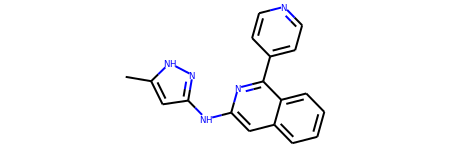

The proposed reaction is:


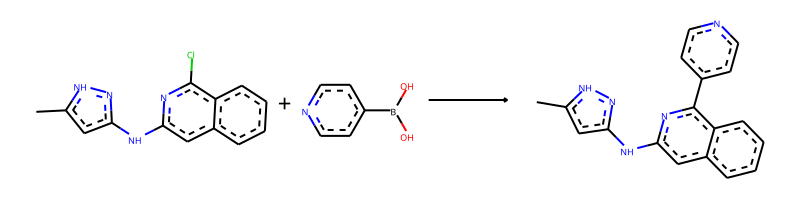

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccncc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccncc3)n2)n[nH]1


--------------------------------------------------

Train index: 78672
RANK 184 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>c1ccc(O[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


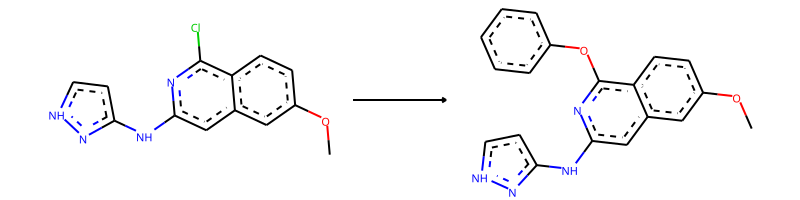

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-c1:c:c:c:c:c:1


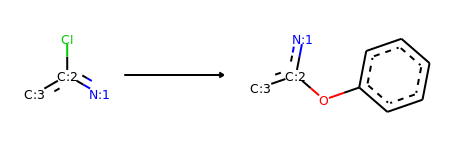

Product similarity 0.7469879518072289, overall 0.5018825301204819, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


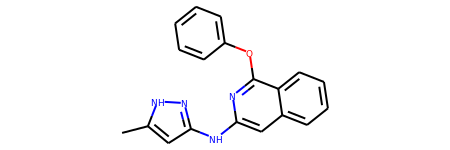

The proposed reaction is:


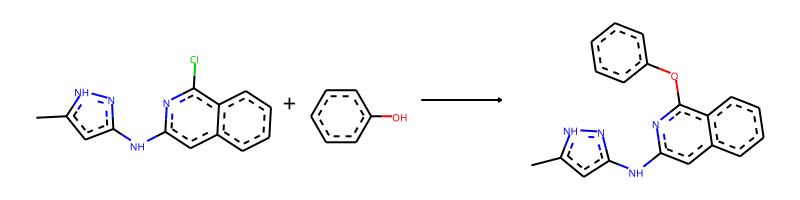

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 208960
RANK 185 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:11]1[n:12][c:13]([NH:23][c:24]2[n:25][nH:26][cH:27][cH:28]2)[cH:14][c:15]2[cH:16][c:17]([O:21][CH3:22])[cH:18][cH:19][c:20]12>>N#Cc1cccc(O[c:11]2[n:12][c:13]([NH:23][c:24]3[n:25][nH:26][cH:27][cH:28]3)[cH:14][c:15]3[cH:16][c:17]([O:21][CH3:22])[cH:18][cH:19][c:20]23)c1


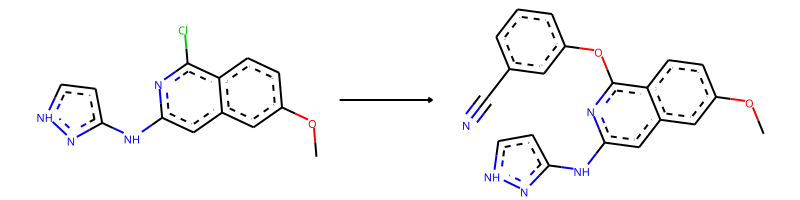

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>N#C-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


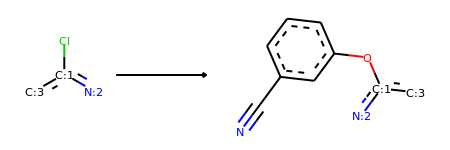

Product similarity 0.7613636363636364, overall 0.5115411931818181, smiles Cc1cc(Nc2cc3ccccc3c(Oc3cccc(C#N)c3)n2)n[nH]1


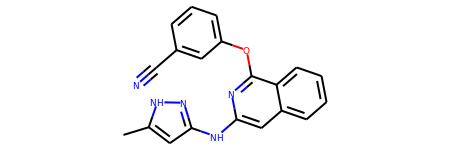

The proposed reaction is:


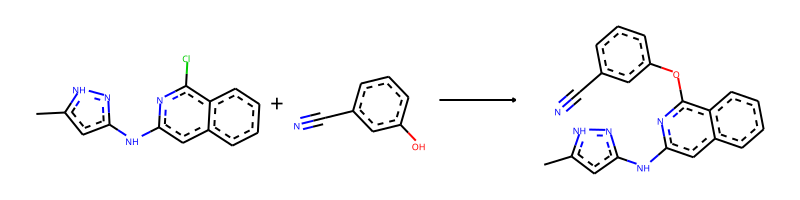

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.N#Cc1cccc(O)c1>>Cc1cc(Nc2cc3ccccc3c(Oc3cccc(C#N)c3)n2)n[nH]1


--------------------------------------------------

Train index: 192948
RANK 186 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Fc1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)c(F)c1


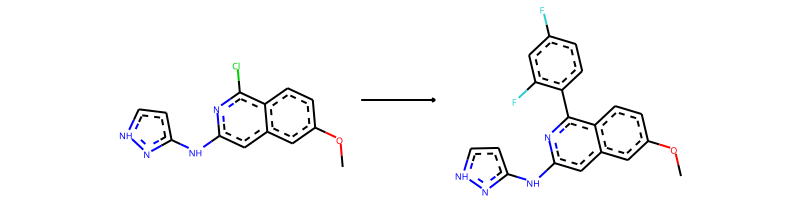

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c(-F):c:1


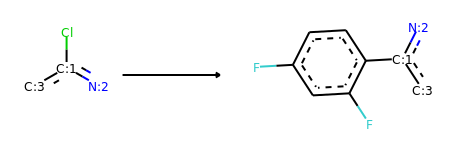

Product similarity 0.75, overall 0.50390625, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3F)n2)n[nH]1


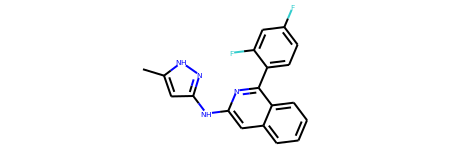

The proposed reaction is:


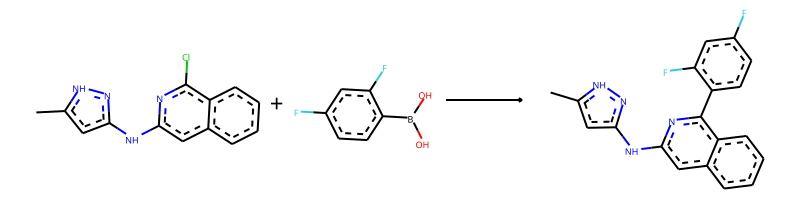

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(F)cc1F>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3F)n2)n[nH]1


--------------------------------------------------

Train index: 113426
RANK 187 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Cn1cc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cn1


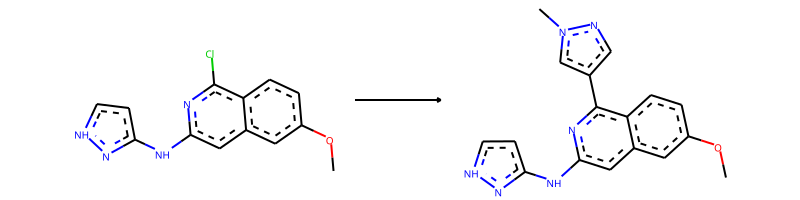

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-n1:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:n:1


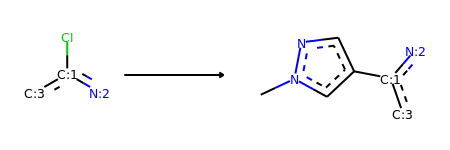

Product similarity 0.7341772151898734, overall 0.4932753164556962, smiles Cc1cc(Nc2cc3ccccc3c(-c3cnn(C)c3)n2)n[nH]1


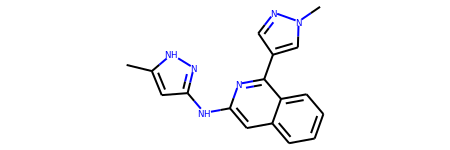

The proposed reaction is:


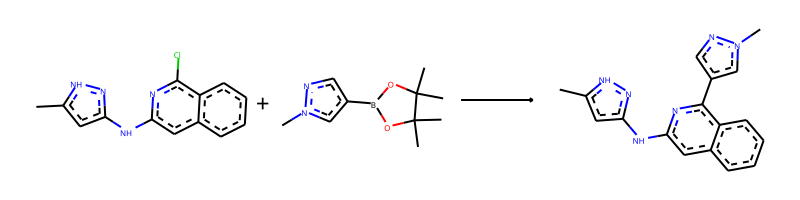

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Cn1cc(B2OC(C)(C)C(C)(C)O2)cn1>>Cc1cc(Nc2cc3ccccc3c(-c3cnn(C)c3)n2)n[nH]1


--------------------------------------------------

Train index: 381886
RANK 188 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Fc1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


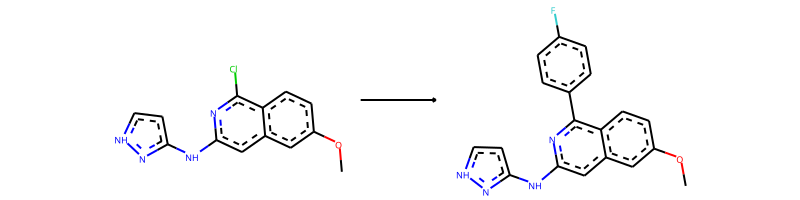

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


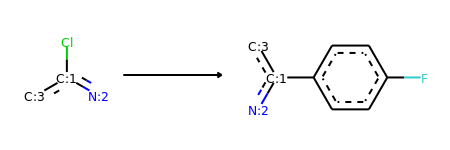

Product similarity 0.7439024390243902, overall 0.4998094512195122, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3)n2)n[nH]1


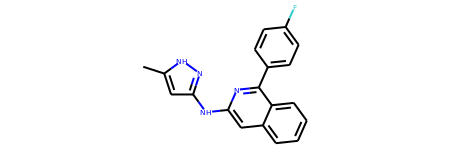

The proposed reaction is:


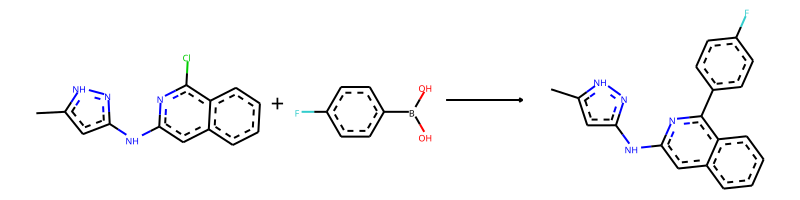

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(F)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 210613
RANK 189 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>FC(F)(F)c1ccc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


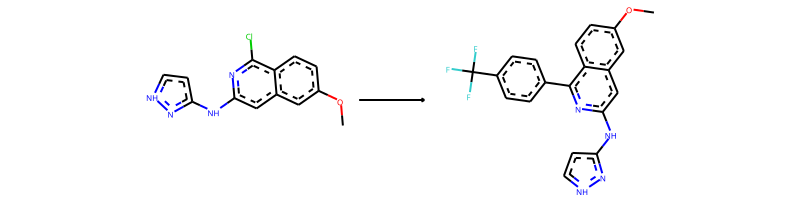

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-C(-F)(-F)-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


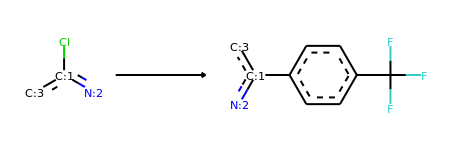

Product similarity 0.7640449438202247, overall 0.5133426966292135, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccc(C(F)(F)F)cc3)n2)n[nH]1


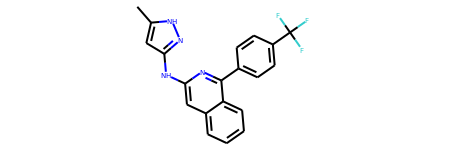

The proposed reaction is:


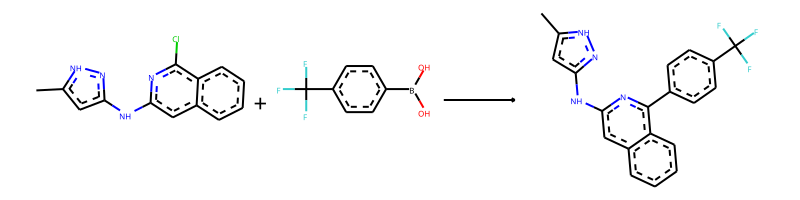

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccc(C(F)(F)F)cc1>>Cc1cc(Nc2cc3ccccc3c(-c3ccc(C(F)(F)F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 240304
RANK 190 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Fc1ccccc1-[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12


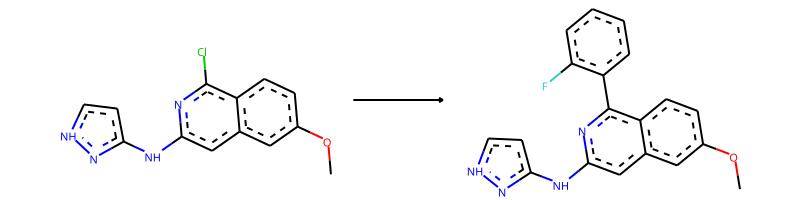

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c:c:1-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


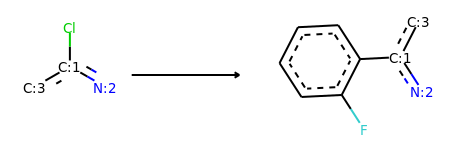

Product similarity 0.7439024390243902, overall 0.4998094512195122, smiles Cc1cc(Nc2cc3ccccc3c(-c3ccccc3F)n2)n[nH]1


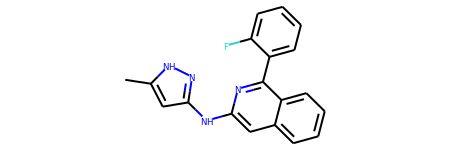

The proposed reaction is:


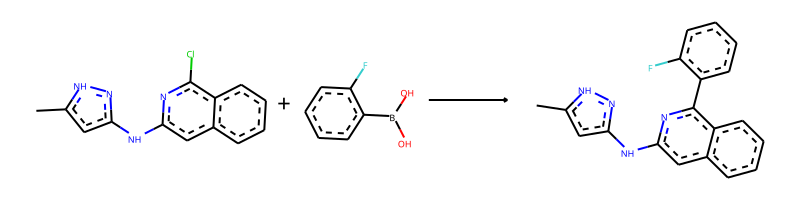

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1ccccc1F>>Cc1cc(Nc2cc3ccccc3c(-c3ccccc3F)n2)n[nH]1


--------------------------------------------------

Train index: 170864
RANK 191 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>Fc1cccc(O[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)c1


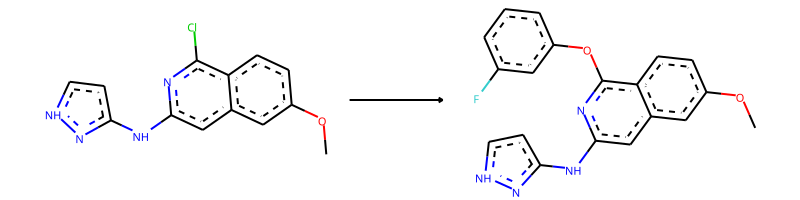

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


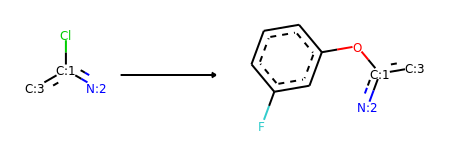

Product similarity 0.7529411764705882, overall 0.5058823529411764, smiles Cc1cc(Nc2cc3ccccc3c(Oc3cccc(F)c3)n2)n[nH]1


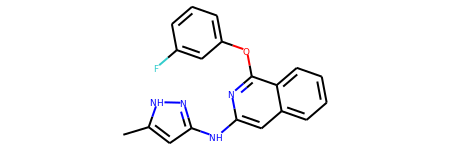

The proposed reaction is:


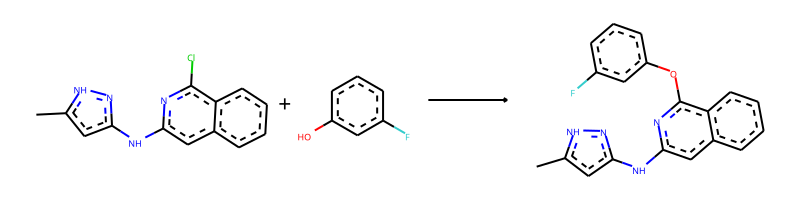

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1cccc(F)c1>>Cc1cc(Nc2cc3ccccc3c(Oc3cccc(F)c3)n2)n[nH]1


--------------------------------------------------

Train index: 143971
RANK 192 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>c1cncc(-[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)c1


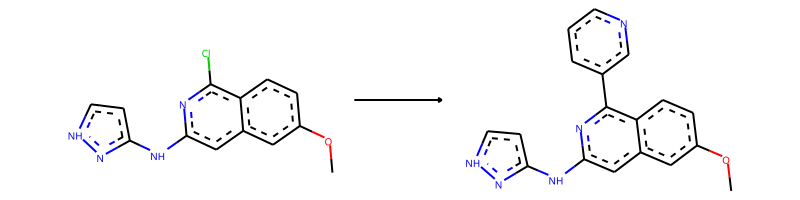

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:c:c:n:c:1


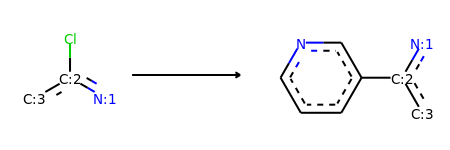

Product similarity 0.7375, overall 0.49550781250000003, smiles Cc1cc(Nc2cc3ccccc3c(-c3cccnc3)n2)n[nH]1


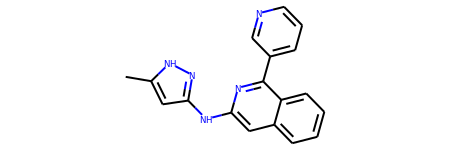

The proposed reaction is:


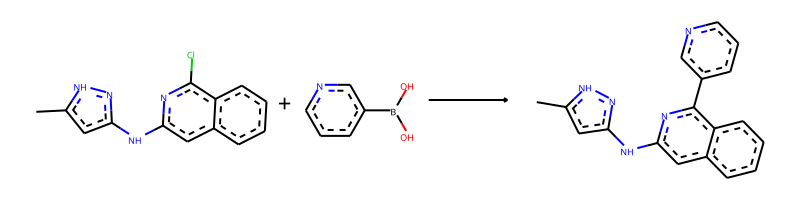

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OB(O)c1cccnc1>>Cc1cc(Nc2cc3ccccc3c(-c3cccnc3)n2)n[nH]1


--------------------------------------------------

Train index: 192932
RANK 193 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>c1ccc(CO[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)cc1


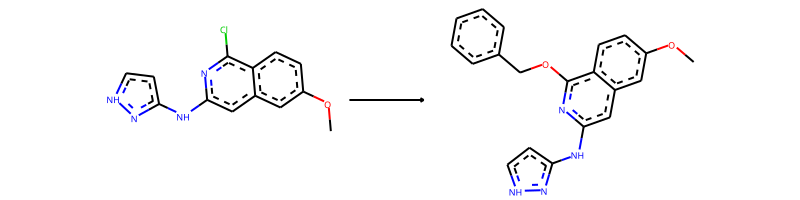

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-O-C-c1:c:c:c:c:c:1


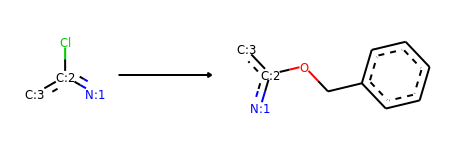

Product similarity 0.7558139534883721, overall 0.5078125, smiles Cc1cc(Nc2cc3ccccc3c(OCc3ccccc3)n2)n[nH]1


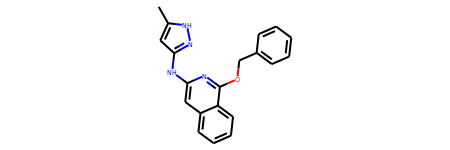

The proposed reaction is:


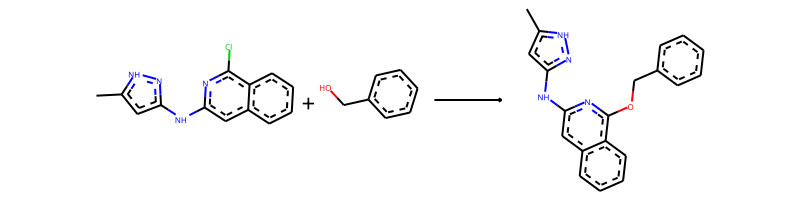

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.OCc1ccccc1>>Cc1cc(Nc2cc3ccccc3c(OCc3ccccc3)n2)n[nH]1


--------------------------------------------------

Train index: 239569
RANK 194 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>COc1cccc(O[c:2]2[n:3][c:4]([NH:14][c:15]3[n:16][nH:17][cH:18][cH:19]3)[cH:5][c:6]3[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]23)c1


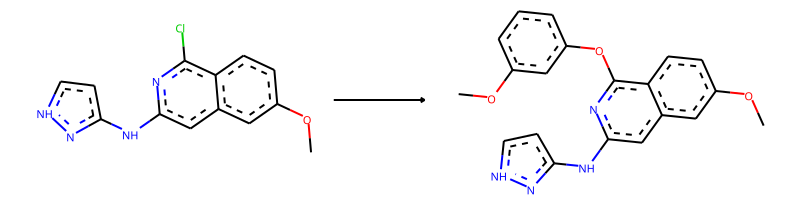

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-O-c1:c:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:1


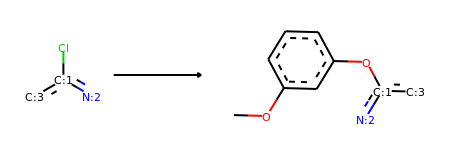

Product similarity 0.7613636363636364, overall 0.5115411931818181, smiles COc1cccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


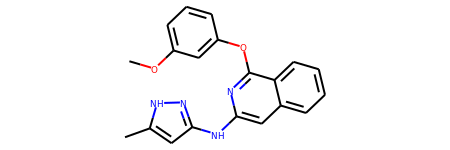

The proposed reaction is:


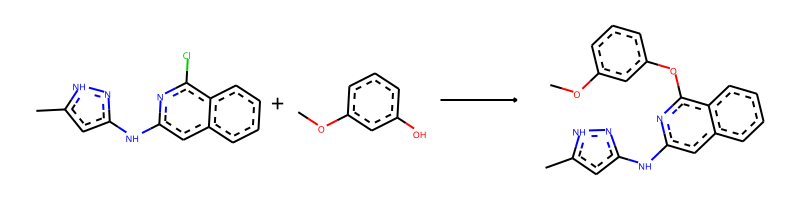

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.COc1cccc(O)c1>>COc1cccc(Oc2nc(Nc3cc(C)[nH]n3)cc3ccccc23)c1


--------------------------------------------------

Train index: 275050
RANK 195 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>CC(C)CO[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12


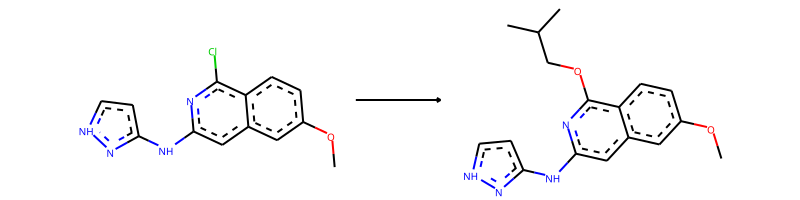

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>C-C(-C)-C-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


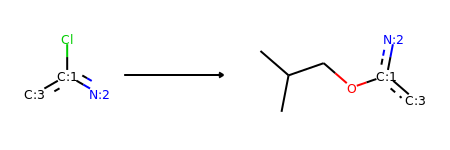

Product similarity 0.72, overall 0.48374999999999996, smiles Cc1cc(Nc2cc3ccccc3c(OCC(C)C)n2)n[nH]1


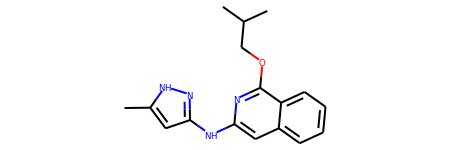

The proposed reaction is:


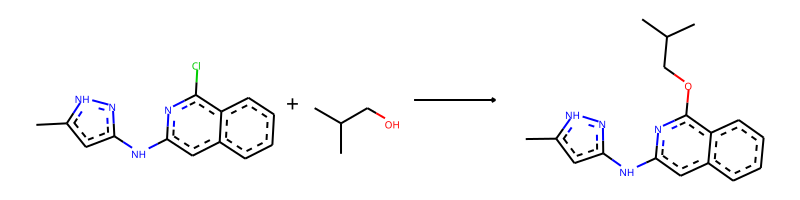

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC(C)CO>>Cc1cc(Nc2cc3ccccc3c(OCC(C)C)n2)n[nH]1


--------------------------------------------------

Train index: 352411
RANK 196 PRECEDENT
REACTANT MATCH SCORE: 0.671875
Reaction SMILES (Precedent): Cl[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12>>c1n[nH]cc1-[c:2]1[n:3][c:4]([NH:14][c:15]2[n:16][nH:17][cH:18][cH:19]2)[cH:5][c:6]2[cH:7][c:8]([O:12][CH3:13])[cH:9][cH:10][c:11]12


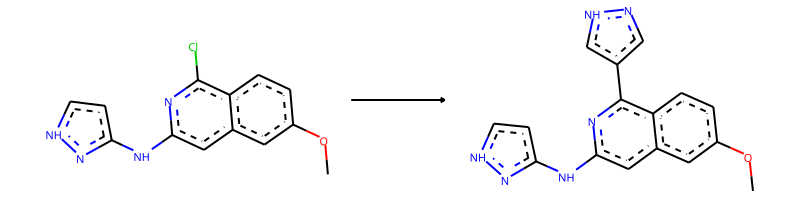

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]>>[#7;a:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:[nH]:n:c:1


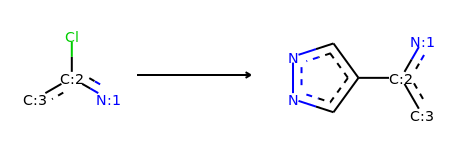

Product similarity 0.7272727272727273, overall 0.48863636363636365, smiles Cc1cc(Nc2cc3ccccc3c(-c3cn[nH]c3)n2)n[nH]1


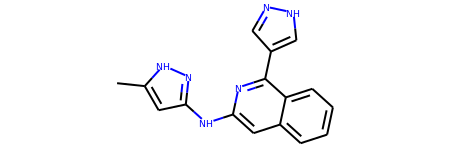

The proposed reaction is:


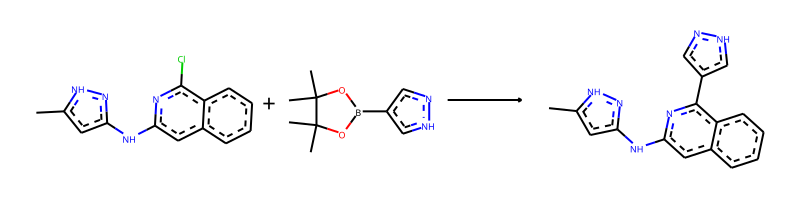

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.CC1(C)OB(c2cn[nH]c2)OC1(C)C>>Cc1cc(Nc2cc3ccccc3c(-c3cn[nH]c3)n2)n[nH]1


--------------------------------------------------

Train index: 428185
RANK 197 PRECEDENT
REACTANT MATCH SCORE: 0.6521739130434783
Reaction SMILES (Precedent): Cl[c:10]1[n:11][c:12]([NH:24][c:25]2[n:26][nH:27][c:28]([CH3:30])[cH:29]2)[cH:13][c:14]2[cH:15][c:16]([O:22][CH3:23])[cH:17][c:18]([O:20][CH3:21])[c:19]12>>Fc1ccc(O[c:10]2[n:11][c:12]([NH:24][c:25]3[n:26][nH:27][c:28]([CH3:30])[cH:29]3)[cH:13][c:14]3[cH:15][c:16]([O:22][CH3:23])[cH:17][c:18]([O:20][CH3:21])[c:19]23)cc1


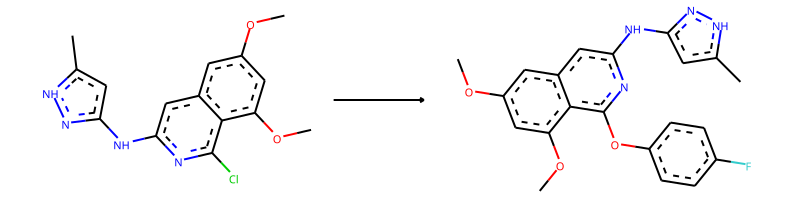

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>F-c1:c:c:c(-O-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


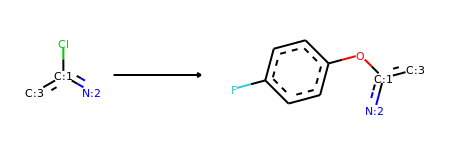

Product similarity 0.7333333333333333, overall 0.47826086956521735, smiles Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


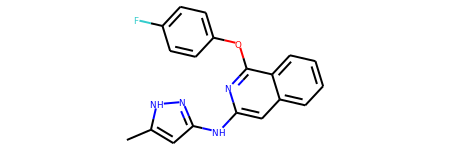

The proposed reaction is:


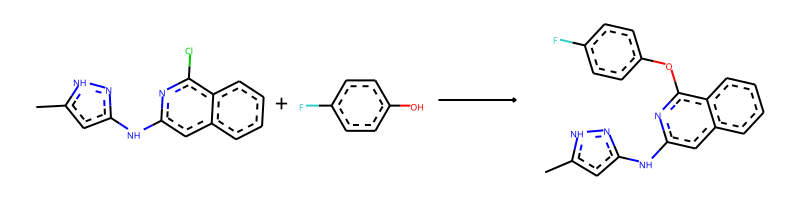

The reaction SMILES string is: Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccc(F)cc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccc(F)cc3)n2)n[nH]1


--------------------------------------------------

Train index: 99891
RANK 198 PRECEDENT
REACTANT MATCH SCORE: 0.625
Reaction SMILES (Precedent): O=[c:10]1[nH:9][c:8]([NH:7][c:4]2[cH:3][c:2]([CH3:1])[nH:6][n:5]2)[cH:17][c:16]2[c:11]1[cH:12][cH:13][cH:14][cH:15]2>>Cl[c:10]1[n:9][c:8]([NH:7][c:4]2[cH:3][c:2]([CH3:1])[nH:6][n:5]2)[cH:17][c:16]2[c:11]1[cH:12][cH:13][cH:14][cH:15]2


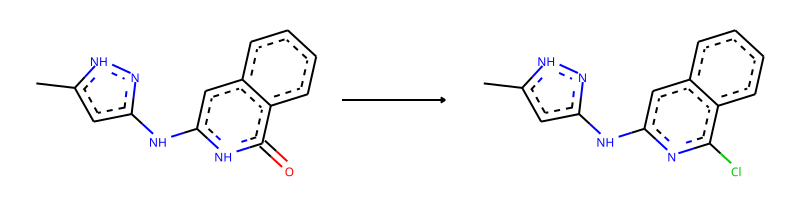

-> template: [O;H0;D1;+0]=[c;H0;D3;+0:1](:[c:2]):[nH;D2;+0:3]:[c:4]>>Cl-[c;H0;D3;+0:1](:[c:2]):[n;H0;D2;+0:3]:[c:4]


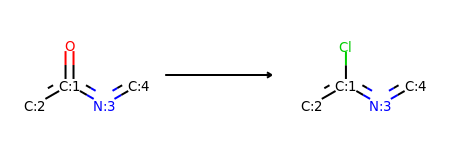

->No precursors could be generated!


--------------------------------------------------

Train index: 77958
RANK 199 PRECEDENT
REACTANT MATCH SCORE: 0.6216216216216216
Reaction SMILES (Precedent): F[c:16]1[cH:15][c:14]2[cH:13][c:12]([NH:26][c:27]3[n:28][nH:29][c:30]([CH3:32])[cH:31]3)[n:11][c:10]([Cl:9])[c:19]2[cH:18][c:17]1[O:20][CH2:21][CH2:22][O:23][CH3:24]>>C1CC(O[c:16]2[cH:15][c:14]3[cH:13][c:12]([NH:26][c:27]4[n:28][nH:29][c:30]([CH3:32])[cH:31]4)[n:11][c:10]([Cl:9])[c:19]3[cH:18][c:17]2[O:20][CH2:21][CH2:22][O:23][CH3:24])CO1


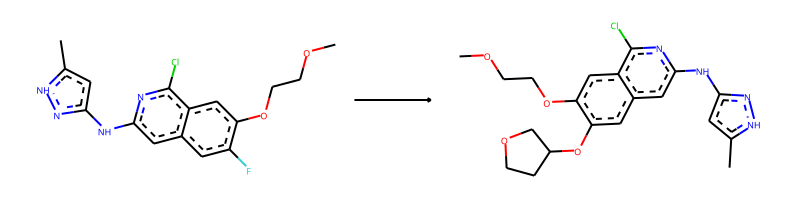

-> template: [F;H0;D1;+0]-[c;H0;D3;+0:2](:[c:1]):[c:3]>>[c:1]:[c;H0;D3;+0:2](:[c:3])-O-C1-C-C-O-C-1


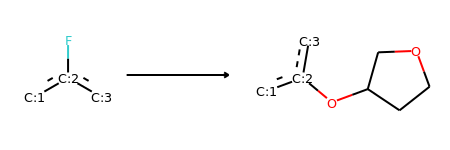

->No precursors could be generated!


--------------------------------------------------

Train index: 418704
RANK 200 PRECEDENT
REACTANT MATCH SCORE: 0.6216216216216216
Reaction SMILES (Precedent): F[c:19]1[cH:18][c:17]2[cH:16][c:15]([NH:29][c:30]3[n:31][nH:32][c:33]([CH3:35])[cH:34]3)[n:14][c:13]([Cl:12])[c:22]2[cH:21][c:20]1[O:23][CH2:24][CH2:25][O:26][CH3:27]>>CC1(C)OCC(CO[c:19]2[cH:18][c:17]3[cH:16][c:15]([NH:29][c:30]4[n:31][nH:32][c:33]([CH3:35])[cH:34]4)[n:14][c:13]([Cl:12])[c:22]3[cH:21][c:20]2[O:23][CH2:24][CH2:25][O:26][CH3:27])O1


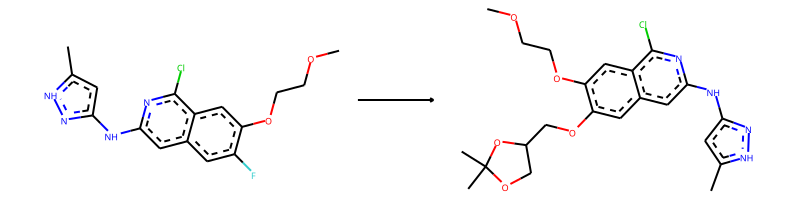

-> template: [F;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>C-C1(-C)-O-C-C(-C-O-[c;H0;D3;+0:1](:[c:2]):[c:3])-O-1


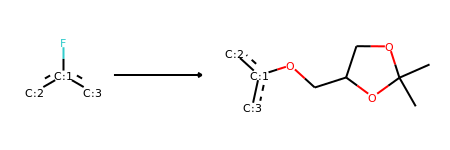

->No precursors could be generated!


(1,
 'Cc1cc(Nc2cc3ccccc3c(Cl)n2)n[nH]1.Oc1ccccc1>>Cc1cc(Nc2cc3ccccc3c(Oc3ccccc3)n2)n[nH]1',
 1.0,
 0.5974025974025974)

In [17]:
do_one_v4_woFastFilter (194874)

Mol 28140, reactant input:


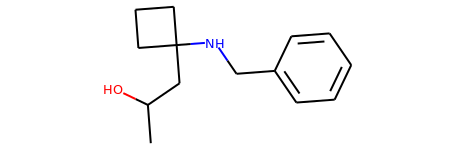

Desired Reaction:


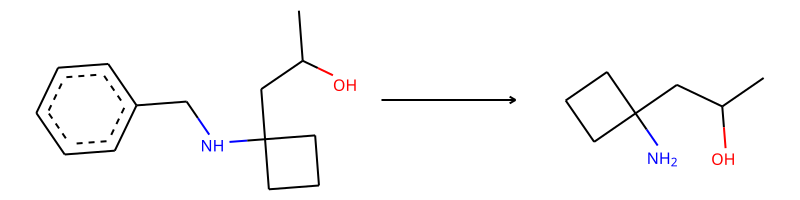

Desired Product:


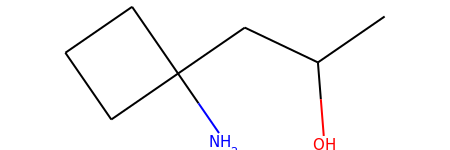



--------------------------------------------------

Train index: 44148
RANK 1 PRECEDENT
REACTANT MATCH SCORE: 0.6862745098039216


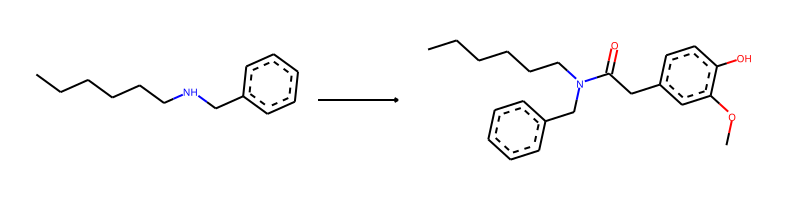

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-O-c1:c:c(-C-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]):c:c:c:1-O


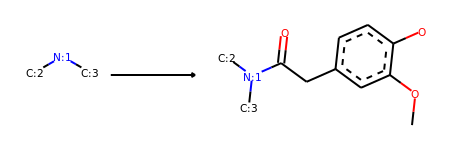

Product similarity 0.8095238095238095, overall 0.5555555555555556, smiles COc1cc(CC(=O)N(Cc2ccccc2)C2(CC(C)O)CCC2)ccc1O


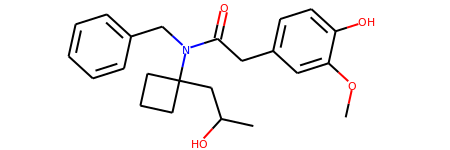

The proposed reaction is:


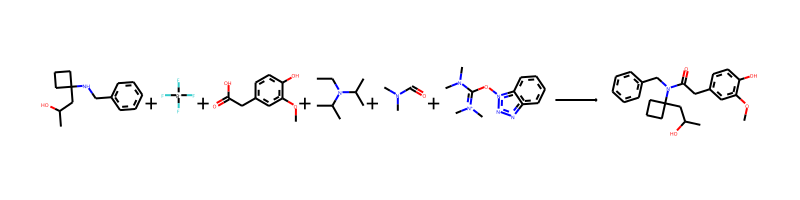

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.F[B-](F)(F)F.COc1cc(CC(=O)O)ccc1O.CCN(C(C)C)C(C)C.CN(C)C=O.CN(C)C(On1nnc2ccccc21)=[N+](C)C>>COc1cc(CC(=O)N(Cc2ccccc2)C2(CC(C)O)CCC2)ccc1O
The fast filter score is 0.938307524


--------------------------------------------------

Train index: 195623
RANK 2 PRECEDENT
REACTANT MATCH SCORE: 0.6792452830188679


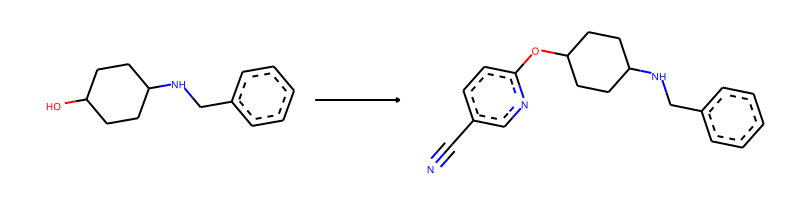

-> template: [C:2]-[OH;D1;+0:1]>>N#C-c1:c:c:c(-[O;H0;D2;+0:1]-[C:2]):n:c:1


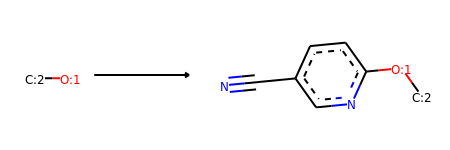

Product similarity 0.7792207792207793, overall 0.529282038716001, smiles CC(CC1(NCc2ccccc2)CCC1)Oc1ccc(C#N)cn1


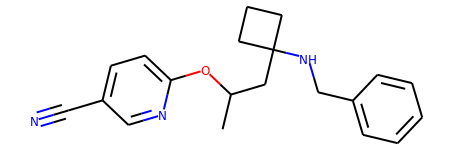

The proposed reaction is:


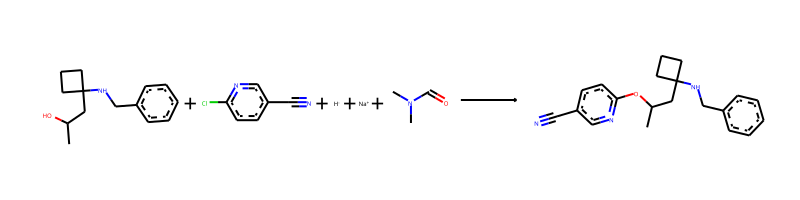

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.N#Cc1ccc(Cl)nc1.[H-].[Na+].CN(C)C=O>>CC(CC1(NCc2ccccc2)CCC1)Oc1ccc(C#N)cn1
The fast filter score is 0.976778507


--------------------------------------------------

Train index: 259678
RANK 3 PRECEDENT
REACTANT MATCH SCORE: 0.6727272727272727


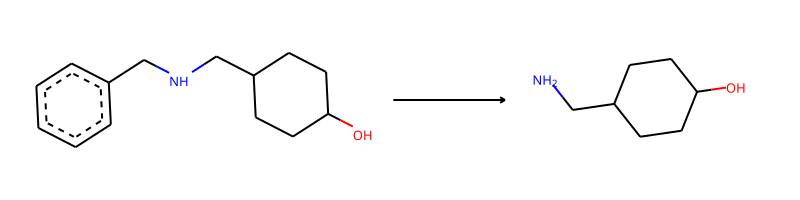

-> template: [C:1]-[NH;D2;+0:2]-[C;H2;D2;+0]-[c;H0;D3;+0]1:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:1>>[C:1]-[NH2;D1;+0:2]


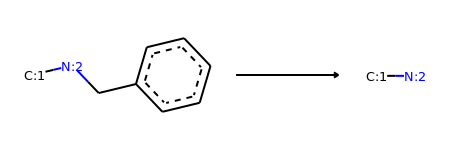

Product similarity 0.5, overall 0.33636363636363636, smiles CC(O)CC1(N)CCC1


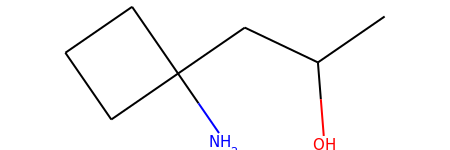

The proposed reaction is:


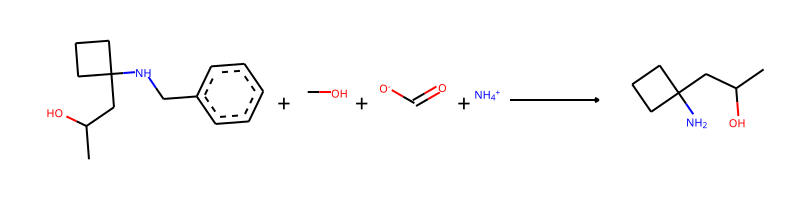

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CO.O=C[O-].[NH4+]>>CC(O)CC1(N)CCC1
The fast filter score is 0.444860429


--------------------------------------------------

Train index: 414278
RANK 4 PRECEDENT
REACTANT MATCH SCORE: 0.6615384615384615


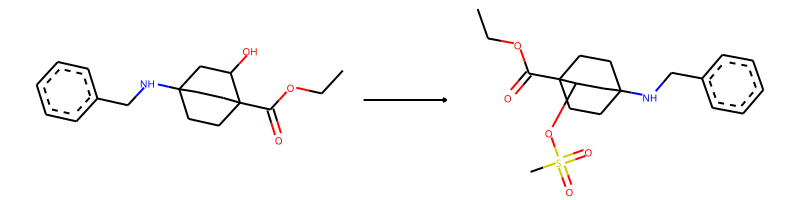

-> template: [C:2]-[OH;D1;+0:1]>>C-S(=O)(=O)-[O;H0;D2;+0:1]-[C:2]


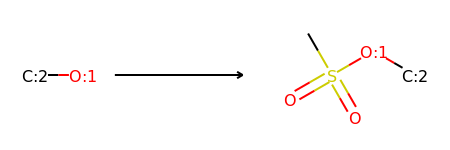

Product similarity 0.7066666666666667, overall 0.4674871794871795, smiles CC(CC1(NCc2ccccc2)CCC1)OS(C)(=O)=O


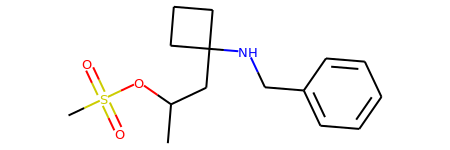

The proposed reaction is:


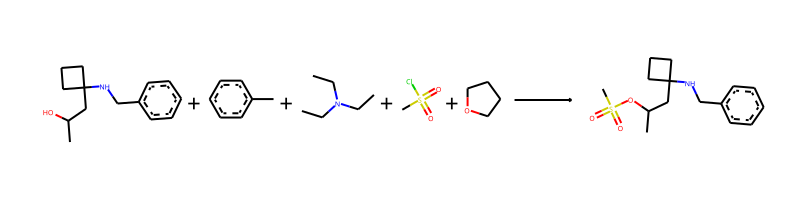

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.Cc1ccccc1.CCN(CC)CC.CS(=O)(=O)Cl.C1CCOC1>>CC(CC1(NCc2ccccc2)CCC1)OS(C)(=O)=O
The fast filter score is 0.979436636


--------------------------------------------------

Train index: 41082
RANK 5 PRECEDENT
REACTANT MATCH SCORE: 0.6530612244897959


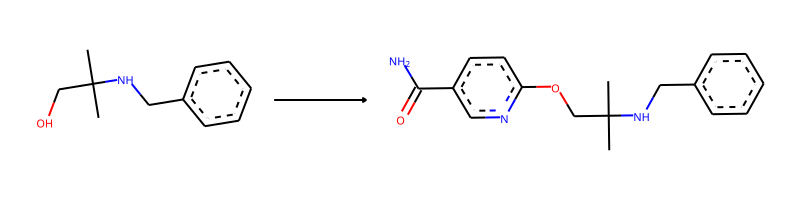

-> template: [C:2]-[OH;D1;+0:1]>>N-C(=O)-c1:c:c:c(-[O;H0;D2;+0:1]-[C:2]):n:c:1


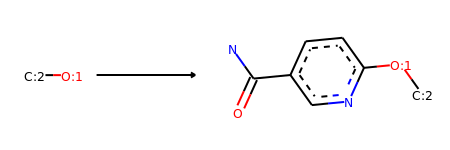

Product similarity 0.75, overall 0.4897959183673469, smiles CC(CC1(NCc2ccccc2)CCC1)Oc1ccc(C(N)=O)cn1


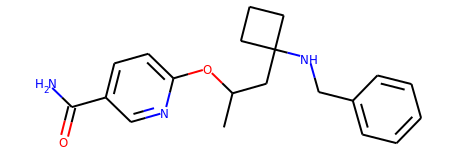

The proposed reaction is:


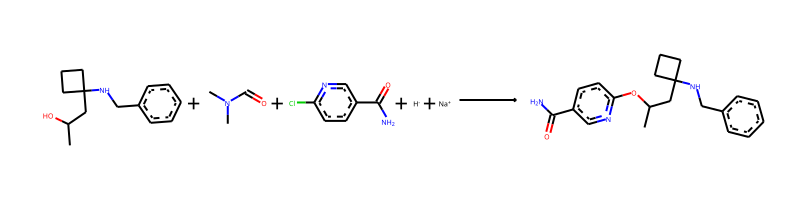

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CN(C)C=O.NC(=O)c1ccc(Cl)nc1.[H-].[Na+]>>CC(CC1(NCc2ccccc2)CCC1)Oc1ccc(C(N)=O)cn1
The fast filter score is 0.987702191


--------------------------------------------------

Train index: 405138
RANK 6 PRECEDENT
REACTANT MATCH SCORE: 0.6415094339622641


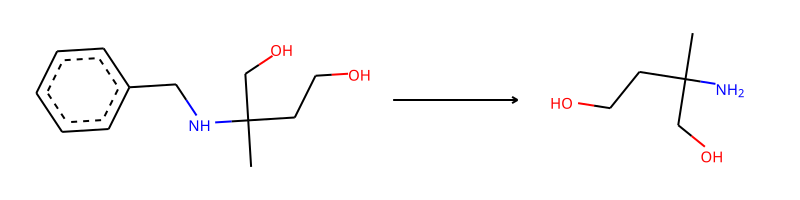

-> template: [C:1]-[NH;D2;+0:2]-[C;H2;D2;+0]-[c;H0;D3;+0]1:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:1>>[C:1]-[NH2;D1;+0:2]


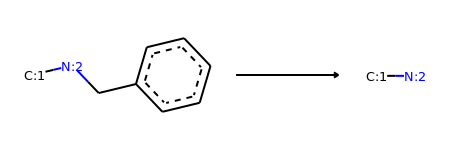

Product similarity 0.3870967741935484, overall 0.24832623250152158, smiles CC(O)CC1(N)CCC1


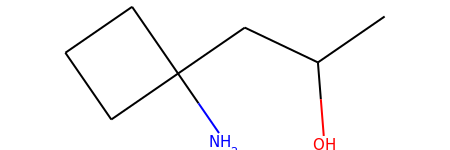

The proposed reaction is:


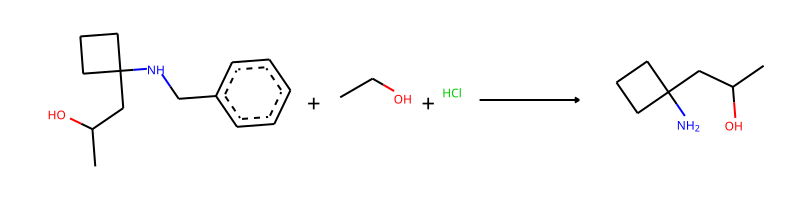

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CCO.Cl>>CC(O)CC1(N)CCC1
The fast filter score is 0.408845782


--------------------------------------------------

Train index: 188169
RANK 7 PRECEDENT
REACTANT MATCH SCORE: 0.625


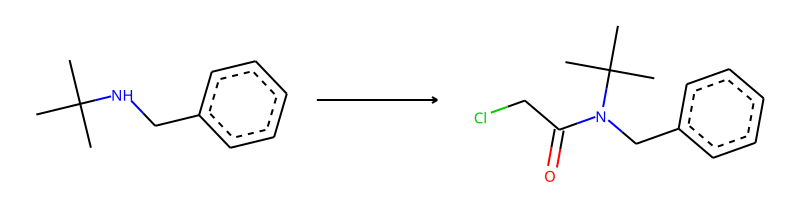

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>Cl-C-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]


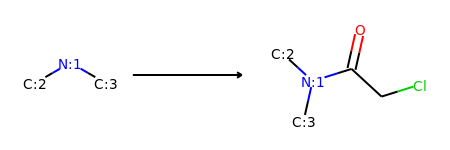

Product similarity 0.6896551724137931, overall 0.4310344827586207, smiles CC(O)CC1(N(Cc2ccccc2)C(=O)CCl)CCC1


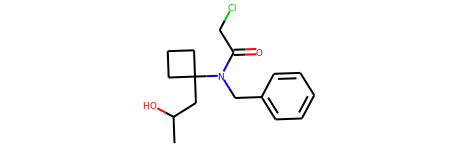

The proposed reaction is:


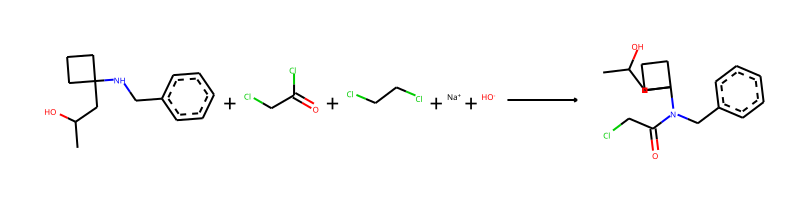

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.O=C(Cl)CCl.ClCCCl.[Na+].[OH-]>>CC(O)CC1(N(Cc2ccccc2)C(=O)CCl)CCC1
The fast filter score is 0.932059884


--------------------------------------------------

Train index: 412874
RANK 8 PRECEDENT
REACTANT MATCH SCORE: 0.625


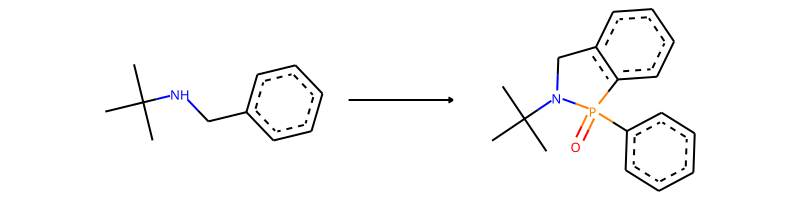

-> template: [C:2]-[NH;D2;+0:1]-[C:3]-[c:4]:[cH;D2;+0:5]:[c:6]>>O=P1(-c2:c:c:c:c:c:2)-[N;H0;D3;+0:1](-[C:2])-[C:3]-[c:4]:[c;H0;D3;+0:5]-1:[c:6]


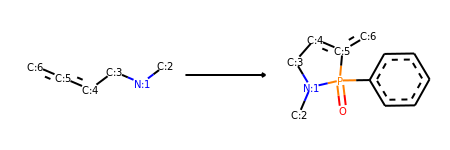

Product similarity 0.7464788732394366, overall 0.4665492957746479, smiles CC(O)CC1(N2Cc3ccccc3P2(=O)c2ccccc2)CCC1


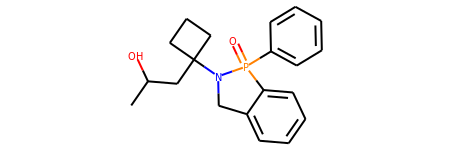

The proposed reaction is:


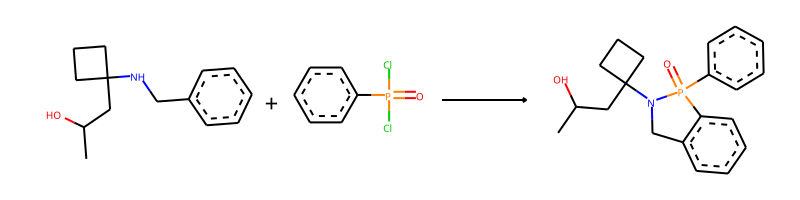

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.O=P(Cl)(Cl)c1ccccc1>>CC(O)CC1(N2Cc3ccccc3P2(=O)c2ccccc2)CCC1
The fast filter score is 0.928401291


--------------------------------------------------

Train index: 157552
RANK 9 PRECEDENT
REACTANT MATCH SCORE: 0.625


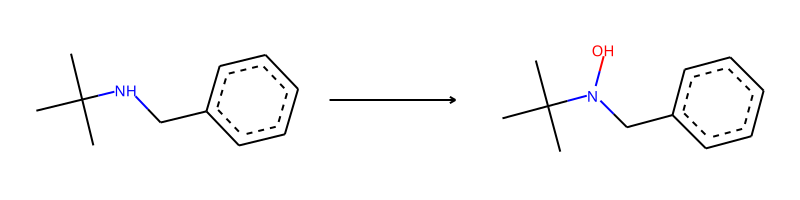

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>O-[N;H0;D3;+0:1](-[C:2])-[C:3]


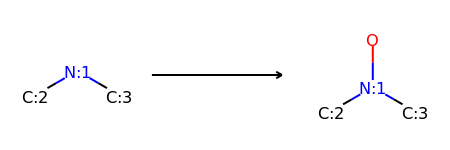

Product similarity 0.64, overall 0.4, smiles CC(O)CC1(N(O)Cc2ccccc2)CCC1


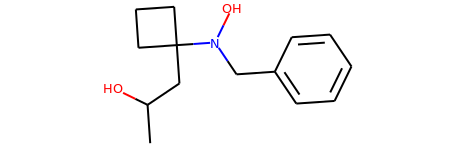

The proposed reaction is:


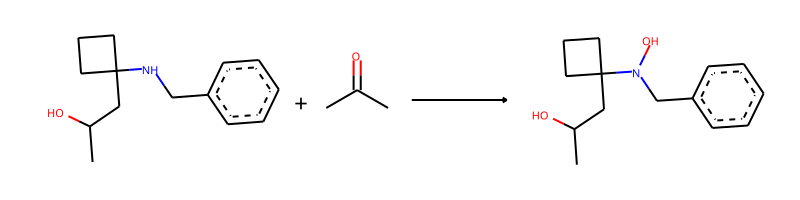

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CC(C)=O>>CC(O)CC1(N(O)Cc2ccccc2)CCC1
The fast filter score is 0.0599911511


--------------------------------------------------

Train index: 160120
RANK 10 PRECEDENT
REACTANT MATCH SCORE: 0.625


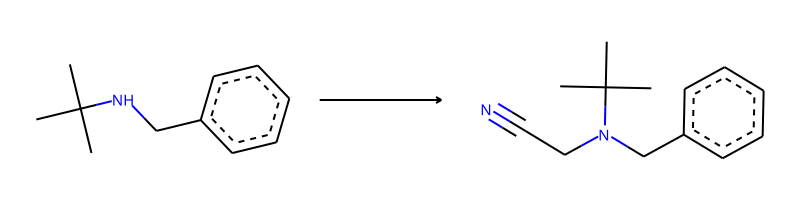

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>N#C-C-[N;H0;D3;+0:1](-[C:2])-[C:3]


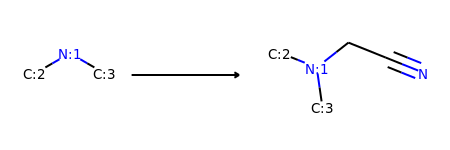

Product similarity 0.6785714285714286, overall 0.4241071428571429, smiles CC(O)CC1(N(CC#N)Cc2ccccc2)CCC1


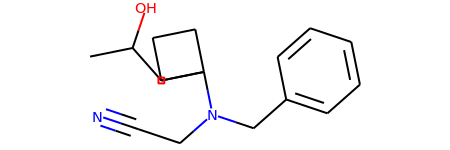

The proposed reaction is:


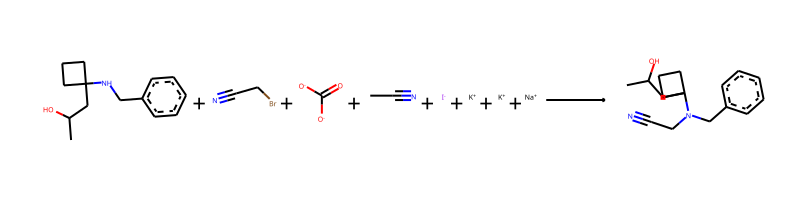

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.N#CCBr.O=C([O-])[O-].CC#N.[I-].[K+].[K+].[Na+]>>CC(O)CC1(N(CC#N)Cc2ccccc2)CCC1
The fast filter score is 0.672284544


--------------------------------------------------

Train index: 436228
RANK 11 PRECEDENT
REACTANT MATCH SCORE: 0.625


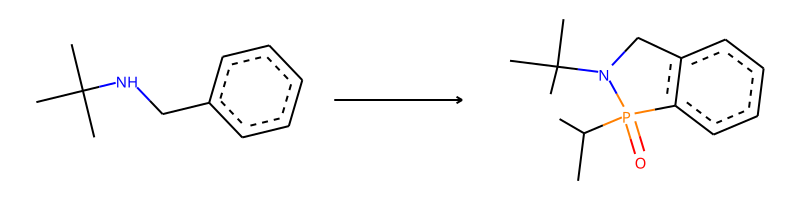

-> template: [C:2]-[NH;D2;+0:1]-[C:3]-[c:4]:[cH;D2;+0:5]:[c:6]>>C-C(-C)-P1(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]-[c:4]:[c;H0;D3;+0:5]-1:[c:6]


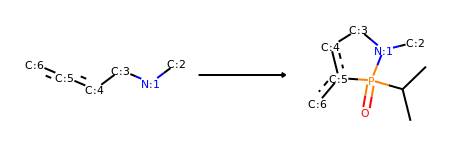

Product similarity 0.7, overall 0.4375, smiles CC(O)CC1(N2Cc3ccccc3P2(=O)C(C)C)CCC1


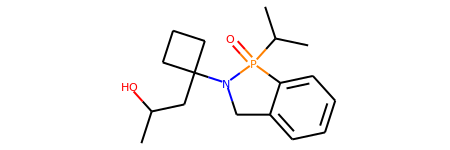

The proposed reaction is:


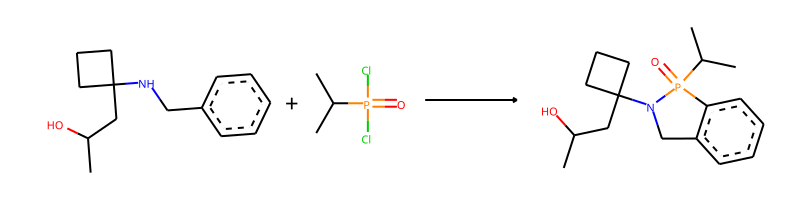

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CC(C)P(=O)(Cl)Cl>>CC(O)CC1(N2Cc3ccccc3P2(=O)C(C)C)CCC1
The fast filter score is 0.899341583


--------------------------------------------------

Train index: 310815
RANK 12 PRECEDENT
REACTANT MATCH SCORE: 0.6122448979591837


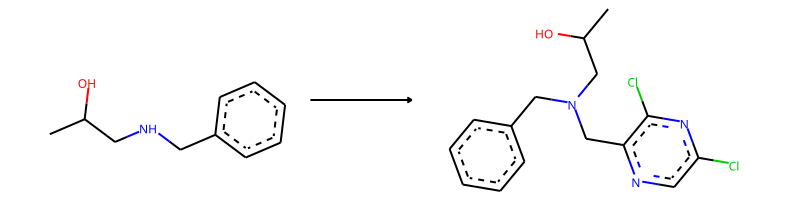

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>Cl-c1:c:n:c(-C-[N;H0;D3;+0:1](-[C:2])-[C:3]):c(-Cl):n:1


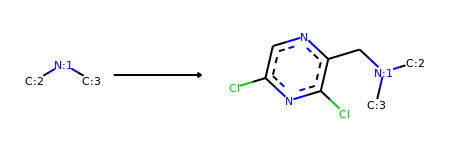

Product similarity 0.7432432432432432, overall 0.4550468836183122, smiles CC(O)CC1(N(Cc2ccccc2)Cc2ncc(Cl)nc2Cl)CCC1


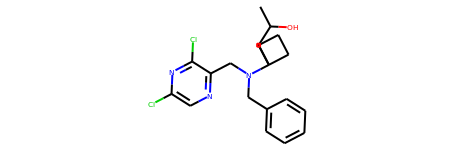

The proposed reaction is:


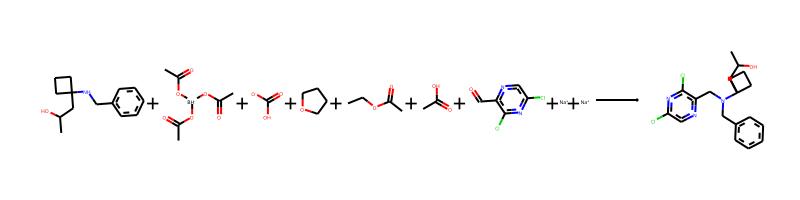

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CC(=O)O[BH-](OC(C)=O)OC(C)=O.O=C([O-])O.C1CCOC1.CCOC(C)=O.CC(=O)O.O=Cc1ncc(Cl)nc1Cl.[Na+].[Na+]>>CC(O)CC1(N(Cc2ccccc2)Cc2ncc(Cl)nc2Cl)CCC1
The fast filter score is 0.972766757


--------------------------------------------------

Train index: 435932
RANK 13 PRECEDENT
REACTANT MATCH SCORE: 0.6071428571428571


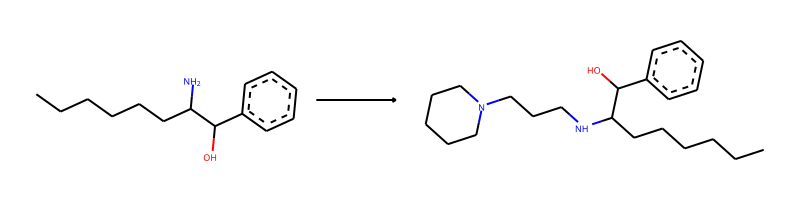

-> template: [C:1]-[NH2;D1;+0:2]>>[C:1]-[NH;D2;+0:2]-C-C-C-N1-C-C-C-C-C-1


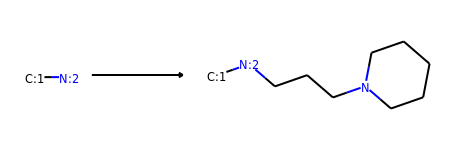

->No precursors could be generated!


--------------------------------------------------

Train index: 68435
RANK 14 PRECEDENT
REACTANT MATCH SCORE: 0.6037735849056604


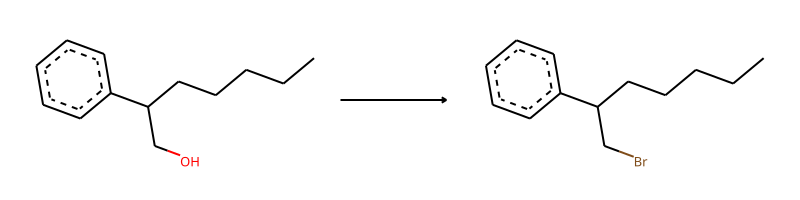

-> template: [C:2]-[CH2;D2;+0:1]-[O;H1;D1;+0]>>Br-[CH2;D2;+0:1]-[C:2]


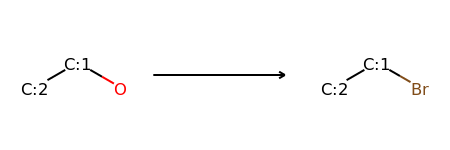

->No precursors could be generated!


--------------------------------------------------

Train index: 403695
RANK 15 PRECEDENT
REACTANT MATCH SCORE: 0.6


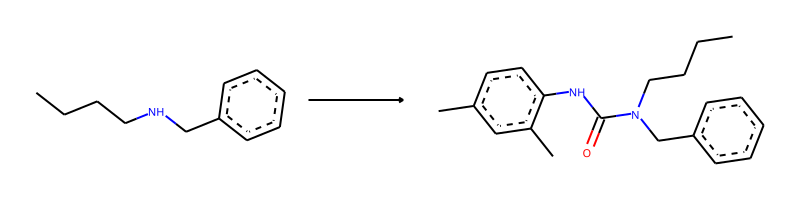

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-c1:c:c:c(-N-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]):c(-C):c:1


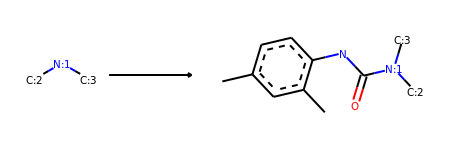

Product similarity 0.7948717948717948, overall 0.4769230769230769, smiles Cc1ccc(NC(=O)N(Cc2ccccc2)C2(CC(C)O)CCC2)c(C)c1


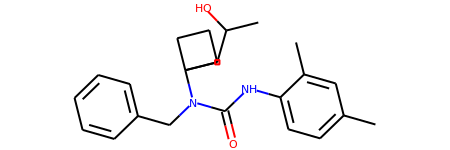

The proposed reaction is:


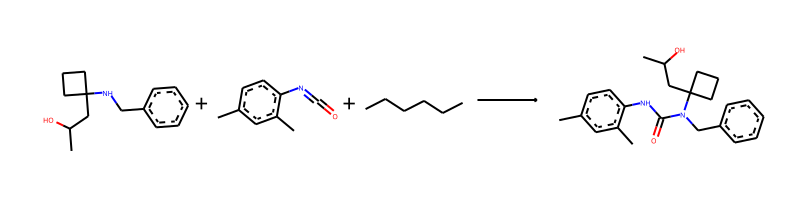

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.Cc1ccc(N=C=O)c(C)c1.CCCCCC>>Cc1ccc(NC(=O)N(Cc2ccccc2)C2(CC(C)O)CCC2)c(C)c1
The fast filter score is 0.995186925


--------------------------------------------------

Train index: 2657
RANK 16 PRECEDENT
REACTANT MATCH SCORE: 0.6


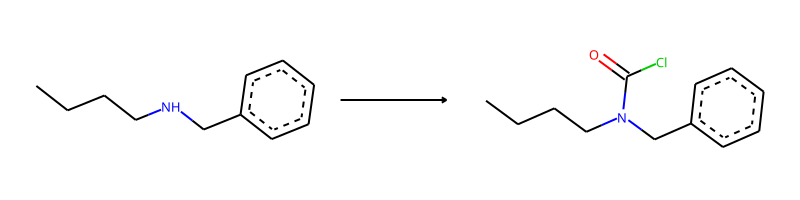

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>Cl-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]


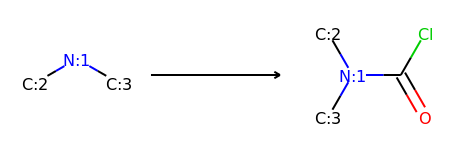

Product similarity 0.7090909090909091, overall 0.4254545454545455, smiles CC(O)CC1(N(Cc2ccccc2)C(=O)Cl)CCC1


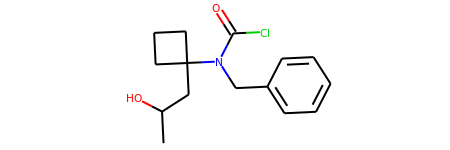

The proposed reaction is:


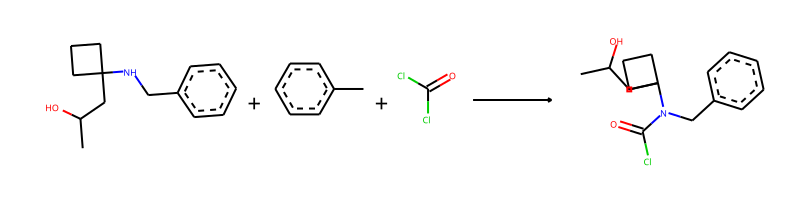

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.Cc1ccccc1.O=C(Cl)Cl>>CC(O)CC1(N(Cc2ccccc2)C(=O)Cl)CCC1
The fast filter score is 0.94858551


--------------------------------------------------

Train index: 100778
RANK 17 PRECEDENT
REACTANT MATCH SCORE: 0.6


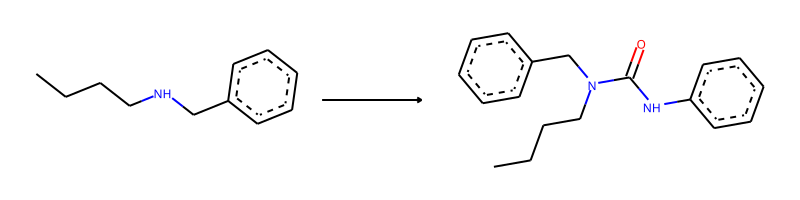

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>O=C(-N-c1:c:c:c:c:c:1)-[N;H0;D3;+0:1](-[C:2])-[C:3]


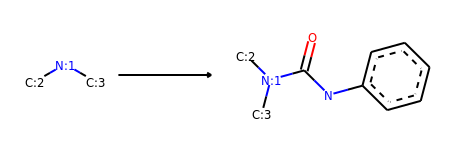

Product similarity 0.7837837837837838, overall 0.47027027027027024, smiles CC(O)CC1(N(Cc2ccccc2)C(=O)Nc2ccccc2)CCC1


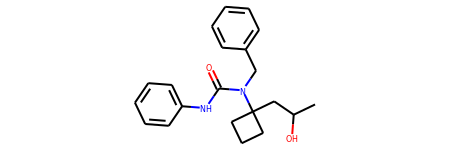

The proposed reaction is:


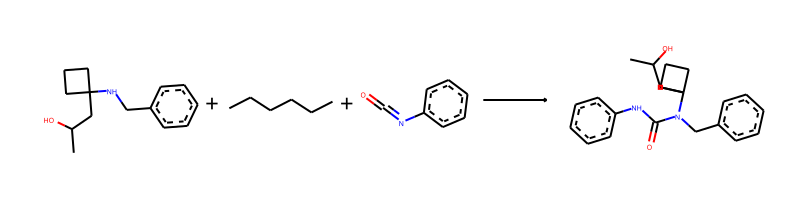

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CCCCCC.O=C=Nc1ccccc1>>CC(O)CC1(N(Cc2ccccc2)C(=O)Nc2ccccc2)CCC1
The fast filter score is 0.877785265


--------------------------------------------------

Train index: 159380
RANK 18 PRECEDENT
REACTANT MATCH SCORE: 0.5964912280701754


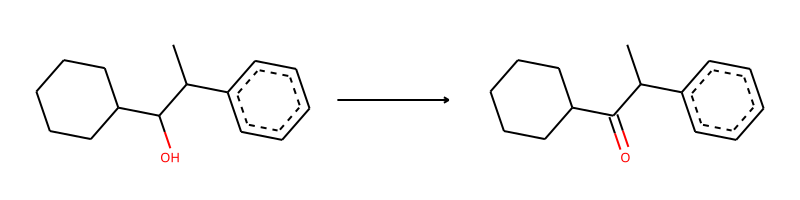

-> template: [C:1]-[CH;D3;+0:2](-[C:3])-[OH;D1;+0:4]>>[C:1]-[C;H0;D3;+0:2](-[C:3])=[O;H0;D1;+0:4]


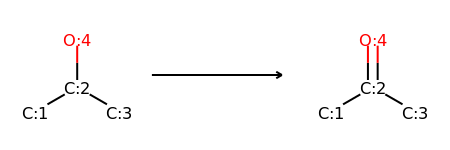

Product similarity 0.5964912280701754, overall 0.355801785164666, smiles CC(=O)CC1(NCc2ccccc2)CCC1


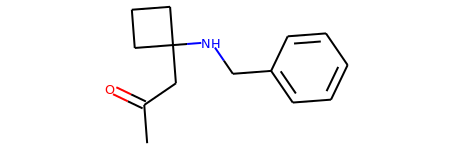

The proposed reaction is:


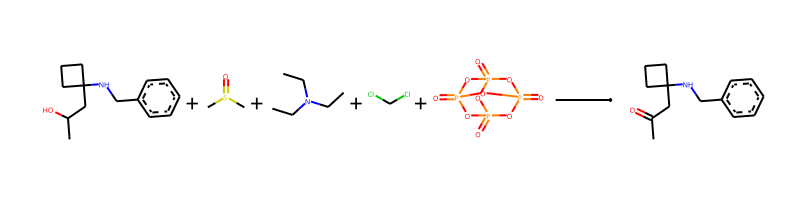

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CS(C)=O.CCN(CC)CC.ClCCl.O=P12OP3(=O)OP(=O)(O1)OP(=O)(O2)O3>>CC(=O)CC1(NCc2ccccc2)CCC1
The fast filter score is 0.187242836


--------------------------------------------------

Train index: 83042
RANK 19 PRECEDENT
REACTANT MATCH SCORE: 0.5961538461538461


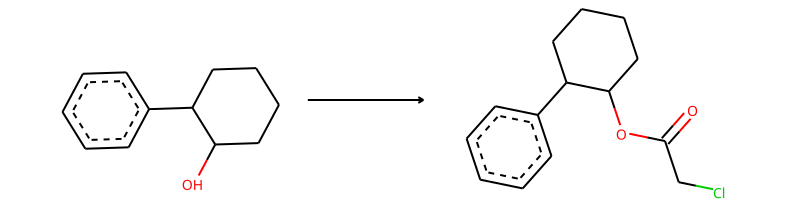

-> template: [C:2]-[OH;D1;+0:1]>>Cl-C-C(=O)-[O;H0;D2;+0:1]-[C:2]


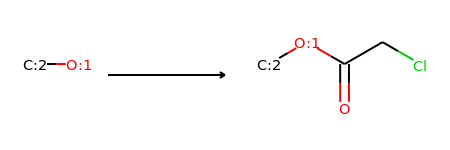

Product similarity 0.6666666666666666, overall 0.3974358974358974, smiles CC(CC1(NCc2ccccc2)CCC1)OC(=O)CCl


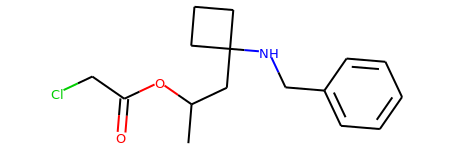

The proposed reaction is:


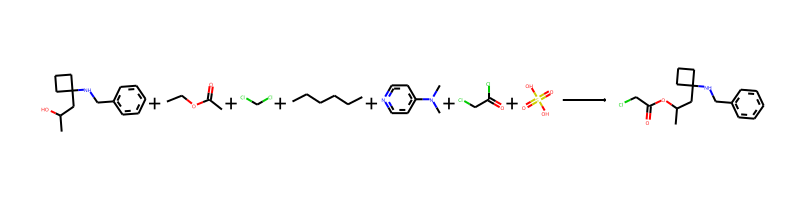

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CCOC(C)=O.ClCCl.CCCCCC.CN(C)c1ccncc1.O=C(Cl)CCl.O=S(=O)(O)O>>CC(CC1(NCc2ccccc2)CCC1)OC(=O)CCl
The fast filter score is 0.00603616238


--------------------------------------------------

Train index: 198668
RANK 20 PRECEDENT
REACTANT MATCH SCORE: 0.5961538461538461


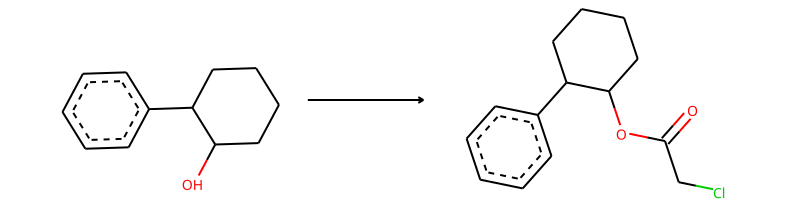

-> template: [C:2]-[OH;D1;+0:1]>>Cl-C-C(=O)-[O;H0;D2;+0:1]-[C:2]


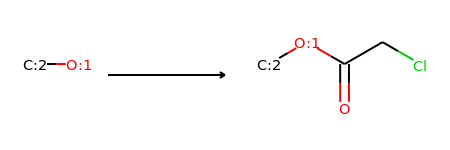

Product similarity 0.6666666666666666, overall 0.3974358974358974, smiles CC(CC1(NCc2ccccc2)CCC1)OC(=O)CCl


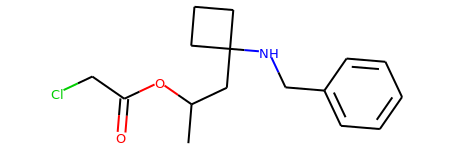

The proposed reaction is:


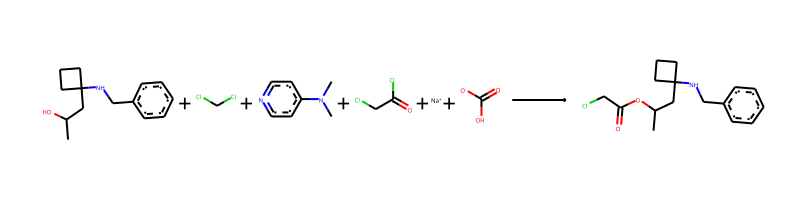

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.ClCCl.CN(C)c1ccncc1.O=C(Cl)CCl.[Na+].O=C([O-])O>>CC(CC1(NCc2ccccc2)CCC1)OC(=O)CCl
The fast filter score is 0.00129783154


--------------------------------------------------

Train index: 329878
RANK 21 PRECEDENT
REACTANT MATCH SCORE: 0.5961538461538461


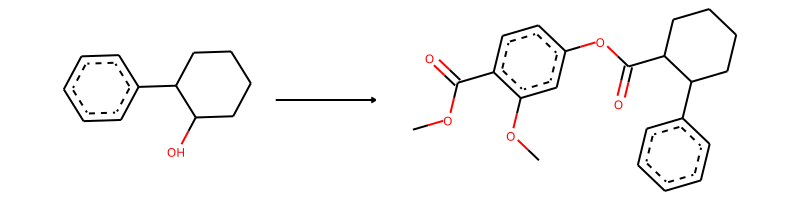

-> template: [C:2]-[CH;D3;+0:1](-[C:3])-[O;H1;D1;+0]>>C-O-C(=O)-c1:c:c:c(-O-C(=O)-[CH;D3;+0:1](-[C:2])-[C:3]):c:c:1-O-C


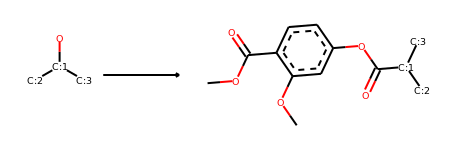

Product similarity 0.7692307692307693, overall 0.45857988165680474, smiles COC(=O)c1ccc(OC(=O)C(C)CC2(NCc3ccccc3)CCC2)cc1OC


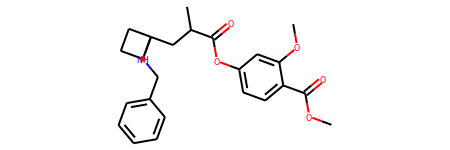

The proposed reaction is:


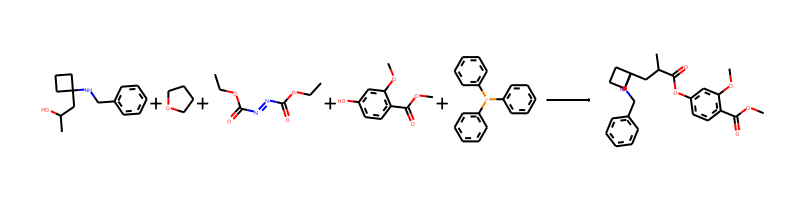

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.C1CCOC1.CCOC(=O)N=NC(=O)OCC.COC(=O)c1ccc(O)cc1OC.c1ccc(P(c2ccccc2)c2ccccc2)cc1>>COC(=O)c1ccc(OC(=O)C(C)CC2(NCc3ccccc3)CCC2)cc1OC
The fast filter score is 0.998704314


--------------------------------------------------

Train index: 153775
RANK 22 PRECEDENT
REACTANT MATCH SCORE: 0.5961538461538461


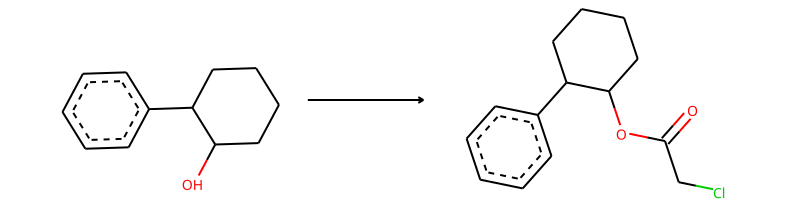

-> template: [C:2]-[OH;D1;+0:1]>>Cl-C-C(=O)-[O;H0;D2;+0:1]-[C:2]


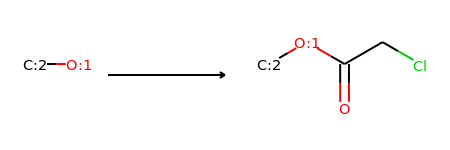

Product similarity 0.6666666666666666, overall 0.3974358974358974, smiles CC(CC1(NCc2ccccc2)CCC1)OC(=O)CCl


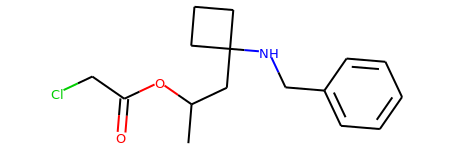

The proposed reaction is:


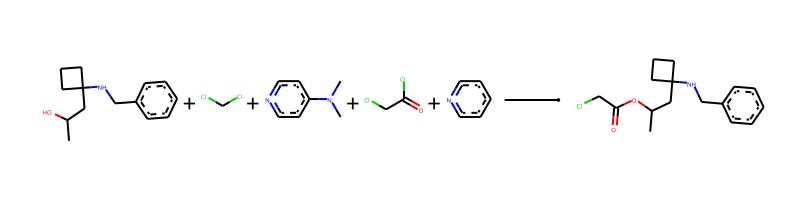

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.ClCCl.CN(C)c1ccncc1.O=C(Cl)CCl.c1ccncc1>>CC(CC1(NCc2ccccc2)CCC1)OC(=O)CCl
The fast filter score is 0.00649690628


--------------------------------------------------

Train index: 36614
RANK 23 PRECEDENT
REACTANT MATCH SCORE: 0.5932203389830508


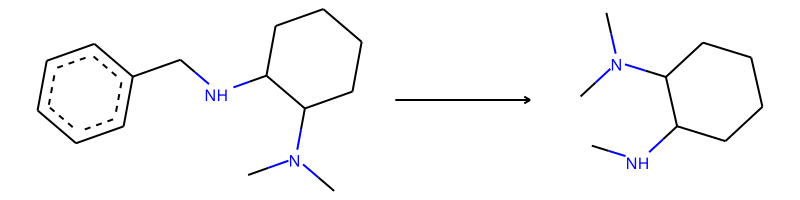

-> template: [#7:1]-[CH2;D2;+0:2]-[c;H0;D3;+0]1:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:1>>[#7:1]-[CH3;D1;+0:2]


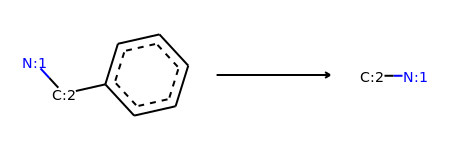

Product similarity 0.4, overall 0.23728813559322035, smiles CNC1(CC(C)O)CCC1


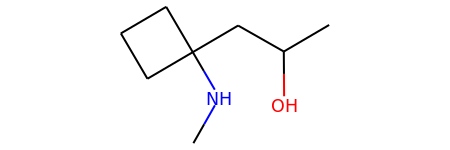

The proposed reaction is:


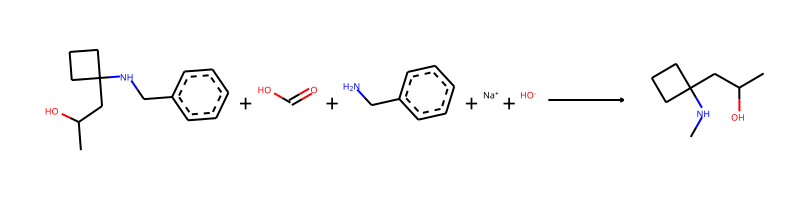

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.O=CO.NCc1ccccc1.[Na+].[OH-]>>CNC1(CC(C)O)CCC1
The fast filter score is 0.156469792


--------------------------------------------------

Train index: 80558
RANK 24 PRECEDENT
REACTANT MATCH SCORE: 0.5892857142857143


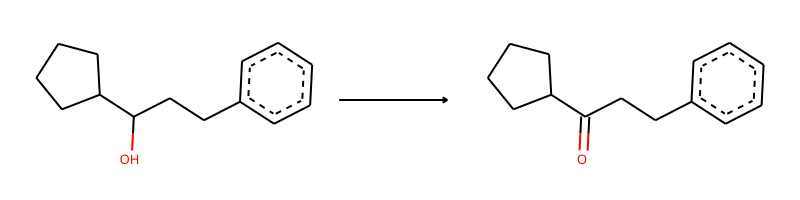

-> template: [C:1]-[CH;D3;+0:2](-[C:3])-[OH;D1;+0:4]>>[C:1]-[C;H0;D3;+0:2](-[C:3])=[O;H0;D1;+0:4]


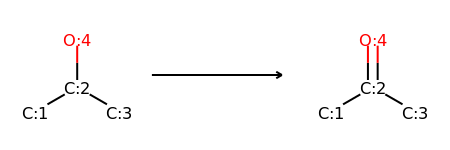

Product similarity 0.5892857142857143, overall 0.3472576530612245, smiles CC(=O)CC1(NCc2ccccc2)CCC1


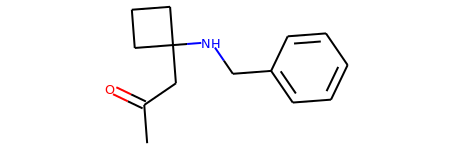

The proposed reaction is:


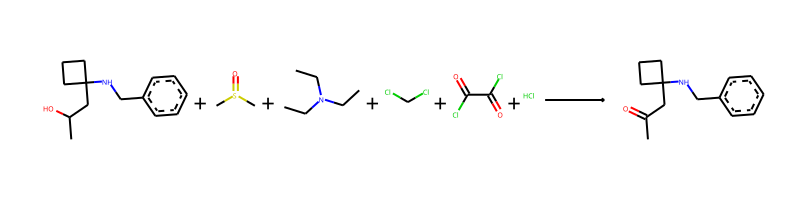

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CS(C)=O.CCN(CC)CC.ClCCl.O=C(Cl)C(=O)Cl.Cl>>CC(=O)CC1(NCc2ccccc2)CCC1
The fast filter score is 0.164829433


--------------------------------------------------

Train index: 39490
RANK 25 PRECEDENT
REACTANT MATCH SCORE: 0.5892857142857143


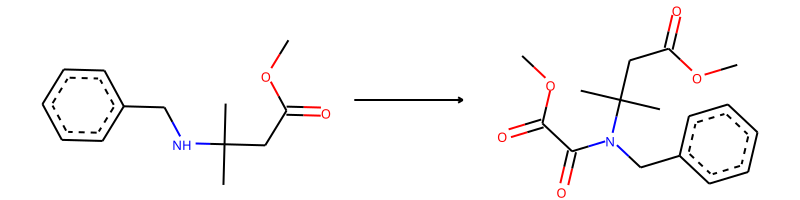

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-O-C(=O)-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]


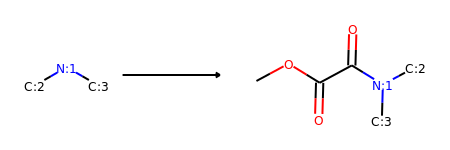

Product similarity 0.676056338028169, overall 0.3983903420523139, smiles COC(=O)C(=O)N(Cc1ccccc1)C1(CC(C)O)CCC1


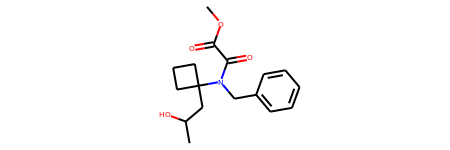

The proposed reaction is:


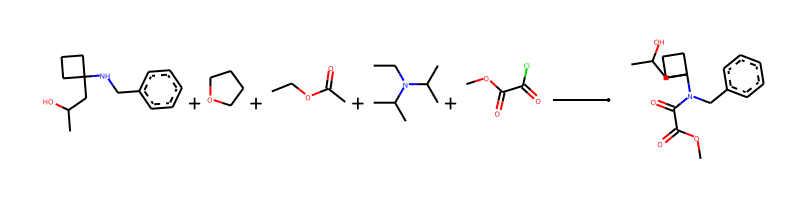

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.C1CCOC1.CCOC(C)=O.CCN(C(C)C)C(C)C.COC(=O)C(=O)Cl>>COC(=O)C(=O)N(Cc1ccccc1)C1(CC(C)O)CCC1
The fast filter score is 0.994662106


--------------------------------------------------

Train index: 206404
RANK 26 PRECEDENT
REACTANT MATCH SCORE: 0.5892857142857143


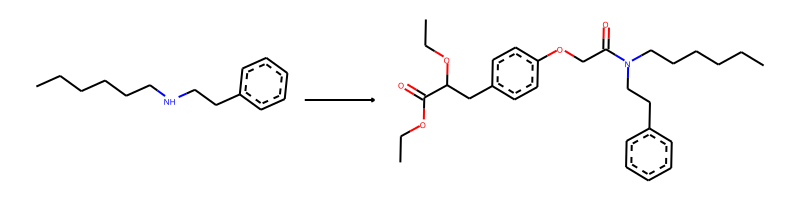

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-C-O-C(-C-c1:c:c:c(-O-C-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]):c:c:1)-C(=O)-O-C-C


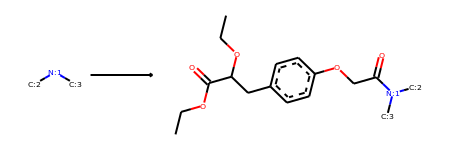

Product similarity 0.8272727272727273, overall 0.4875, smiles CCOC(=O)C(Cc1ccc(OCC(=O)N(Cc2ccccc2)C2(CC(C)O)CCC2)cc1)OCC


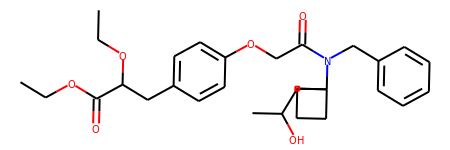

The proposed reaction is:


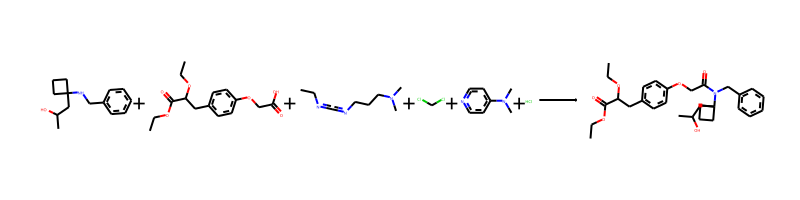

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CCOC(=O)C(Cc1ccc(OCC(=O)O)cc1)OCC.CCN=C=NCCCN(C)C.ClCCl.CN(C)c1ccncc1.Cl>>CCOC(=O)C(Cc1ccc(OCC(=O)N(Cc2ccccc2)C2(CC(C)O)CCC2)cc1)OCC
The fast filter score is 0.99924469


--------------------------------------------------

Train index: 68690
RANK 27 PRECEDENT
REACTANT MATCH SCORE: 0.5862068965517241


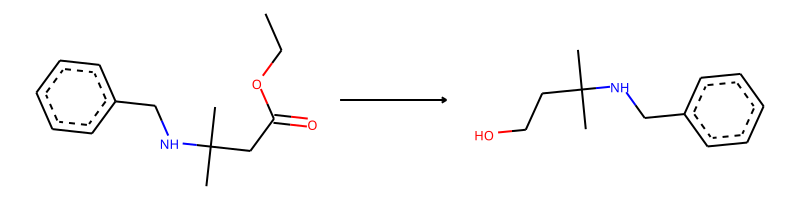

-> template: [C:1]-[C;H0;D3;+0:2](=[O;H0;D1;+0:3])-[O;H0;D2;+0]-[C;H2;D2;+0]-[C;H3;D1;+0]>>[C:1]-[CH2;D2;+0:2]-[OH;D1;+0:3]


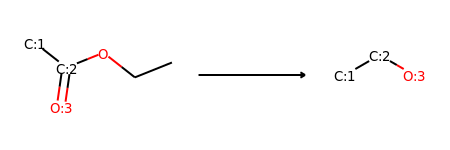

->No precursors could be generated!


--------------------------------------------------

Train index: 345922
RANK 28 PRECEDENT
REACTANT MATCH SCORE: 0.5833333333333334


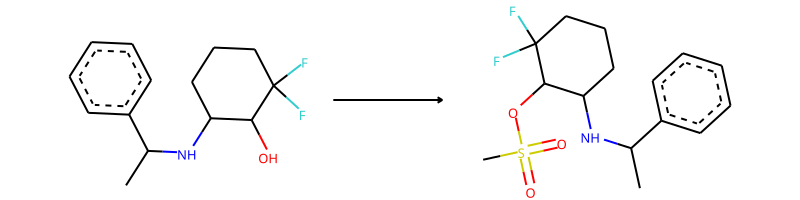

-> template: [C:2]-[OH;D1;+0:1]>>C-S(=O)(=O)-[O;H0;D2;+0:1]-[C:2]


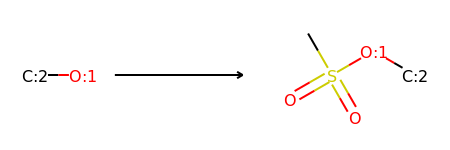

Product similarity 0.6428571428571429, overall 0.37500000000000006, smiles CC(CC1(NCc2ccccc2)CCC1)OS(C)(=O)=O


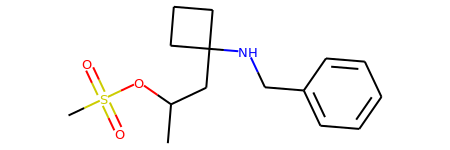

The proposed reaction is:


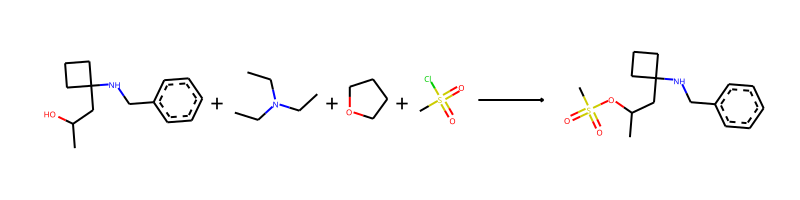

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CCN(CC)CC.C1CCOC1.CS(=O)(=O)Cl>>CC(CC1(NCc2ccccc2)CCC1)OS(C)(=O)=O
The fast filter score is 0.980598092


--------------------------------------------------

Train index: 344709
RANK 29 PRECEDENT
REACTANT MATCH SCORE: 0.5833333333333334


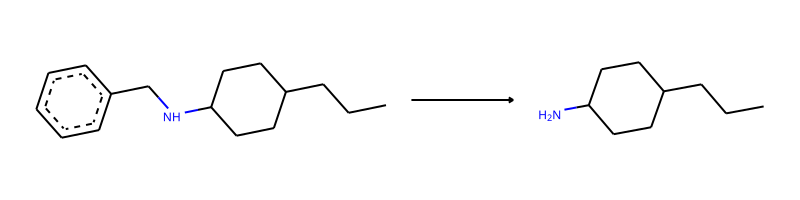

-> template: [C:1]-[NH;D2;+0:2]-[C;H2;D2;+0]-[c;H0;D3;+0]1:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:1>>[C:1]-[NH2;D1;+0:2]


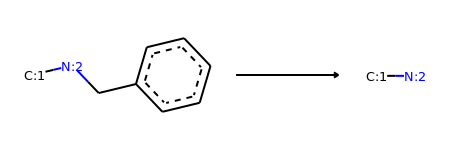

Product similarity 0.3783783783783784, overall 0.22072072072072074, smiles CC(O)CC1(N)CCC1


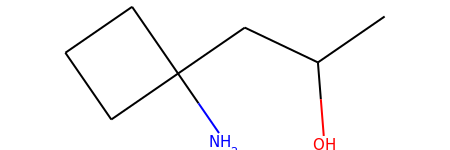

The proposed reaction is:


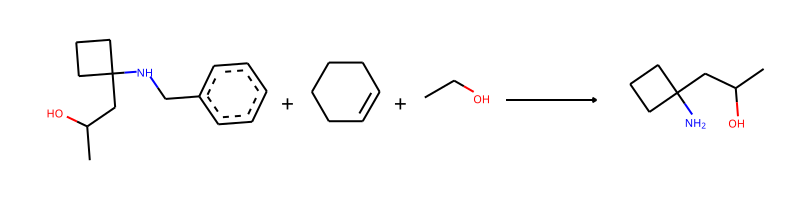

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.C1=CCCCC1.CCO>>CC(O)CC1(N)CCC1
The fast filter score is 0.555344641


--------------------------------------------------

Train index: 208125
RANK 30 PRECEDENT
REACTANT MATCH SCORE: 0.58


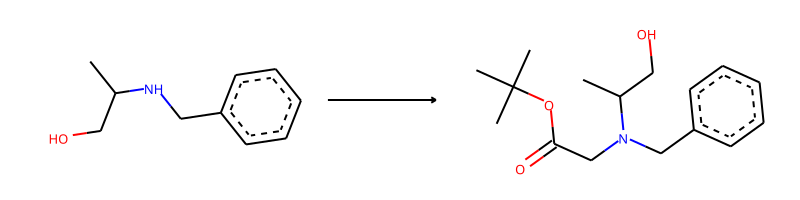

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-C(-C)(-C)-O-C(=O)-C-[N;H0;D3;+0:1](-[C:2])-[C:3]


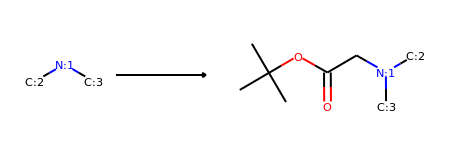

Product similarity 0.7, overall 0.40599999999999997, smiles CC(O)CC1(N(CC(=O)OC(C)(C)C)Cc2ccccc2)CCC1


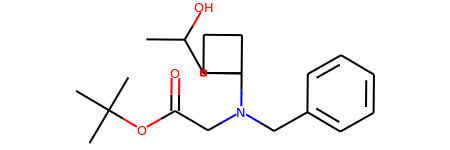

The proposed reaction is:


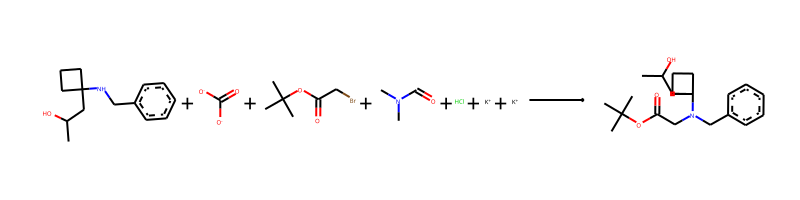

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.O=C([O-])[O-].CC(C)(C)OC(=O)CBr.CN(C)C=O.Cl.[K+].[K+]>>CC(O)CC1(N(CC(=O)OC(C)(C)C)Cc2ccccc2)CCC1
The fast filter score is 0.964411378


--------------------------------------------------

Train index: 138428
RANK 31 PRECEDENT
REACTANT MATCH SCORE: 0.58


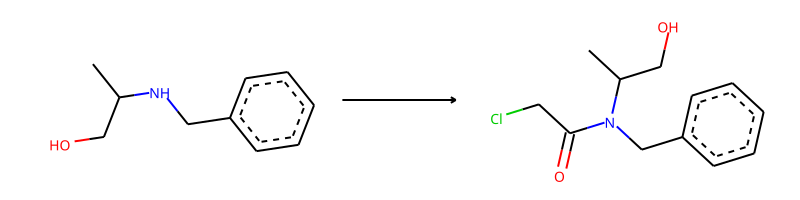

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>Cl-C-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]


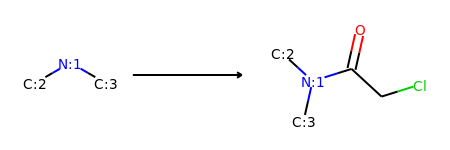

Product similarity 0.65, overall 0.377, smiles CC(O)CC1(N(Cc2ccccc2)C(=O)CCl)CCC1


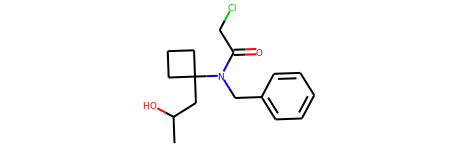

The proposed reaction is:


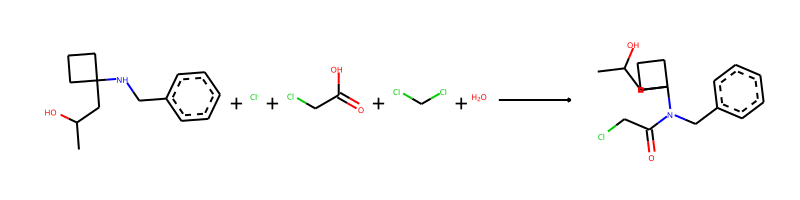

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Cl-].O=C(O)CCl.ClCCl.O>>CC(O)CC1(N(Cc2ccccc2)C(=O)CCl)CCC1
The fast filter score is 0.97361356


--------------------------------------------------

Train index: 359000
RANK 32 PRECEDENT
REACTANT MATCH SCORE: 0.58


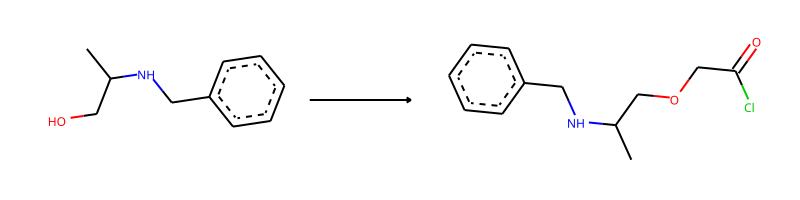

-> template: [C:2]-[OH;D1;+0:1]>>Cl-C(=O)-C-[O;H0;D2;+0:1]-[C:2]


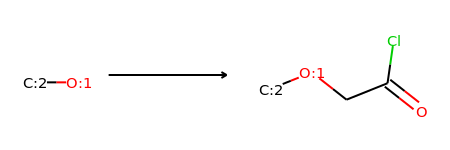

Product similarity 0.6290322580645161, overall 0.3648387096774193, smiles CC(CC1(NCc2ccccc2)CCC1)OCC(=O)Cl


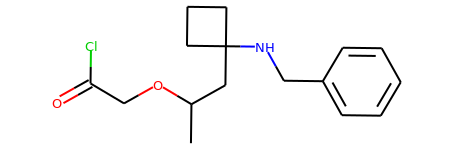

The proposed reaction is:


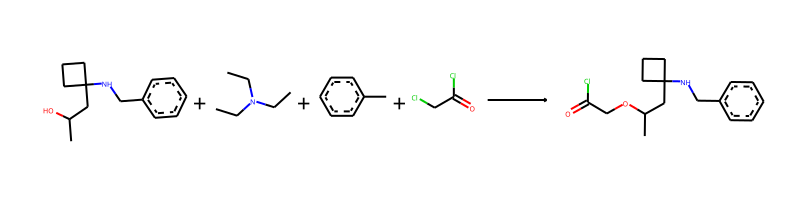

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CCN(CC)CC.Cc1ccccc1.O=C(Cl)CCl>>CC(CC1(NCc2ccccc2)CCC1)OCC(=O)Cl
The fast filter score is 0.000242233276


--------------------------------------------------

Train index: 10359
RANK 33 PRECEDENT
REACTANT MATCH SCORE: 0.58


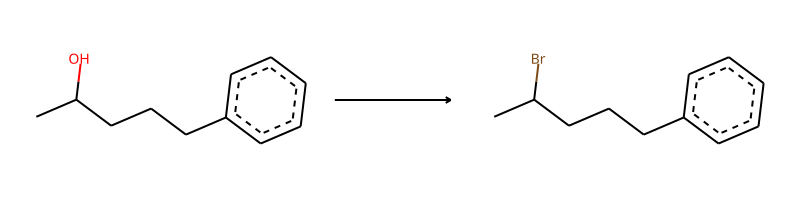

-> template: [C:2]-[CH;D3;+0:1](-[C;D1;H3:3])-[O;H1;D1;+0]>>Br-[CH;D3;+0:1](-[C:2])-[C;D1;H3:3]


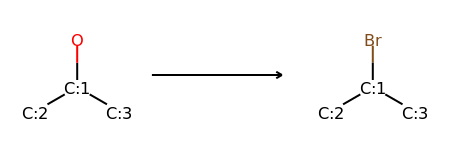

Product similarity 0.58, overall 0.3364, smiles CC(Br)CC1(NCc2ccccc2)CCC1


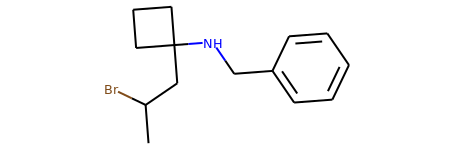

The proposed reaction is:


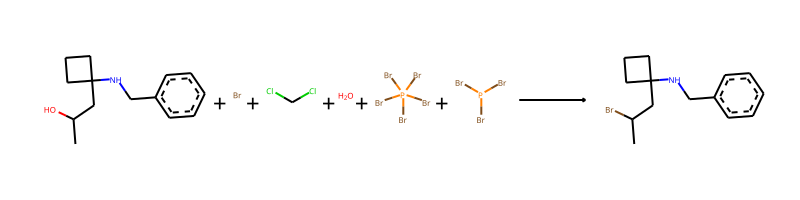

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Br].ClCCl.O.BrP(Br)(Br)(Br)Br.BrP(Br)Br>>CC(Br)CC1(NCc2ccccc2)CCC1
The fast filter score is 0.815375686


--------------------------------------------------

Train index: 322634
RANK 34 PRECEDENT
REACTANT MATCH SCORE: 0.58


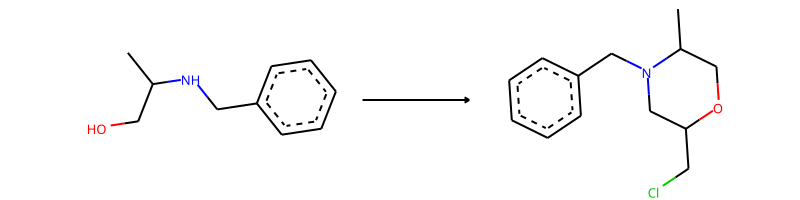

-> template: [C:2]-[NH;D2;+0:1]-[C:3]-[C:4]-[OH;D1;+0:5]>>Cl-C-C1-C-[N;H0;D3;+0:1](-[C:2])-[C:3]-[C:4]-[O;H0;D2;+0:5]-1


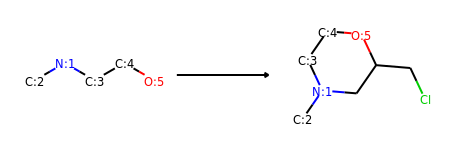

->No precursors could be generated!


--------------------------------------------------

Train index: 18017
RANK 35 PRECEDENT
REACTANT MATCH SCORE: 0.58


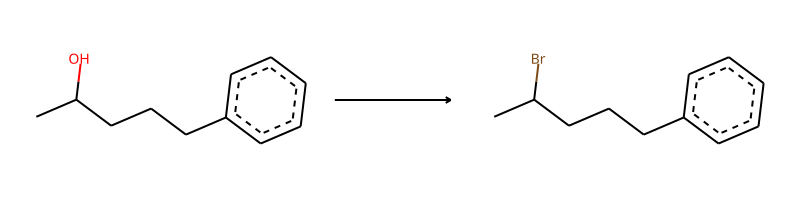

-> template: [C:2]-[CH;D3;+0:1](-[C;D1;H3:3])-[O;H1;D1;+0]>>Br-[CH;D3;+0:1](-[C:2])-[C;D1;H3:3]


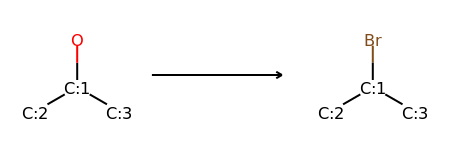

Product similarity 0.58, overall 0.3364, smiles CC(Br)CC1(NCc2ccccc2)CCC1


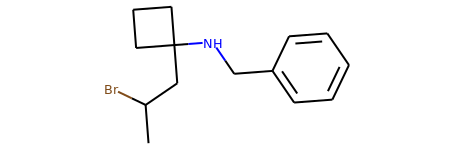

The proposed reaction is:


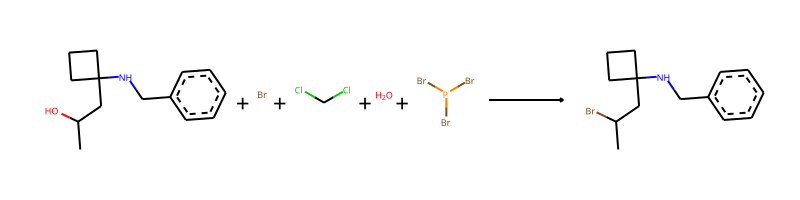

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Br].ClCCl.O.BrP(Br)Br>>CC(Br)CC1(NCc2ccccc2)CCC1
The fast filter score is 0.870692253


--------------------------------------------------

Train index: 46533
RANK 36 PRECEDENT
REACTANT MATCH SCORE: 0.576271186440678


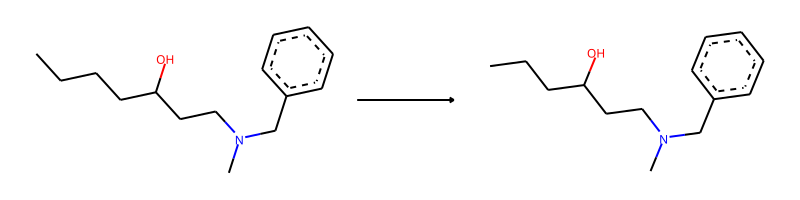

-> template: [C:1]-[CH2;D2;+0:2]-[C;H3;D1;+0]>>[C:1]-[CH3;D1;+0:2]


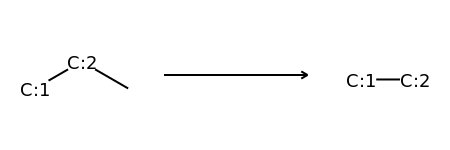

->No precursors could be generated!


--------------------------------------------------

Train index: 162476
RANK 37 PRECEDENT
REACTANT MATCH SCORE: 0.5692307692307692


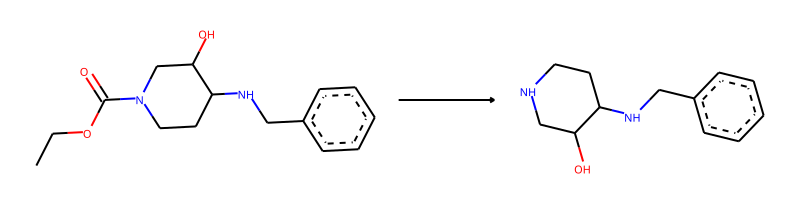

-> template: [C:1]-[N;H0;D3;+0:2](-[C:3])-[C;H0;D3;+0](=[O;H0;D1;+0])-[O;H0;D2;+0]-[C;H2;D2;+0]-[C;H3;D1;+0]>>[C:1]-[NH;D2;+0:2]-[C:3]


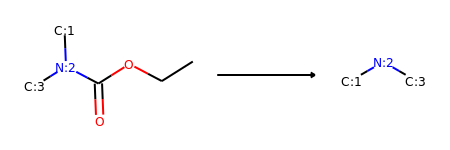

->No precursors could be generated!


--------------------------------------------------

Train index: 354997
RANK 38 PRECEDENT
REACTANT MATCH SCORE: 0.5689655172413793


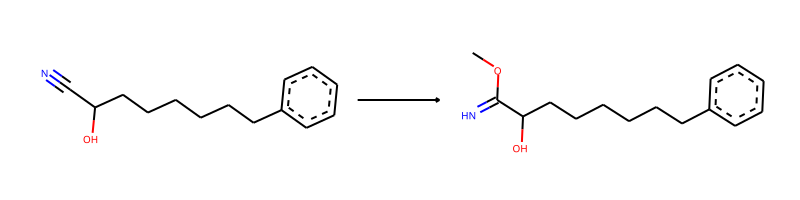

-> template: [C:2]-[C;H0;D2;+0:1]#[N;H0;D1;+0:3]>>C-O-[C;H0;D3;+0:1](-[C:2])=[NH;D1;+0:3]


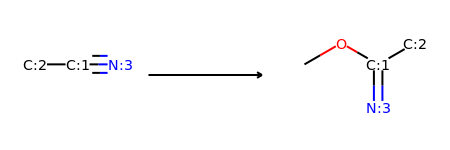

->No precursors could be generated!


--------------------------------------------------

Train index: 281902
RANK 39 PRECEDENT
REACTANT MATCH SCORE: 0.5689655172413793


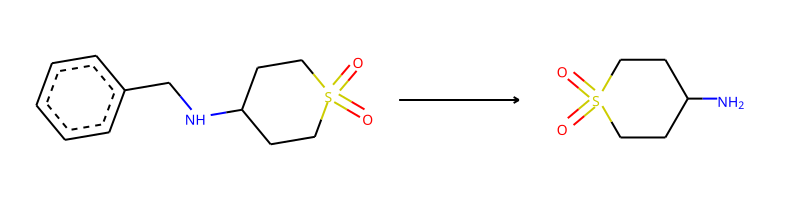

-> template: [C:1]-[NH;D2;+0:2]-[C;H2;D2;+0]-[c;H0;D3;+0]1:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:1>>[C:1]-[NH2;D1;+0:2]


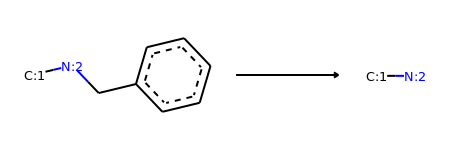

Product similarity 0.34285714285714286, overall 0.19507389162561578, smiles CC(O)CC1(N)CCC1


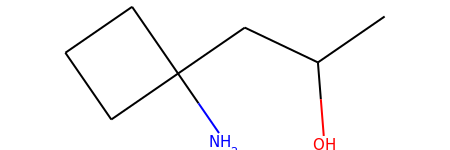

The proposed reaction is:


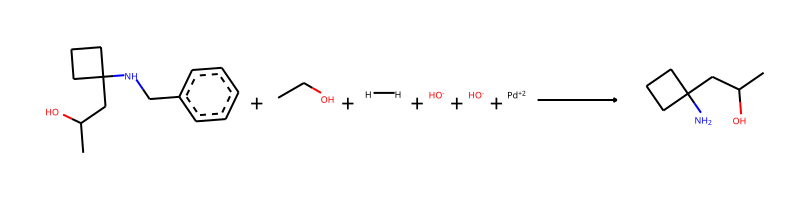

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CCO.[H][H].[OH-].[OH-].[Pd+2]>>CC(O)CC1(N)CCC1
The fast filter score is 0.178622663


--------------------------------------------------

Train index: 340350
RANK 40 PRECEDENT
REACTANT MATCH SCORE: 0.5686274509803921


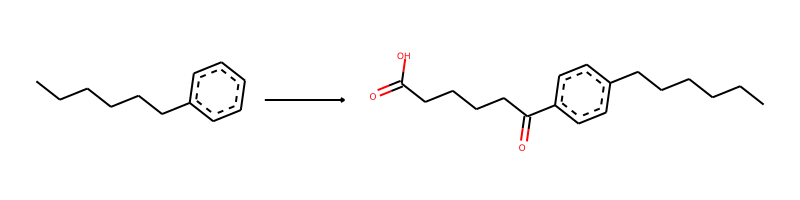

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>O-C(=O)-C-C-C-C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]


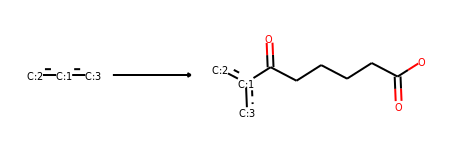

Product similarity 0.6410256410256411, overall 0.3645047762694822, smiles CC(O)CC1(NCc2ccccc2C(=O)CCCCC(=O)O)CCC1


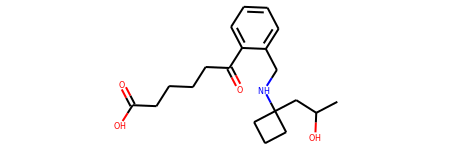

The proposed reaction is:


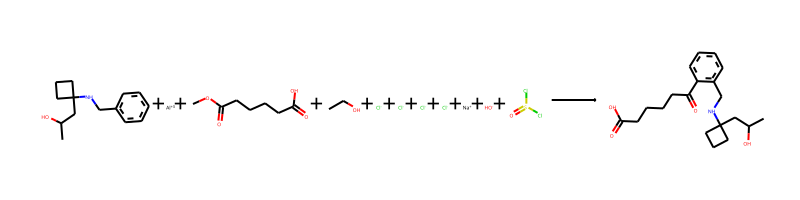

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].COC(=O)CCCCC(=O)O.CCO.[Cl-].[Cl-].[Cl-].[Cl-].[Na+].[OH-].O=S(Cl)Cl>>CC(O)CC1(NCc2ccccc2C(=O)CCCCC(=O)O)CCC1
The fast filter score is 0.0190345049
Product similarity 0.7066666666666667, overall 0.40183006535947713, smiles CC(O)CC1(NCc2ccc(C(=O)CCCCC(=O)O)cc2)CCC1


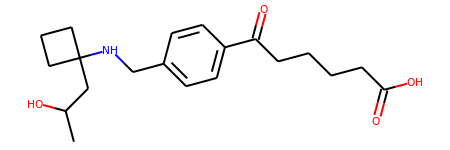

The proposed reaction is:


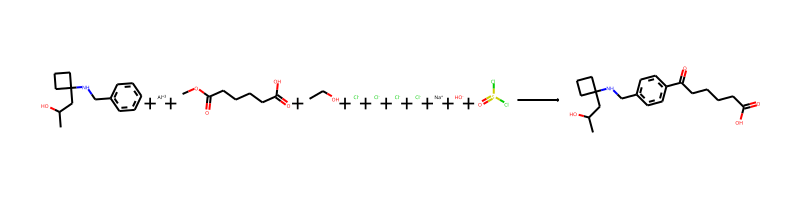

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].COC(=O)CCCCC(=O)O.CCO.[Cl-].[Cl-].[Cl-].[Cl-].[Na+].[OH-].O=S(Cl)Cl>>CC(O)CC1(NCc2ccc(C(=O)CCCCC(=O)O)cc2)CCC1
The fast filter score is 0.0373516083
Product similarity 0.6623376623376623, overall 0.3766233766233766, smiles CC(O)CC1(NCc2cccc(C(=O)CCCCC(=O)O)c2)CCC1


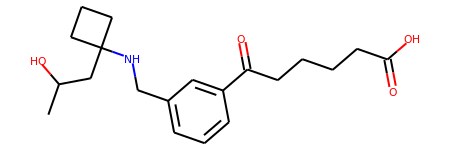

The proposed reaction is:


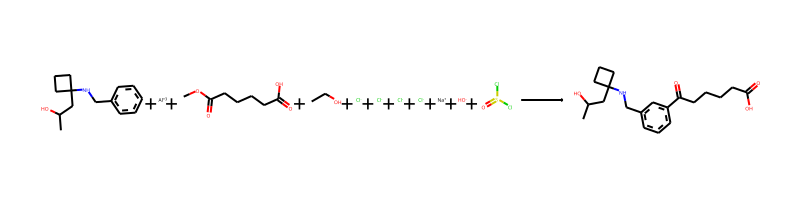

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].COC(=O)CCCCC(=O)O.CCO.[Cl-].[Cl-].[Cl-].[Cl-].[Na+].[OH-].O=S(Cl)Cl>>CC(O)CC1(NCc2cccc(C(=O)CCCCC(=O)O)c2)CCC1
The fast filter score is 0.00612509251


--------------------------------------------------

Train index: 187737
RANK 41 PRECEDENT
REACTANT MATCH SCORE: 0.5686274509803921


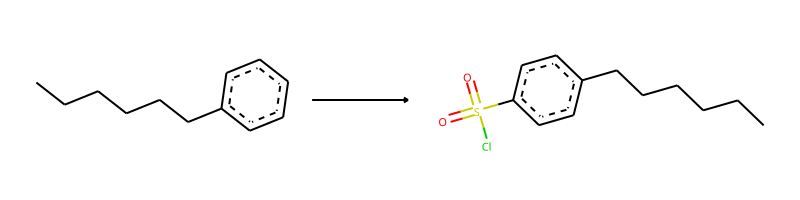

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>Cl-S(=O)(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]


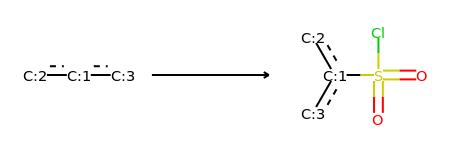

Product similarity 0.6333333333333333, overall 0.3601307189542483, smiles CC(O)CC1(NCc2ccc(S(=O)(=O)Cl)cc2)CCC1


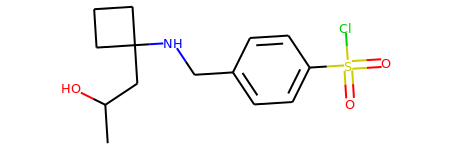

The proposed reaction is:


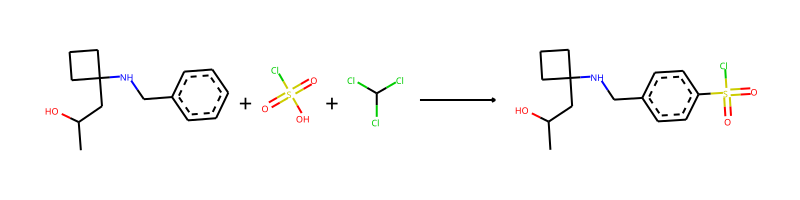

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.O=S(=O)(O)Cl.ClC(Cl)Cl>>CC(O)CC1(NCc2ccc(S(=O)(=O)Cl)cc2)CCC1
The fast filter score is 0.309603155
Product similarity 0.5806451612903226, overall 0.3301707779886148, smiles CC(O)CC1(NCc2cccc(S(=O)(=O)Cl)c2)CCC1


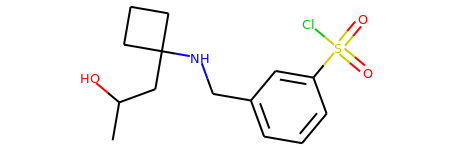

The proposed reaction is:


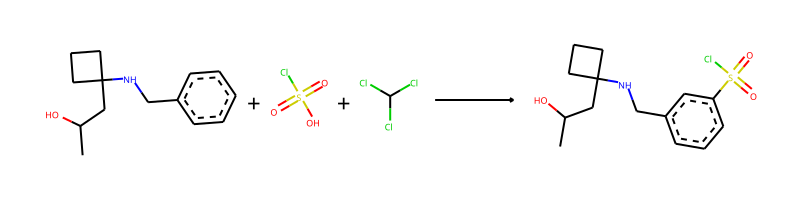

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.O=S(=O)(O)Cl.ClC(Cl)Cl>>CC(O)CC1(NCc2cccc(S(=O)(=O)Cl)c2)CCC1
The fast filter score is 0.529639184
Product similarity 0.5555555555555556, overall 0.3159041394335512, smiles CC(O)CC1(NCc2ccccc2S(=O)(=O)Cl)CCC1


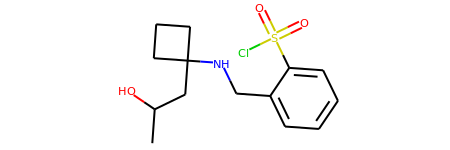

The proposed reaction is:


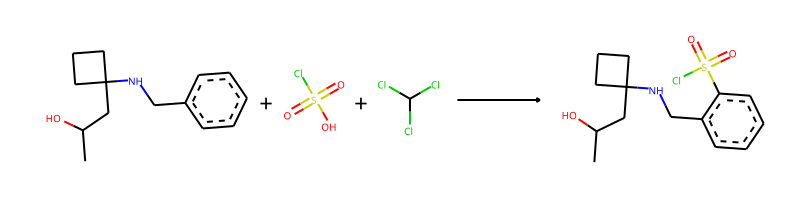

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.O=S(=O)(O)Cl.ClC(Cl)Cl>>CC(O)CC1(NCc2ccccc2S(=O)(=O)Cl)CCC1
The fast filter score is 0.34713614


--------------------------------------------------

Train index: 336399
RANK 42 PRECEDENT
REACTANT MATCH SCORE: 0.5686274509803921


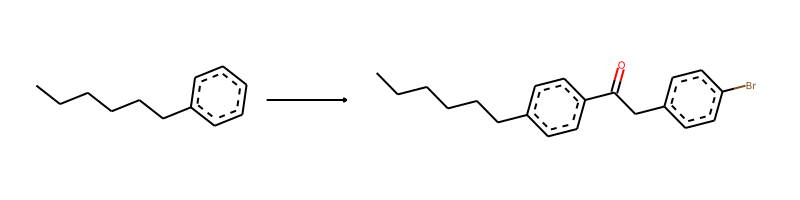

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>Br-c1:c:c:c(-C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]):c:c:1


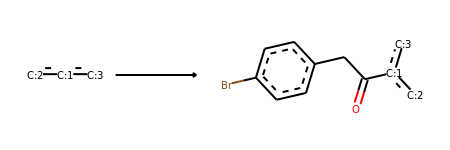

Product similarity 0.6790123456790124, overall 0.3861050593076737, smiles CC(O)CC1(NCc2cccc(C(=O)Cc3ccc(Br)cc3)c2)CCC1


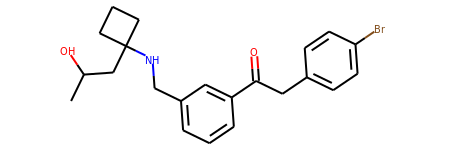

The proposed reaction is:


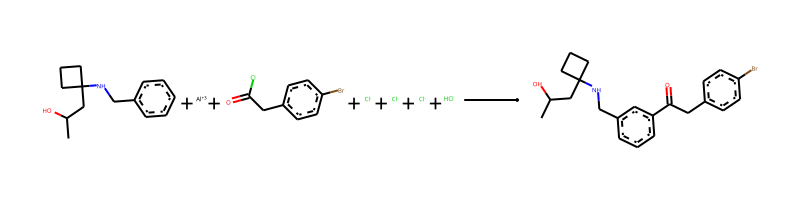

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].O=C(Cl)Cc1ccc(Br)cc1.[Cl-].[Cl-].[Cl-].Cl>>CC(O)CC1(NCc2cccc(C(=O)Cc3ccc(Br)cc3)c2)CCC1
The fast filter score is 0.347851932
Product similarity 0.7215189873417721, overall 0.4102755026061057, smiles CC(O)CC1(NCc2ccc(C(=O)Cc3ccc(Br)cc3)cc2)CCC1


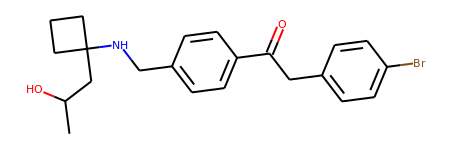

The proposed reaction is:


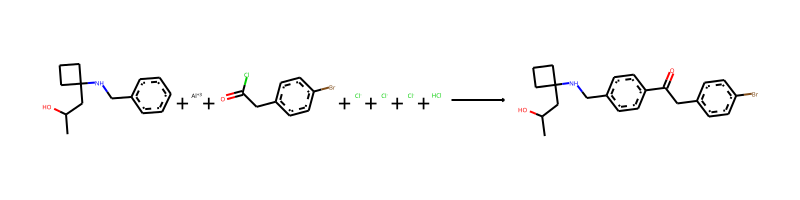

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].O=C(Cl)Cc1ccc(Br)cc1.[Cl-].[Cl-].[Cl-].Cl>>CC(O)CC1(NCc2ccc(C(=O)Cc3ccc(Br)cc3)cc2)CCC1
The fast filter score is 0.86463362
Product similarity 0.6585365853658537, overall 0.3744619799139168, smiles CC(O)CC1(NCc2ccccc2C(=O)Cc2ccc(Br)cc2)CCC1


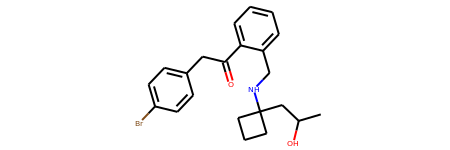

The proposed reaction is:


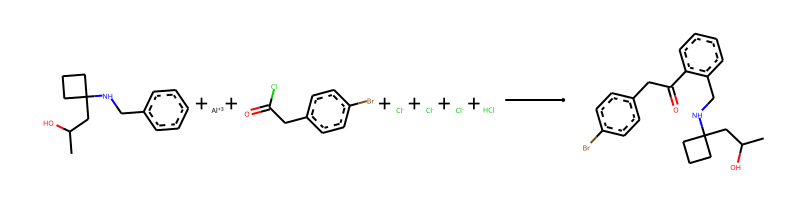

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].O=C(Cl)Cc1ccc(Br)cc1.[Cl-].[Cl-].[Cl-].Cl>>CC(O)CC1(NCc2ccccc2C(=O)Cc2ccc(Br)cc2)CCC1
The fast filter score is 0.950359285


--------------------------------------------------

Train index: 158240
RANK 43 PRECEDENT
REACTANT MATCH SCORE: 0.5686274509803921


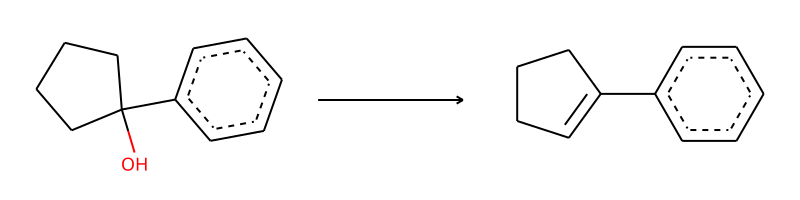

-> template: [C:1]-[CH2;D2;+0:2]-[C;H0;D4;+0:3](-[C:4])(-[O;H1;D1;+0])-[c:5]>>[C:1]-[CH;D2;+0:2]=[C;H0;D3;+0:3](-[C:4])-[c:5]


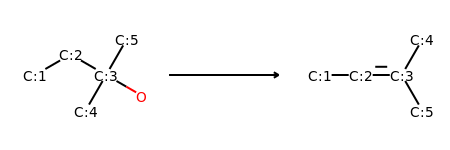

->No precursors could be generated!


--------------------------------------------------

Train index: 328889
RANK 44 PRECEDENT
REACTANT MATCH SCORE: 0.5686274509803921


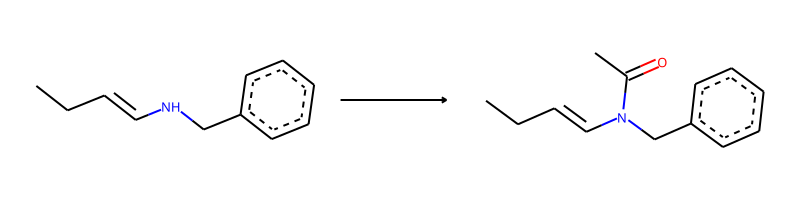

-> template: [C:4]=[C:3]-[NH;D2;+0:1]-[C:2]>>C-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]=[C:4]


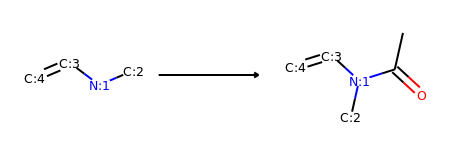

->No precursors could be generated!


--------------------------------------------------

Train index: 78262
RANK 45 PRECEDENT
REACTANT MATCH SCORE: 0.5671641791044776


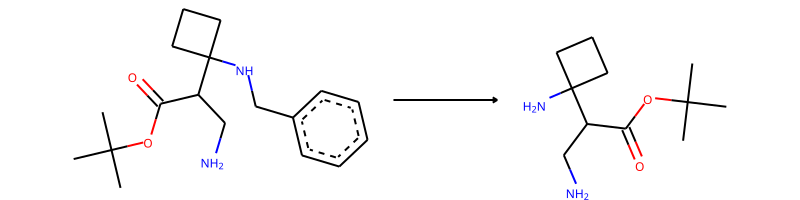

-> template: [C:1]-[NH;D2;+0:2]-[C;H2;D2;+0]-[c;H0;D3;+0]1:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:1>>[C:1]-[NH2;D1;+0:2]


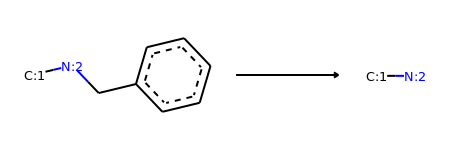

Product similarity 0.35555555555555557, overall 0.20165837479270315, smiles CC(O)CC1(N)CCC1


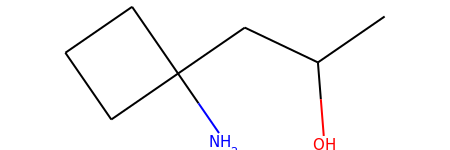

The proposed reaction is:


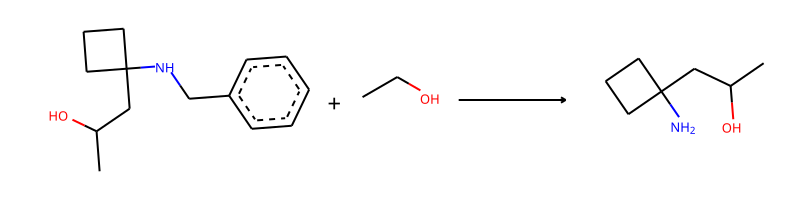

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CCO>>CC(O)CC1(N)CCC1
The fast filter score is 0.627759039


--------------------------------------------------

Train index: 158519
RANK 46 PRECEDENT
REACTANT MATCH SCORE: 0.5666666666666667


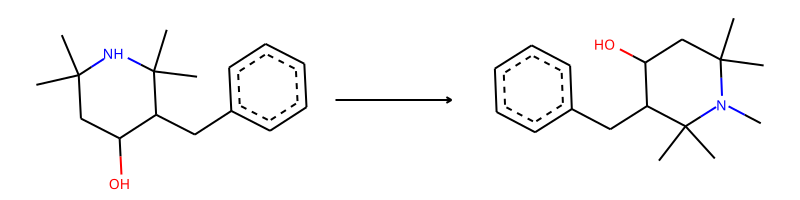

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-[N;H0;D3;+0:1](-[C:2])-[C:3]


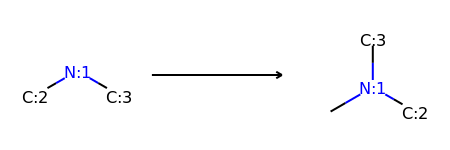

Product similarity 0.5806451612903226, overall 0.32903225806451614, smiles CC(O)CC1(N(C)Cc2ccccc2)CCC1


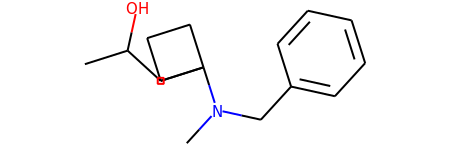

The proposed reaction is:


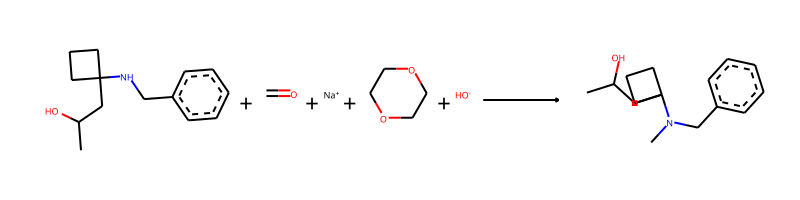

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.C=O.[Na+].C1COCCO1.[OH-]>>CC(O)CC1(N(C)Cc2ccccc2)CCC1
The fast filter score is 0.738816559


--------------------------------------------------

Train index: 409823
RANK 47 PRECEDENT
REACTANT MATCH SCORE: 0.5660377358490566


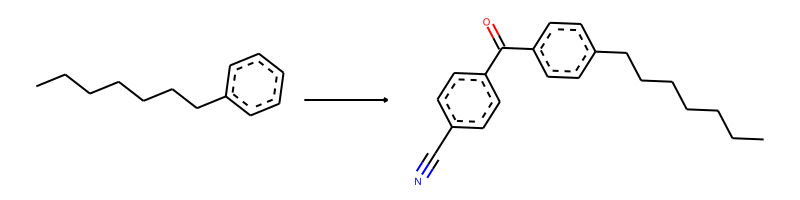

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>N#C-c1:c:c:c(-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]):c:c:1


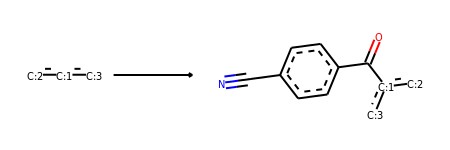

Product similarity 0.6547619047619048, overall 0.3706199460916442, smiles CC(O)CC1(NCc2ccccc2C(=O)c2ccc(C#N)cc2)CCC1


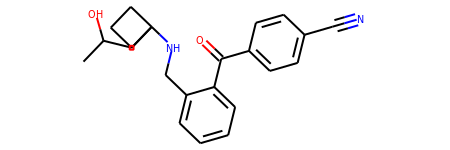

The proposed reaction is:


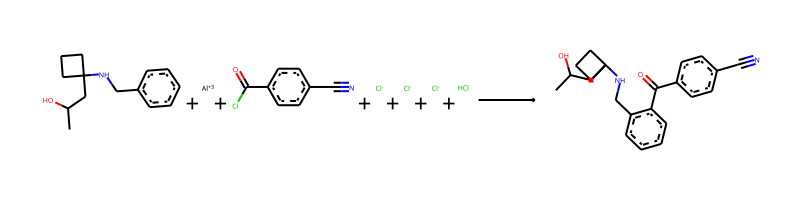

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].N#Cc1ccc(C(=O)Cl)cc1.[Cl-].[Cl-].[Cl-].Cl>>CC(O)CC1(NCc2ccccc2C(=O)c2ccc(C#N)cc2)CCC1
The fast filter score is 0.181002378
Product similarity 0.7160493827160493, overall 0.40531097134870714, smiles CC(O)CC1(NCc2ccc(C(=O)c3ccc(C#N)cc3)cc2)CCC1


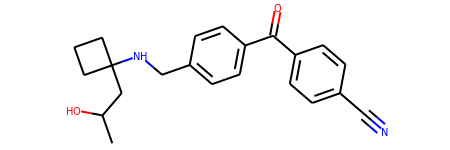

The proposed reaction is:


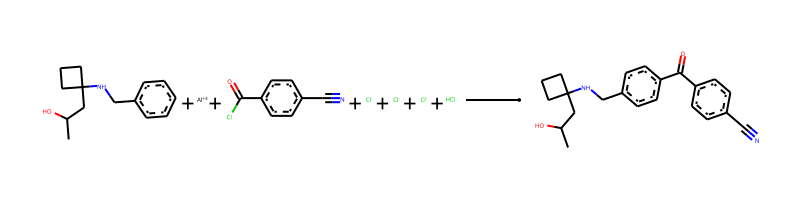

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].N#Cc1ccc(C(=O)Cl)cc1.[Cl-].[Cl-].[Cl-].Cl>>CC(O)CC1(NCc2ccc(C(=O)c3ccc(C#N)cc3)cc2)CCC1
The fast filter score is 0.866228342
Product similarity 0.6746987951807228, overall 0.38190497840418275, smiles CC(O)CC1(NCc2cccc(C(=O)c3ccc(C#N)cc3)c2)CCC1


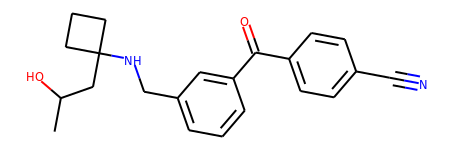

The proposed reaction is:


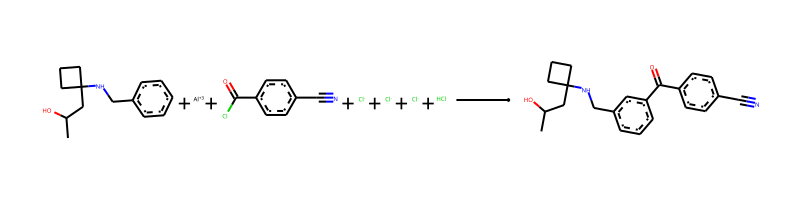

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].N#Cc1ccc(C(=O)Cl)cc1.[Cl-].[Cl-].[Cl-].Cl>>CC(O)CC1(NCc2cccc(C(=O)c3ccc(C#N)cc3)c2)CCC1
The fast filter score is 0.801475286


--------------------------------------------------

Train index: 443667
RANK 48 PRECEDENT
REACTANT MATCH SCORE: 0.5660377358490566


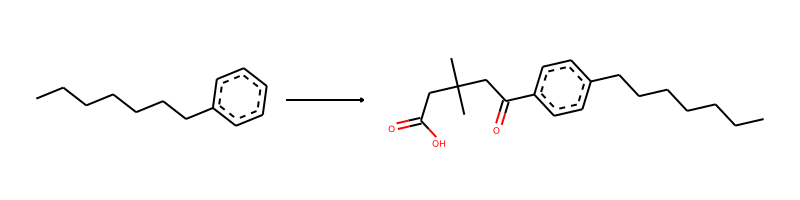

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>C-C(-C)(-C-C(-O)=O)-C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]


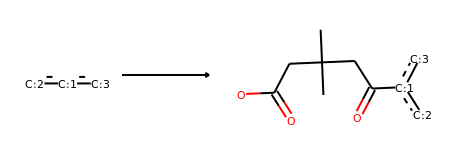

Product similarity 0.6419753086419753, overall 0.363382250174703, smiles CC(O)CC1(NCc2ccccc2C(=O)CC(C)(C)CC(=O)O)CCC1


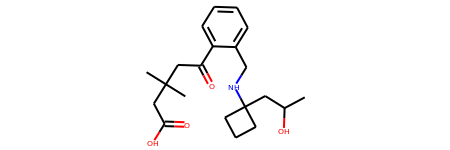

The proposed reaction is:


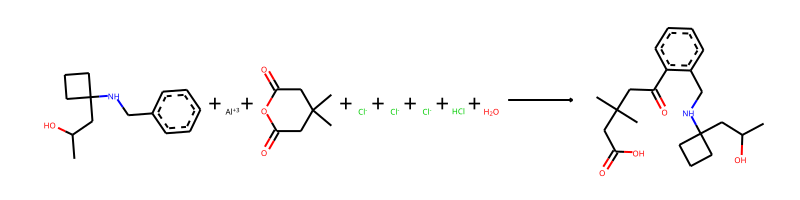

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].CC1(C)CC(=O)OC(=O)C1.[Cl-].[Cl-].[Cl-].Cl.O>>CC(O)CC1(NCc2ccccc2C(=O)CC(C)(C)CC(=O)O)CCC1
The fast filter score is 0.00595033169
Product similarity 0.6625, overall 0.375, smiles CC(O)CC1(NCc2cccc(C(=O)CC(C)(C)CC(=O)O)c2)CCC1


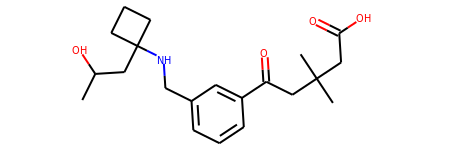

The proposed reaction is:


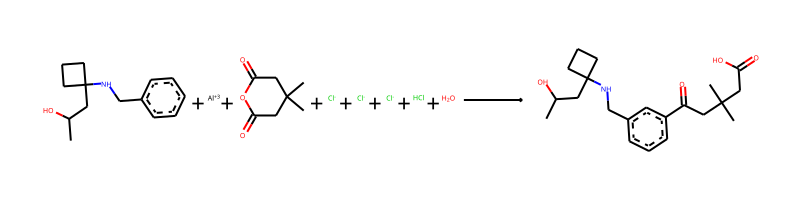

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].CC1(C)CC(=O)OC(=O)C1.[Cl-].[Cl-].[Cl-].Cl.O>>CC(O)CC1(NCc2cccc(C(=O)CC(C)(C)CC(=O)O)c2)CCC1
The fast filter score is 0.166727275
Product similarity 0.7051282051282052, overall 0.3991291727140784, smiles CC(O)CC1(NCc2ccc(C(=O)CC(C)(C)CC(=O)O)cc2)CCC1


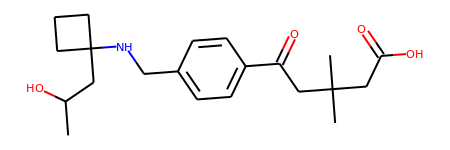

The proposed reaction is:


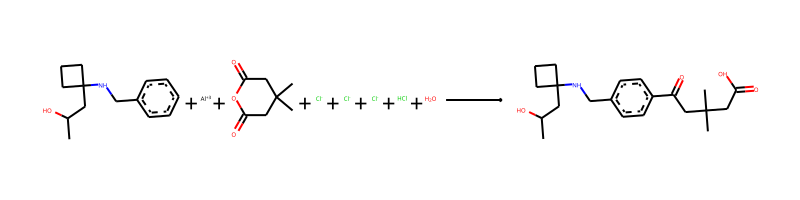

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].CC1(C)CC(=O)OC(=O)C1.[Cl-].[Cl-].[Cl-].Cl.O>>CC(O)CC1(NCc2ccc(C(=O)CC(C)(C)CC(=O)O)cc2)CCC1
The fast filter score is 0.450976789


--------------------------------------------------

Train index: 222961
RANK 49 PRECEDENT
REACTANT MATCH SCORE: 0.5660377358490566


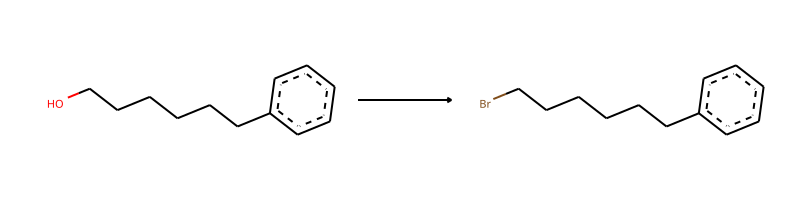

-> template: [C:2]-[CH2;D2;+0:1]-[O;H1;D1;+0]>>Br-[CH2;D2;+0:1]-[C:2]


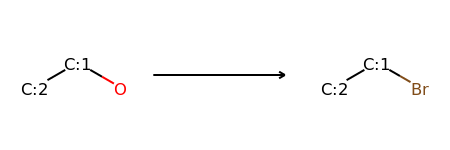

->No precursors could be generated!


--------------------------------------------------

Train index: 268056
RANK 50 PRECEDENT
REACTANT MATCH SCORE: 0.5660377358490566


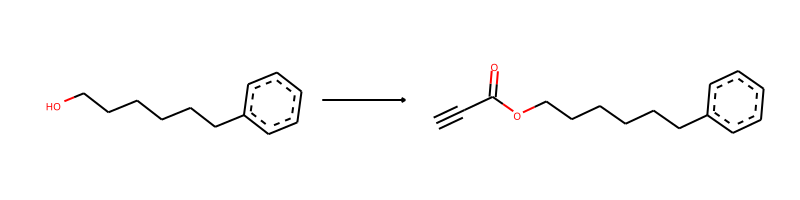

-> template: [C:2]-[OH;D1;+0:1]>>C#C-C(=O)-[O;H0;D2;+0:1]-[C:2]


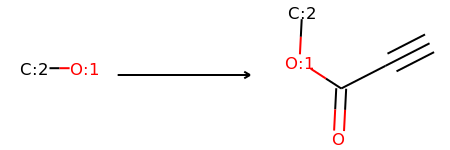

Product similarity 0.6153846153846154, overall 0.3483309143686502, smiles C#CC(=O)OC(C)CC1(NCc2ccccc2)CCC1


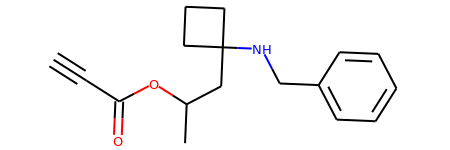

The proposed reaction is:


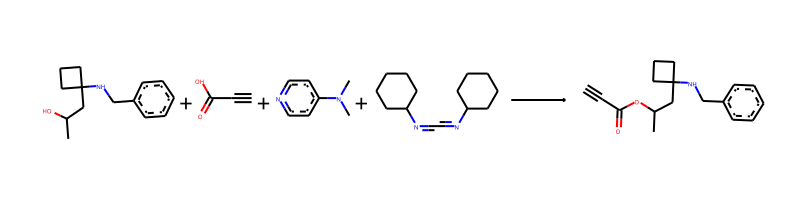

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.C#CC(=O)O.CN(C)c1ccncc1.C(=NC1CCCCC1)=NC1CCCCC1>>C#CC(=O)OC(C)CC1(NCc2ccccc2)CCC1
The fast filter score is 0.180476099


--------------------------------------------------

Train index: 13778
RANK 51 PRECEDENT
REACTANT MATCH SCORE: 0.5660377358490566


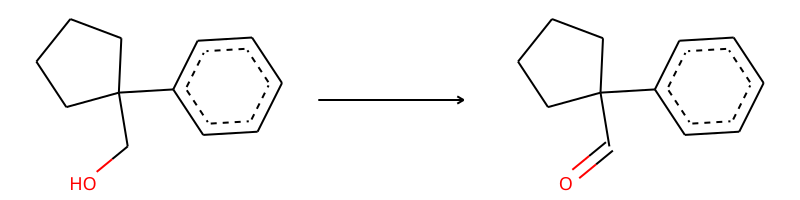

-> template: [C:1]-[CH2;D2;+0:2]-[OH;D1;+0:3]>>[C:1]-[CH;D2;+0:2]=[O;H0;D1;+0:3]


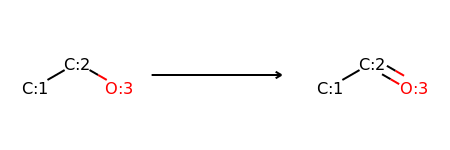

->No precursors could be generated!


--------------------------------------------------

Train index: 132389
RANK 52 PRECEDENT
REACTANT MATCH SCORE: 0.5660377358490566


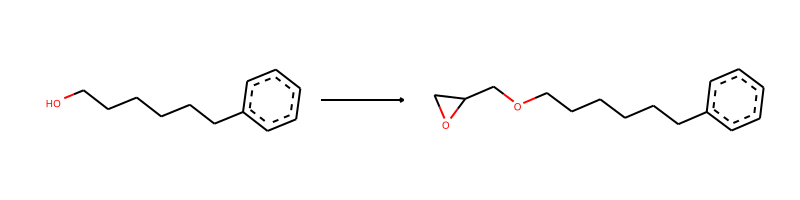

-> template: [C:1]-[OH;D1;+0:2]>>[C:1]-[O;H0;D2;+0:2]-C-C1-C-O-1


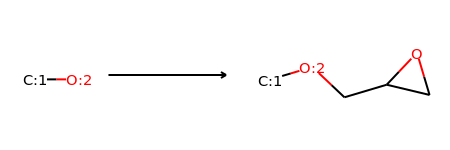

Product similarity 0.6212121212121212, overall 0.35162950257289877, smiles CC(CC1(NCc2ccccc2)CCC1)OCC1CO1


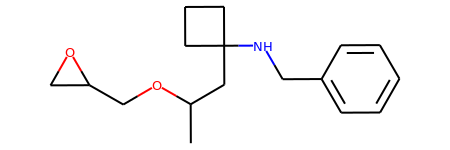

The proposed reaction is:


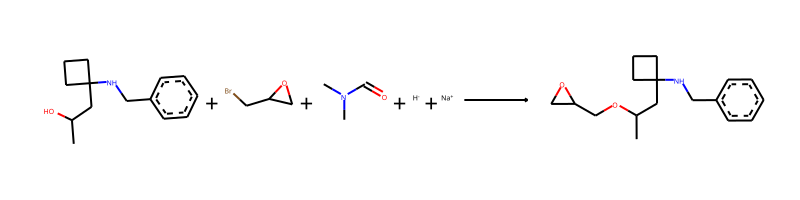

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.BrCC1CO1.CN(C)C=O.[H-].[Na+]>>CC(CC1(NCc2ccccc2)CCC1)OCC1CO1
The fast filter score is 0.981784105


--------------------------------------------------

Train index: 337688
RANK 53 PRECEDENT
REACTANT MATCH SCORE: 0.5660377358490566


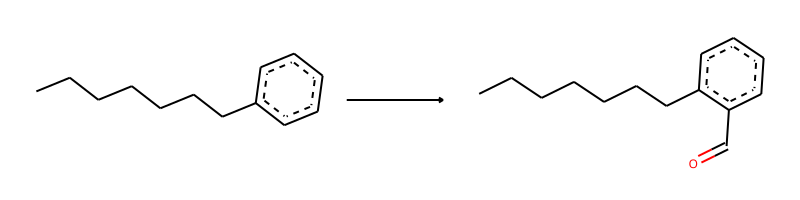

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>O=C-[c;H0;D3;+0:1](:[c:2]):[c:3]


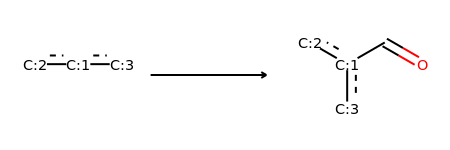

Product similarity 0.5245901639344263, overall 0.2969378286421281, smiles CC(O)CC1(NCc2ccc(C=O)cc2)CCC1


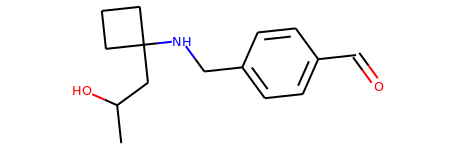

The proposed reaction is:


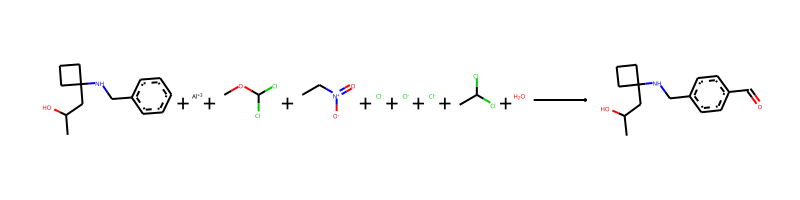

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].COC(Cl)Cl.CC[N+](=O)[O-].[Cl-].[Cl-].[Cl-].CC(Cl)Cl.O>>CC(O)CC1(NCc2ccc(C=O)cc2)CCC1
The fast filter score is 0.575938404
Product similarity 0.603448275862069, overall 0.3415744957709824, smiles CC(O)CC1(NCc2ccccc2C=O)CCC1


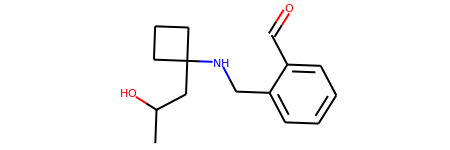

The proposed reaction is:


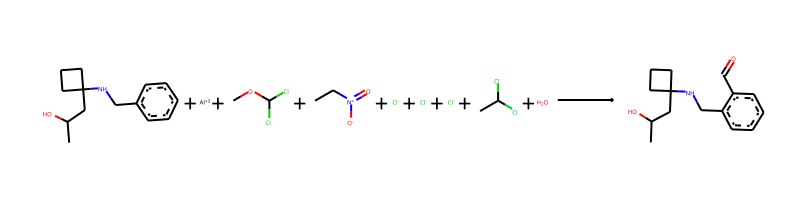

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].COC(Cl)Cl.CC[N+](=O)[O-].[Cl-].[Cl-].[Cl-].CC(Cl)Cl.O>>CC(O)CC1(NCc2ccccc2C=O)CCC1
The fast filter score is 0.152326852
Product similarity 0.55, overall 0.3113207547169812, smiles CC(O)CC1(NCc2cccc(C=O)c2)CCC1


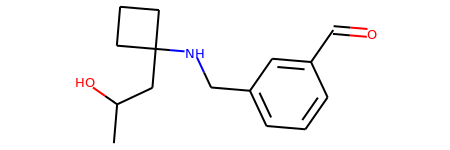

The proposed reaction is:


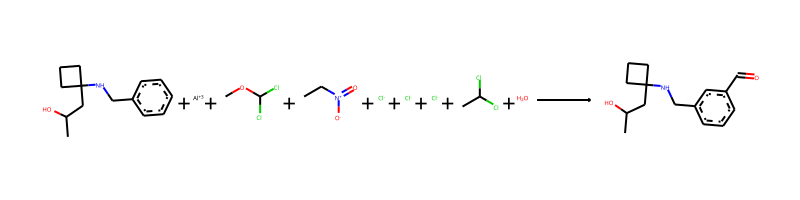

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].COC(Cl)Cl.CC[N+](=O)[O-].[Cl-].[Cl-].[Cl-].CC(Cl)Cl.O>>CC(O)CC1(NCc2cccc(C=O)c2)CCC1
The fast filter score is 0.00738722086


--------------------------------------------------

Train index: 458005
RANK 54 PRECEDENT
REACTANT MATCH SCORE: 0.5660377358490566


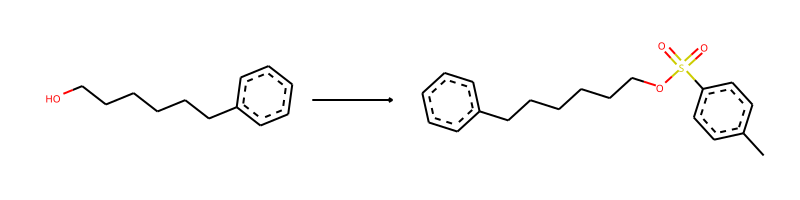

-> template: [C:2]-[OH;D1;+0:1]>>C-c1:c:c:c(-S(=O)(=O)-[O;H0;D2;+0:1]-[C:2]):c:c:1


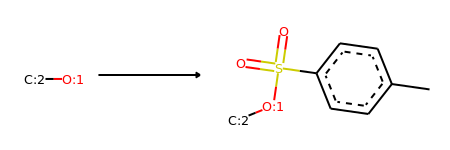

Product similarity 0.6951219512195121, overall 0.393465255407271, smiles Cc1ccc(S(=O)(=O)OC(C)CC2(NCc3ccccc3)CCC2)cc1


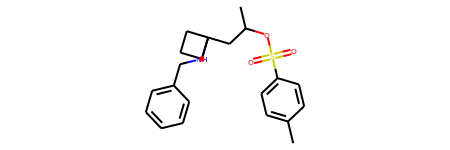

The proposed reaction is:


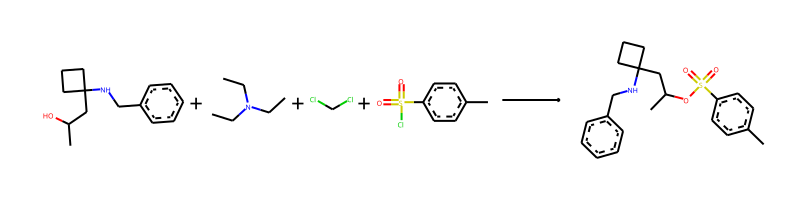

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CCN(CC)CC.ClCCl.Cc1ccc(S(=O)(=O)Cl)cc1>>Cc1ccc(S(=O)(=O)OC(C)CC2(NCc3ccccc3)CCC2)cc1
The fast filter score is 0.997666121


--------------------------------------------------

Train index: 131535
RANK 55 PRECEDENT
REACTANT MATCH SCORE: 0.5660377358490566


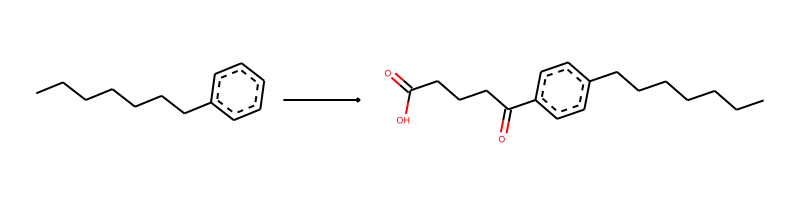

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>O-C(=O)-C-C-C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]


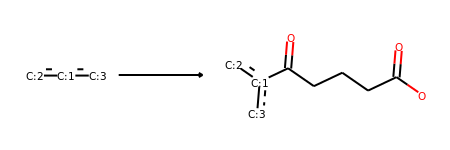

Product similarity 0.6233766233766234, overall 0.352854692477334, smiles CC(O)CC1(NCc2ccccc2C(=O)CCCC(=O)O)CCC1


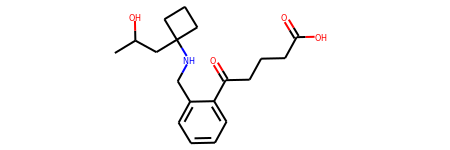

The proposed reaction is:


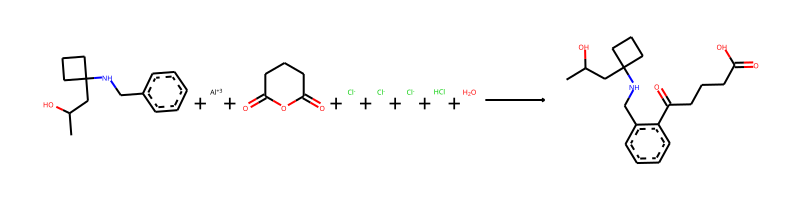

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].O=C1CCCC(=O)O1.[Cl-].[Cl-].[Cl-].Cl.O>>CC(O)CC1(NCc2ccccc2C(=O)CCCC(=O)O)CCC1
The fast filter score is 0.617663324
Product similarity 0.6891891891891891, overall 0.3901070882202957, smiles CC(O)CC1(NCc2ccc(C(=O)CCCC(=O)O)cc2)CCC1


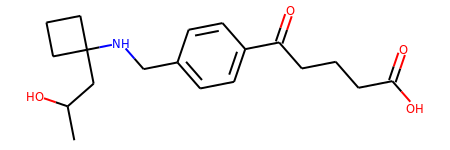

The proposed reaction is:


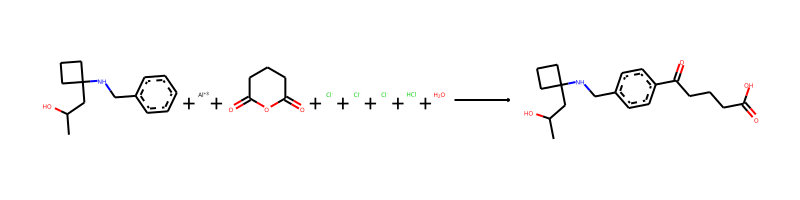

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].O=C1CCCC(=O)O1.[Cl-].[Cl-].[Cl-].Cl.O>>CC(O)CC1(NCc2ccc(C(=O)CCCC(=O)O)cc2)CCC1
The fast filter score is 0.988553047
Product similarity 0.6447368421052632, overall 0.36494538232373386, smiles CC(O)CC1(NCc2cccc(C(=O)CCCC(=O)O)c2)CCC1


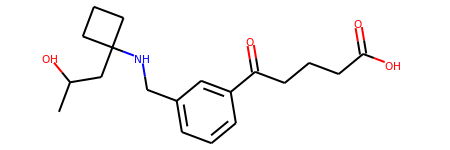

The proposed reaction is:


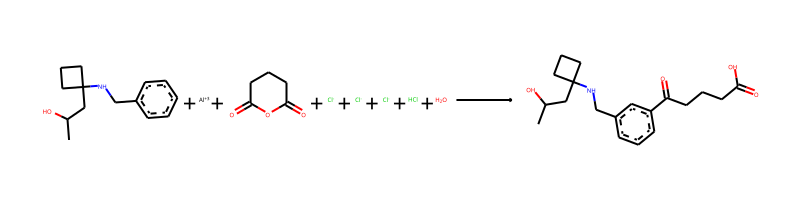

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].O=C1CCCC(=O)O1.[Cl-].[Cl-].[Cl-].Cl.O>>CC(O)CC1(NCc2cccc(C(=O)CCCC(=O)O)c2)CCC1
The fast filter score is 0.318477809


--------------------------------------------------

Train index: 211925
RANK 56 PRECEDENT
REACTANT MATCH SCORE: 0.5660377358490566


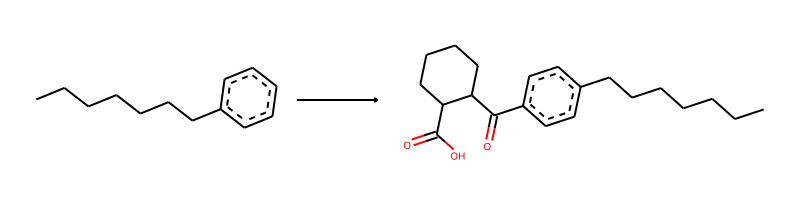

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>O-C(=O)-C1-C-C-C-C-C-1-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]


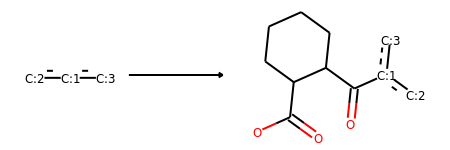

Product similarity 0.7228915662650602, overall 0.40918390543305294, smiles CC(O)CC1(NCc2ccc(C(=O)C3CCCCC3C(=O)O)cc2)CCC1


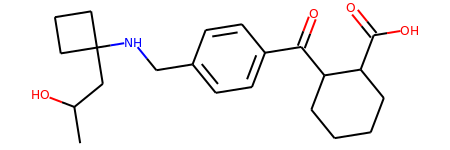

The proposed reaction is:


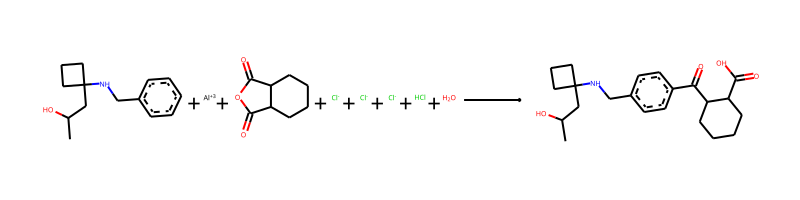

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].O=C1OC(=O)C2CCCCC12.[Cl-].[Cl-].[Cl-].Cl.O>>CC(O)CC1(NCc2ccc(C(=O)C3CCCCC3C(=O)O)cc2)CCC1
The fast filter score is 0.0994940698
Product similarity 0.6823529411764706, overall 0.38623751387347394, smiles CC(O)CC1(NCc2cccc(C(=O)C3CCCCC3C(=O)O)c2)CCC1


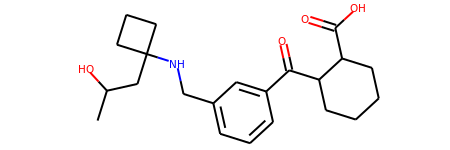

The proposed reaction is:


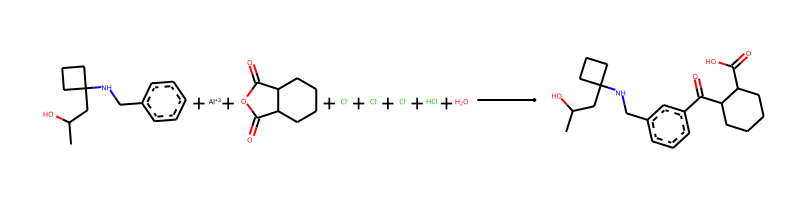

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].O=C1OC(=O)C2CCCCC12.[Cl-].[Cl-].[Cl-].Cl.O>>CC(O)CC1(NCc2cccc(C(=O)C3CCCCC3C(=O)O)c2)CCC1
The fast filter score is 0.0348258317
Product similarity 0.6627906976744186, overall 0.37516454585344444, smiles CC(O)CC1(NCc2ccccc2C(=O)C2CCCCC2C(=O)O)CCC1


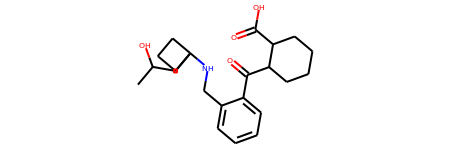

The proposed reaction is:


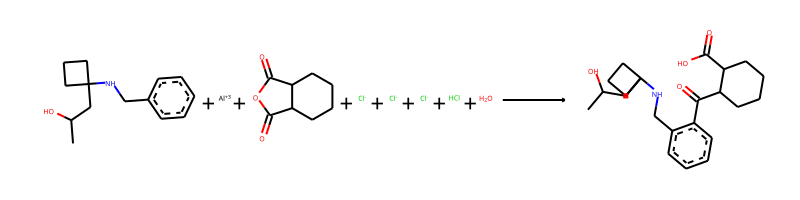

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].O=C1OC(=O)C2CCCCC12.[Cl-].[Cl-].[Cl-].Cl.O>>CC(O)CC1(NCc2ccccc2C(=O)C2CCCCC2C(=O)O)CCC1
The fast filter score is 6.31076473e-05


--------------------------------------------------

Train index: 92750
RANK 57 PRECEDENT
REACTANT MATCH SCORE: 0.5660377358490566


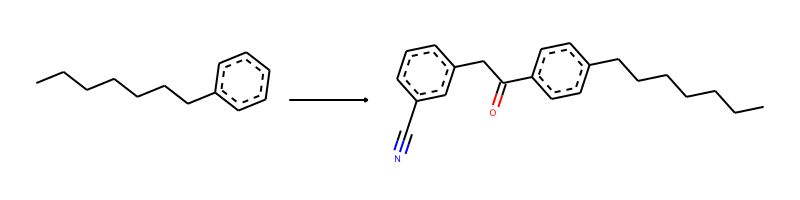

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>N#C-c1:c:c:c:c(-C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]):c:1


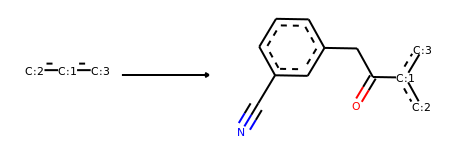

Product similarity 0.686046511627907, overall 0.3883282141290039, smiles CC(O)CC1(NCc2cccc(C(=O)Cc3cccc(C#N)c3)c2)CCC1


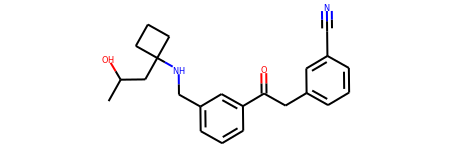

The proposed reaction is:


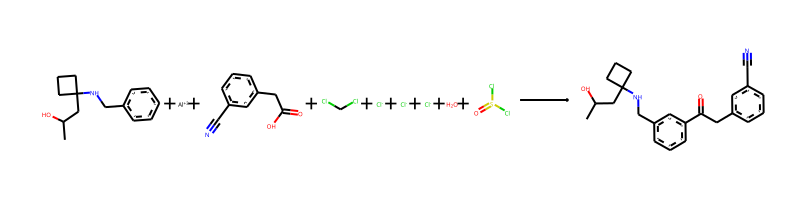

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].N#Cc1cccc(CC(=O)O)c1.ClCCl.[Cl-].[Cl-].[Cl-].O.O=S(Cl)Cl>>CC(O)CC1(NCc2cccc(C(=O)Cc3cccc(C#N)c3)c2)CCC1
The fast filter score is 0.99691546
Product similarity 0.6666666666666666, overall 0.3773584905660377, smiles CC(O)CC1(NCc2ccccc2C(=O)Cc2cccc(C#N)c2)CCC1


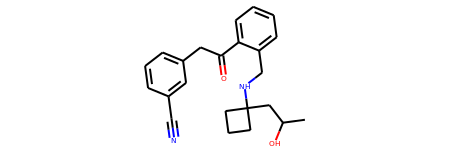

The proposed reaction is:


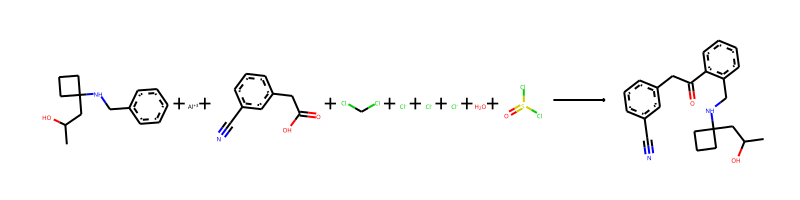

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].N#Cc1cccc(CC(=O)O)c1.ClCCl.[Cl-].[Cl-].[Cl-].O.O=S(Cl)Cl>>CC(O)CC1(NCc2ccccc2C(=O)Cc2cccc(C#N)c2)CCC1
The fast filter score is 0.999468327
Product similarity 0.7261904761904762, overall 0.41105121293800534, smiles CC(O)CC1(NCc2ccc(C(=O)Cc3cccc(C#N)c3)cc2)CCC1


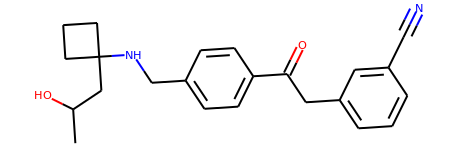

The proposed reaction is:


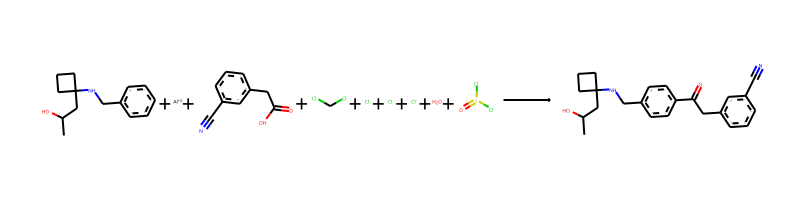

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].N#Cc1cccc(CC(=O)O)c1.ClCCl.[Cl-].[Cl-].[Cl-].O.O=S(Cl)Cl>>CC(O)CC1(NCc2ccc(C(=O)Cc3cccc(C#N)c3)cc2)CCC1
The fast filter score is 0.995438218


--------------------------------------------------

Train index: 400375
RANK 58 PRECEDENT
REACTANT MATCH SCORE: 0.5660377358490566


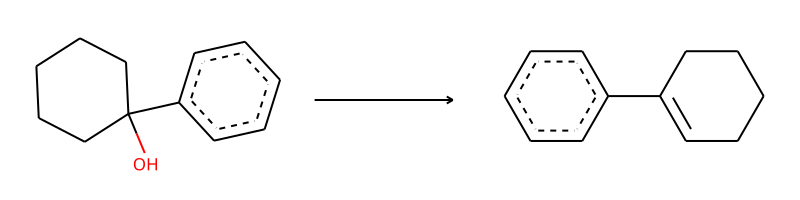

-> template: [C:1]-[C;H0;D4;+0:2](-[O;H1;D1;+0])(-[c:3])-[CH2;D2;+0:4]-[C:5]>>[C:1]-[C;H0;D3;+0:2](-[c:3])=[CH;D2;+0:4]-[C:5]


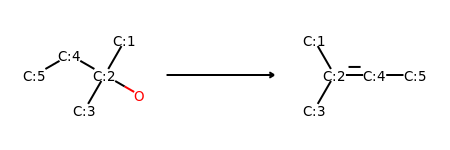

->No precursors could be generated!


--------------------------------------------------

Train index: 67016
RANK 59 PRECEDENT
REACTANT MATCH SCORE: 0.5660377358490566


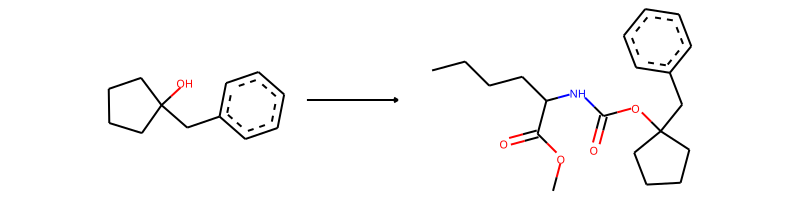

-> template: [C:3]-[C:2](-[C:4])(-[C:5])-[OH;D1;+0:1]>>C-C-C-C-C(-N-C(=O)-[O;H0;D2;+0:1]-[C:2](-[C:3])(-[C:4])-[C:5])-C(=O)-O-C


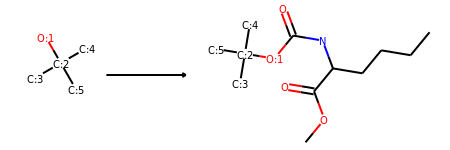

->No precursors could be generated!


--------------------------------------------------

Train index: 310991
RANK 60 PRECEDENT
REACTANT MATCH SCORE: 0.5660377358490566


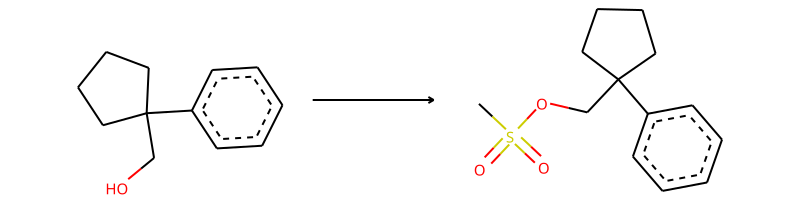

-> template: [C:2]-[OH;D1;+0:1]>>C-S(=O)(=O)-[O;H0;D2;+0:1]-[C:2]


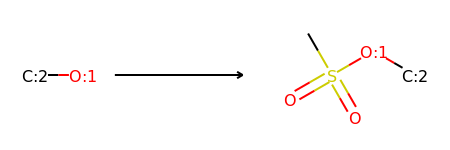

Product similarity 0.609375, overall 0.3449292452830189, smiles CC(CC1(NCc2ccccc2)CCC1)OS(C)(=O)=O


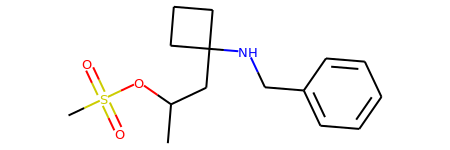

The proposed reaction is:


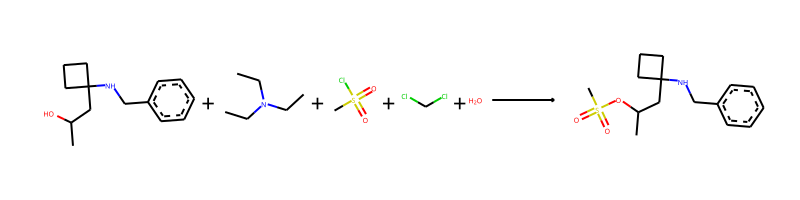

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CCN(CC)CC.CS(=O)(=O)Cl.ClCCl.O>>CC(CC1(NCc2ccccc2)CCC1)OS(C)(=O)=O
The fast filter score is 0.982209384


--------------------------------------------------

Train index: 327990
RANK 61 PRECEDENT
REACTANT MATCH SCORE: 0.5652173913043478


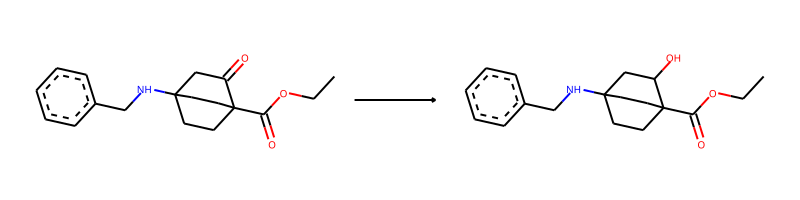

-> template: [#8:1]-[C:2](=[O;D1;H0:3])-[C:4]-[C;H0;D3;+0:5](-[C:6])=[O;H0;D1;+0:7]>>[#8:1]-[C:2](=[O;D1;H0:3])-[C:4]-[CH;D3;+0:5](-[C:6])-[OH;D1;+0:7]


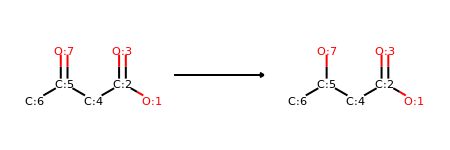

->No precursors could be generated!


--------------------------------------------------

Train index: 398496
RANK 62 PRECEDENT
REACTANT MATCH SCORE: 0.5636363636363636


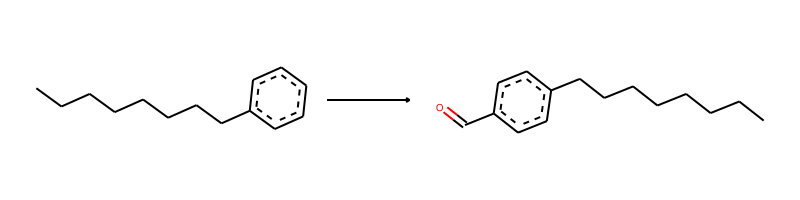

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>O=C-[c;H0;D3;+0:1](:[c:2]):[c:3]


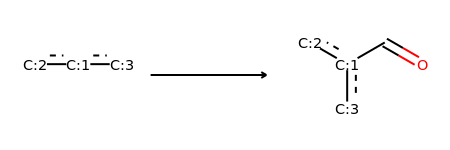

Product similarity 0.6, overall 0.33818181818181814, smiles CC(O)CC1(NCc2ccc(C=O)cc2)CCC1


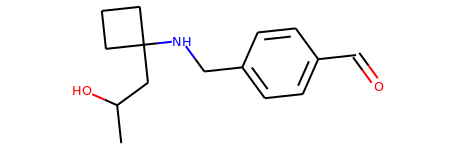

The proposed reaction is:


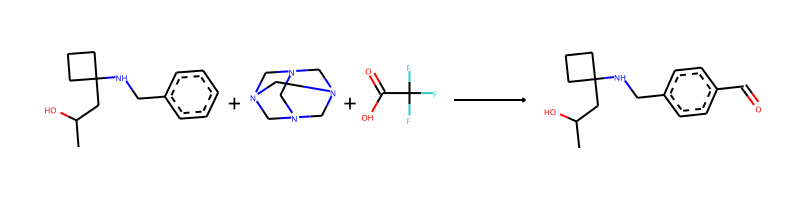

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.C1N2CN3CN1CN(C2)C3.O=C(O)C(F)(F)F>>CC(O)CC1(NCc2ccc(C=O)cc2)CCC1
The fast filter score is 0.0831937194
Product similarity 0.5238095238095238, overall 0.29523809523809524, smiles CC(O)CC1(NCc2ccccc2C=O)CCC1


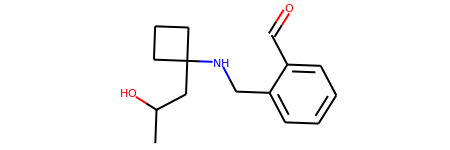

The proposed reaction is:


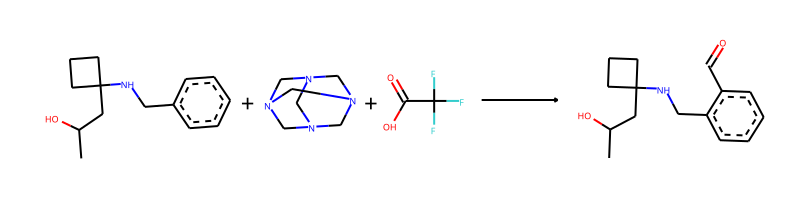

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.C1N2CN3CN1CN(C2)C3.O=C(O)C(F)(F)F>>CC(O)CC1(NCc2ccccc2C=O)CCC1
The fast filter score is 0.193693161
Product similarity 0.5483870967741935, overall 0.309090909090909, smiles CC(O)CC1(NCc2cccc(C=O)c2)CCC1


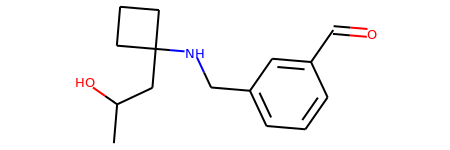

The proposed reaction is:


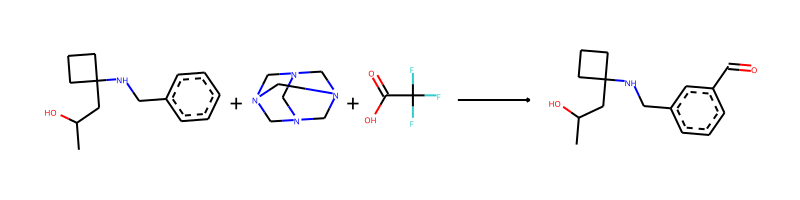

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.C1N2CN3CN1CN(C2)C3.O=C(O)C(F)(F)F>>CC(O)CC1(NCc2cccc(C=O)c2)CCC1
The fast filter score is 0.00203174353


--------------------------------------------------

Train index: 58123
RANK 63 PRECEDENT
REACTANT MATCH SCORE: 0.5636363636363636


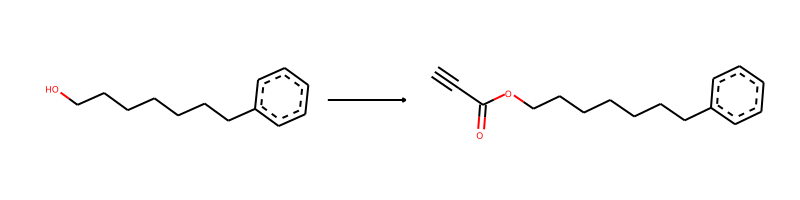

-> template: [C:2]-[OH;D1;+0:1]>>C#C-C(=O)-[O;H0;D2;+0:1]-[C:2]


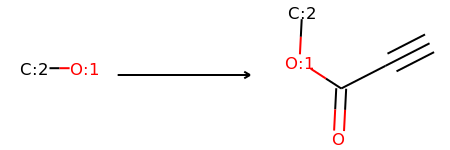

Product similarity 0.6119402985074627, overall 0.3449118046132971, smiles C#CC(=O)OC(C)CC1(NCc2ccccc2)CCC1


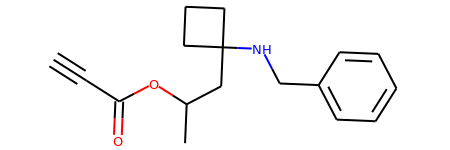

The proposed reaction is:


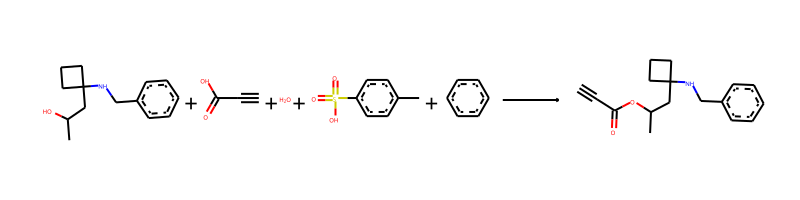

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.C#CC(=O)O.O.Cc1ccc(S(=O)(=O)O)cc1.c1ccccc1>>C#CC(=O)OC(C)CC1(NCc2ccccc2)CCC1
The fast filter score is 0.981814504


--------------------------------------------------

Train index: 219532
RANK 64 PRECEDENT
REACTANT MATCH SCORE: 0.5636363636363636


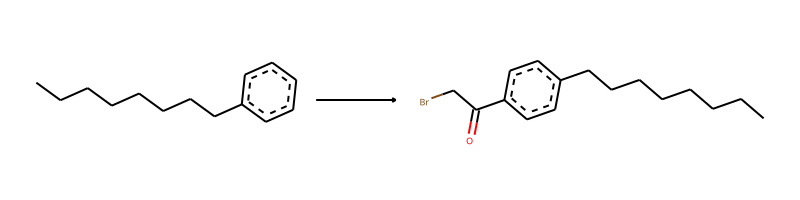

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>Br-C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]


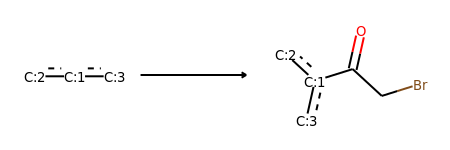

Product similarity 0.582089552238806, overall 0.3280868385345997, smiles CC(O)CC1(NCc2cccc(C(=O)CBr)c2)CCC1


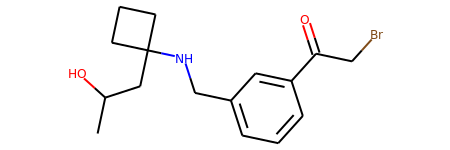

The proposed reaction is:


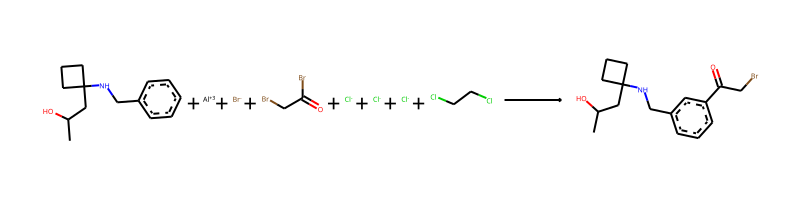

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].[Br-].O=C(Br)CBr.[Cl-].[Cl-].[Cl-].ClCCCl>>CC(O)CC1(NCc2cccc(C(=O)CBr)c2)CCC1
The fast filter score is 0.132385224
Product similarity 0.6307692307692307, overall 0.35552447552447547, smiles CC(O)CC1(NCc2ccc(C(=O)CBr)cc2)CCC1


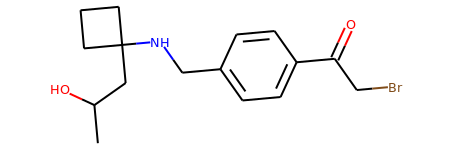

The proposed reaction is:


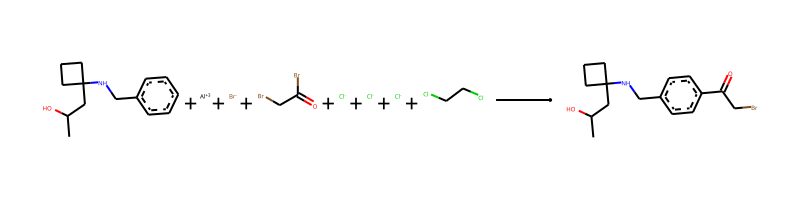

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].[Br-].O=C(Br)CBr.[Cl-].[Cl-].[Cl-].ClCCCl>>CC(O)CC1(NCc2ccc(C(=O)CBr)cc2)CCC1
The fast filter score is 0.0371328
Product similarity 0.5588235294117647, overall 0.31497326203208553, smiles CC(O)CC1(NCc2ccccc2C(=O)CBr)CCC1


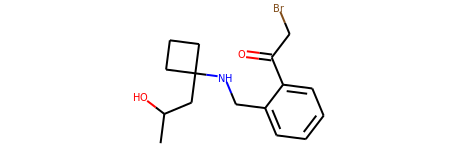

The proposed reaction is:


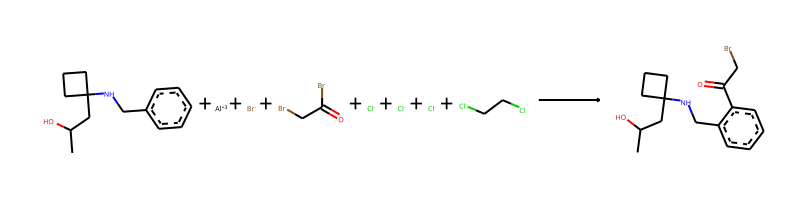

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].[Br-].O=C(Br)CBr.[Cl-].[Cl-].[Cl-].ClCCCl>>CC(O)CC1(NCc2ccccc2C(=O)CBr)CCC1
The fast filter score is 0.000201255083


--------------------------------------------------

Train index: 357926
RANK 65 PRECEDENT
REACTANT MATCH SCORE: 0.5636363636363636


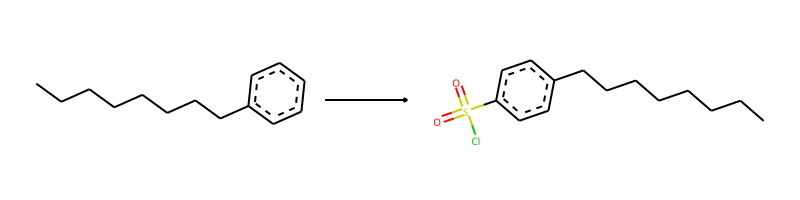

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>Cl-S(=O)(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]


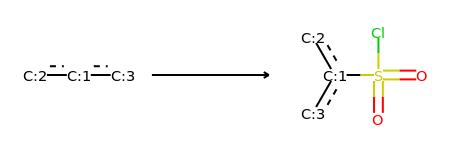

Product similarity 0.625, overall 0.35227272727272724, smiles CC(O)CC1(NCc2ccc(S(=O)(=O)Cl)cc2)CCC1


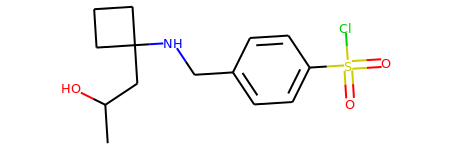

The proposed reaction is:


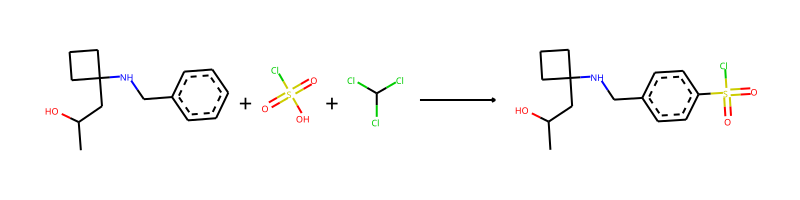

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.O=S(=O)(O)Cl.ClC(Cl)Cl>>CC(O)CC1(NCc2ccc(S(=O)(=O)Cl)cc2)CCC1
The fast filter score is 0.309603155
Product similarity 0.5757575757575758, overall 0.3245179063360882, smiles CC(O)CC1(NCc2cccc(S(=O)(=O)Cl)c2)CCC1


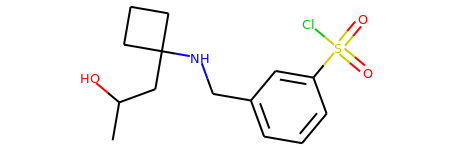

The proposed reaction is:


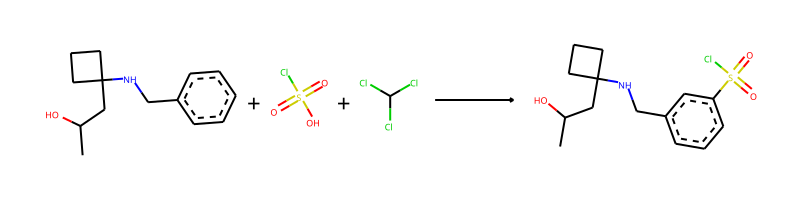

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.O=S(=O)(O)Cl.ClC(Cl)Cl>>CC(O)CC1(NCc2cccc(S(=O)(=O)Cl)c2)CCC1
The fast filter score is 0.529639184
Product similarity 0.5522388059701493, overall 0.3112618724559023, smiles CC(O)CC1(NCc2ccccc2S(=O)(=O)Cl)CCC1


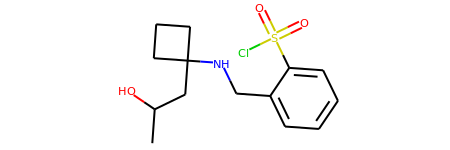

The proposed reaction is:


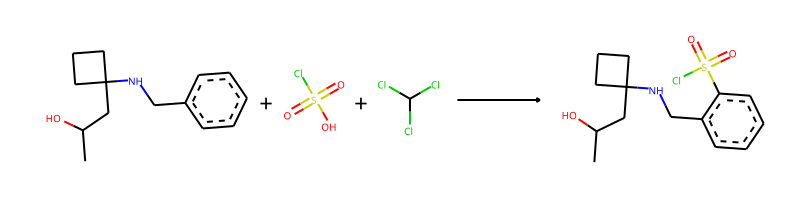

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.O=S(=O)(O)Cl.ClC(Cl)Cl>>CC(O)CC1(NCc2ccccc2S(=O)(=O)Cl)CCC1
The fast filter score is 0.34713614


--------------------------------------------------

Train index: 52301
RANK 66 PRECEDENT
REACTANT MATCH SCORE: 0.5636363636363636


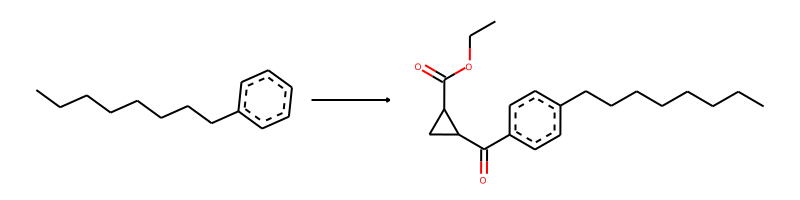

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>C-C-O-C(=O)-C1-C-C-1-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]


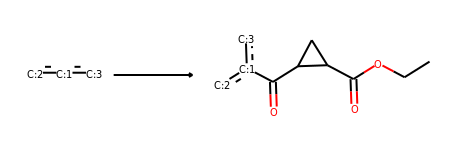

Product similarity 0.6470588235294118, overall 0.36470588235294116, smiles CCOC(=O)C1CC1C(=O)c1ccccc1CNC1(CC(C)O)CCC1


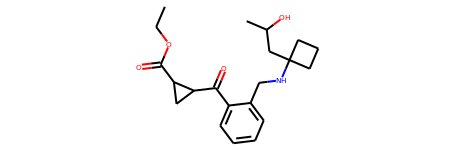

The proposed reaction is:


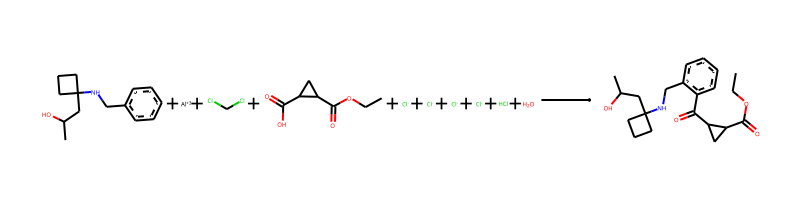

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].ClCCl.CCOC(=O)C1CC1C(=O)O.[Cl-].[Cl-].[Cl-].[Cl-].Cl.O>>CCOC(=O)C1CC1C(=O)c1ccccc1CNC1(CC(C)O)CCC1
The fast filter score is 0.317661345
Product similarity 0.7073170731707317, overall 0.3986696230598669, smiles CCOC(=O)C1CC1C(=O)c1ccc(CNC2(CC(C)O)CCC2)cc1


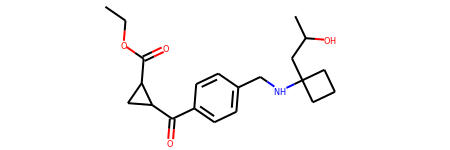

The proposed reaction is:


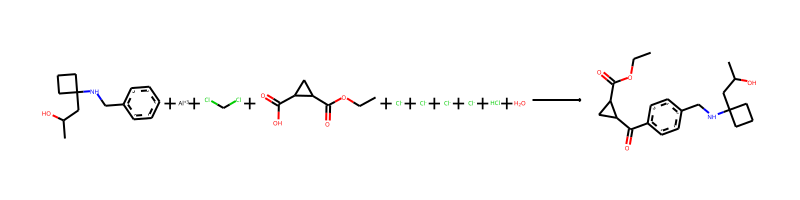

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].ClCCl.CCOC(=O)C1CC1C(=O)O.[Cl-].[Cl-].[Cl-].[Cl-].Cl.O>>CCOC(=O)C1CC1C(=O)c1ccc(CNC2(CC(C)O)CCC2)cc1
The fast filter score is 0.627037764
Product similarity 0.6666666666666666, overall 0.37575757575757573, smiles CCOC(=O)C1CC1C(=O)c1cccc(CNC2(CC(C)O)CCC2)c1


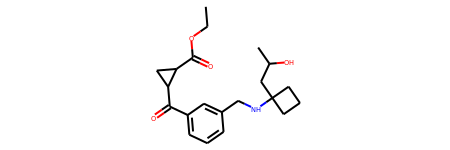

The proposed reaction is:


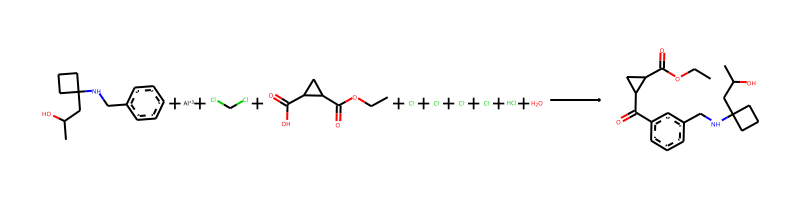

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].ClCCl.CCOC(=O)C1CC1C(=O)O.[Cl-].[Cl-].[Cl-].[Cl-].Cl.O>>CCOC(=O)C1CC1C(=O)c1cccc(CNC2(CC(C)O)CCC2)c1
The fast filter score is 0.885440528


--------------------------------------------------

Train index: 78125
RANK 67 PRECEDENT
REACTANT MATCH SCORE: 0.5636363636363636


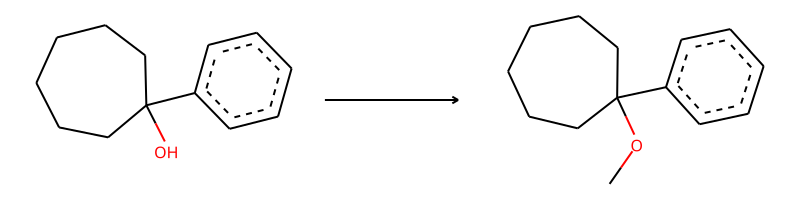

-> template: [C:2]-[OH;D1;+0:1]>>C-[O;H0;D2;+0:1]-[C:2]


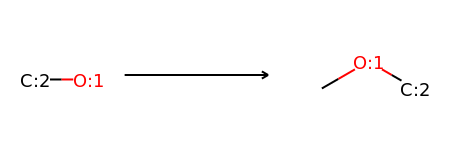

Product similarity 0.559322033898305, overall 0.31525423728813556, smiles COC(C)CC1(NCc2ccccc2)CCC1


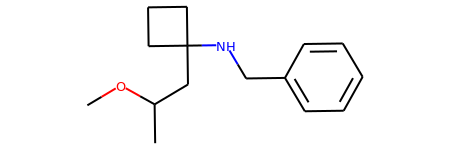

The proposed reaction is:


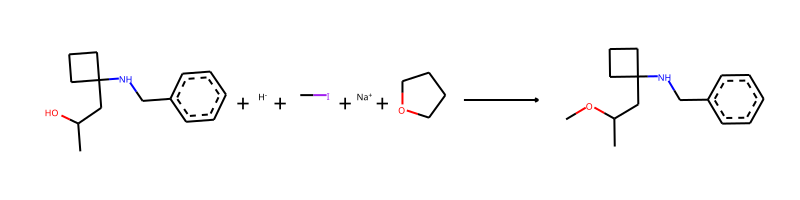

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[H-].CI.[Na+].C1CCOC1>>COC(C)CC1(NCc2ccccc2)CCC1
The fast filter score is 0.993847132


--------------------------------------------------

Train index: 469001
RANK 68 PRECEDENT
REACTANT MATCH SCORE: 0.5636363636363636


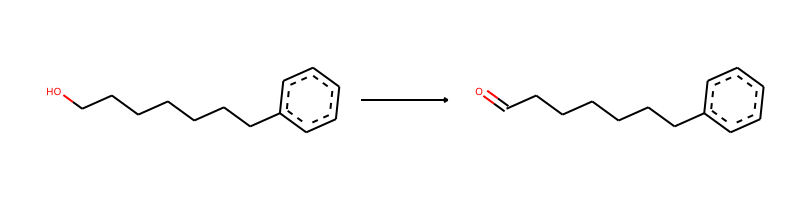

-> template: [C:1]-[CH2;D2;+0:2]-[OH;D1;+0:3]>>[C:1]-[CH;D2;+0:2]=[O;H0;D1;+0:3]


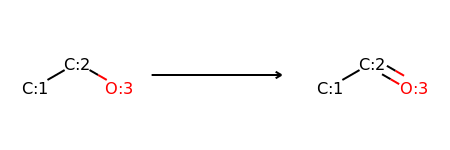

->No precursors could be generated!


--------------------------------------------------

Train index: 89293
RANK 69 PRECEDENT
REACTANT MATCH SCORE: 0.5636363636363636


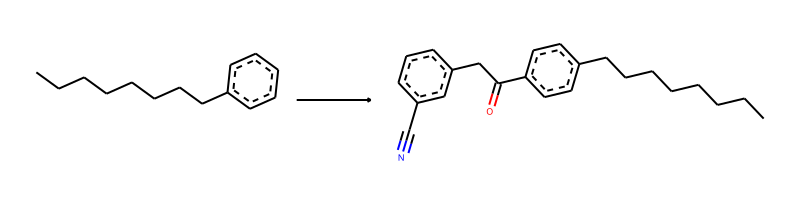

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>N#C-c1:c:c:c:c(-C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]):c:1


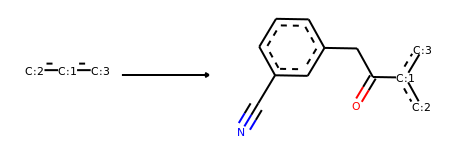

Product similarity 0.6818181818181818, overall 0.38429752066115697, smiles CC(O)CC1(NCc2cccc(C(=O)Cc3cccc(C#N)c3)c2)CCC1


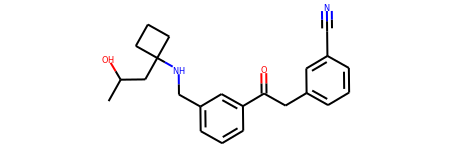

The proposed reaction is:


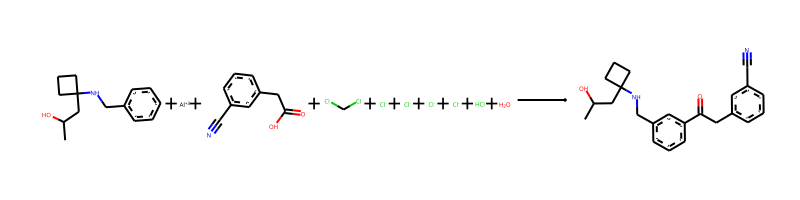

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].N#Cc1cccc(CC(=O)O)c1.ClCCl.[Cl-].[Cl-].[Cl-].[Cl-].Cl.O>>CC(O)CC1(NCc2cccc(C(=O)Cc3cccc(C#N)c3)c2)CCC1
The fast filter score is 0.998211503
Product similarity 0.6629213483146067, overall 0.37364657814096014, smiles CC(O)CC1(NCc2ccccc2C(=O)Cc2cccc(C#N)c2)CCC1


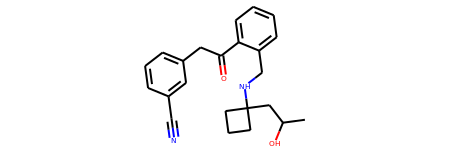

The proposed reaction is:


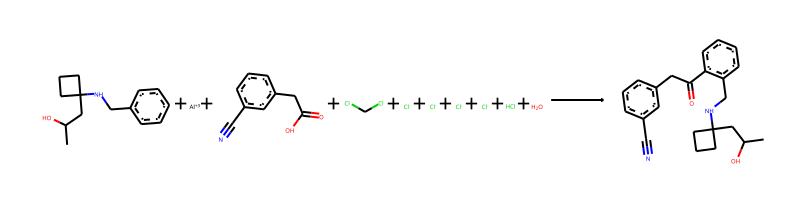

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].N#Cc1cccc(CC(=O)O)c1.ClCCl.[Cl-].[Cl-].[Cl-].[Cl-].Cl.O>>CC(O)CC1(NCc2ccccc2C(=O)Cc2cccc(C#N)c2)CCC1
The fast filter score is 0.999010921
Product similarity 0.7209302325581395, overall 0.40634249471458767, smiles CC(O)CC1(NCc2ccc(C(=O)Cc3cccc(C#N)c3)cc2)CCC1


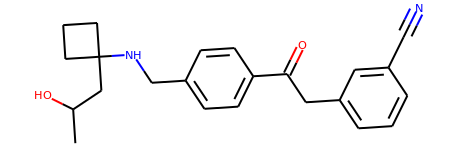

The proposed reaction is:


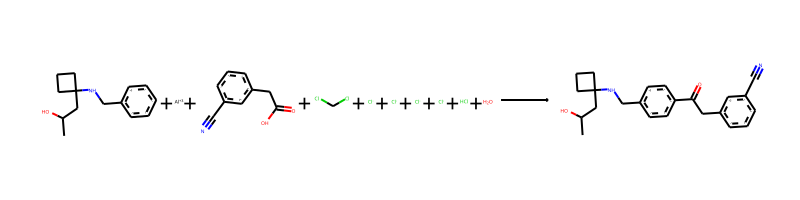

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].N#Cc1cccc(CC(=O)O)c1.ClCCl.[Cl-].[Cl-].[Cl-].[Cl-].Cl.O>>CC(O)CC1(NCc2ccc(C(=O)Cc3cccc(C#N)c3)cc2)CCC1
The fast filter score is 0.998108387


--------------------------------------------------

Train index: 463598
RANK 70 PRECEDENT
REACTANT MATCH SCORE: 0.5636363636363636


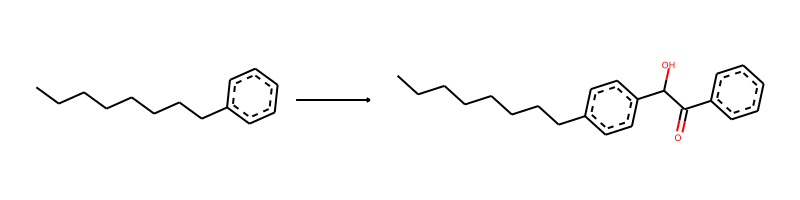

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>O-C(-C(=O)-c1:c:c:c:c:c:1)-[c;H0;D3;+0:1](:[c:2]):[c:3]


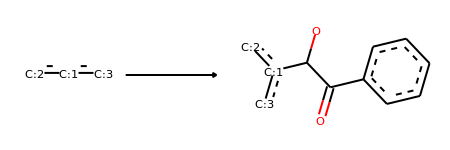

Product similarity 0.6705882352941176, overall 0.37796791443850264, smiles CC(O)CC1(NCc2cccc(C(O)C(=O)c3ccccc3)c2)CCC1


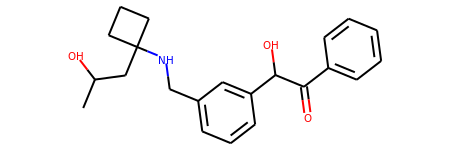

The proposed reaction is:


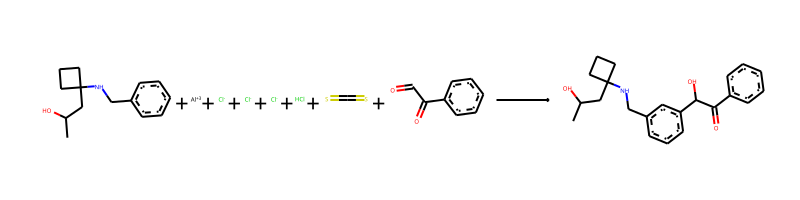

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].[Cl-].[Cl-].[Cl-].Cl.S=C=S.O=CC(=O)c1ccccc1>>CC(O)CC1(NCc2cccc(C(O)C(=O)c3ccccc3)c2)CCC1
The fast filter score is 0.0860677361
Product similarity 0.6511627906976745, overall 0.3670190274841438, smiles CC(O)CC1(NCc2ccccc2C(O)C(=O)c2ccccc2)CCC1


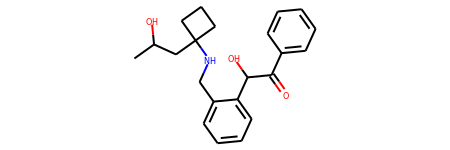

The proposed reaction is:


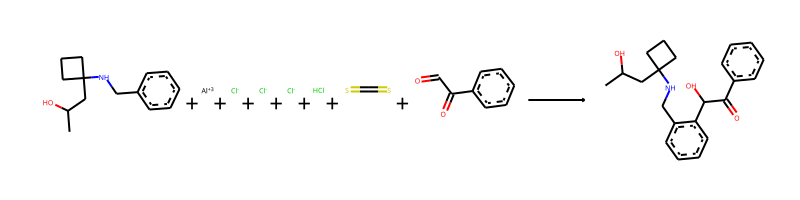

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].[Cl-].[Cl-].[Cl-].Cl.S=C=S.O=CC(=O)c1ccccc1>>CC(O)CC1(NCc2ccccc2C(O)C(=O)c2ccccc2)CCC1
The fast filter score is 0.0633960068
Product similarity 0.7108433734939759, overall 0.40065717415115, smiles CC(O)CC1(NCc2ccc(C(O)C(=O)c3ccccc3)cc2)CCC1


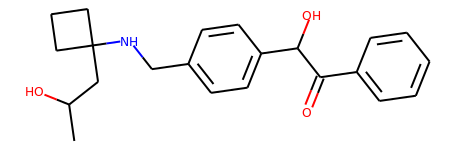

The proposed reaction is:


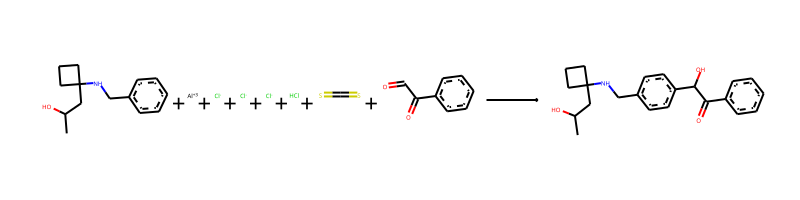

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].[Cl-].[Cl-].[Cl-].Cl.S=C=S.O=CC(=O)c1ccccc1>>CC(O)CC1(NCc2ccc(C(O)C(=O)c3ccccc3)cc2)CCC1
The fast filter score is 0.122272044


--------------------------------------------------

Train index: 108376
RANK 71 PRECEDENT
REACTANT MATCH SCORE: 0.5636363636363636


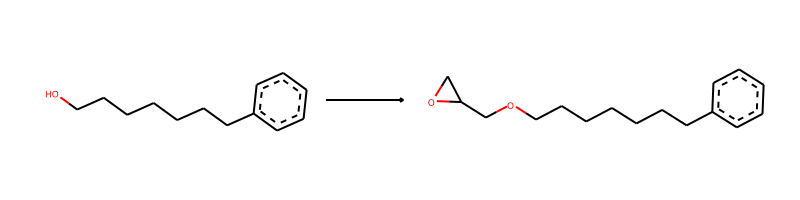

-> template: [C:1]-[OH;D1;+0:2]>>[C:1]-[O;H0;D2;+0:2]-C-C1-C-O-1


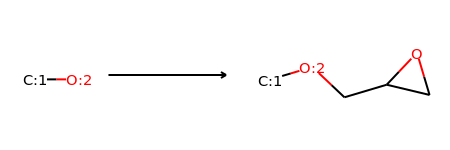

Product similarity 0.6176470588235294, overall 0.3481283422459893, smiles CC(CC1(NCc2ccccc2)CCC1)OCC1CO1


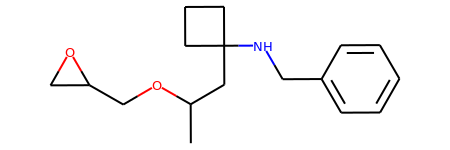

The proposed reaction is:


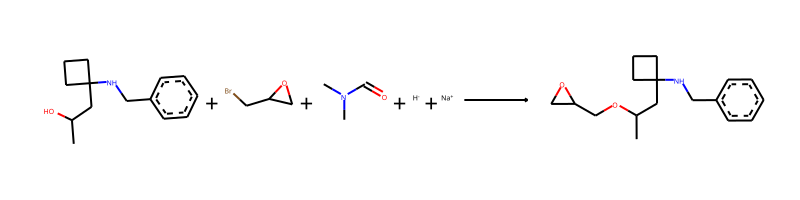

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.BrCC1CO1.CN(C)C=O.[H-].[Na+]>>CC(CC1(NCc2ccccc2)CCC1)OCC1CO1
The fast filter score is 0.981784105


--------------------------------------------------

Train index: 387461
RANK 72 PRECEDENT
REACTANT MATCH SCORE: 0.5636363636363636


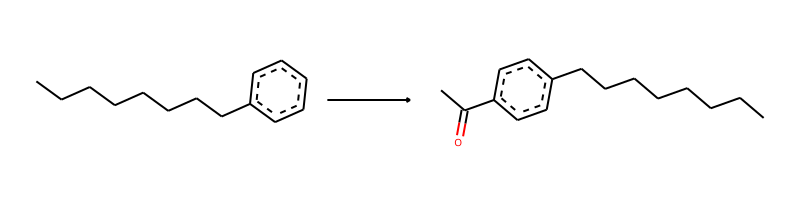

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]


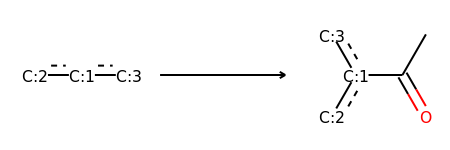

Product similarity 0.5625, overall 0.3170454545454545, smiles CC(=O)c1cccc(CNC2(CC(C)O)CCC2)c1


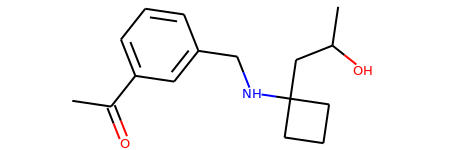

The proposed reaction is:


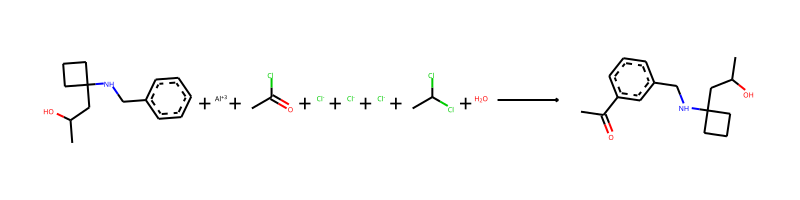

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].CC(=O)Cl.[Cl-].[Cl-].[Cl-].CC(Cl)Cl.O>>CC(=O)c1cccc(CNC2(CC(C)O)CCC2)c1
The fast filter score is 0.0448329747
Product similarity 0.5384615384615384, overall 0.3034965034965035, smiles CC(=O)c1ccccc1CNC1(CC(C)O)CCC1


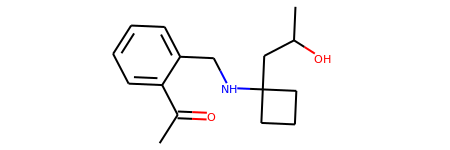

The proposed reaction is:


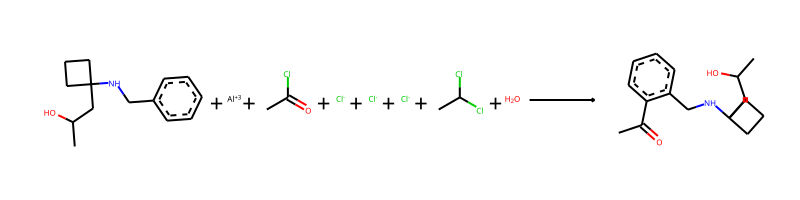

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].CC(=O)Cl.[Cl-].[Cl-].[Cl-].CC(Cl)Cl.O>>CC(=O)c1ccccc1CNC1(CC(C)O)CCC1
The fast filter score is 0.600030482
Product similarity 0.6129032258064516, overall 0.34545454545454546, smiles CC(=O)c1ccc(CNC2(CC(C)O)CCC2)cc1


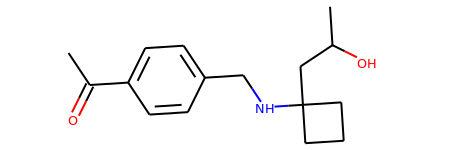

The proposed reaction is:


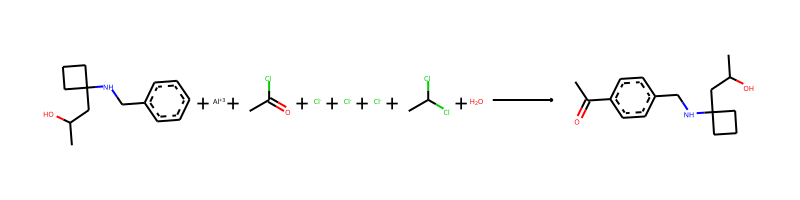

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.[Al+3].CC(=O)Cl.[Cl-].[Cl-].[Cl-].CC(Cl)Cl.O>>CC(=O)c1ccc(CNC2(CC(C)O)CCC2)cc1
The fast filter score is 0.4724347


--------------------------------------------------

Train index: 104975
RANK 73 PRECEDENT
REACTANT MATCH SCORE: 0.5614035087719298


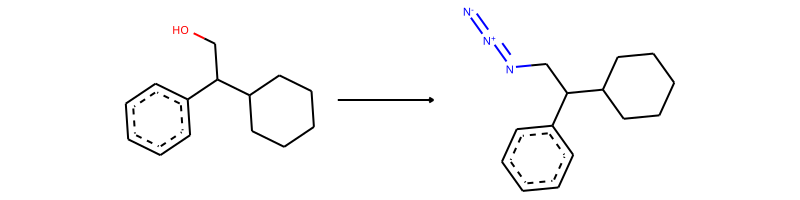

-> template: [C:1]-[CH2;D2;+0:2]-[O;H1;D1;+0]>>[C:1]-[CH2;D2;+0:2]-N=[N+]=[N-]


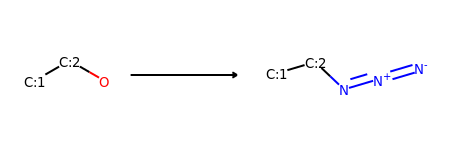

->No precursors could be generated!


--------------------------------------------------

Train index: 64007
RANK 74 PRECEDENT
REACTANT MATCH SCORE: 0.5614035087719298


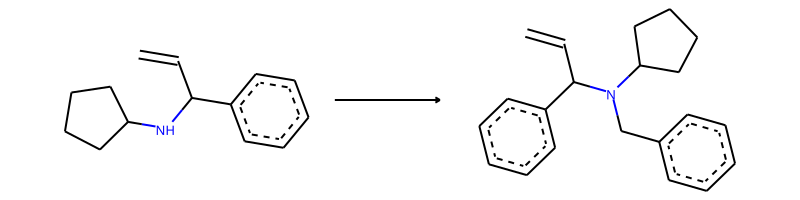

-> template: [C:1]-[NH;D2;+0:2]-[C:3]-[C:4]=[C;D1;H2:5]>>[C:1]-[N;H0;D3;+0:2](-C-c1:c:c:c:c:c:1)-[C:3]-[C:4]=[C;D1;H2:5]


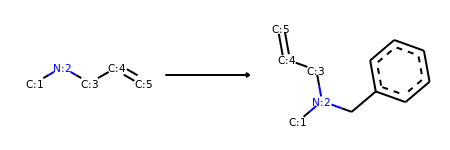

->No precursors could be generated!


--------------------------------------------------

Train index: 8248
RANK 75 PRECEDENT
REACTANT MATCH SCORE: 0.5614035087719298


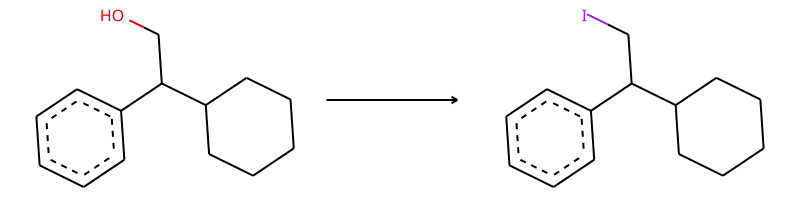

-> template: [C:2]-[CH2;D2;+0:1]-[O;H1;D1;+0]>>I-[CH2;D2;+0:1]-[C:2]


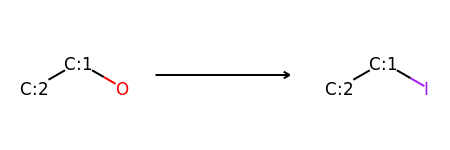

->No precursors could be generated!


--------------------------------------------------

Train index: 185661
RANK 76 PRECEDENT
REACTANT MATCH SCORE: 0.5614035087719298


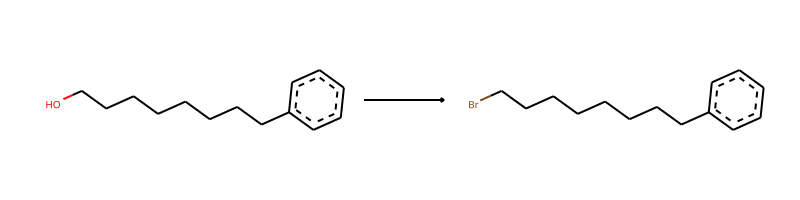

-> template: [C:2]-[CH2;D2;+0:1]-[O;H1;D1;+0]>>Br-[CH2;D2;+0:1]-[C:2]


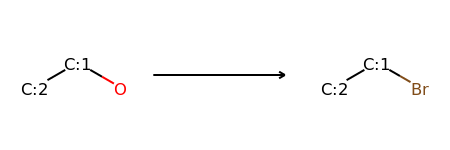

->No precursors could be generated!


--------------------------------------------------

Train index: 247025
RANK 77 PRECEDENT
REACTANT MATCH SCORE: 0.5614035087719298


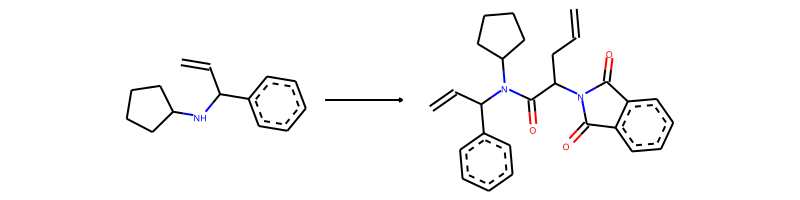

-> template: [C:2]-[NH;D2;+0:1]-[C:3]-[C:4]=[C;D1;H2:5]>>C=C-C-C(-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]-[C:4]=[C;D1;H2:5])-N1-C(=O)-c2:c:c:c:c:c:2-C-1=O


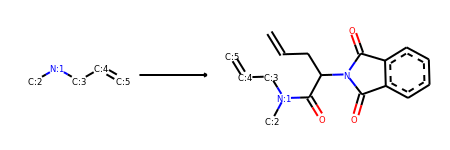

->No precursors could be generated!


--------------------------------------------------

Train index: 368951
RANK 78 PRECEDENT
REACTANT MATCH SCORE: 0.559322033898305


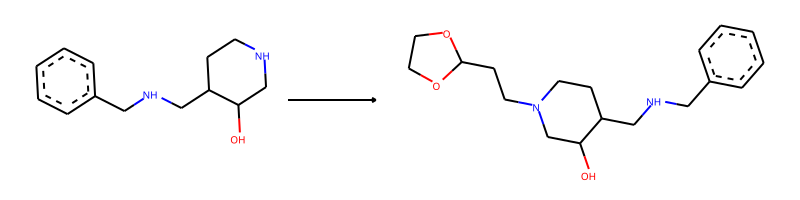

-> template: [C:1]-[NH;D2;+0:2]-[C:3]>>[C:1]-[N;H0;D3;+0:2](-[C:3])-C-C-C1-O-C-C-O-1


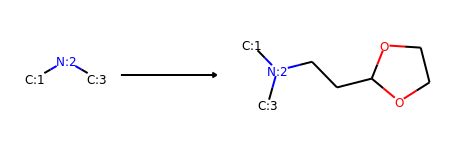

Product similarity 0.6144578313253012, overall 0.34367980396160913, smiles CC(O)CC1(N(CCC2OCCO2)Cc2ccccc2)CCC1


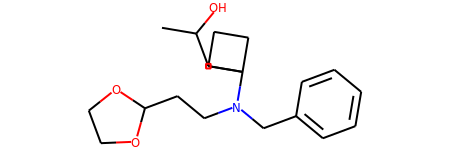

The proposed reaction is:


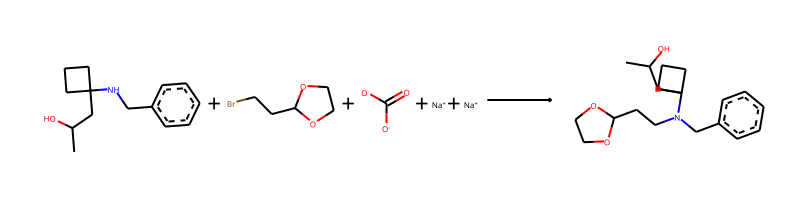

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.BrCCC1OCCO1.O=C([O-])[O-].[Na+].[Na+]>>CC(O)CC1(N(CCC2OCCO2)Cc2ccccc2)CCC1
The fast filter score is 0.565905213


--------------------------------------------------

Train index: 475949
RANK 79 PRECEDENT
REACTANT MATCH SCORE: 0.559322033898305


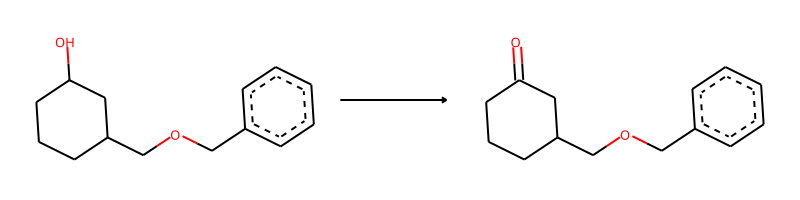

-> template: [C:1]-[CH;D3;+0:2](-[C:3])-[OH;D1;+0:4]>>[C:1]-[C;H0;D3;+0:2](-[C:3])=[O;H0;D1;+0:4]


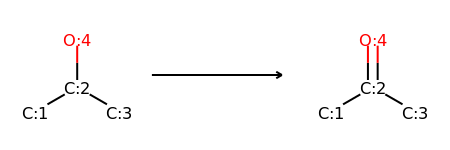

Product similarity 0.559322033898305, overall 0.3128411376041367, smiles CC(=O)CC1(NCc2ccccc2)CCC1


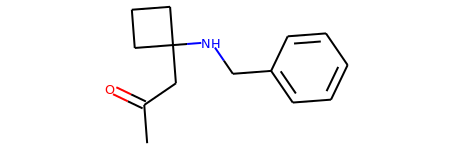

The proposed reaction is:


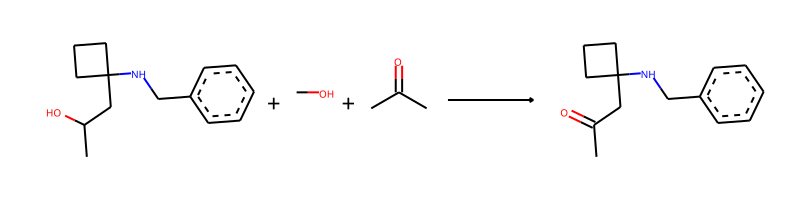

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CO.CC(C)=O>>CC(=O)CC1(NCc2ccccc2)CCC1
The fast filter score is 0.455824435


--------------------------------------------------

Train index: 397762
RANK 80 PRECEDENT
REACTANT MATCH SCORE: 0.559322033898305


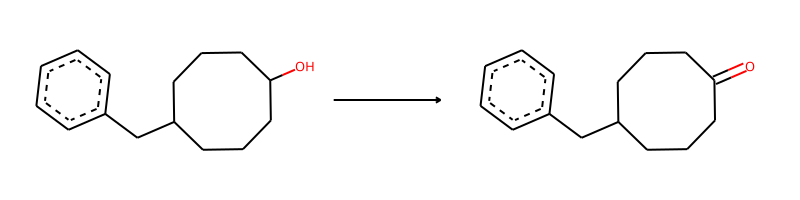

-> template: [C:1]-[CH;D3;+0:2](-[C:3])-[OH;D1;+0:4]>>[C:1]-[C;H0;D3;+0:2](-[C:3])=[O;H0;D1;+0:4]


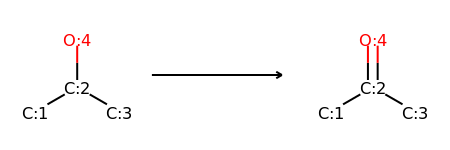

Product similarity 0.559322033898305, overall 0.3128411376041367, smiles CC(=O)CC1(NCc2ccccc2)CCC1


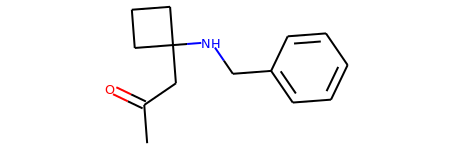

The proposed reaction is:


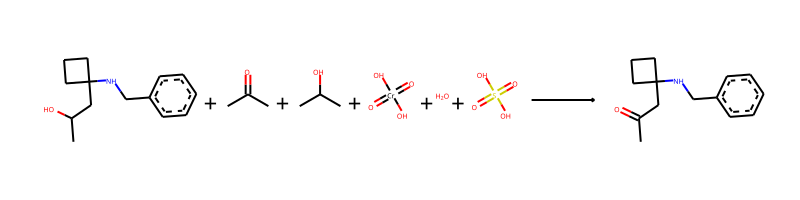

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CC(C)=O.CC(C)O.O=[Cr](=O)(O)O.O.O=S(=O)(O)O>>CC(=O)CC1(NCc2ccccc2)CCC1
The fast filter score is 0.715943336


--------------------------------------------------

Train index: 409338
RANK 81 PRECEDENT
REACTANT MATCH SCORE: 0.5576923076923077


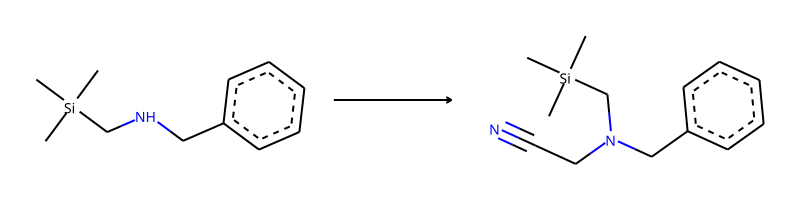

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>N#C-C-[N;H0;D3;+0:1](-[C:2])-[C:3]


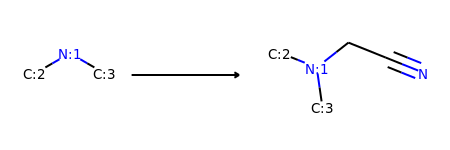

Product similarity 0.6166666666666667, overall 0.3439102564102564, smiles CC(O)CC1(N(CC#N)Cc2ccccc2)CCC1


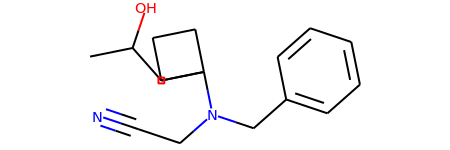

The proposed reaction is:


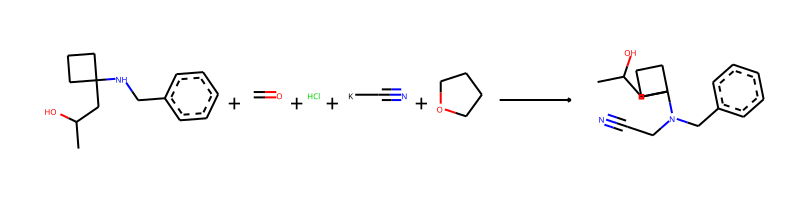

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.C=O.Cl.N#C[K].C1CCOC1>>CC(O)CC1(N(CC#N)Cc2ccccc2)CCC1
The fast filter score is 0.19173798


--------------------------------------------------

Train index: 322623
RANK 82 PRECEDENT
REACTANT MATCH SCORE: 0.5573770491803278


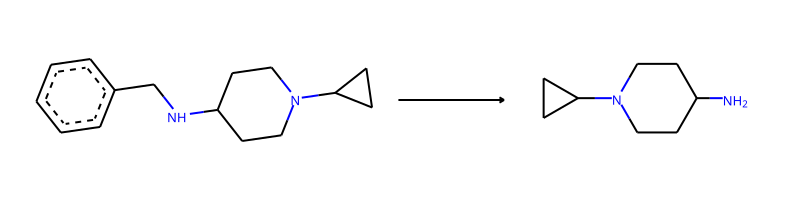

-> template: [C:1]-[NH;D2;+0:2]-[C;H2;D2;+0]-[c;H0;D3;+0]1:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:1>>[C:1]-[NH2;D1;+0:2]


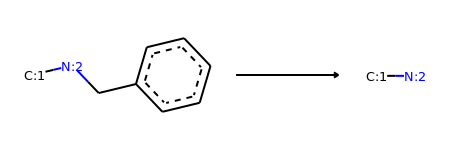

Product similarity 0.34210526315789475, overall 0.1906816220880069, smiles CC(O)CC1(N)CCC1


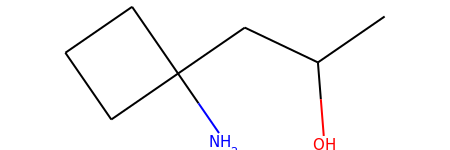

The proposed reaction is:


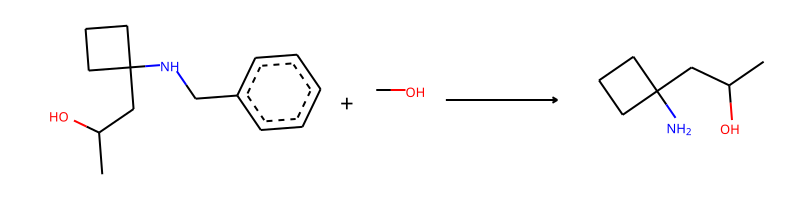

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CO>>CC(O)CC1(N)CCC1
The fast filter score is 0.802094221


--------------------------------------------------

Train index: 363197
RANK 83 PRECEDENT
REACTANT MATCH SCORE: 0.5573770491803278


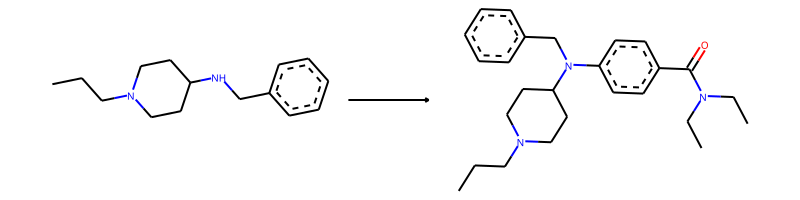

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-C-N(-C-C)-C(=O)-c1:c:c:c(-[N;H0;D3;+0:1](-[C:2])-[C:3]):c:c:1


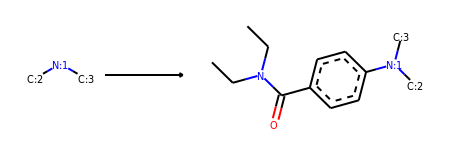

Product similarity 0.7216494845360825, overall 0.40223086023322624, smiles CCN(CC)C(=O)c1ccc(N(Cc2ccccc2)C2(CC(C)O)CCC2)cc1


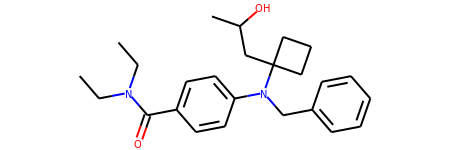

The proposed reaction is:


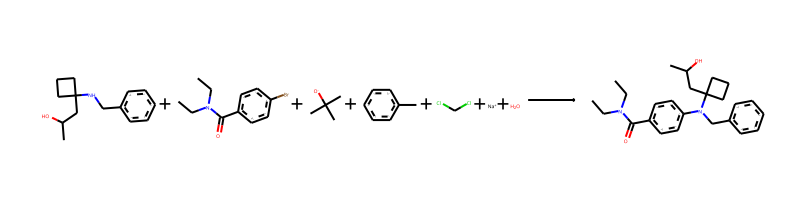

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CCN(CC)C(=O)c1ccc(Br)cc1.CC(C)(C)[O-].Cc1ccccc1.ClCCl.[Na+].O>>CCN(CC)C(=O)c1ccc(N(Cc2ccccc2)C2(CC(C)O)CCC2)cc1
The fast filter score is 0.9947837


--------------------------------------------------

Train index: 310894
RANK 84 PRECEDENT
REACTANT MATCH SCORE: 0.5555555555555556


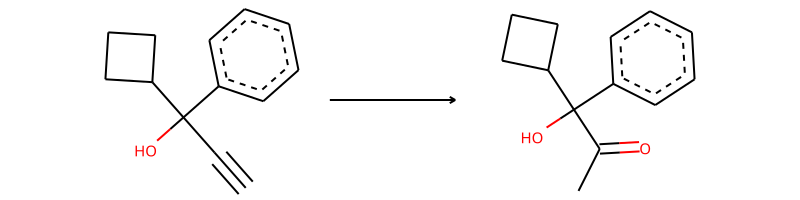

-> template: [C:2]-[C;H0;D2;+0:1]#[CH;D1;+0:3]>>O=[C;H0;D3;+0:1](-[C:2])-[CH3;D1;+0:3]


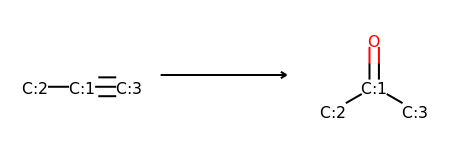

->No precursors could be generated!


--------------------------------------------------

Train index: 411153
RANK 85 PRECEDENT
REACTANT MATCH SCORE: 0.5555555555555556


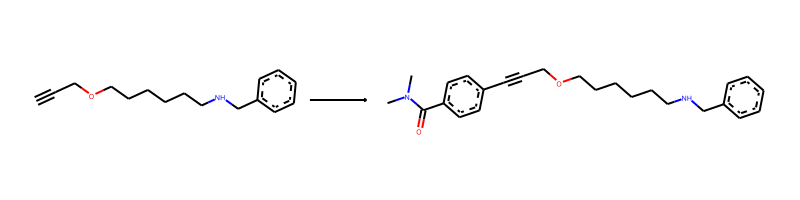

-> template: [C:2]#[CH;D1;+0:1]>>C-N(-C)-C(=O)-c1:c:c:c(-[C;H0;D2;+0:1]#[C:2]):c:c:1


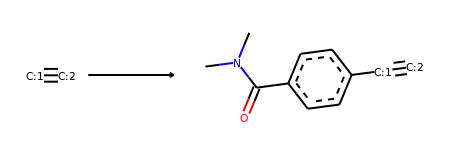

->No precursors could be generated!


--------------------------------------------------

Train index: 181594
RANK 86 PRECEDENT
REACTANT MATCH SCORE: 0.5555555555555556


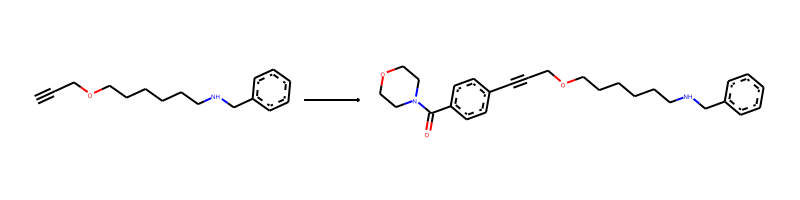

-> template: [C:2]#[CH;D1;+0:1]>>O=C(-N1-C-C-O-C-C-1)-c1:c:c:c(-[C;H0;D2;+0:1]#[C:2]):c:c:1


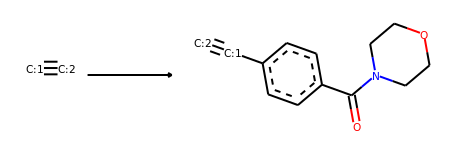

->No precursors could be generated!


--------------------------------------------------

Train index: 457910
RANK 87 PRECEDENT
REACTANT MATCH SCORE: 0.5555555555555556


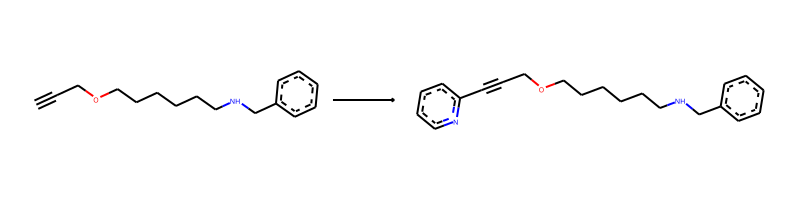

-> template: [C:1]#[CH;D1;+0:2]>>[C:1]#[C;H0;D2;+0:2]-c1:c:c:c:c:n:1


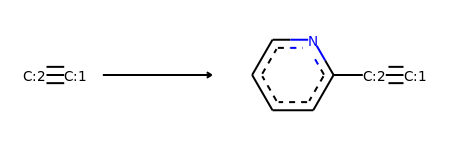

->No precursors could be generated!


--------------------------------------------------

Train index: 247692
RANK 88 PRECEDENT
REACTANT MATCH SCORE: 0.5538461538461539


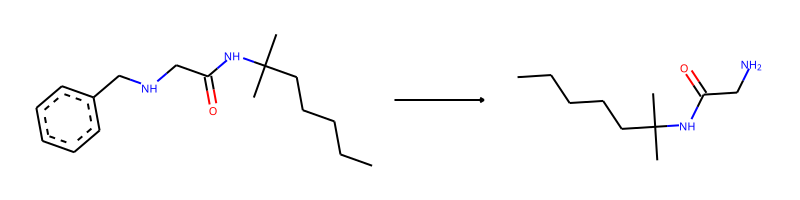

-> template: [#7:1]-[C:2](=[O;D1;H0:3])-[C:4]-[NH;D2;+0:5]-[C;H2;D2;+0]-[c;H0;D3;+0]1:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:1>>[#7:1]-[C:2](=[O;D1;H0:3])-[C:4]-[NH2;D1;+0:5]


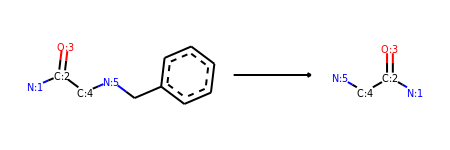

->No precursors could be generated!


--------------------------------------------------

Train index: 328108
RANK 89 PRECEDENT
REACTANT MATCH SCORE: 0.5535714285714286


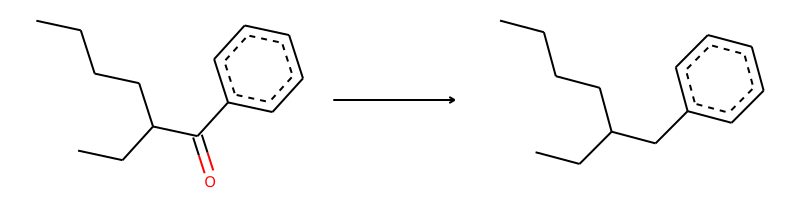

-> template: [C:1]-[C;H0;D3;+0:2](=[O;H0;D1;+0])-[c:3]>>[C:1]-[CH2;D2;+0:2]-[c:3]


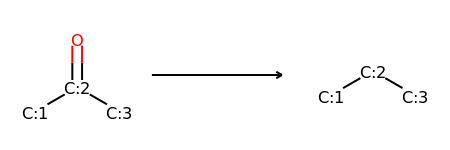

->No precursors could be generated!


--------------------------------------------------

Train index: 6608
RANK 90 PRECEDENT
REACTANT MATCH SCORE: 0.5535714285714286


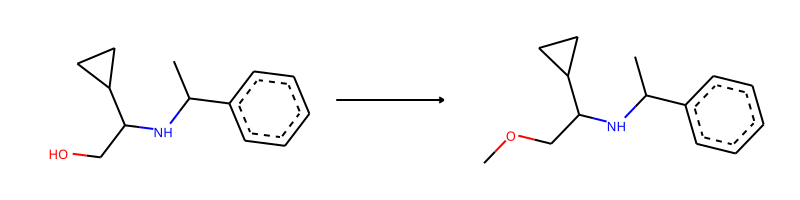

-> template: [C:2]-[OH;D1;+0:1]>>C-[O;H0;D2;+0:1]-[C:2]


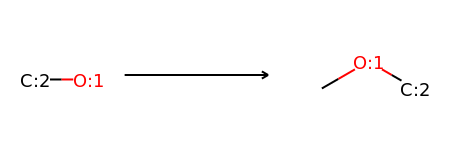

Product similarity 0.55, overall 0.30446428571428574, smiles COC(C)CC1(NCc2ccccc2)CCC1


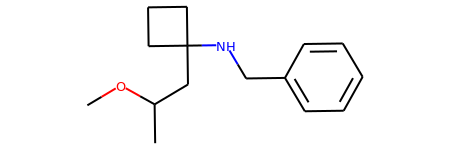

The proposed reaction is:


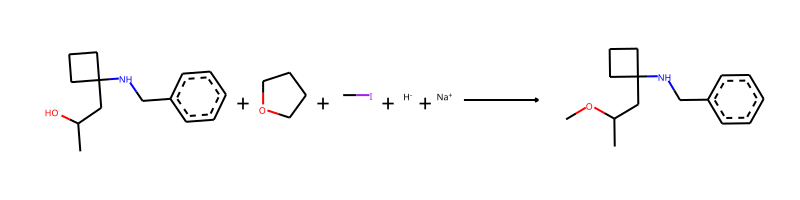

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.C1CCOC1.CI.[H-].[Na+]>>COC(C)CC1(NCc2ccccc2)CCC1
The fast filter score is 0.993847132


--------------------------------------------------

Train index: 16678
RANK 91 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


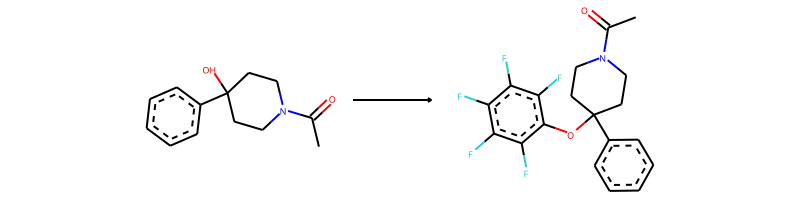

-> template: [C:2]-[OH;D1;+0:1]>>F-c1:c(-F):c(-F):c(-[O;H0;D2;+0:1]-[C:2]):c(-F):c:1-F


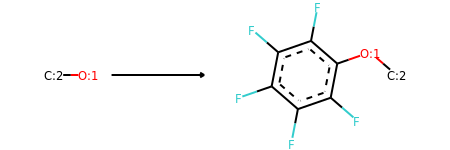

Product similarity 0.6818181818181818, overall 0.37617554858934166, smiles CC(CC1(NCc2ccccc2)CCC1)Oc1c(F)c(F)c(F)c(F)c1F


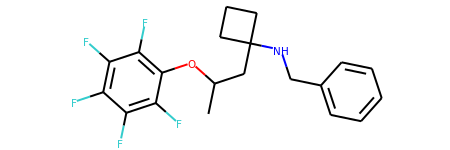

The proposed reaction is:


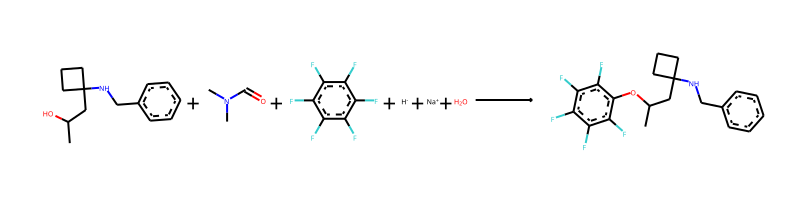

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CN(C)C=O.Fc1c(F)c(F)c(F)c(F)c1F.[H-].[Na+].O>>CC(CC1(NCc2ccccc2)CCC1)Oc1c(F)c(F)c(F)c(F)c1F
The fast filter score is 0.443971425


--------------------------------------------------

Train index: 268885
RANK 92 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


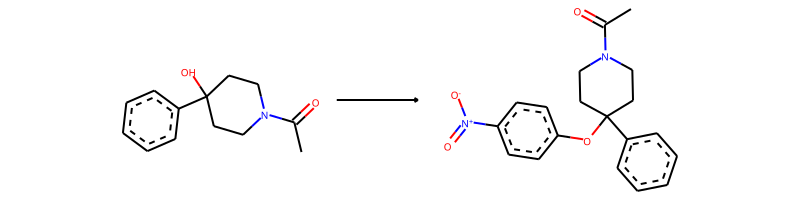

-> template: [C:2]-[OH;D1;+0:1]>>O=[N+](-[O-])-c1:c:c:c(-[O;H0;D2;+0:1]-[C:2]):c:c:1


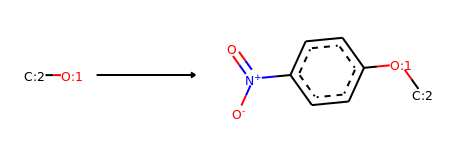

Product similarity 0.6705882352941176, overall 0.3699797160243407, smiles CC(CC1(NCc2ccccc2)CCC1)Oc1ccc([N+](=O)[O-])cc1


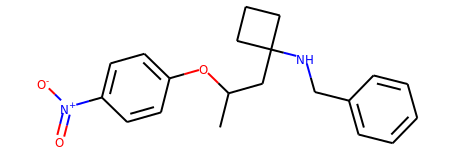

The proposed reaction is:


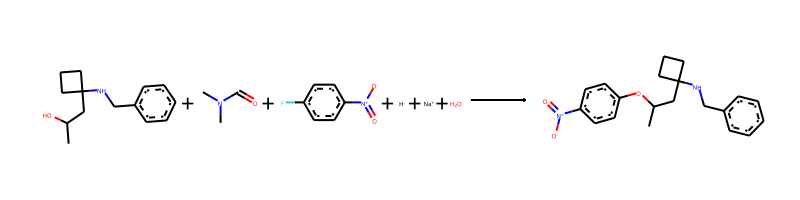

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CN(C)C=O.O=[N+]([O-])c1ccc(F)cc1.[H-].[Na+].O>>CC(CC1(NCc2ccccc2)CCC1)Oc1ccc([N+](=O)[O-])cc1
The fast filter score is 0.840759277


--------------------------------------------------

Train index: 243093
RANK 93 PRECEDENT
REACTANT MATCH SCORE: 0.5510204081632653


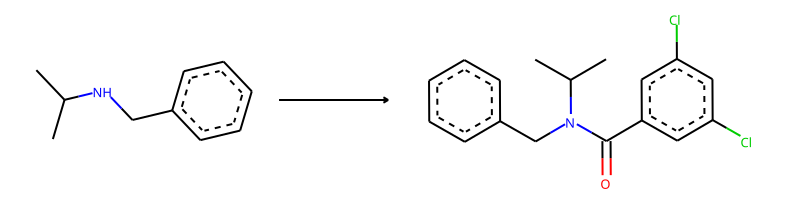

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>Cl-c1:c:c(-Cl):c:c(-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]):c:1


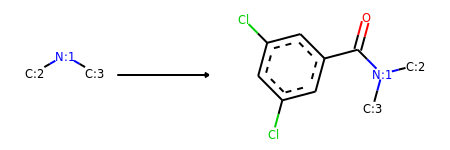

Product similarity 0.7105263157894737, overall 0.3915145005370569, smiles CC(O)CC1(N(Cc2ccccc2)C(=O)c2cc(Cl)cc(Cl)c2)CCC1


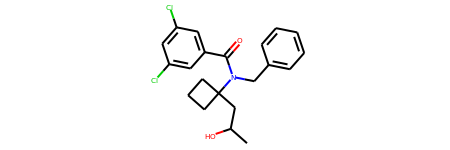

The proposed reaction is:


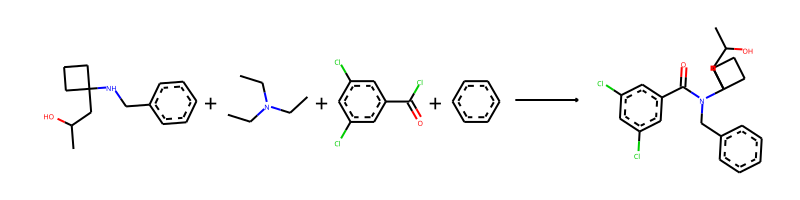

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CCN(CC)CC.O=C(Cl)c1cc(Cl)cc(Cl)c1.c1ccccc1>>CC(O)CC1(N(Cc2ccccc2)C(=O)c2cc(Cl)cc(Cl)c2)CCC1
The fast filter score is 0.97097671


--------------------------------------------------

Train index: 240606
RANK 94 PRECEDENT
REACTANT MATCH SCORE: 0.5510204081632653


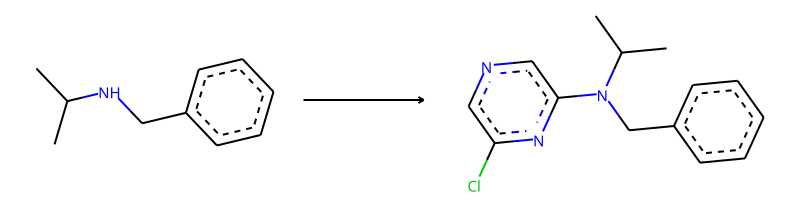

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>Cl-c1:c:n:c:c(-[N;H0;D3;+0:1](-[C:2])-[C:3]):n:1


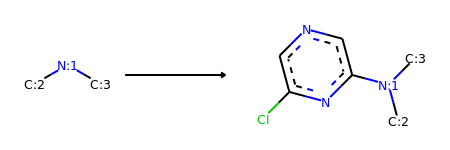

Product similarity 0.6811594202898551, overall 0.3753327417923691, smiles CC(O)CC1(N(Cc2ccccc2)c2cncc(Cl)n2)CCC1


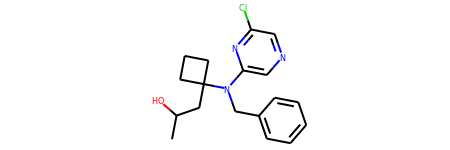

The proposed reaction is:


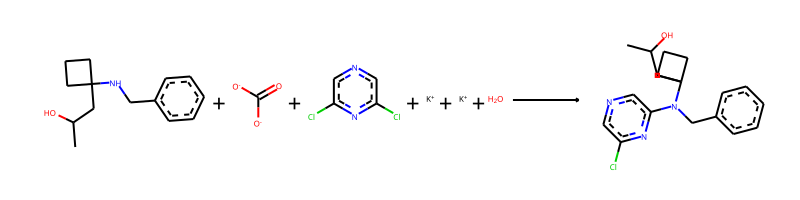

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.O=C([O-])[O-].Clc1cncc(Cl)n1.[K+].[K+].O>>CC(O)CC1(N(Cc2ccccc2)c2cncc(Cl)n2)CCC1
The fast filter score is 0.507206082


--------------------------------------------------

Train index: 183237
RANK 95 PRECEDENT
REACTANT MATCH SCORE: 0.5510204081632653


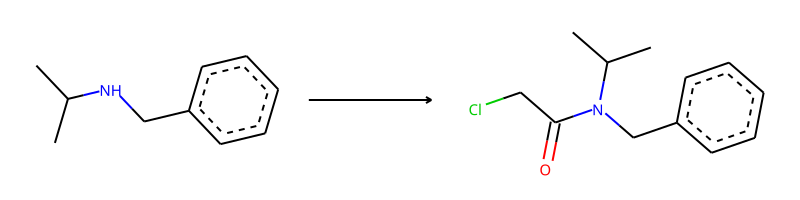

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>Cl-C-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]


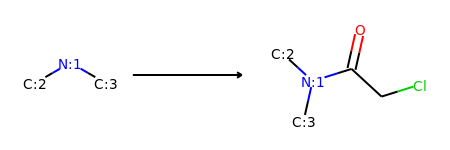

Product similarity 0.6271186440677966, overall 0.34555517122103074, smiles CC(O)CC1(N(Cc2ccccc2)C(=O)CCl)CCC1


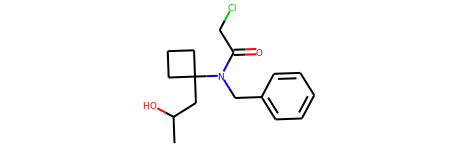

The proposed reaction is:


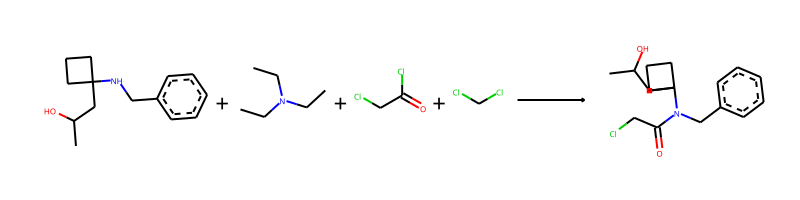

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CCN(CC)CC.O=C(Cl)CCl.ClCCl>>CC(O)CC1(N(Cc2ccccc2)C(=O)CCl)CCC1
The fast filter score is 0.936316729


--------------------------------------------------

Train index: 383719
RANK 96 PRECEDENT
REACTANT MATCH SCORE: 0.5510204081632653


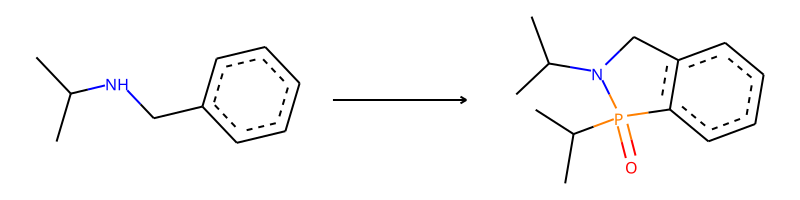

-> template: [C:2]-[NH;D2;+0:1]-[C:3]-[c:4]:[cH;D2;+0:5]:[c:6]>>C-C(-C)-P1(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]-[c:4]:[c;H0;D3;+0:5]-1:[c:6]


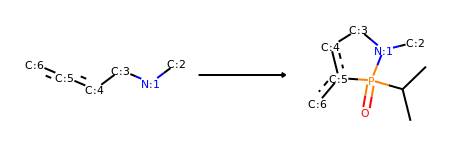

Product similarity 0.639344262295082, overall 0.3522917363666778, smiles CC(O)CC1(N2Cc3ccccc3P2(=O)C(C)C)CCC1


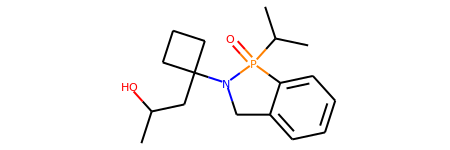

The proposed reaction is:


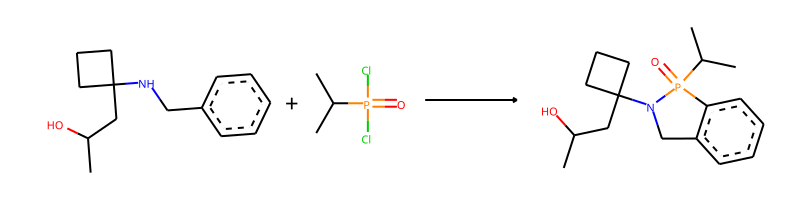

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CC(C)P(=O)(Cl)Cl>>CC(O)CC1(N2Cc3ccccc3P2(=O)C(C)C)CCC1
The fast filter score is 0.899341583


--------------------------------------------------

Train index: 144952
RANK 97 PRECEDENT
REACTANT MATCH SCORE: 0.5510204081632653


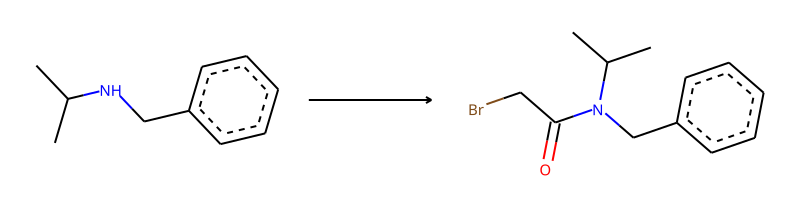

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>Br-C-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]


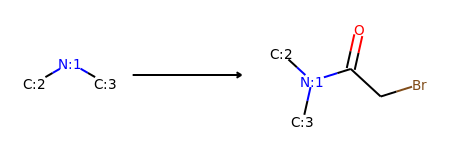

Product similarity 0.6271186440677966, overall 0.34555517122103074, smiles CC(O)CC1(N(Cc2ccccc2)C(=O)CBr)CCC1


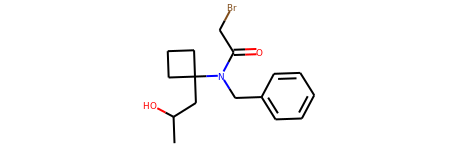

The proposed reaction is:


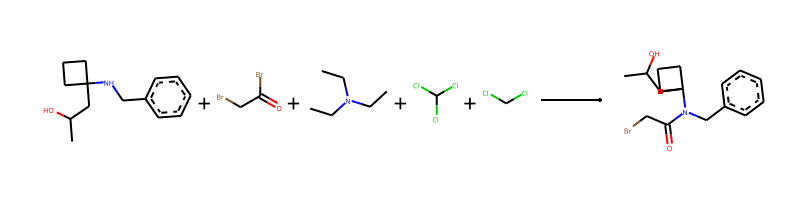

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.O=C(Br)CBr.CCN(CC)CC.ClC(Cl)Cl.ClCCl>>CC(O)CC1(N(Cc2ccccc2)C(=O)CBr)CCC1
The fast filter score is 0.974359095


--------------------------------------------------

Train index: 14763
RANK 98 PRECEDENT
REACTANT MATCH SCORE: 0.5490196078431373


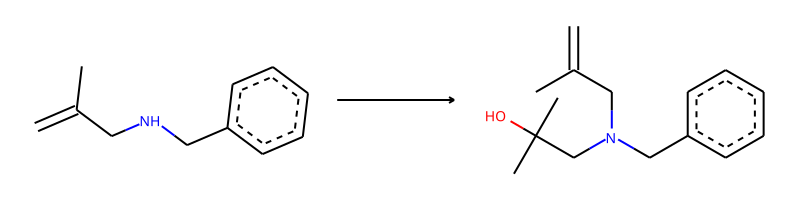

-> template: [C:2]-[NH;D2;+0:1]-[C:3]-[C:4]=[C;D1;H2:5]>>C-C(-C)(-O)-C-[N;H0;D3;+0:1](-[C:2])-[C:3]-[C:4]=[C;D1;H2:5]


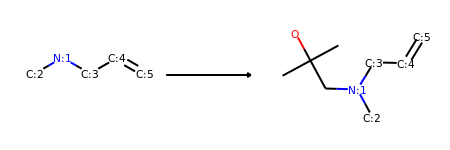

->No precursors could be generated!


--------------------------------------------------

Train index: 460175
RANK 99 PRECEDENT
REACTANT MATCH SCORE: 0.5483870967741935


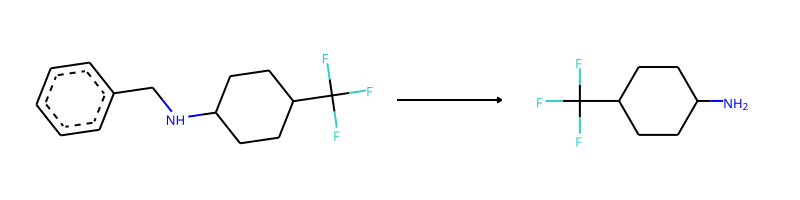

-> template: [C:1]-[NH;D2;+0:2]-[C;H2;D2;+0]-[c;H0;D3;+0]1:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:1>>[C:1]-[NH2;D1;+0:2]


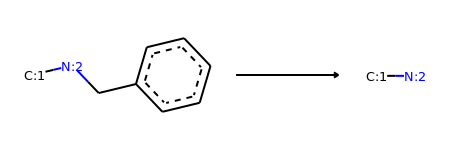

Product similarity 0.3333333333333333, overall 0.18279569892473116, smiles CC(O)CC1(N)CCC1


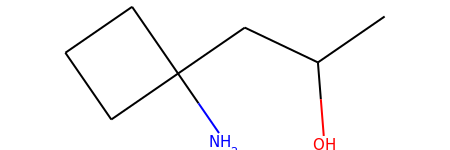

The proposed reaction is:


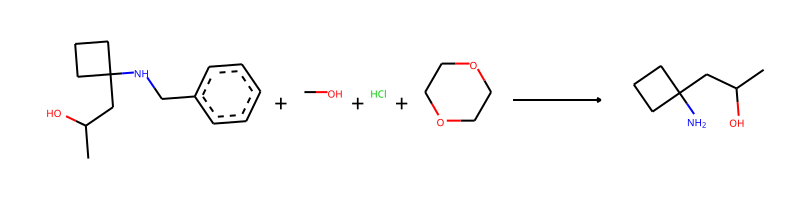

The reaction SMILES string is: CC(O)CC1(NCc2ccccc2)CCC1.CO.Cl.C1COCCO1>>CC(O)CC1(N)CCC1
The fast filter score is 0.670772076


--------------------------------------------------

Train index: 188365
RANK 100 PRECEDENT
REACTANT MATCH SCORE: 0.5483870967741935


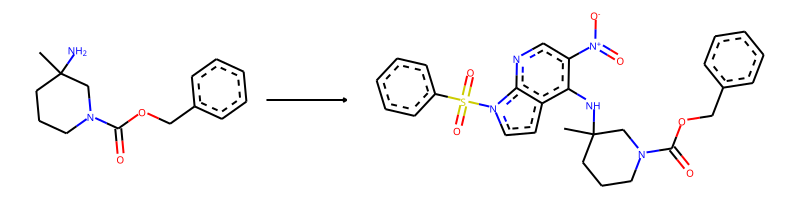

-> template: [C:2]-[NH2;D1;+0:1]>>O=[N+](-[O-])-c1:c:n:c2:c(:c:c:n:2-S(=O)(=O)-c2:c:c:c:c:c:2):c:1-[NH;D2;+0:1]-[C:2]


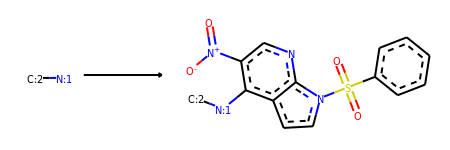

->No precursors could be generated!


(64,
 'CC(O)CC1(NCc2ccccc2)CCC1.CO.O=C[O-].[NH4+]>>CC(O)CC1(N)CCC1',
 1.0,
 0.44680851063829785)

In [19]:
do_one_v4 (28140)

Reactant input:


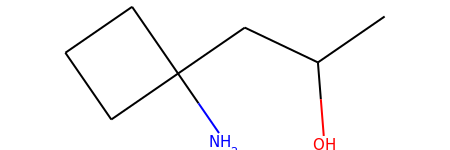



--------------------------------------------------

Train index: 309522
RANK 1 PRECEDENT
REACTANT MATCH SCORE: 0.6551724137931034


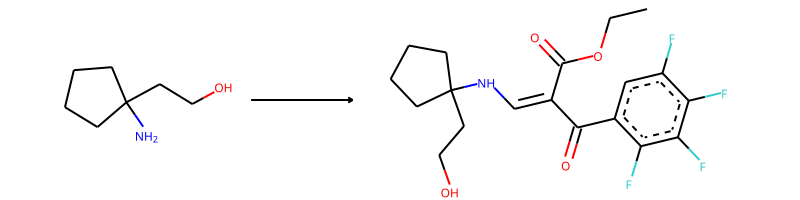

-> template: [C:2]-[NH2;D1;+0:1]>>C-C-O-C(=O)-C(=C-[NH;D2;+0:1]-[C:2])-C(=O)-c1:c:c(-F):c(-F):c(-F):c:1-F


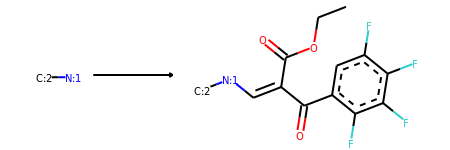

Product similarity 0.875, overall 0.5732758620689655, smiles CCOC(=O)C(=CNC1(CC(C)O)CCC1)C(=O)c1cc(F)c(F)c(F)c1F


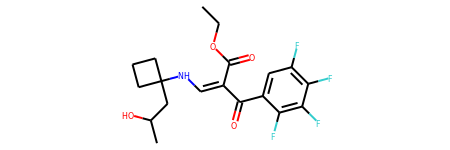

The proposed reaction is:


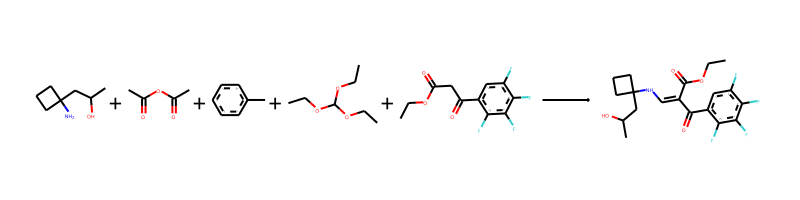

The reaction SMILES string is: CC(O)CC1(N)CCC1.CC(=O)OC(C)=O.Cc1ccccc1.CCOC(OCC)OCC.CCOC(=O)CC(=O)c1cc(F)c(F)c(F)c1F>>CCOC(=O)C(=CNC1(CC(C)O)CCC1)C(=O)c1cc(F)c(F)c(F)c1F


--------------------------------------------------

Train index: 158466
RANK 2 PRECEDENT
REACTANT MATCH SCORE: 0.6296296296296297


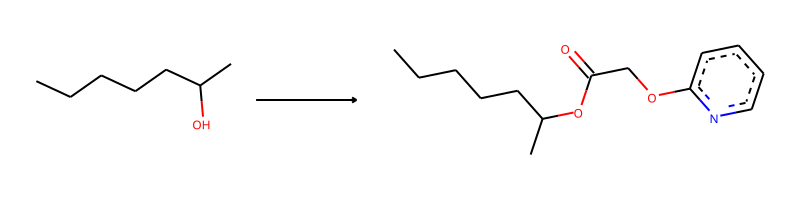

-> template: [C:2]-[OH;D1;+0:1]>>O=C(-C-O-c1:c:c:c:c:n:1)-[O;H0;D2;+0:1]-[C:2]


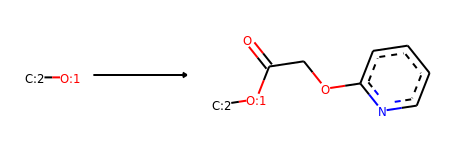

Product similarity 0.8245614035087719, overall 0.5191682910981157, smiles CC(CC1(N)CCC1)OC(=O)COc1ccccn1


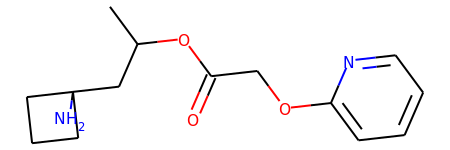

The proposed reaction is:


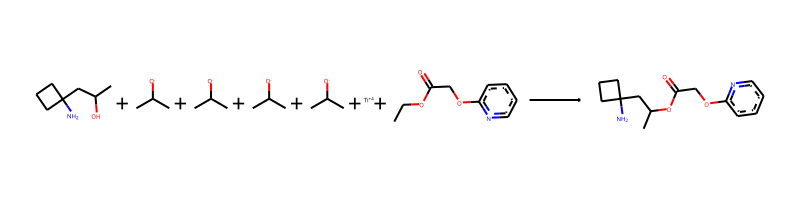

The reaction SMILES string is: CC(O)CC1(N)CCC1.CC(C)[O-].CC(C)[O-].CC(C)[O-].CC(C)[O-].[Ti+4].CCOC(=O)COc1ccccn1>>CC(CC1(N)CCC1)OC(=O)COc1ccccn1


--------------------------------------------------

Train index: 21862
RANK 3 PRECEDENT
REACTANT MATCH SCORE: 0.6071428571428571


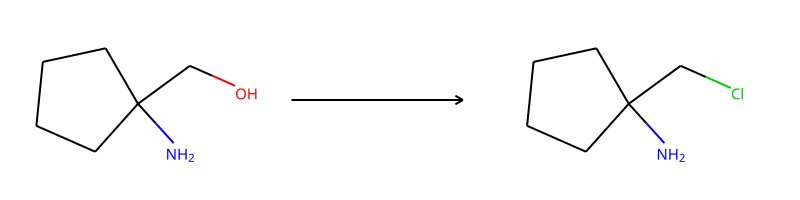

-> template: [C:2]-[CH2;D2;+0:1]-[O;H1;D1;+0]>>Cl-[CH2;D2;+0:1]-[C:2]


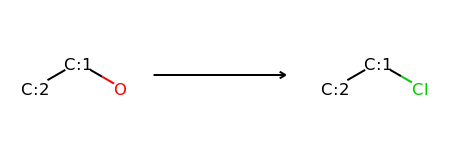

->No precursors could be generated!


--------------------------------------------------

Train index: 32707
RANK 4 PRECEDENT
REACTANT MATCH SCORE: 0.6071428571428571


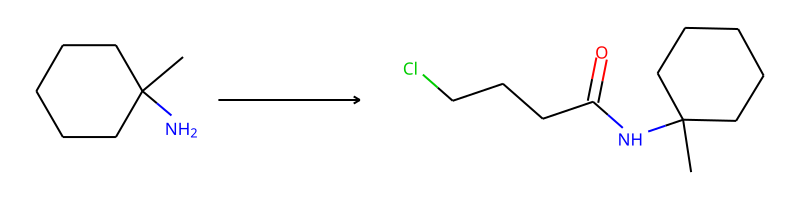

-> template: [C:2]-[NH2;D1;+0:1]>>Cl-C-C-C-C(=O)-[NH;D2;+0:1]-[C:2]


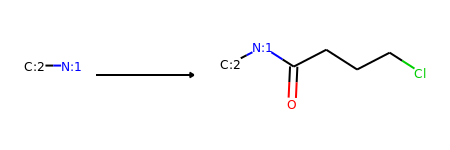

Product similarity 0.7555555555555555, overall 0.45873015873015865, smiles CC(O)CC1(NC(=O)CCCCl)CCC1


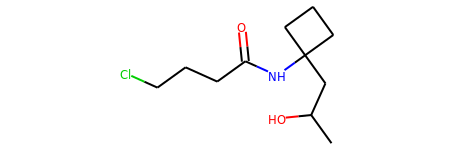

The proposed reaction is:


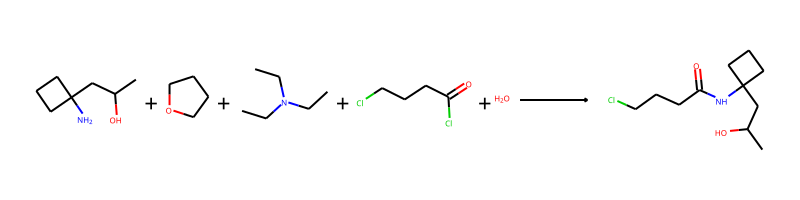

The reaction SMILES string is: CC(O)CC1(N)CCC1.C1CCOC1.CCN(CC)CC.O=C(Cl)CCCCl.O>>CC(O)CC1(NC(=O)CCCCl)CCC1


--------------------------------------------------

Train index: 163929
RANK 5 PRECEDENT
REACTANT MATCH SCORE: 0.6071428571428571


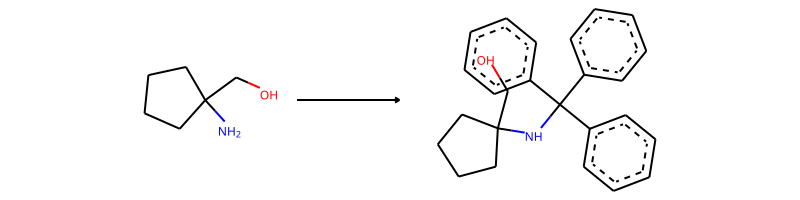

-> template: [C:1]-[NH2;D1;+0:2]>>[C:1]-[NH;D2;+0:2]-C(-c1:c:c:c:c:c:1)(-c1:c:c:c:c:c:1)-c1:c:c:c:c:c:1


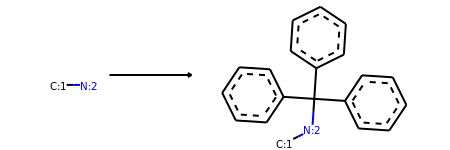

Product similarity 0.872093023255814, overall 0.529485049833887, smiles CC(O)CC1(NC(c2ccccc2)(c2ccccc2)c2ccccc2)CCC1


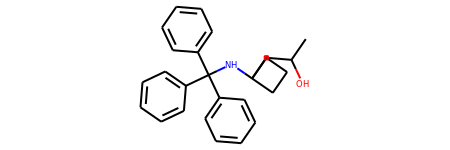

The proposed reaction is:


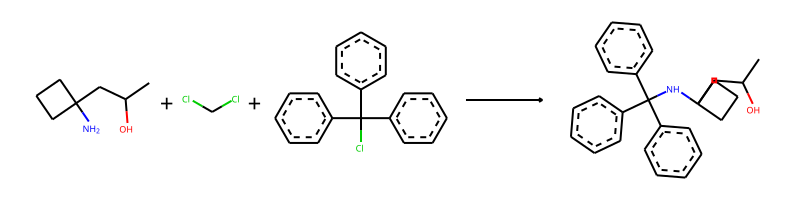

The reaction SMILES string is: CC(O)CC1(N)CCC1.ClCCl.ClC(c1ccccc1)(c1ccccc1)c1ccccc1>>CC(O)CC1(NC(c2ccccc2)(c2ccccc2)c2ccccc2)CCC1


--------------------------------------------------

Train index: 326881
RANK 6 PRECEDENT
REACTANT MATCH SCORE: 0.6071428571428571


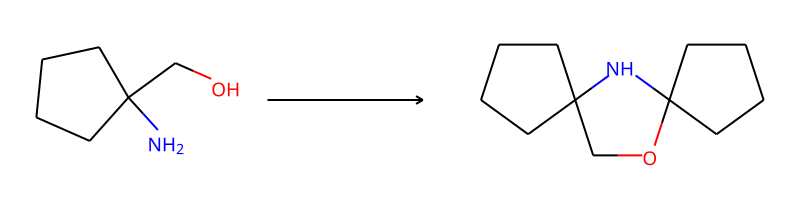

-> template: [NH2;D1;+0:1]-[C:2]-[C:3]-[OH;D1;+0:4]>>C1-C-C-C2(-C-1)-[NH;D2;+0:1]-[C:2]-[C:3]-[O;H0;D2;+0:4]-2


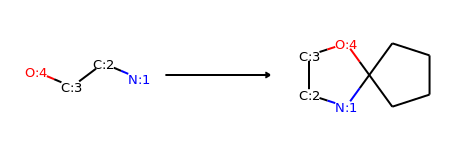

->No precursors could be generated!


--------------------------------------------------

Train index: 376820
RANK 7 PRECEDENT
REACTANT MATCH SCORE: 0.6071428571428571


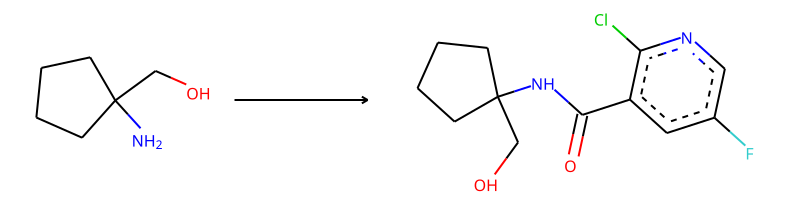

-> template: [C:2]-[NH2;D1;+0:1]>>Cl-c1:n:c:c(-F):c:c:1-C(=O)-[NH;D2;+0:1]-[C:2]


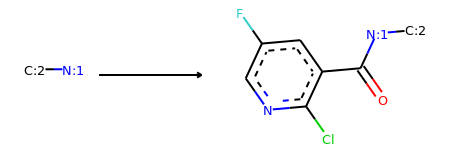

Product similarity 0.8035714285714286, overall 0.48788265306122447, smiles CC(O)CC1(NC(=O)c2cc(F)cnc2Cl)CCC1


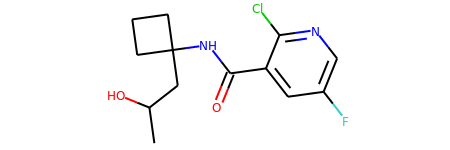

The proposed reaction is:


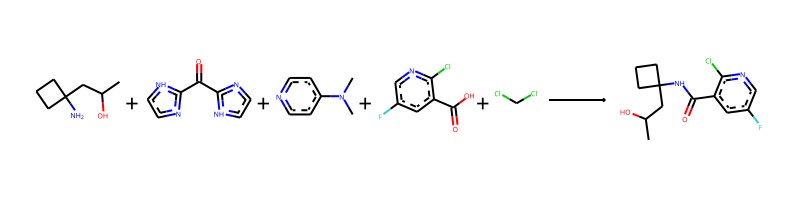

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C(c1ncc[nH]1)c1ncc[nH]1.CN(C)c1ccncc1.O=C(O)c1cc(F)cnc1Cl.ClCCl>>CC(O)CC1(NC(=O)c2cc(F)cnc2Cl)CCC1


--------------------------------------------------

Train index: 210743
RANK 8 PRECEDENT
REACTANT MATCH SCORE: 0.6071428571428571


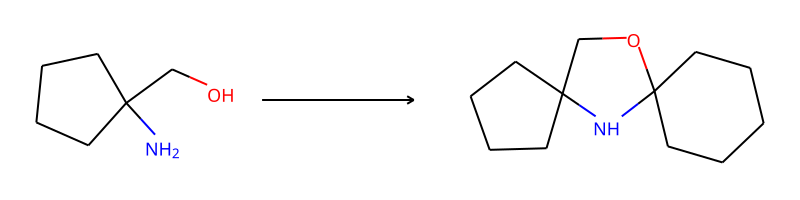

-> template: [NH2;D1;+0:1]-[C:2]-[C:3]-[OH;D1;+0:4]>>C1-C-C-C2(-C-C-1)-[NH;D2;+0:1]-[C:2]-[C:3]-[O;H0;D2;+0:4]-2


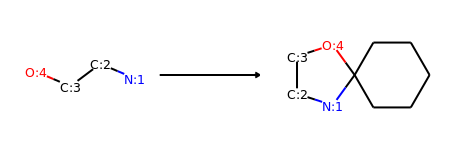

->No precursors could be generated!


--------------------------------------------------

Train index: 8924
RANK 9 PRECEDENT
REACTANT MATCH SCORE: 0.6


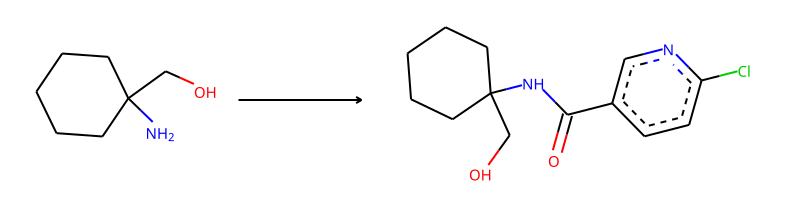

-> template: [C:2]-[NH2;D1;+0:1]>>Cl-c1:c:c:c(-C(=O)-[NH;D2;+0:1]-[C:2]):c:n:1


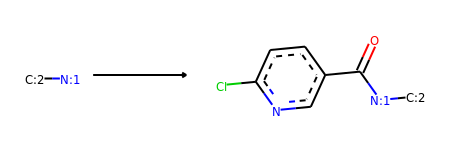

Product similarity 0.7857142857142857, overall 0.4714285714285714, smiles CC(O)CC1(NC(=O)c2ccc(Cl)nc2)CCC1


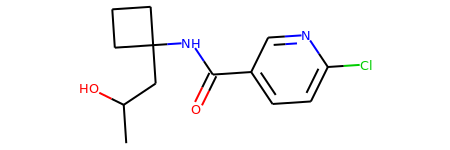

The proposed reaction is:


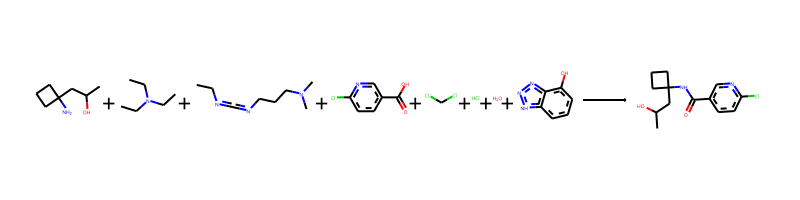

The reaction SMILES string is: CC(O)CC1(N)CCC1.CCN(CC)CC.CCN=C=NCCCN(C)C.O=C(O)c1ccc(Cl)nc1.ClCCl.Cl.O.Oc1cccc2[nH]nnc12>>CC(O)CC1(NC(=O)c2ccc(Cl)nc2)CCC1


--------------------------------------------------

Train index: 430375
RANK 10 PRECEDENT
REACTANT MATCH SCORE: 0.6


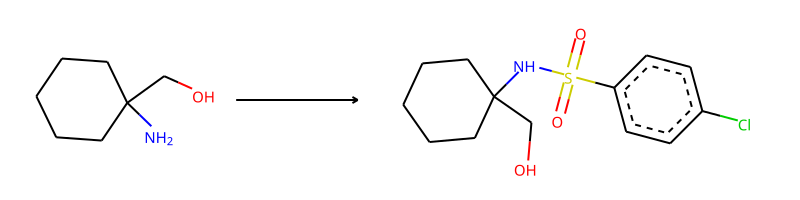

-> template: [C:2]-[NH2;D1;+0:1]>>Cl-c1:c:c:c(-S(=O)(=O)-[NH;D2;+0:1]-[C:2]):c:c:1


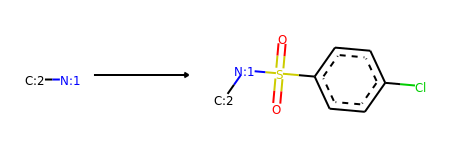

Product similarity 0.7931034482758621, overall 0.47586206896551725, smiles CC(O)CC1(NS(=O)(=O)c2ccc(Cl)cc2)CCC1


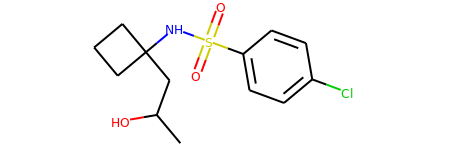

The proposed reaction is:


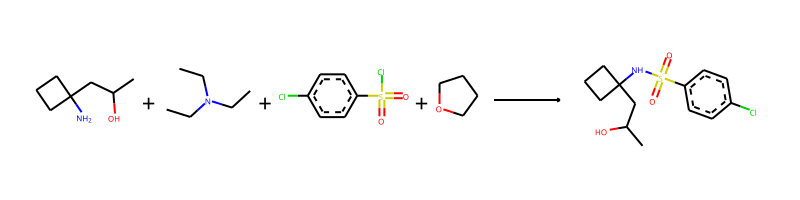

The reaction SMILES string is: CC(O)CC1(N)CCC1.CCN(CC)CC.O=S(=O)(Cl)c1ccc(Cl)cc1.C1CCOC1>>CC(O)CC1(NS(=O)(=O)c2ccc(Cl)cc2)CCC1


--------------------------------------------------

Train index: 205860
RANK 11 PRECEDENT
REACTANT MATCH SCORE: 0.5769230769230769


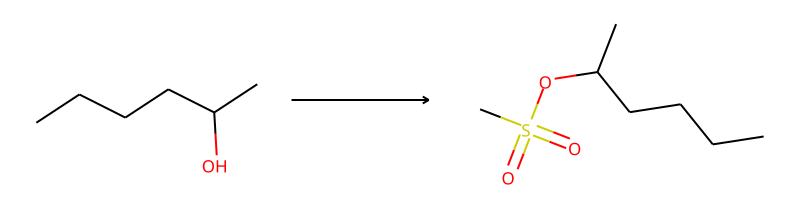

-> template: [C:2]-[OH;D1;+0:1]>>C-S(=O)(=O)-[O;H0;D2;+0:1]-[C:2]


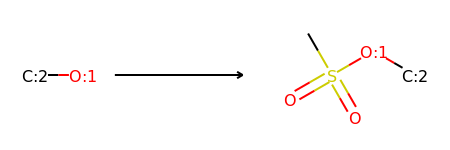

Product similarity 0.6944444444444444, overall 0.4006410256410256, smiles CC(CC1(N)CCC1)OS(C)(=O)=O


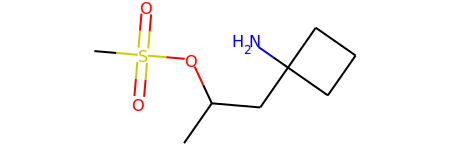

The proposed reaction is:


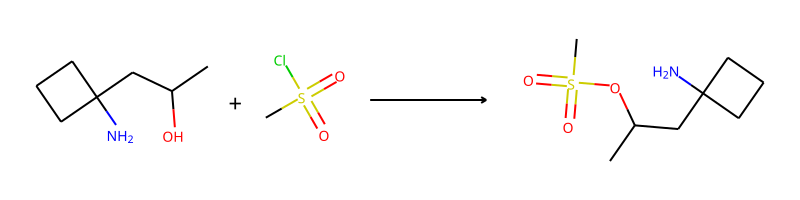

The reaction SMILES string is: CC(O)CC1(N)CCC1.CS(=O)(=O)Cl>>CC(CC1(N)CCC1)OS(C)(=O)=O


--------------------------------------------------

Train index: 395301
RANK 12 PRECEDENT
REACTANT MATCH SCORE: 0.5769230769230769


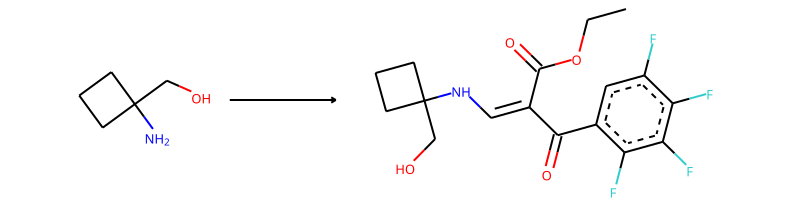

-> template: [C:2]-[NH2;D1;+0:1]>>C-C-O-C(=O)-C(=C-[NH;D2;+0:1]-[C:2])-C(=O)-c1:c:c(-F):c(-F):c(-F):c:1-F


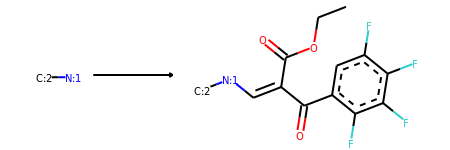

Product similarity 0.8571428571428571, overall 0.4945054945054944, smiles CCOC(=O)C(=CNC1(CC(C)O)CCC1)C(=O)c1cc(F)c(F)c(F)c1F


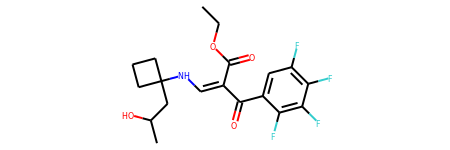

The proposed reaction is:


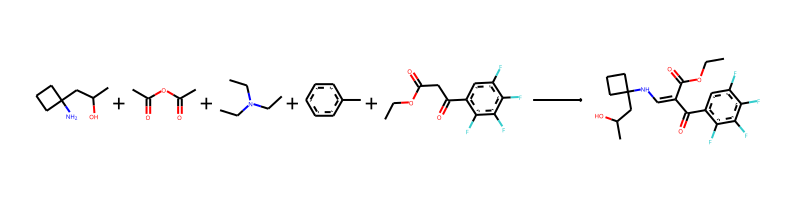

The reaction SMILES string is: CC(O)CC1(N)CCC1.CC(=O)OC(C)=O.CCN(CC)CC.Cc1ccccc1.CCOC(=O)CC(=O)c1cc(F)c(F)c(F)c1F>>CCOC(=O)C(=CNC1(CC(C)O)CCC1)C(=O)c1cc(F)c(F)c(F)c1F


--------------------------------------------------

Train index: 345341
RANK 13 PRECEDENT
REACTANT MATCH SCORE: 0.5666666666666667


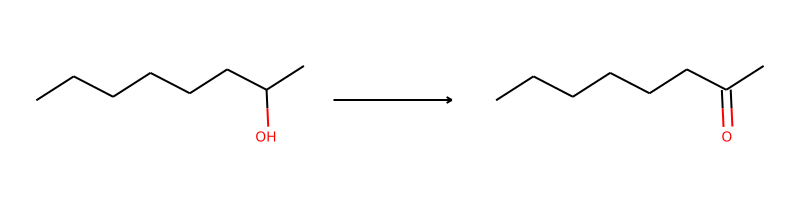

-> template: [C:1]-[CH;D3;+0:2](-[C;D1;H3:3])-[OH;D1;+0:4]>>[C:1]-[C;H0;D3;+0:2](-[C;D1;H3:3])=[O;H0;D1;+0:4]


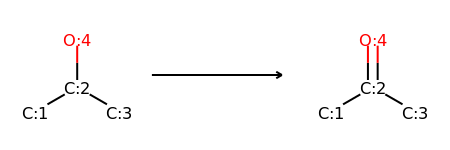

Product similarity 0.5666666666666667, overall 0.32111111111111107, smiles CC(=O)CC1(N)CCC1


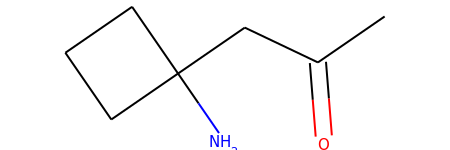

The proposed reaction is:


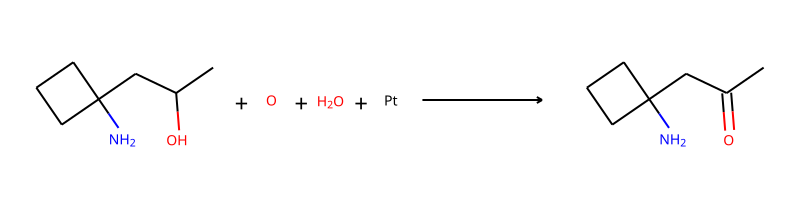

The reaction SMILES string is: CC(O)CC1(N)CCC1.[O].O.[Pt]>>CC(=O)CC1(N)CCC1


--------------------------------------------------

Train index: 12469
RANK 14 PRECEDENT
REACTANT MATCH SCORE: 0.5666666666666667


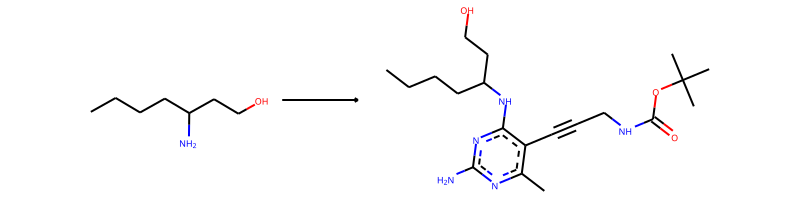

-> template: [C:2]-[NH2;D1;+0:1]>>C-c1:n:c(-N):n:c(-[NH;D2;+0:1]-[C:2]):c:1-C#C-C-N-C(=O)-O-C(-C)(-C)-C


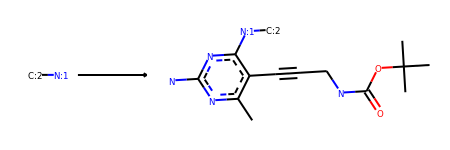

Product similarity 0.8192771084337349, overall 0.4642570281124498, smiles Cc1nc(N)nc(NC2(CC(C)O)CCC2)c1C#CCNC(=O)OC(C)(C)C


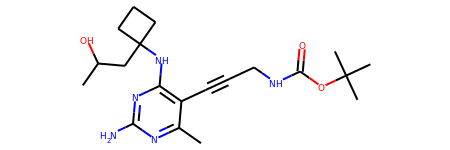

The proposed reaction is:


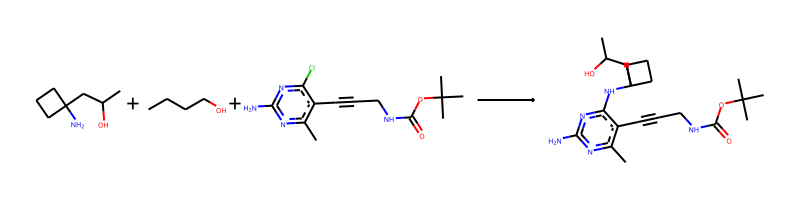

The reaction SMILES string is: CC(O)CC1(N)CCC1.CCCCO.Cc1nc(N)nc(Cl)c1C#CCNC(=O)OC(C)(C)C>>Cc1nc(N)nc(NC2(CC(C)O)CCC2)c1C#CCNC(=O)OC(C)(C)C


--------------------------------------------------

Train index: 102592
RANK 15 PRECEDENT
REACTANT MATCH SCORE: 0.5666666666666667


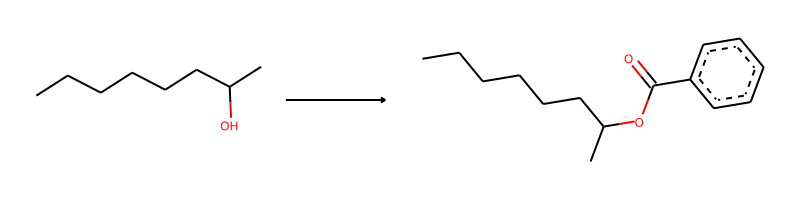

-> template: [C:2]-[OH;D1;+0:1]>>O=C(-[O;H0;D2;+0:1]-[C:2])-c1:c:c:c:c:c:1


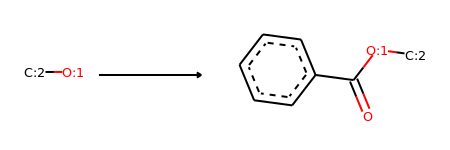

Product similarity 0.7592592592592593, overall 0.4302469135802469, smiles CC(CC1(N)CCC1)OC(=O)c1ccccc1


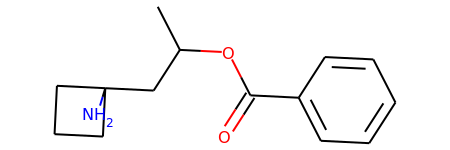

The proposed reaction is:


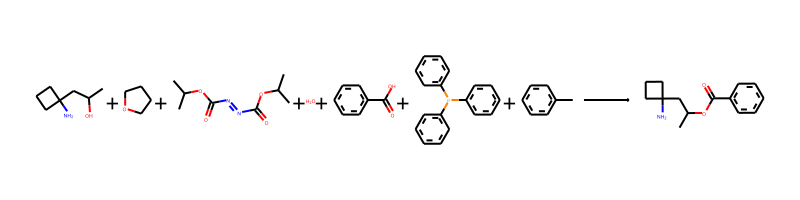

The reaction SMILES string is: CC(O)CC1(N)CCC1.C1CCOC1.CC(C)OC(=O)N=NC(=O)OC(C)C.O.O=C(O)c1ccccc1.c1ccc(P(c2ccccc2)c2ccccc2)cc1.Cc1ccccc1>>CC(CC1(N)CCC1)OC(=O)c1ccccc1


--------------------------------------------------

Train index: 246661
RANK 16 PRECEDENT
REACTANT MATCH SCORE: 0.5666666666666667


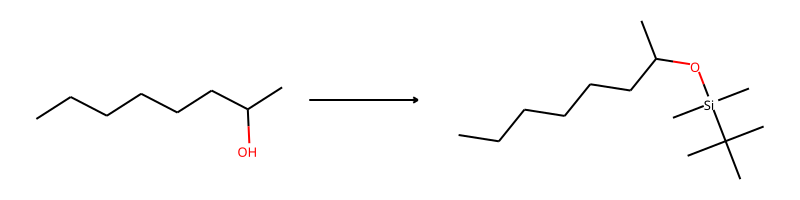

-> template: [C:2]-[OH;D1;+0:1]>>C-C(-C)(-C)-[Si](-C)(-C)-[O;H0;D2;+0:1]-[C:2]


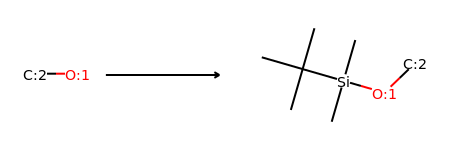

Product similarity 0.723404255319149, overall 0.40992907801418443, smiles CC(CC1(N)CCC1)O[Si](C)(C)C(C)(C)C


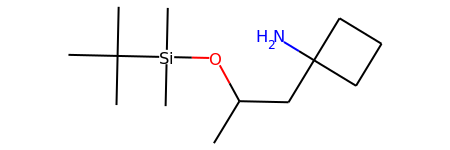

The proposed reaction is:


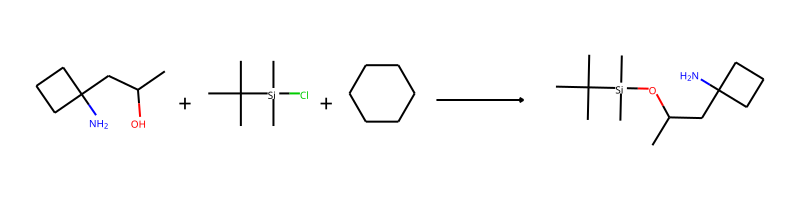

The reaction SMILES string is: CC(O)CC1(N)CCC1.CC(C)(C)[Si](C)(C)Cl.C1CCCCC1>>CC(CC1(N)CCC1)O[Si](C)(C)C(C)(C)C


--------------------------------------------------

Train index: 119537
RANK 17 PRECEDENT
REACTANT MATCH SCORE: 0.5666666666666667


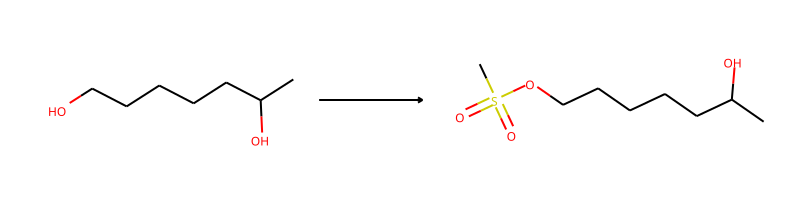

-> template: [C:2]-[OH;D1;+0:1]>>C-S(=O)(=O)-[O;H0;D2;+0:1]-[C:2]


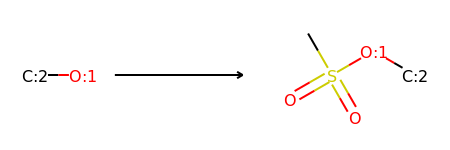

Product similarity 0.5581395348837209, overall 0.31627906976744186, smiles CC(CC1(N)CCC1)OS(C)(=O)=O


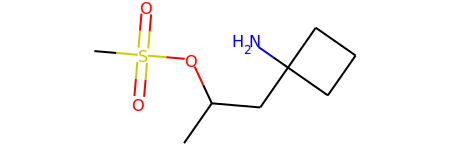

The proposed reaction is:


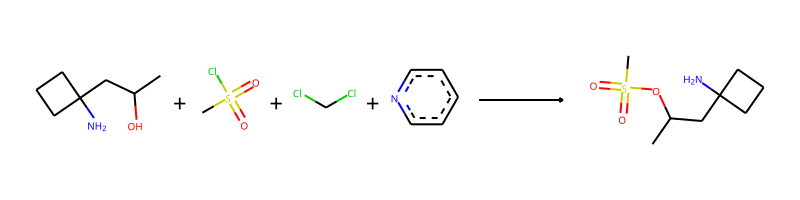

The reaction SMILES string is: CC(O)CC1(N)CCC1.CS(=O)(=O)Cl.ClCCl.c1ccncc1>>CC(CC1(N)CCC1)OS(C)(=O)=O


--------------------------------------------------

Train index: 235051
RANK 18 PRECEDENT
REACTANT MATCH SCORE: 0.5666666666666667


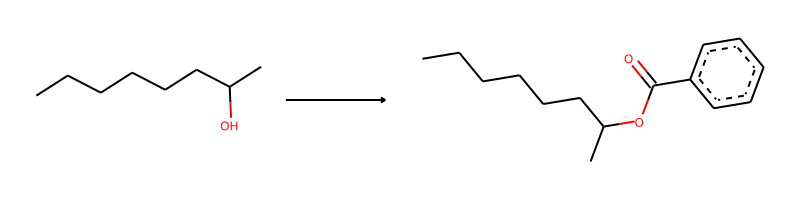

-> template: [C:2]-[OH;D1;+0:1]>>O=C(-[O;H0;D2;+0:1]-[C:2])-c1:c:c:c:c:c:1


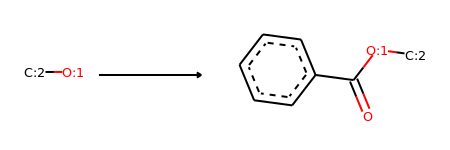

Product similarity 0.7592592592592593, overall 0.4302469135802469, smiles CC(CC1(N)CCC1)OC(=O)c1ccccc1


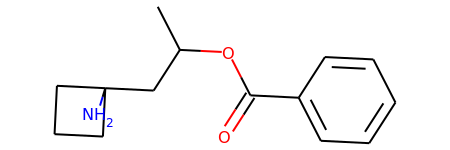

The proposed reaction is:


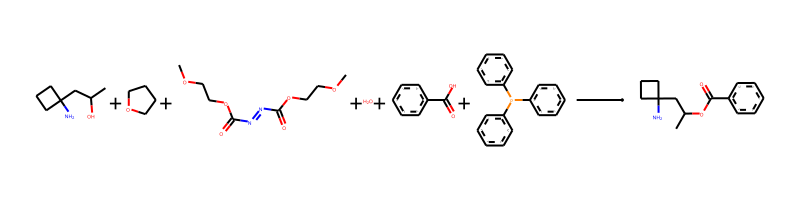

The reaction SMILES string is: CC(O)CC1(N)CCC1.C1CCOC1.COCCOC(=O)N=NC(=O)OCCOC.O.O=C(O)c1ccccc1.c1ccc(P(c2ccccc2)c2ccccc2)cc1>>CC(CC1(N)CCC1)OC(=O)c1ccccc1


--------------------------------------------------

Train index: 441446
RANK 19 PRECEDENT
REACTANT MATCH SCORE: 0.5666666666666667


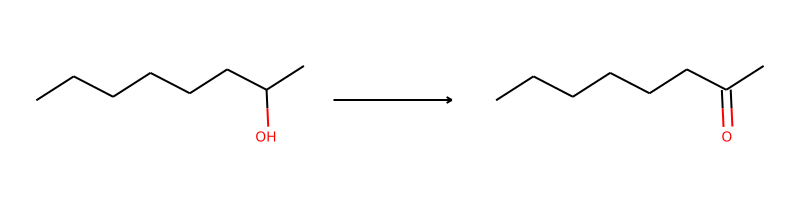

-> template: [C:1]-[CH;D3;+0:2](-[C;D1;H3:3])-[OH;D1;+0:4]>>[C:1]-[C;H0;D3;+0:2](-[C;D1;H3:3])=[O;H0;D1;+0:4]


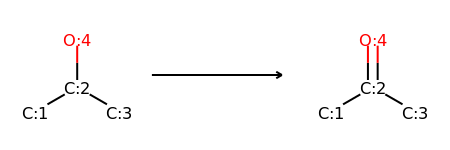

Product similarity 0.5666666666666667, overall 0.32111111111111107, smiles CC(=O)CC1(N)CCC1


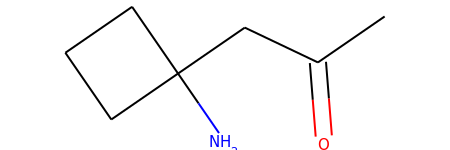

The proposed reaction is:


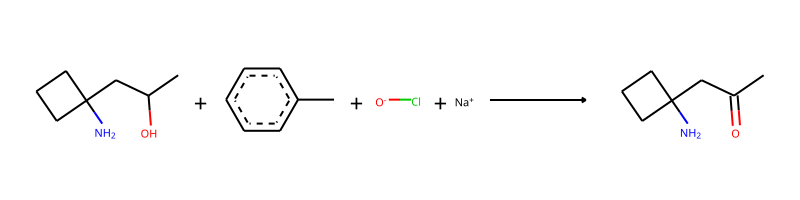

The reaction SMILES string is: CC(O)CC1(N)CCC1.Cc1ccccc1.[O-]Cl.[Na+]>>CC(=O)CC1(N)CCC1


--------------------------------------------------

Train index: 368762
RANK 20 PRECEDENT
REACTANT MATCH SCORE: 0.5666666666666667


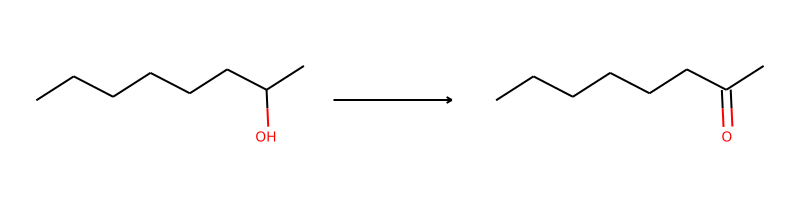

-> template: [C:1]-[CH;D3;+0:2](-[C;D1;H3:3])-[OH;D1;+0:4]>>[C:1]-[C;H0;D3;+0:2](-[C;D1;H3:3])=[O;H0;D1;+0:4]


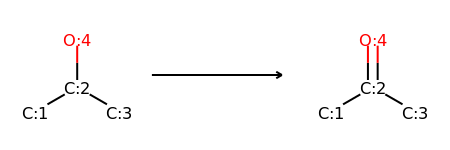

Product similarity 0.5666666666666667, overall 0.32111111111111107, smiles CC(=O)CC1(N)CCC1


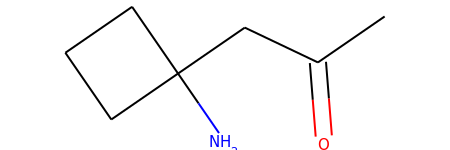

The proposed reaction is:


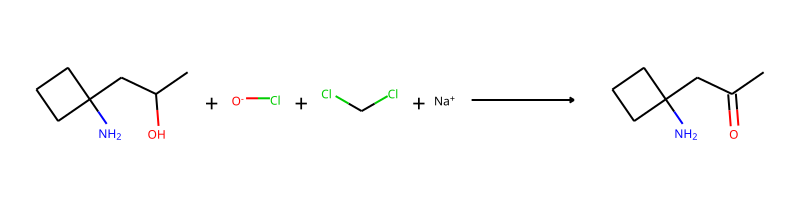

The reaction SMILES string is: CC(O)CC1(N)CCC1.[O-]Cl.ClCCl.[Na+]>>CC(=O)CC1(N)CCC1


--------------------------------------------------

Train index: 119754
RANK 21 PRECEDENT
REACTANT MATCH SCORE: 0.5666666666666667


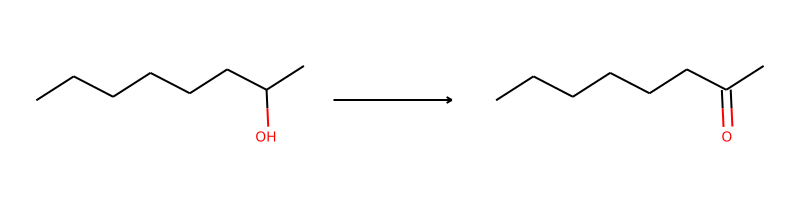

-> template: [C:1]-[CH;D3;+0:2](-[C;D1;H3:3])-[OH;D1;+0:4]>>[C:1]-[C;H0;D3;+0:2](-[C;D1;H3:3])=[O;H0;D1;+0:4]


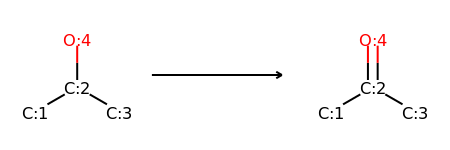

Product similarity 0.5666666666666667, overall 0.32111111111111107, smiles CC(=O)CC1(N)CCC1


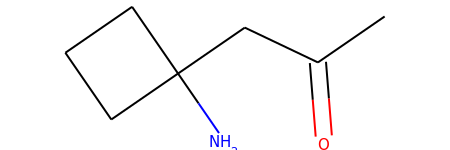

The proposed reaction is:


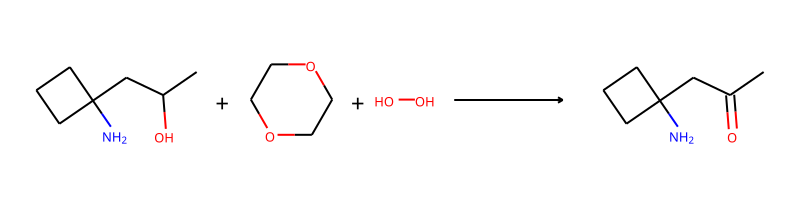

The reaction SMILES string is: CC(O)CC1(N)CCC1.C1COCCO1.OO>>CC(=O)CC1(N)CCC1


--------------------------------------------------

Train index: 44055
RANK 22 PRECEDENT
REACTANT MATCH SCORE: 0.5666666666666667


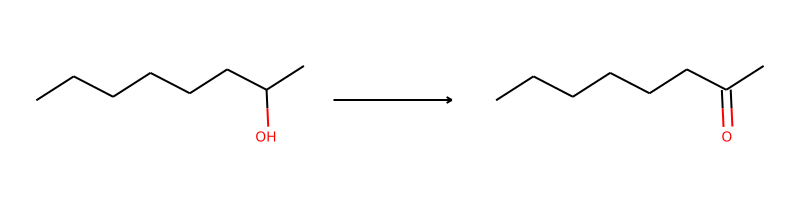

-> template: [C:1]-[CH;D3;+0:2](-[C;D1;H3:3])-[OH;D1;+0:4]>>[C:1]-[C;H0;D3;+0:2](-[C;D1;H3:3])=[O;H0;D1;+0:4]


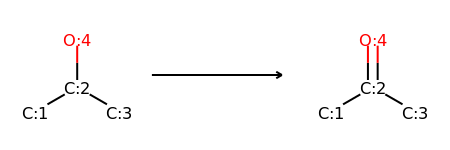

Product similarity 0.5666666666666667, overall 0.32111111111111107, smiles CC(=O)CC1(N)CCC1


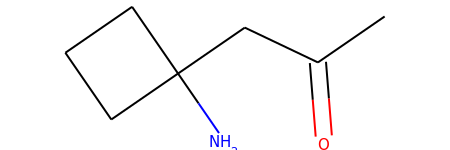

The proposed reaction is:


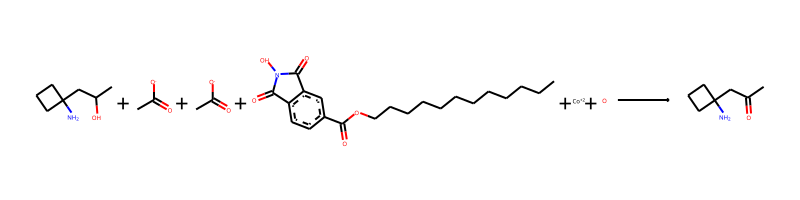

The reaction SMILES string is: CC(O)CC1(N)CCC1.CC(=O)[O-].CC(=O)[O-].CCCCCCCCCCCCOC(=O)c1ccc2c(c1)C(=O)N(O)C2=O.[Co+2].[O]>>CC(=O)CC1(N)CCC1


--------------------------------------------------

Train index: 408297
RANK 23 PRECEDENT
REACTANT MATCH SCORE: 0.5625


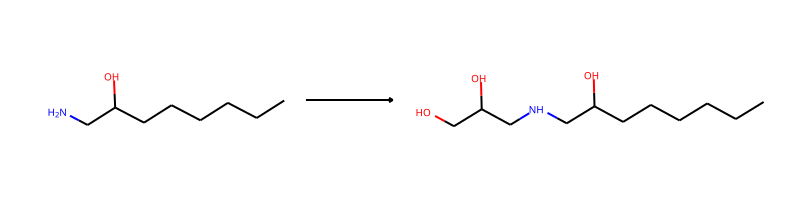

-> template: [C:2]-[NH2;D1;+0:1]>>O-C-C(-O)-C-[NH;D2;+0:1]-[C:2]


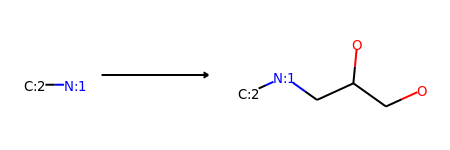

Product similarity 0.6595744680851063, overall 0.3710106382978723, smiles CC(O)CC1(NCC(O)CO)CCC1


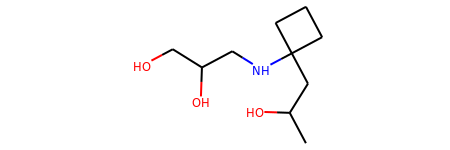

The proposed reaction is:


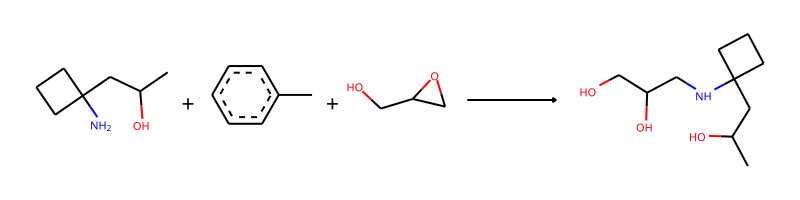

The reaction SMILES string is: CC(O)CC1(N)CCC1.Cc1ccccc1.OCC1CO1>>CC(O)CC1(NCC(O)CO)CCC1


--------------------------------------------------

Train index: 371135
RANK 24 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


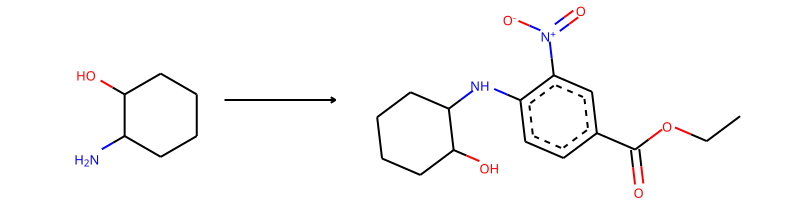

-> template: [C:2]-[NH2;D1;+0:1]>>C-C-O-C(=O)-c1:c:c:c(-[NH;D2;+0:1]-[C:2]):c(-[N+](=O)-[O-]):c:1


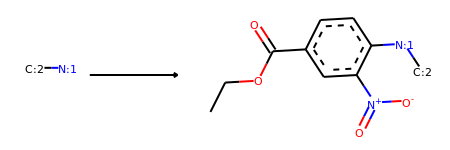

Product similarity 0.782608695652174, overall 0.431784107946027, smiles CCOC(=O)c1ccc(NC2(CC(C)O)CCC2)c([N+](=O)[O-])c1


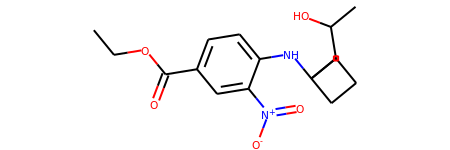

The proposed reaction is:


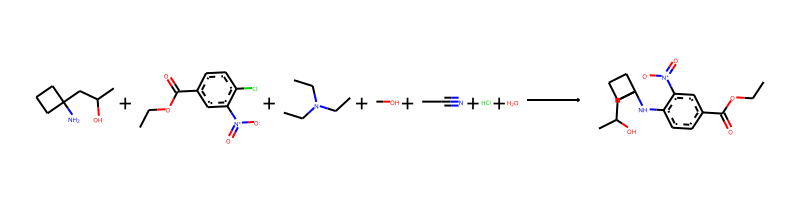

The reaction SMILES string is: CC(O)CC1(N)CCC1.CCOC(=O)c1ccc(Cl)c([N+](=O)[O-])c1.CCN(CC)CC.CO.CC#N.Cl.O>>CCOC(=O)c1ccc(NC2(CC(C)O)CCC2)c([N+](=O)[O-])c1


--------------------------------------------------

Train index: 456828
RANK 25 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


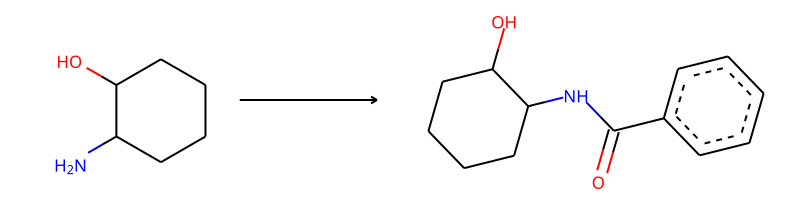

-> template: [C:2]-[NH2;D1;+0:1]>>O=C(-[NH;D2;+0:1]-[C:2])-c1:c:c:c:c:c:1


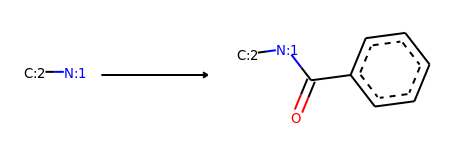

Product similarity 0.7222222222222222, overall 0.39846743295019155, smiles CC(O)CC1(NC(=O)c2ccccc2)CCC1


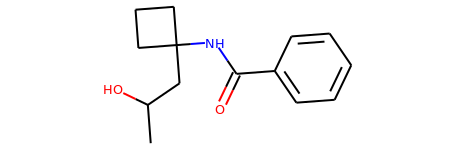

The proposed reaction is:


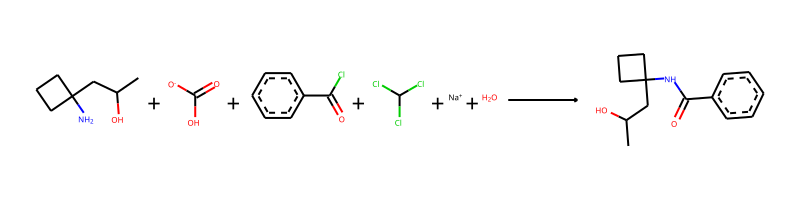

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C([O-])O.O=C(Cl)c1ccccc1.ClC(Cl)Cl.[Na+].O>>CC(O)CC1(NC(=O)c2ccccc2)CCC1


--------------------------------------------------

Train index: 475763
RANK 26 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


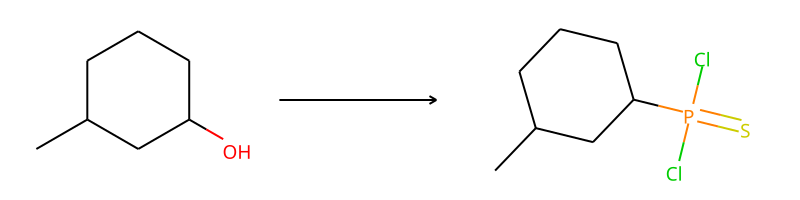

-> template: [C:2]-[CH;D3;+0:1](-[C:3])-[O;H1;D1;+0]>>Cl-P(-Cl)(=S)-[CH;D3;+0:1](-[C:2])-[C:3]


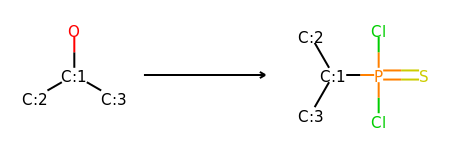

Product similarity 0.6388888888888888, overall 0.3524904214559387, smiles CC(CC1(N)CCC1)P(=S)(Cl)Cl


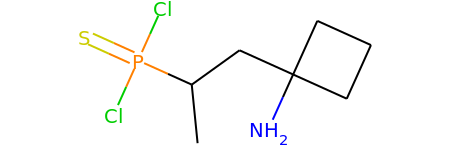

The proposed reaction is:


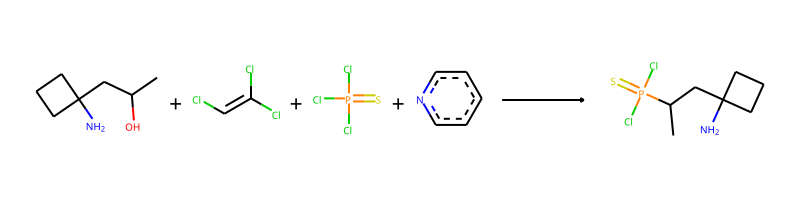

The reaction SMILES string is: CC(O)CC1(N)CCC1.ClC=C(Cl)Cl.S=P(Cl)(Cl)Cl.c1ccncc1>>CC(CC1(N)CCC1)P(=S)(Cl)Cl


--------------------------------------------------

Train index: 210655
RANK 27 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


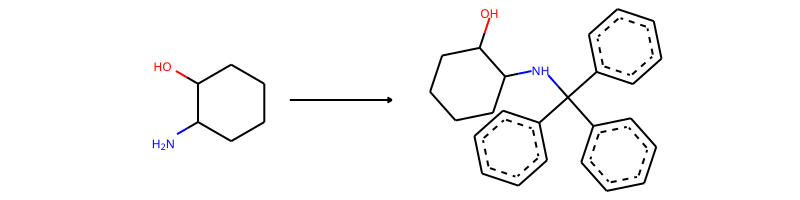

-> template: [C:1]-[NH2;D1;+0:2]>>[C:1]-[NH;D2;+0:2]-C(-c1:c:c:c:c:c:1)(-c1:c:c:c:c:c:1)-c1:c:c:c:c:c:1


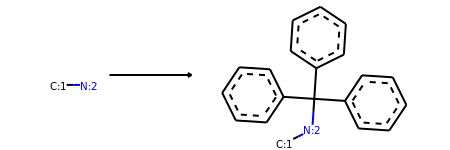

Product similarity 0.8295454545454546, overall 0.45768025078369906, smiles CC(O)CC1(NC(c2ccccc2)(c2ccccc2)c2ccccc2)CCC1


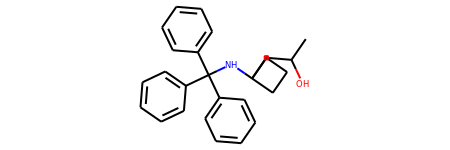

The proposed reaction is:


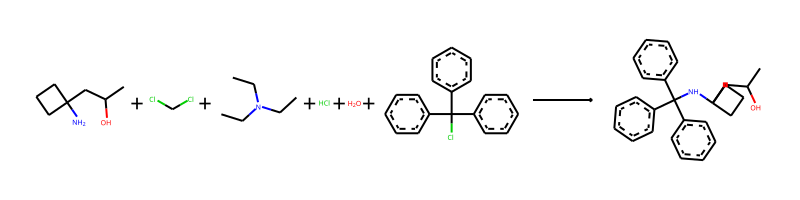

The reaction SMILES string is: CC(O)CC1(N)CCC1.ClCCl.CCN(CC)CC.Cl.O.ClC(c1ccccc1)(c1ccccc1)c1ccccc1>>CC(O)CC1(NC(c2ccccc2)(c2ccccc2)c2ccccc2)CCC1


--------------------------------------------------

Train index: 289100
RANK 28 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


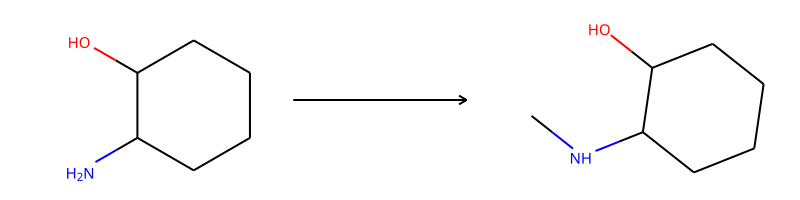

-> template: [C:2]-[NH2;D1;+0:1]>>C-[NH;D2;+0:1]-[C:2]


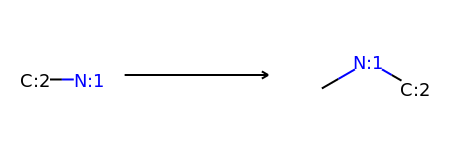

Product similarity 0.5454545454545454, overall 0.3009404388714733, smiles CNC1(CC(C)O)CCC1


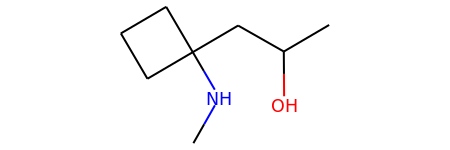

The proposed reaction is:


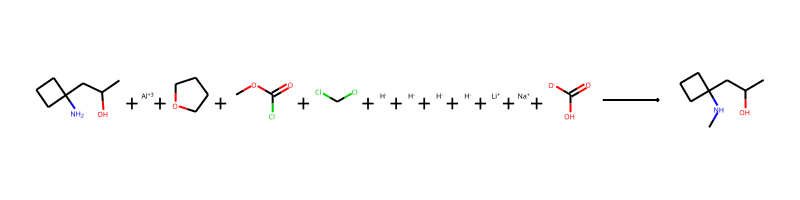

The reaction SMILES string is: CC(O)CC1(N)CCC1.[Al+3].C1CCOC1.COC(=O)Cl.ClCCl.[H-].[H-].[H-].[H-].[Li+].[Na+].O=C([O-])O>>CNC1(CC(C)O)CCC1


--------------------------------------------------

Train index: 39337
RANK 29 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


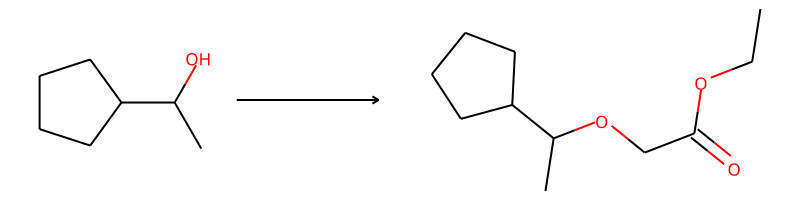

-> template: [C:2]-[OH;D1;+0:1]>>C-C-O-C(=O)-C-[O;H0;D2;+0:1]-[C:2]


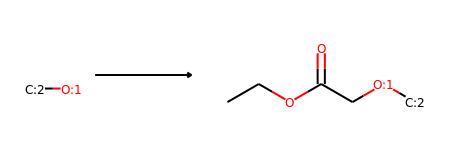

Product similarity 0.717391304347826, overall 0.3958020989505247, smiles CCOC(=O)COC(C)CC1(N)CCC1


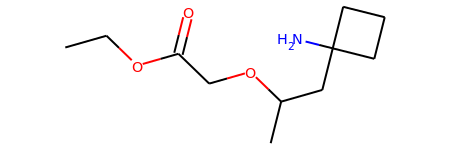

The proposed reaction is:


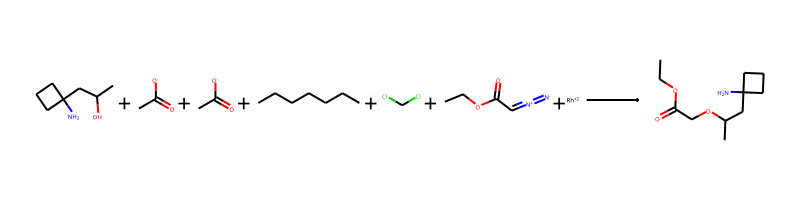

The reaction SMILES string is: CC(O)CC1(N)CCC1.CC(=O)[O-].CC(=O)[O-].CCCCCCC.ClCCl.CCOC(=O)C=[N+]=[N-].[Rh+2]>>CCOC(=O)COC(C)CC1(N)CCC1


--------------------------------------------------

Train index: 167628
RANK 30 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


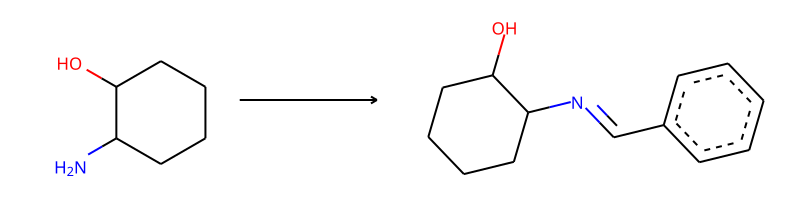

-> template: [C:1]-[NH2;D1;+0:2]>>[C:1]-[N;H0;D2;+0:2]=C-c1:c:c:c:c:c:1


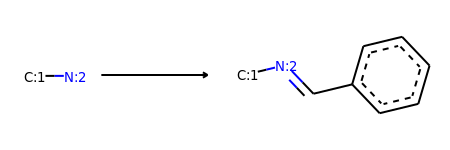

Product similarity 0.7115384615384616, overall 0.3925729442970822, smiles CC(O)CC1(N=Cc2ccccc2)CCC1


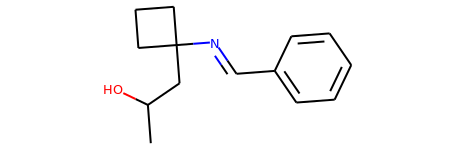

The proposed reaction is:


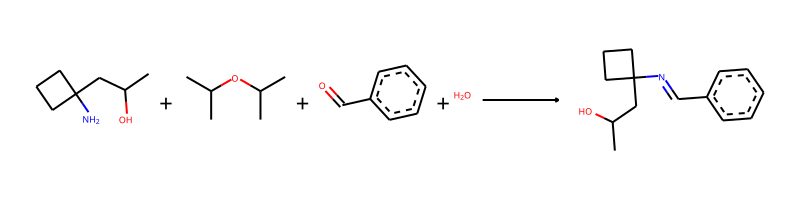

The reaction SMILES string is: CC(O)CC1(N)CCC1.CC(C)OC(C)C.O=Cc1ccccc1.O>>CC(O)CC1(N=Cc2ccccc2)CCC1


--------------------------------------------------

Train index: 172092
RANK 31 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


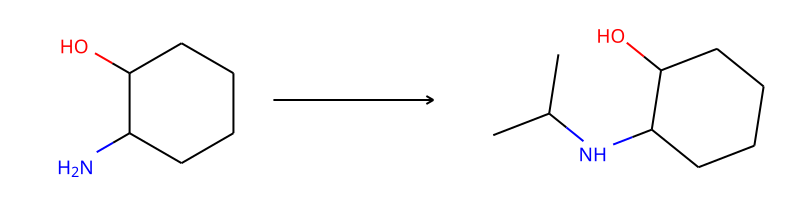

-> template: [C:2]-[NH2;D1;+0:1]>>C-C(-C)-[NH;D2;+0:1]-[C:2]


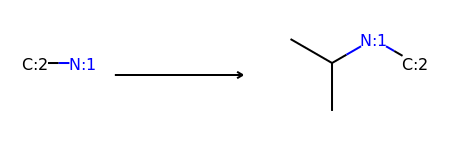

Product similarity 0.6052631578947368, overall 0.33393829401088926, smiles CC(O)CC1(NC(C)C)CCC1


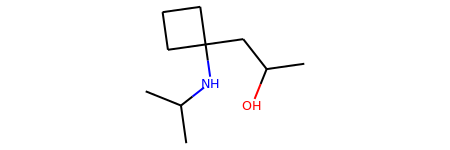

The proposed reaction is:


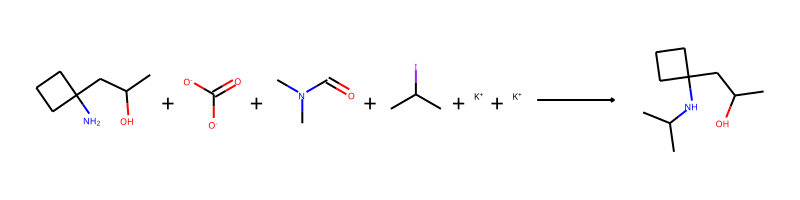

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C([O-])[O-].CN(C)C=O.CC(C)I.[K+].[K+]>>CC(O)CC1(NC(C)C)CCC1


--------------------------------------------------

Train index: 127715
RANK 32 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


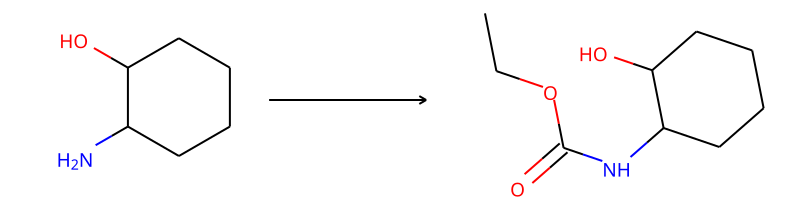

-> template: [C:2]-[NH2;D1;+0:1]>>C-C-O-C(=O)-[NH;D2;+0:1]-[C:2]


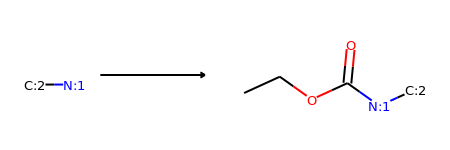

Product similarity 0.6590909090909091, overall 0.3636363636363636, smiles CCOC(=O)NC1(CC(C)O)CCC1


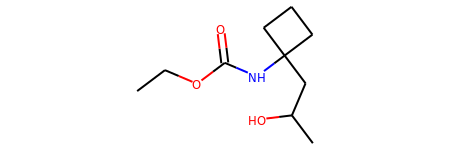

The proposed reaction is:


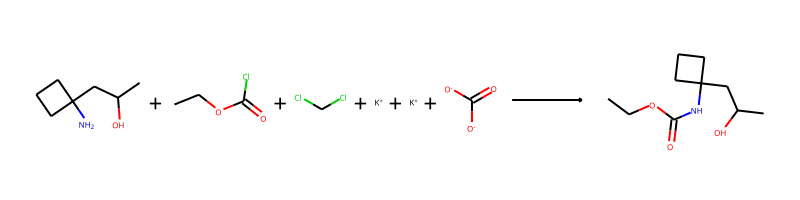

The reaction SMILES string is: CC(O)CC1(N)CCC1.CCOC(=O)Cl.ClCCl.[K+].[K+].O=C([O-])[O-]>>CCOC(=O)NC1(CC(C)O)CCC1


--------------------------------------------------

Train index: 198939
RANK 33 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


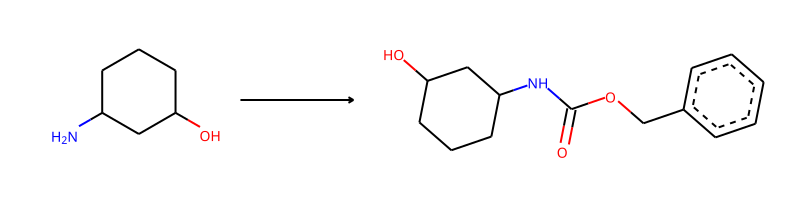

-> template: [C:2]-[NH2;D1;+0:1]>>O=C(-O-C-c1:c:c:c:c:c:1)-[NH;D2;+0:1]-[C:2]


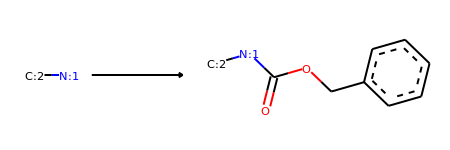

Product similarity 0.75, overall 0.41379310344827586, smiles CC(O)CC1(NC(=O)OCc2ccccc2)CCC1


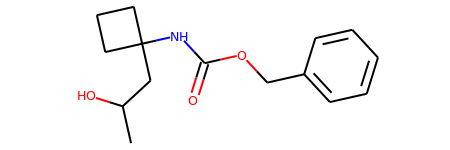

The proposed reaction is:


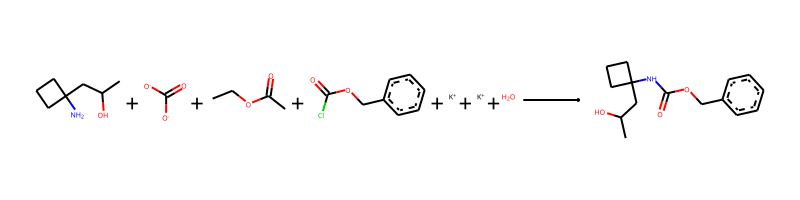

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C([O-])[O-].CCOC(C)=O.O=C(Cl)OCc1ccccc1.[K+].[K+].O>>CC(O)CC1(NC(=O)OCc2ccccc2)CCC1


--------------------------------------------------

Train index: 152611
RANK 34 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


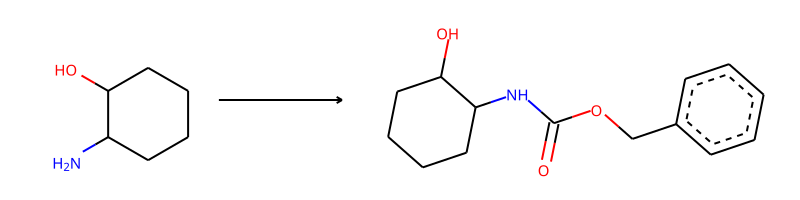

-> template: [C:2]-[NH2;D1;+0:1]>>O=C(-O-C-c1:c:c:c:c:c:1)-[NH;D2;+0:1]-[C:2]


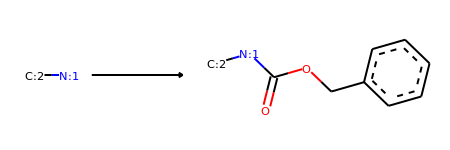

Product similarity 0.75, overall 0.41379310344827586, smiles CC(O)CC1(NC(=O)OCc2ccccc2)CCC1


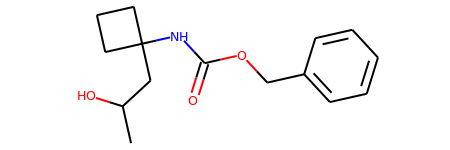

The proposed reaction is:


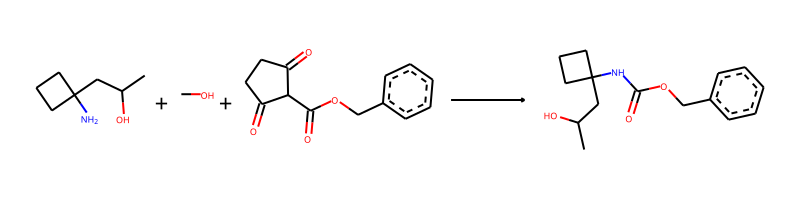

The reaction SMILES string is: CC(O)CC1(N)CCC1.CO.O=C1CCC(=O)C1C(=O)OCc1ccccc1>>CC(O)CC1(NC(=O)OCc2ccccc2)CCC1


--------------------------------------------------

Train index: 231221
RANK 35 PRECEDENT
REACTANT MATCH SCORE: 0.5483870967741935


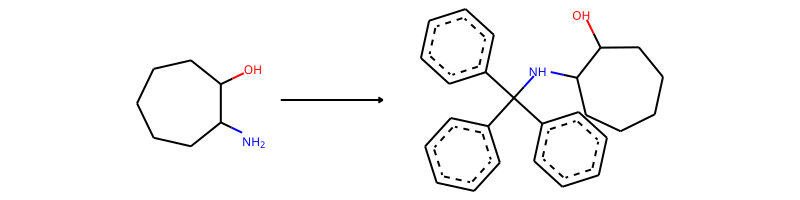

-> template: [C:1]-[NH2;D1;+0:2]>>[C:1]-[NH;D2;+0:2]-C(-c1:c:c:c:c:c:1)(-c1:c:c:c:c:c:1)-c1:c:c:c:c:c:1


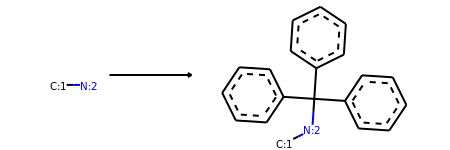

Product similarity 0.8222222222222222, overall 0.4508960573476702, smiles CC(O)CC1(NC(c2ccccc2)(c2ccccc2)c2ccccc2)CCC1


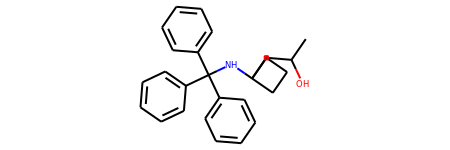

The proposed reaction is:


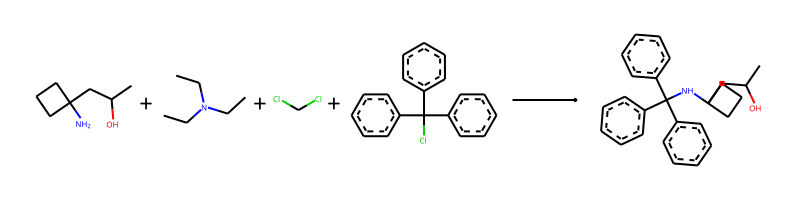

The reaction SMILES string is: CC(O)CC1(N)CCC1.CCN(CC)CC.ClCCl.ClC(c1ccccc1)(c1ccccc1)c1ccccc1>>CC(O)CC1(NC(c2ccccc2)(c2ccccc2)c2ccccc2)CCC1


--------------------------------------------------

Train index: 345476
RANK 36 PRECEDENT
REACTANT MATCH SCORE: 0.5172413793103449


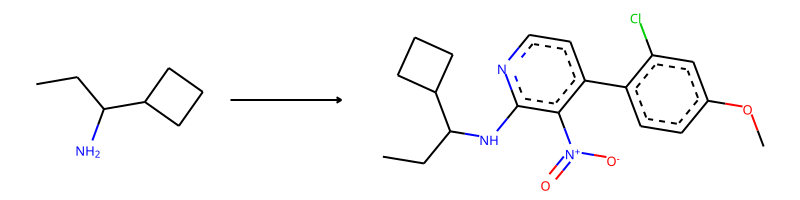

-> template: [C:2]-[NH2;D1;+0:1]>>C-O-c1:c:c:c(-c2:c:c:n:c(-[NH;D2;+0:1]-[C:2]):c:2-[N+](=O)-[O-]):c(-Cl):c:1


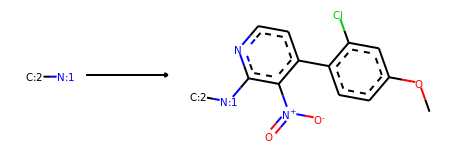

Product similarity 0.8024691358024691, overall 0.4150702426564496, smiles COc1ccc(-c2ccnc(NC3(CC(C)O)CCC3)c2[N+](=O)[O-])c(Cl)c1


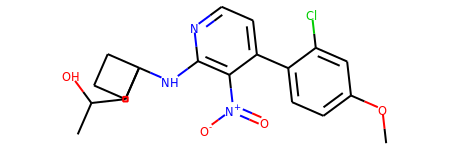

The proposed reaction is:


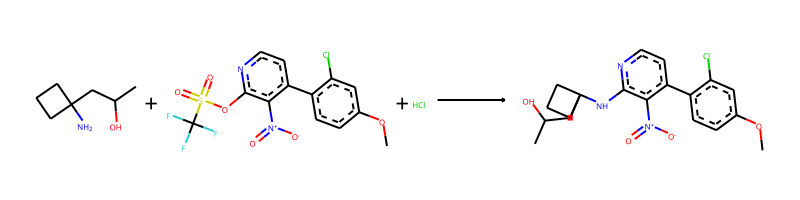

The reaction SMILES string is: CC(O)CC1(N)CCC1.COc1ccc(-c2ccnc(OS(=O)(=O)C(F)(F)F)c2[N+](=O)[O-])c(Cl)c1.Cl>>COc1ccc(-c2ccnc(NC3(CC(C)O)CCC3)c2[N+](=O)[O-])c(Cl)c1


--------------------------------------------------

Train index: 60472
RANK 37 PRECEDENT
REACTANT MATCH SCORE: 0.5172413793103449


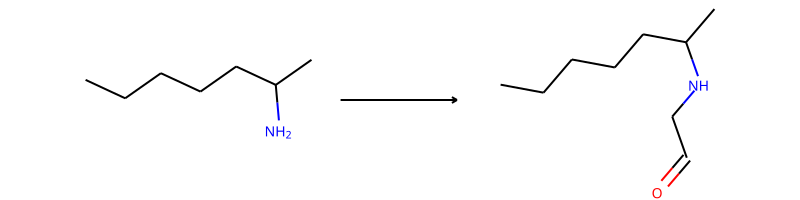

-> template: [C:2]-[NH2;D1;+0:1]>>O=C-C-[NH;D2;+0:1]-[C:2]


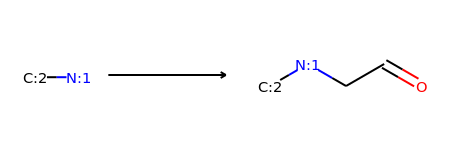

Product similarity 0.5897435897435898, overall 0.3050397877984085, smiles CC(O)CC1(NCC=O)CCC1


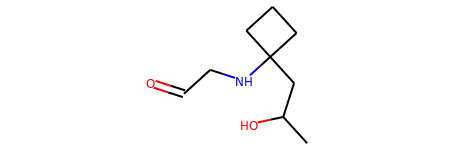

The proposed reaction is:


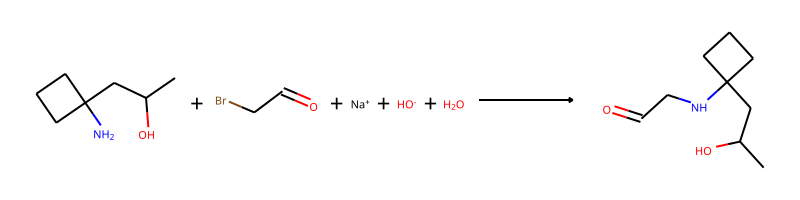

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=CCBr.[Na+].[OH-].O>>CC(O)CC1(NCC=O)CCC1


--------------------------------------------------

Train index: 337504
RANK 38 PRECEDENT
REACTANT MATCH SCORE: 0.5172413793103449


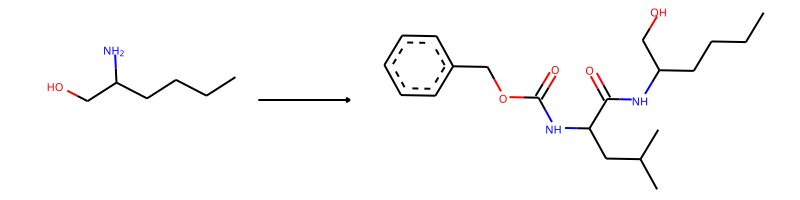

-> template: [C:2]-[NH2;D1;+0:1]>>C-C(-C)-C-C(-N-C(=O)-O-C-c1:c:c:c:c:c:1)-C(=O)-[NH;D2;+0:1]-[C:2]


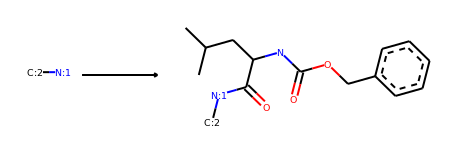

Product similarity 0.8024691358024691, overall 0.4150702426564496, smiles CC(C)CC(NC(=O)OCc1ccccc1)C(=O)NC1(CC(C)O)CCC1


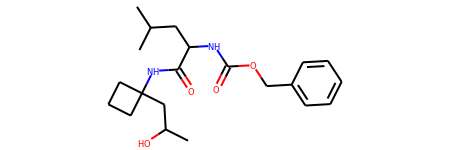

The proposed reaction is:


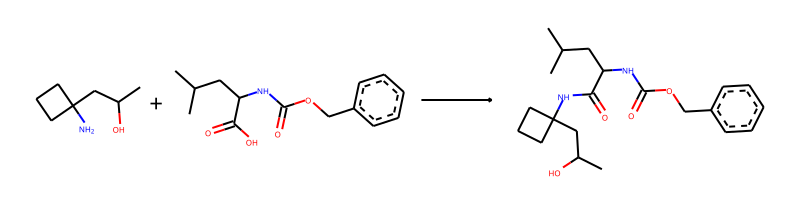

The reaction SMILES string is: CC(O)CC1(N)CCC1.CC(C)CC(NC(=O)OCc1ccccc1)C(=O)O>>CC(C)CC(NC(=O)OCc1ccccc1)C(=O)NC1(CC(C)O)CCC1


--------------------------------------------------

Train index: 303729
RANK 39 PRECEDENT
REACTANT MATCH SCORE: 0.5172413793103449


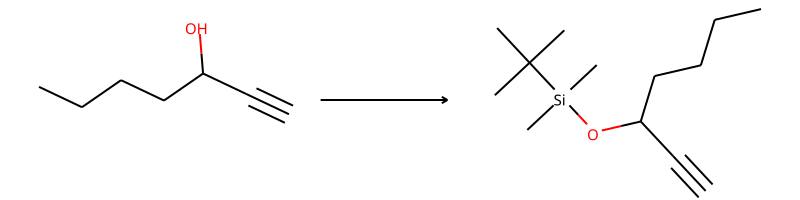

-> template: [C;D1;H1:4]#[C:3]-[C:2]-[OH;D1;+0:1]>>C-C(-C)(-C)-[Si](-C)(-C)-[O;H0;D2;+0:1]-[C:2]-[C:3]#[C;D1;H1:4]


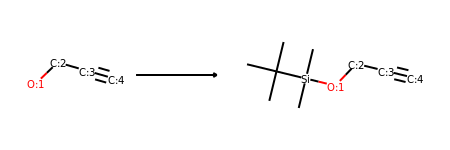

->No precursors could be generated!


--------------------------------------------------

Train index: 348123
RANK 40 PRECEDENT
REACTANT MATCH SCORE: 0.5172413793103449


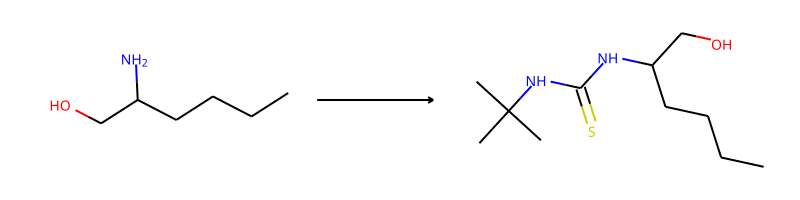

-> template: [C:2]-[NH2;D1;+0:1]>>C-C(-C)(-C)-N-C(=S)-[NH;D2;+0:1]-[C:2]


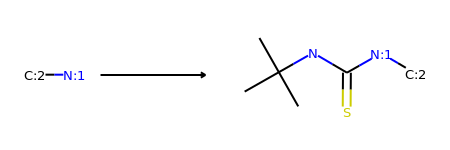

Product similarity 0.6666666666666666, overall 0.3448275862068966, smiles CC(O)CC1(NC(=S)NC(C)(C)C)CCC1


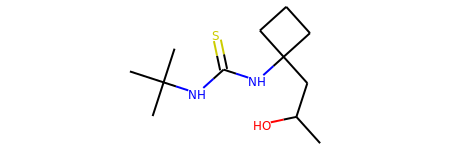

The proposed reaction is:


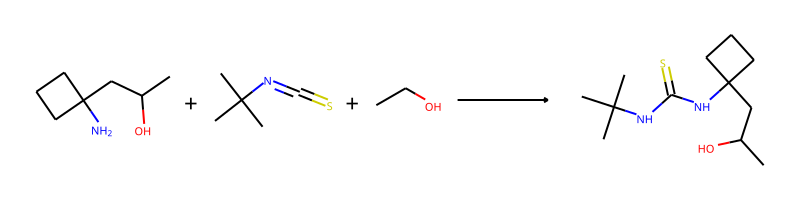

The reaction SMILES string is: CC(O)CC1(N)CCC1.CC(C)(C)N=C=S.CCO>>CC(O)CC1(NC(=S)NC(C)(C)C)CCC1


--------------------------------------------------

Train index: 24716
RANK 41 PRECEDENT
REACTANT MATCH SCORE: 0.5172413793103449


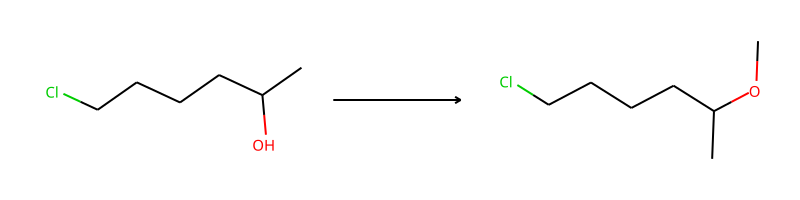

-> template: [C:2]-[OH;D1;+0:1]>>C-[O;H0;D2;+0:1]-[C:2]


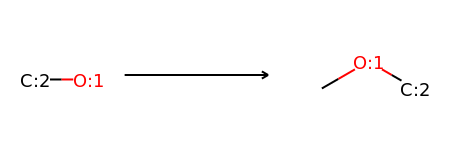

Product similarity 0.5625, overall 0.290948275862069, smiles COC(C)CC1(N)CCC1


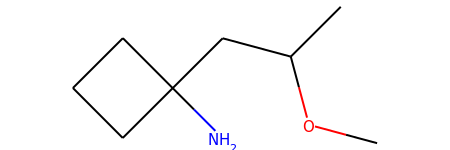

The proposed reaction is:


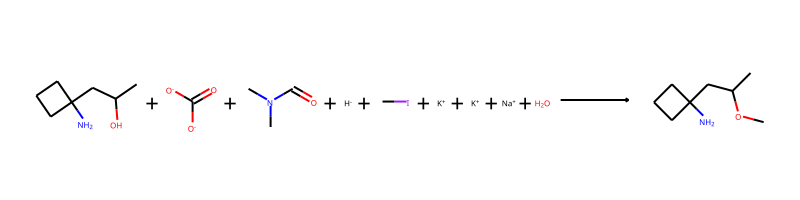

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C([O-])[O-].CN(C)C=O.[H-].CI.[K+].[K+].[Na+].O>>COC(C)CC1(N)CCC1


--------------------------------------------------

Train index: 434160
RANK 42 PRECEDENT
REACTANT MATCH SCORE: 0.5172413793103449


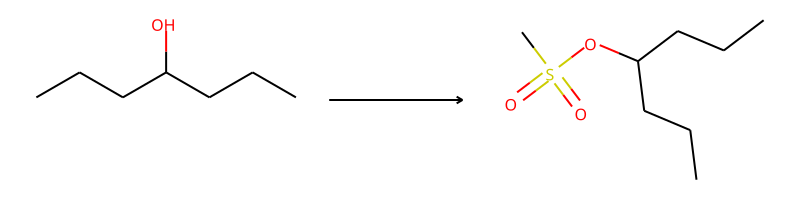

-> template: [C:2]-[OH;D1;+0:1]>>C-S(=O)(=O)-[O;H0;D2;+0:1]-[C:2]


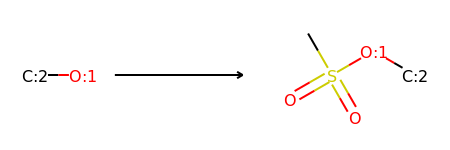

Product similarity 0.6410256410256411, overall 0.3315649867374006, smiles CC(CC1(N)CCC1)OS(C)(=O)=O


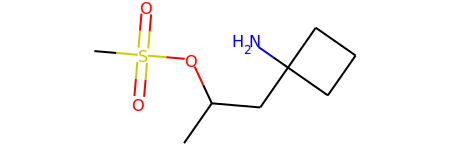

The proposed reaction is:


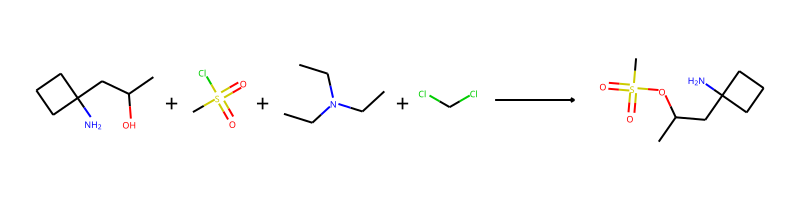

The reaction SMILES string is: CC(O)CC1(N)CCC1.CS(=O)(=O)Cl.CCN(CC)CC.ClCCl>>CC(CC1(N)CCC1)OS(C)(=O)=O


--------------------------------------------------

Train index: 40816
RANK 43 PRECEDENT
REACTANT MATCH SCORE: 0.5172413793103449


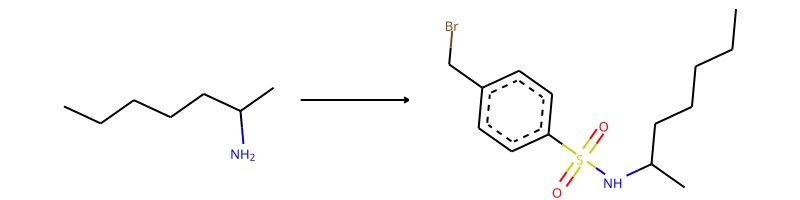

-> template: [C:2]-[NH2;D1;+0:1]>>Br-C-c1:c:c:c(-S(=O)(=O)-[NH;D2;+0:1]-[C:2]):c:c:1


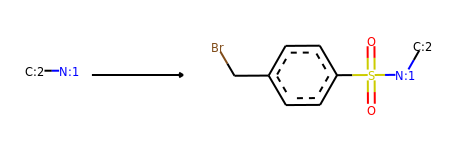

Product similarity 0.7377049180327869, overall 0.3815715093273036, smiles CC(O)CC1(NS(=O)(=O)c2ccc(CBr)cc2)CCC1


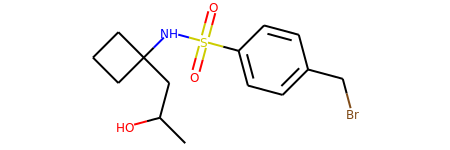

The proposed reaction is:


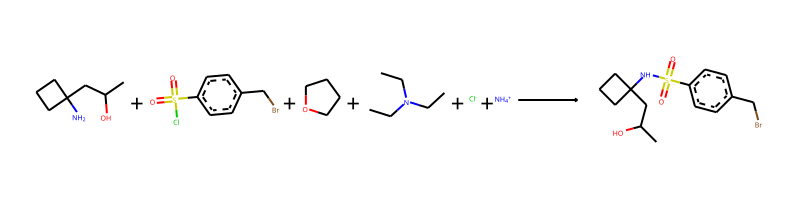

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=S(=O)(Cl)c1ccc(CBr)cc1.C1CCOC1.CCN(CC)CC.[Cl-].[NH4+]>>CC(O)CC1(NS(=O)(=O)c2ccc(CBr)cc2)CCC1


--------------------------------------------------

Train index: 342187
RANK 44 PRECEDENT
REACTANT MATCH SCORE: 0.5172413793103449


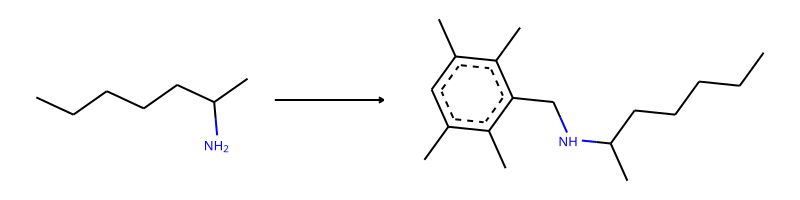

-> template: [C:2]-[NH2;D1;+0:1]>>C-c1:c:c(-C):c(-C):c(-C-[NH;D2;+0:1]-[C:2]):c:1-C


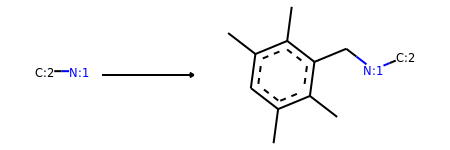

Product similarity 0.7333333333333333, overall 0.3793103448275862, smiles Cc1cc(C)c(C)c(CNC2(CC(C)O)CCC2)c1C


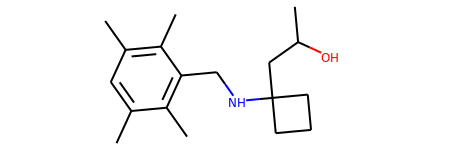

The proposed reaction is:


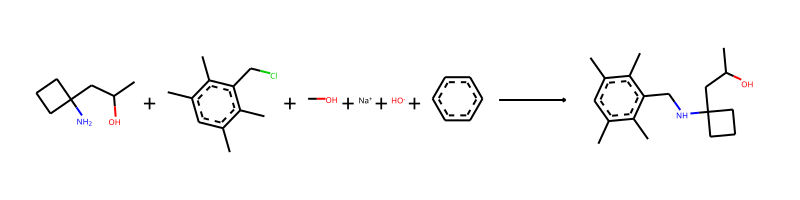

The reaction SMILES string is: CC(O)CC1(N)CCC1.Cc1cc(C)c(C)c(CCl)c1C.CO.[Na+].[OH-].c1ccccc1>>Cc1cc(C)c(C)c(CNC2(CC(C)O)CCC2)c1C


--------------------------------------------------

Train index: 262103
RANK 45 PRECEDENT
REACTANT MATCH SCORE: 0.5172413793103449


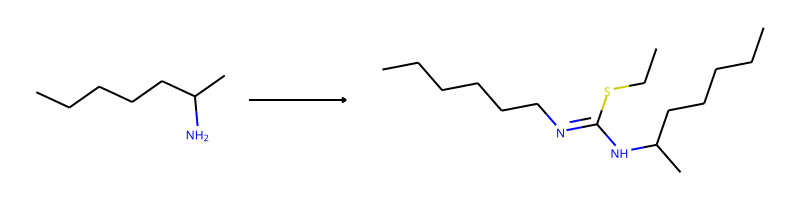

-> template: [C:2]-[NH2;D1;+0:1]>>C-C-C-C-C-C-N=C(-S-C-C)-[NH;D2;+0:1]-[C:2]


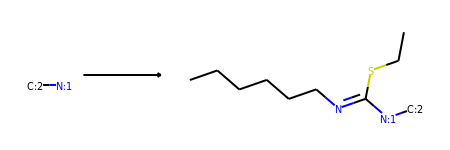

Product similarity 0.7419354838709677, overall 0.38375973303670746, smiles CCCCCCN=C(NC1(CC(C)O)CCC1)SCC


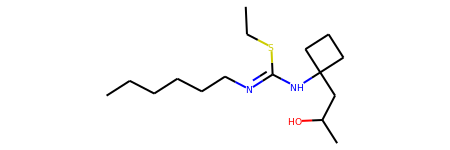

The proposed reaction is:


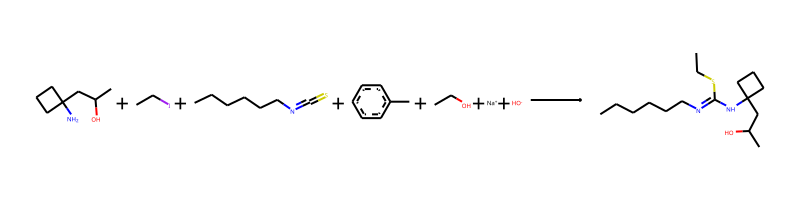

The reaction SMILES string is: CC(O)CC1(N)CCC1.CCI.CCCCCCN=C=S.Cc1ccccc1.CCO.[Na+].[OH-]>>CCCCCCN=C(NC1(CC(C)O)CCC1)SCC


--------------------------------------------------

Train index: 452898
RANK 46 PRECEDENT
REACTANT MATCH SCORE: 0.5161290322580645


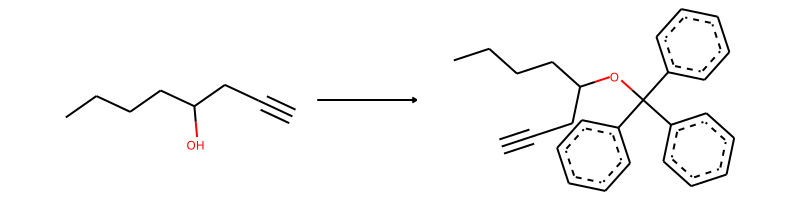

-> template: [C:1]-[OH;D1;+0:2]>>[C:1]-[O;H0;D2;+0:2]-C(-c1:c:c:c:c:c:1)(-c1:c:c:c:c:c:1)-c1:c:c:c:c:c:1


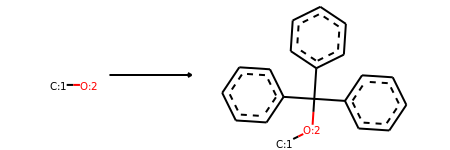

Product similarity 0.8314606741573034, overall 0.4291409931134469, smiles CC(CC1(N)CCC1)OC(c1ccccc1)(c1ccccc1)c1ccccc1


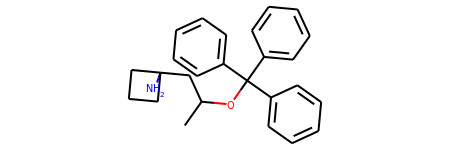

The proposed reaction is:


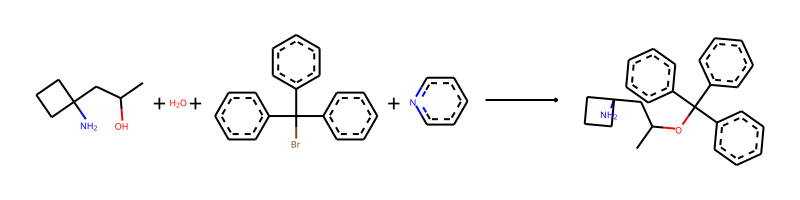

The reaction SMILES string is: CC(O)CC1(N)CCC1.O.BrC(c1ccccc1)(c1ccccc1)c1ccccc1.c1ccncc1>>CC(CC1(N)CCC1)OC(c1ccccc1)(c1ccccc1)c1ccccc1


--------------------------------------------------

Train index: 314449
RANK 47 PRECEDENT
REACTANT MATCH SCORE: 0.5161290322580645


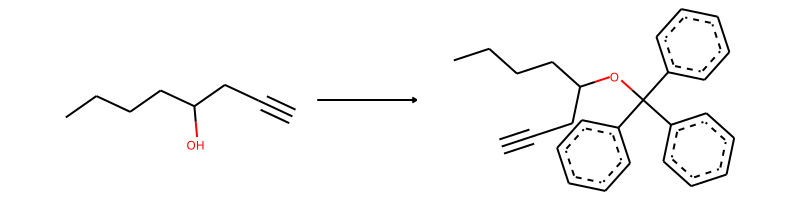

-> template: [C:1]-[OH;D1;+0:2]>>[C:1]-[O;H0;D2;+0:2]-C(-c1:c:c:c:c:c:1)(-c1:c:c:c:c:c:1)-c1:c:c:c:c:c:1


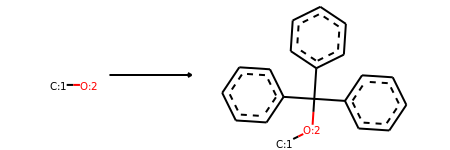

Product similarity 0.8314606741573034, overall 0.4291409931134469, smiles CC(CC1(N)CCC1)OC(c1ccccc1)(c1ccccc1)c1ccccc1


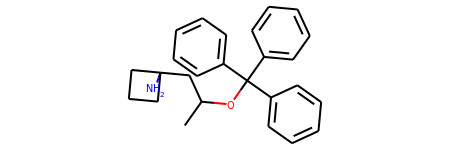

The proposed reaction is:


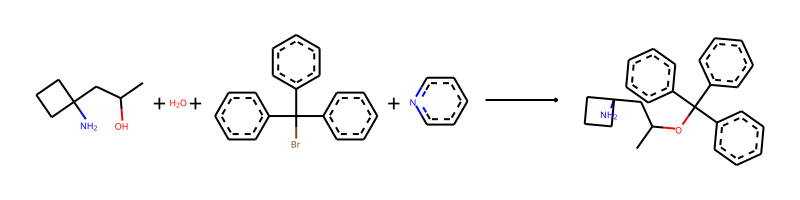

The reaction SMILES string is: CC(O)CC1(N)CCC1.O.BrC(c1ccccc1)(c1ccccc1)c1ccccc1.c1ccncc1>>CC(CC1(N)CCC1)OC(c1ccccc1)(c1ccccc1)c1ccccc1


--------------------------------------------------

Train index: 343520
RANK 48 PRECEDENT
REACTANT MATCH SCORE: 0.5161290322580645


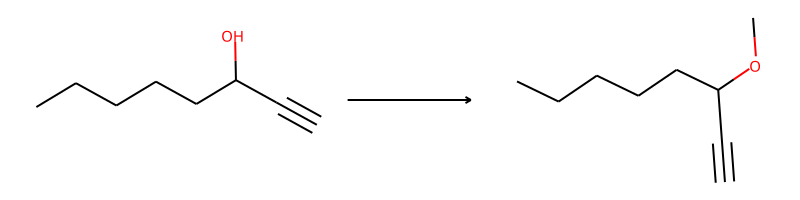

-> template: [C;D1;H1:4]#[C:3]-[C:2]-[OH;D1;+0:1]>>C-[O;H0;D2;+0:1]-[C:2]-[C:3]#[C;D1;H1:4]


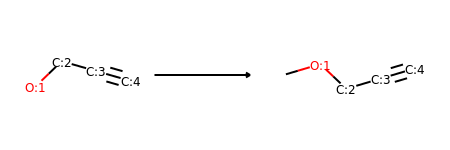

->No precursors could be generated!


--------------------------------------------------

Train index: 200925
RANK 49 PRECEDENT
REACTANT MATCH SCORE: 0.5161290322580645


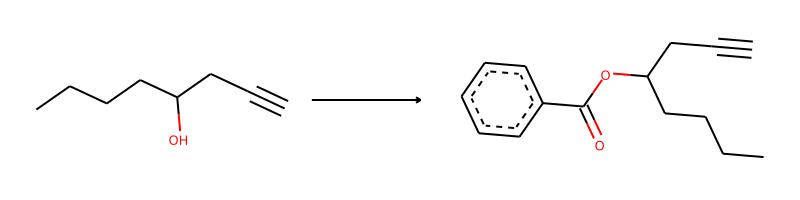

-> template: [C:2]-[OH;D1;+0:1]>>O=C(-[O;H0;D2;+0:1]-[C:2])-c1:c:c:c:c:c:1


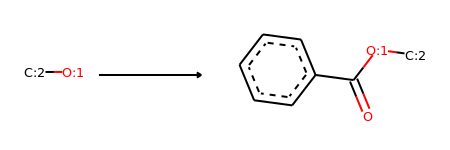

Product similarity 0.7272727272727273, overall 0.375366568914956, smiles CC(CC1(N)CCC1)OC(=O)c1ccccc1


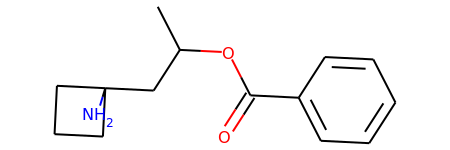

The proposed reaction is:


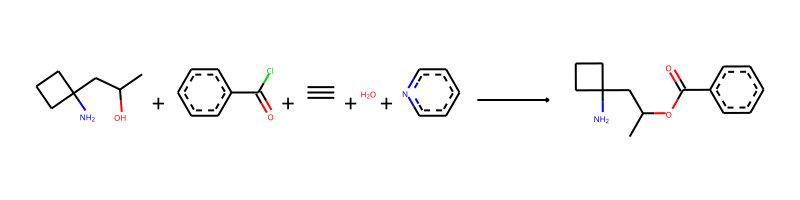

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C(Cl)c1ccccc1.C#C.O.c1ccncc1>>CC(CC1(N)CCC1)OC(=O)c1ccccc1


--------------------------------------------------

Train index: 93201
RANK 50 PRECEDENT
REACTANT MATCH SCORE: 0.5161290322580645


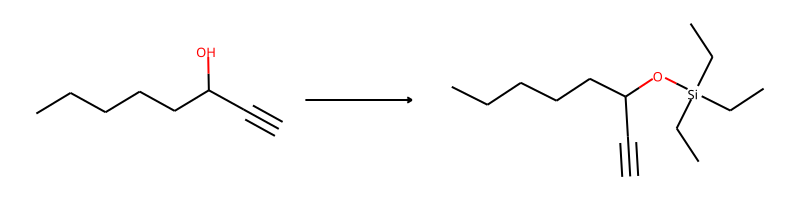

-> template: [C;D1;H1:4]#[C:3]-[C:2]-[OH;D1;+0:1]>>C-C-[Si](-C-C)(-C-C)-[O;H0;D2;+0:1]-[C:2]-[C:3]#[C;D1;H1:4]


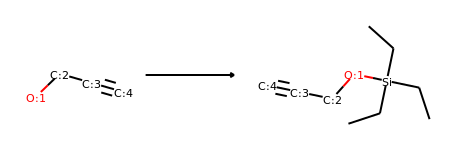

->No precursors could be generated!


--------------------------------------------------

Train index: 114377
RANK 51 PRECEDENT
REACTANT MATCH SCORE: 0.5161290322580645


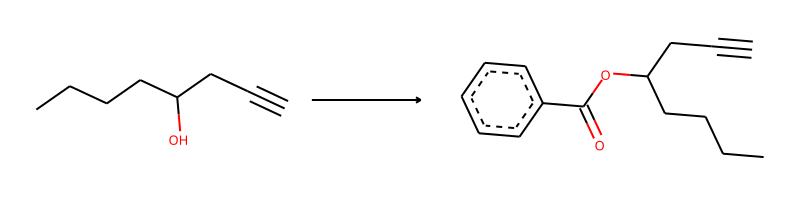

-> template: [C:2]-[OH;D1;+0:1]>>O=C(-[O;H0;D2;+0:1]-[C:2])-c1:c:c:c:c:c:1


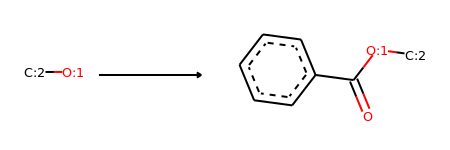

Product similarity 0.7272727272727273, overall 0.375366568914956, smiles CC(CC1(N)CCC1)OC(=O)c1ccccc1


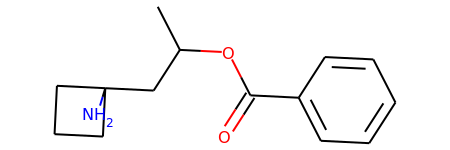

The proposed reaction is:


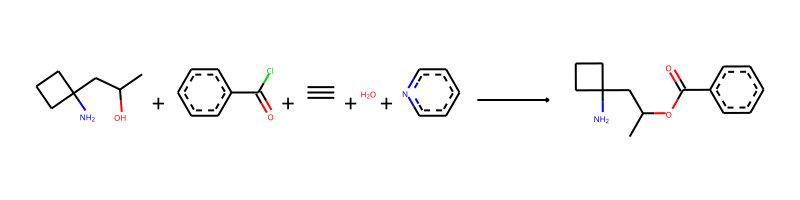

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C(Cl)c1ccccc1.C#C.O.c1ccncc1>>CC(CC1(N)CCC1)OC(=O)c1ccccc1


--------------------------------------------------

Train index: 307732
RANK 52 PRECEDENT
REACTANT MATCH SCORE: 0.5161290322580645


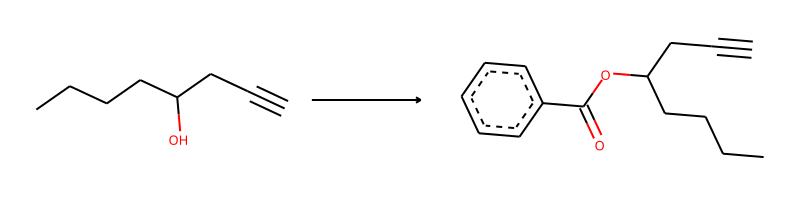

-> template: [C:2]-[OH;D1;+0:1]>>O=C(-[O;H0;D2;+0:1]-[C:2])-c1:c:c:c:c:c:1


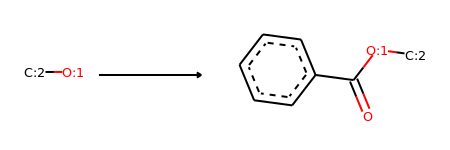

Product similarity 0.7272727272727273, overall 0.375366568914956, smiles CC(CC1(N)CCC1)OC(=O)c1ccccc1


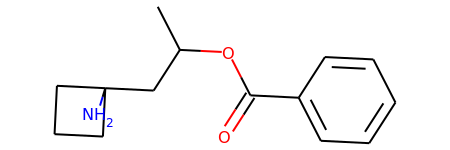

The proposed reaction is:


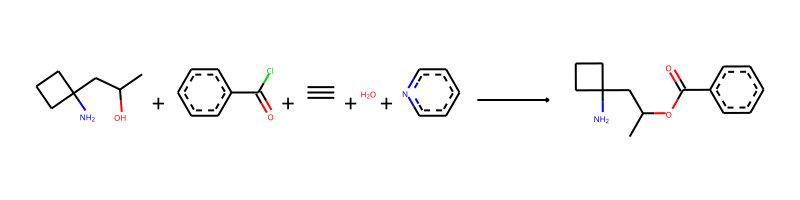

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C(Cl)c1ccccc1.C#C.O.c1ccncc1>>CC(CC1(N)CCC1)OC(=O)c1ccccc1


--------------------------------------------------

Train index: 81991
RANK 53 PRECEDENT
REACTANT MATCH SCORE: 0.5161290322580645


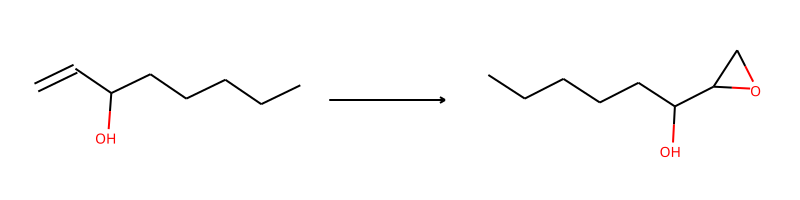

-> template: [C:1]-[CH;D2;+0:2]=[CH2;D1;+0:3]>>[C:1]-[CH;D3;+0:2]1-O-[CH2;D2;+0:3]-1


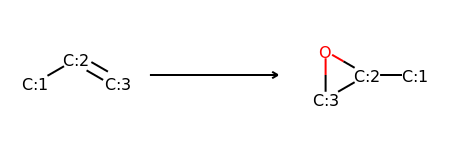

->No precursors could be generated!


--------------------------------------------------

Train index: 432407
RANK 54 PRECEDENT
REACTANT MATCH SCORE: 0.5161290322580645


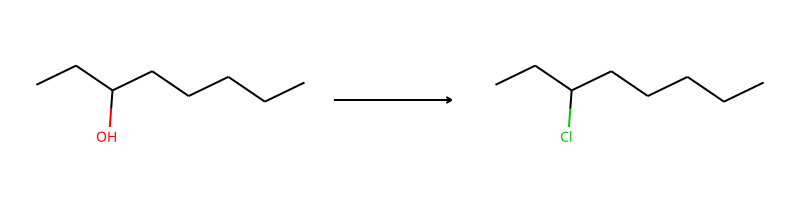

-> template: [C:2]-[CH;D3;+0:1](-[C:3])-[O;H1;D1;+0]>>Cl-[CH;D3;+0:1](-[C:2])-[C:3]


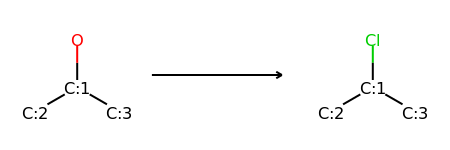

Product similarity 0.5161290322580645, overall 0.26638917793964617, smiles CC(Cl)CC1(N)CCC1


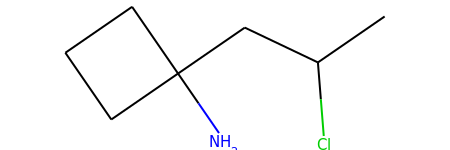

The proposed reaction is:


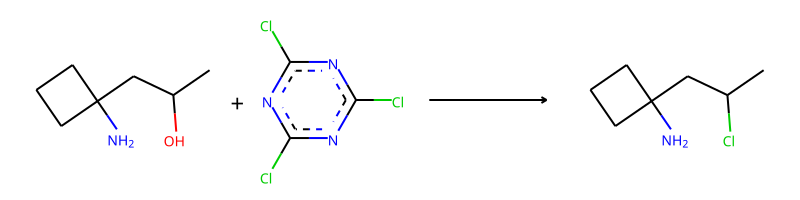

The reaction SMILES string is: CC(O)CC1(N)CCC1.Clc1nc(Cl)nc(Cl)n1>>CC(Cl)CC1(N)CCC1


--------------------------------------------------

Train index: 46963
RANK 55 PRECEDENT
REACTANT MATCH SCORE: 0.5


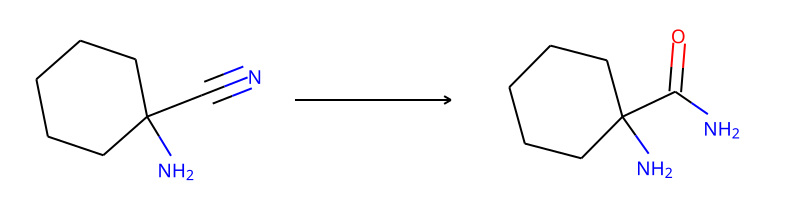

-> template: [C:2]-[C;H0;D2;+0:1]#[N;H0;D1;+0:3]>>O=[C;H0;D3;+0:1](-[C:2])-[NH2;D1;+0:3]


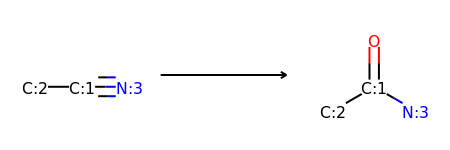

->No precursors could be generated!


--------------------------------------------------

Train index: 16190
RANK 56 PRECEDENT
REACTANT MATCH SCORE: 0.5


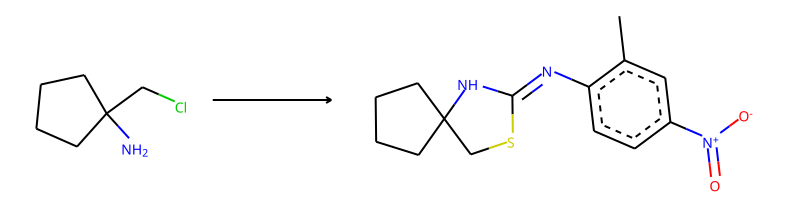

-> template: [Cl;H0;D1;+0]-[CH2;D2;+0:1]-[C:2]-[NH2;D1;+0:3]>>C-c1:c:c(-[N+](=O)-[O-]):c:c:c:1-N=C1-S-[CH2;D2;+0:1]-[C:2]-[NH;D2;+0:3]-1


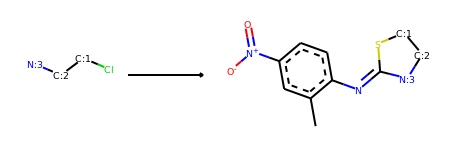

->No precursors could be generated!


--------------------------------------------------

Train index: 437401
RANK 57 PRECEDENT
REACTANT MATCH SCORE: 0.5


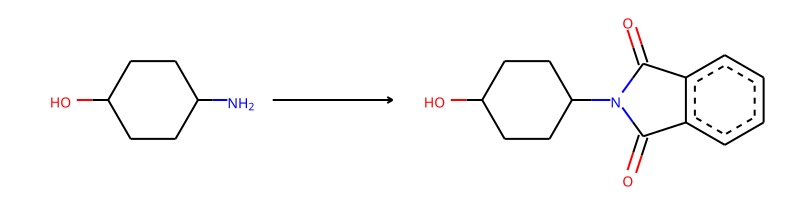

-> template: [C:2]-[NH2;D1;+0:1]>>O=C1-[N;H0;D3;+0:1](-[C:2])-C(=O)-c2:c:c:c:c:c:2-1


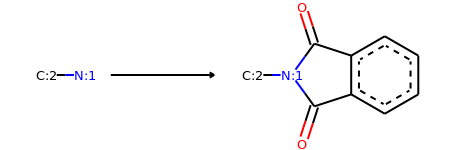

Product similarity 0.7166666666666667, overall 0.35833333333333334, smiles CC(O)CC1(N2C(=O)c3ccccc3C2=O)CCC1


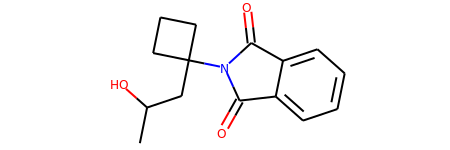

The proposed reaction is:


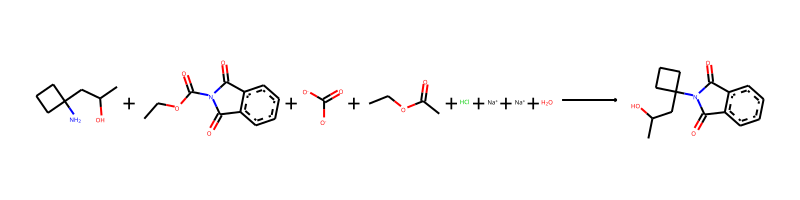

The reaction SMILES string is: CC(O)CC1(N)CCC1.CCOC(=O)N1C(=O)c2ccccc2C1=O.O=C([O-])[O-].CCOC(C)=O.Cl.[Na+].[Na+].O>>CC(O)CC1(N2C(=O)c3ccccc3C2=O)CCC1


--------------------------------------------------

Train index: 278666
RANK 58 PRECEDENT
REACTANT MATCH SCORE: 0.5


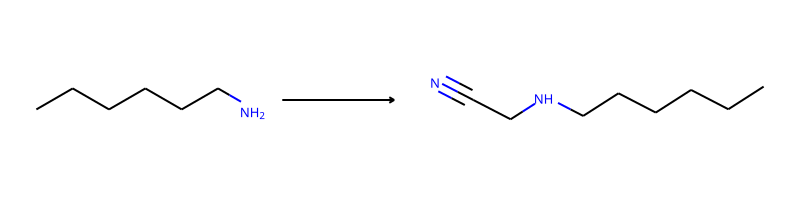

-> template: [C:2]-[NH2;D1;+0:1]>>N#C-C-[NH;D2;+0:1]-[C:2]


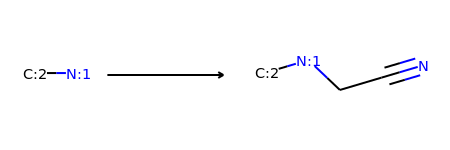

Product similarity 0.5789473684210527, overall 0.2894736842105263, smiles CC(O)CC1(NCC#N)CCC1


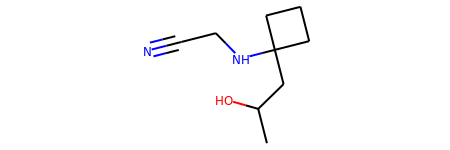

The proposed reaction is:


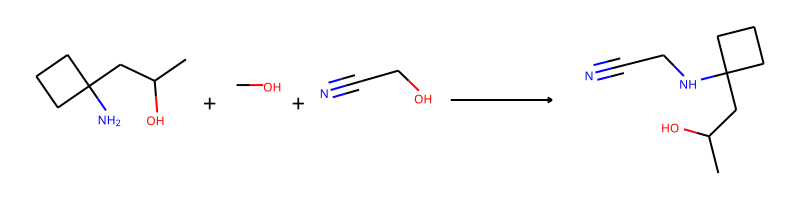

The reaction SMILES string is: CC(O)CC1(N)CCC1.CO.N#CCO>>CC(O)CC1(NCC#N)CCC1


--------------------------------------------------

Train index: 175957
RANK 59 PRECEDENT
REACTANT MATCH SCORE: 0.5


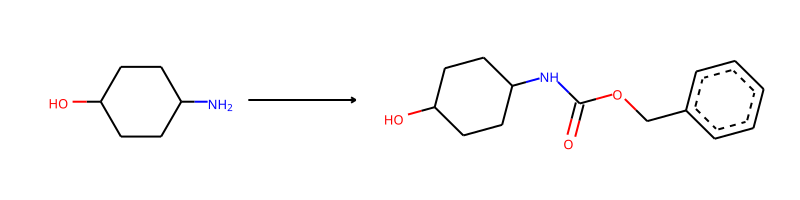

-> template: [C:2]-[NH2;D1;+0:1]>>O=C(-O-C-c1:c:c:c:c:c:1)-[NH;D2;+0:1]-[C:2]


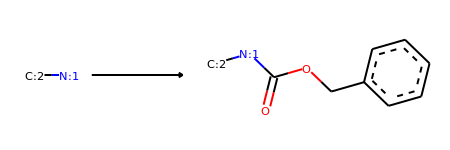

Product similarity 0.7213114754098361, overall 0.36065573770491804, smiles CC(O)CC1(NC(=O)OCc2ccccc2)CCC1


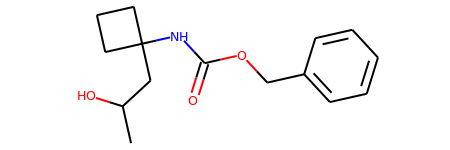

The proposed reaction is:


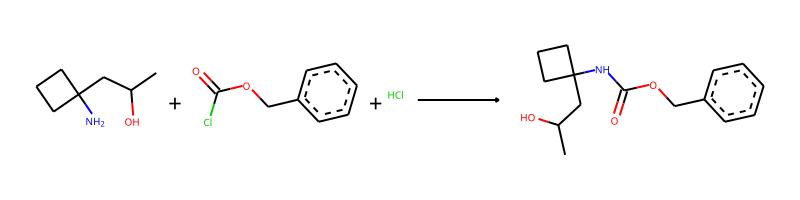

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C(Cl)OCc1ccccc1.Cl>>CC(O)CC1(NC(=O)OCc2ccccc2)CCC1


--------------------------------------------------

Train index: 469844
RANK 60 PRECEDENT
REACTANT MATCH SCORE: 0.5


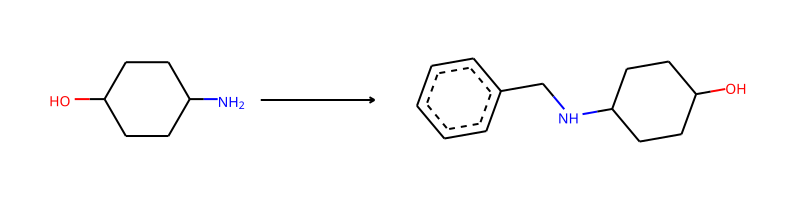

-> template: [C:1]-[NH2;D1;+0:2]>>[C:1]-[NH;D2;+0:2]-C-c1:c:c:c:c:c:1


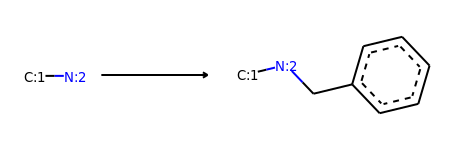

Product similarity 0.6792452830188679, overall 0.33962264150943394, smiles CC(O)CC1(NCc2ccccc2)CCC1


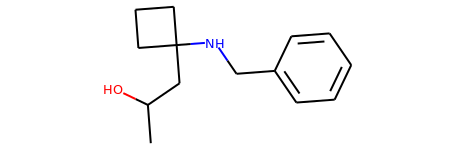

The proposed reaction is:


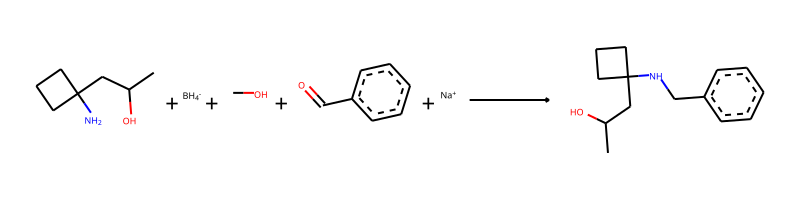

The reaction SMILES string is: CC(O)CC1(N)CCC1.[BH4-].CO.O=Cc1ccccc1.[Na+]>>CC(O)CC1(NCc2ccccc2)CCC1


--------------------------------------------------

Train index: 393304
RANK 61 PRECEDENT
REACTANT MATCH SCORE: 0.5


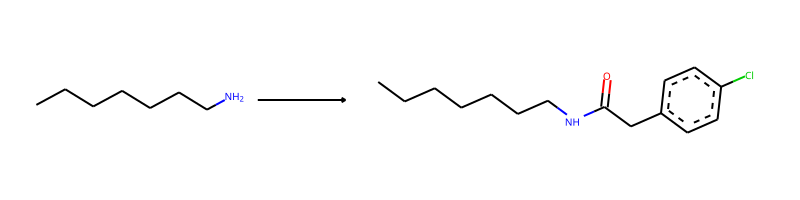

-> template: [C:2]-[NH2;D1;+0:1]>>Cl-c1:c:c:c(-C-C(=O)-[NH;D2;+0:1]-[C:2]):c:c:1


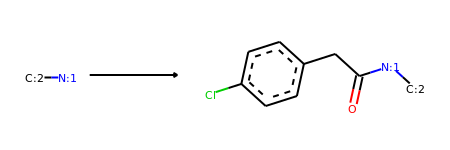

Product similarity 0.7166666666666667, overall 0.35833333333333334, smiles CC(O)CC1(NC(=O)Cc2ccc(Cl)cc2)CCC1


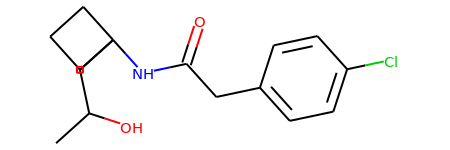

The proposed reaction is:


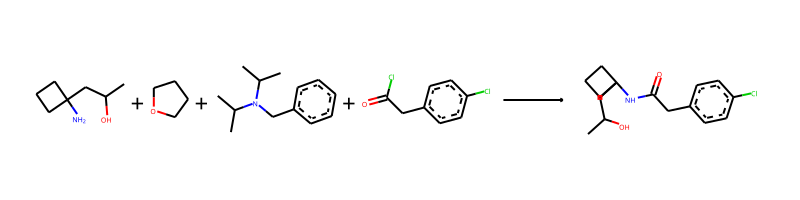

The reaction SMILES string is: CC(O)CC1(N)CCC1.C1CCOC1.CC(C)N(Cc1ccccc1)C(C)C.O=C(Cl)Cc1ccc(Cl)cc1>>CC(O)CC1(NC(=O)Cc2ccc(Cl)cc2)CCC1


--------------------------------------------------

Train index: 32462
RANK 62 PRECEDENT
REACTANT MATCH SCORE: 0.5


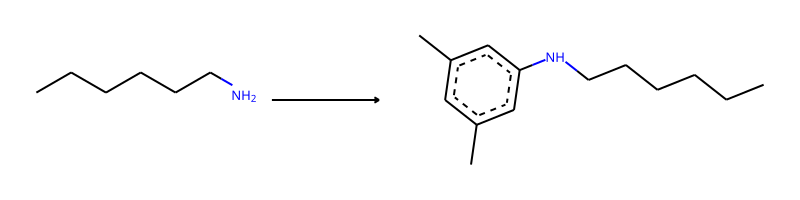

-> template: [C:2]-[NH2;D1;+0:1]>>C-c1:c:c(-C):c:c(-[NH;D2;+0:1]-[C:2]):c:1


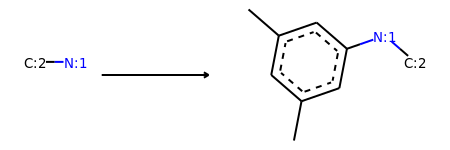

Product similarity 0.6923076923076923, overall 0.34615384615384615, smiles Cc1cc(C)cc(NC2(CC(C)O)CCC2)c1


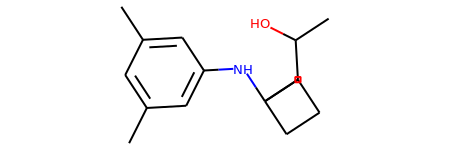

The proposed reaction is:


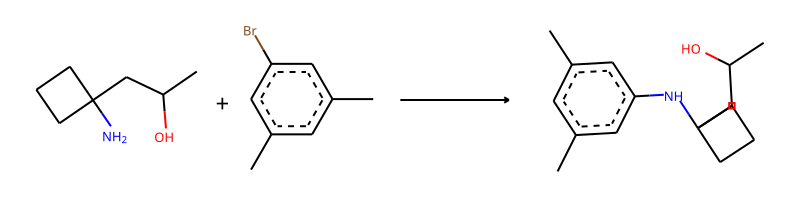

The reaction SMILES string is: CC(O)CC1(N)CCC1.Cc1cc(C)cc(Br)c1>>Cc1cc(C)cc(NC2(CC(C)O)CCC2)c1


--------------------------------------------------

Train index: 350388
RANK 63 PRECEDENT
REACTANT MATCH SCORE: 0.5


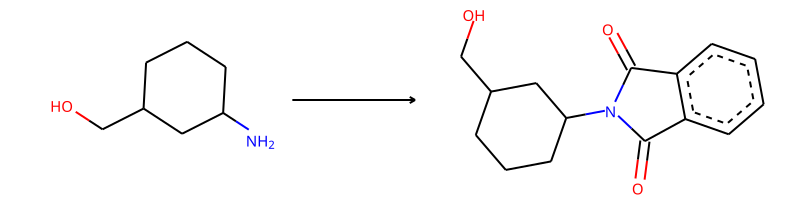

-> template: [C:2]-[NH2;D1;+0:1]>>O=C1-[N;H0;D3;+0:1](-[C:2])-C(=O)-c2:c:c:c:c:c:2-1


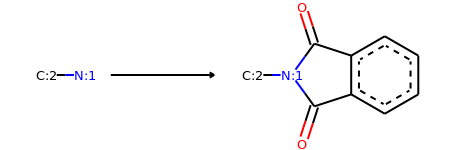

Product similarity 0.7096774193548387, overall 0.3548387096774194, smiles CC(O)CC1(N2C(=O)c3ccccc3C2=O)CCC1


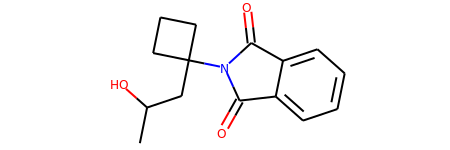

The proposed reaction is:


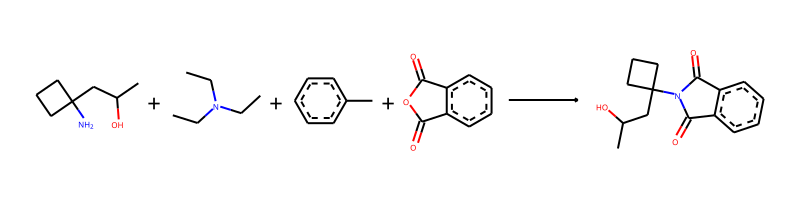

The reaction SMILES string is: CC(O)CC1(N)CCC1.CCN(CC)CC.Cc1ccccc1.O=C1OC(=O)c2ccccc21>>CC(O)CC1(N2C(=O)c3ccccc3C2=O)CCC1


--------------------------------------------------

Train index: 158798
RANK 64 PRECEDENT
REACTANT MATCH SCORE: 0.5


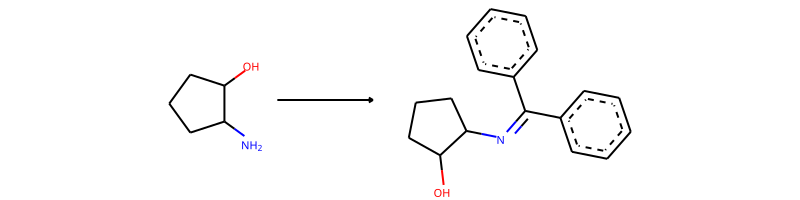

-> template: [C:1]-[NH2;D1;+0:2]>>[C:1]-[N;H0;D2;+0:2]=C(-c1:c:c:c:c:c:1)-c1:c:c:c:c:c:1


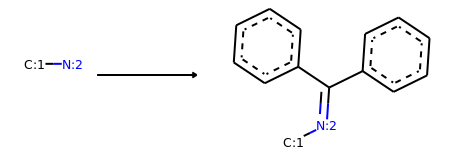

Product similarity 0.7681159420289855, overall 0.38405797101449274, smiles CC(O)CC1(N=C(c2ccccc2)c2ccccc2)CCC1


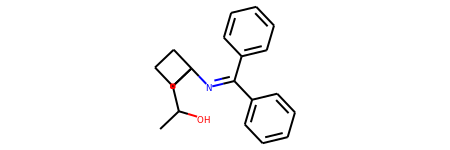

The proposed reaction is:


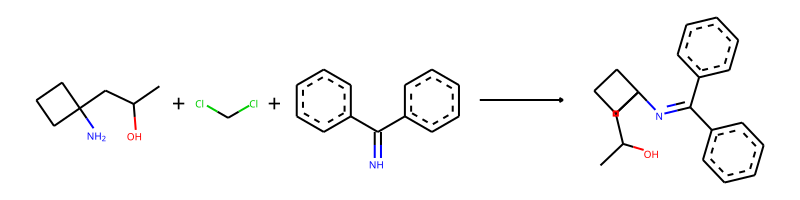

The reaction SMILES string is: CC(O)CC1(N)CCC1.ClCCl.N=C(c1ccccc1)c1ccccc1>>CC(O)CC1(N=C(c2ccccc2)c2ccccc2)CCC1


--------------------------------------------------

Train index: 196638
RANK 65 PRECEDENT
REACTANT MATCH SCORE: 0.5


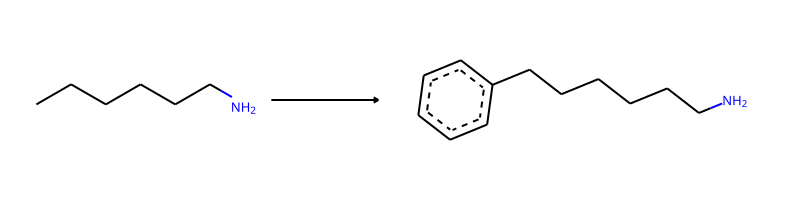

-> template: [C:1]-[CH3;D1;+0:2]>>[C:1]-[CH2;D2;+0:2]-c1:c:c:c:c:c:1


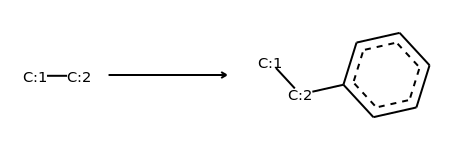

Product similarity 0.6666666666666666, overall 0.3333333333333333, smiles NC1(CC(O)Cc2ccccc2)CCC1


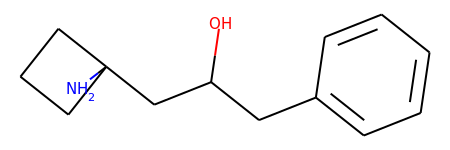

The proposed reaction is:


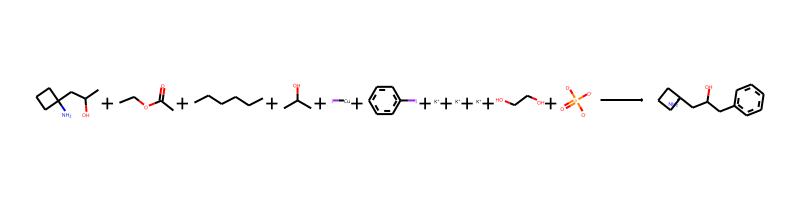

The reaction SMILES string is: CC(O)CC1(N)CCC1.CCOC(C)=O.CCCCCC.CC(C)O.[Cu]I.Ic1ccccc1.[K+].[K+].[K+].OCCO.O=P([O-])([O-])[O-]>>NC1(CC(O)Cc2ccccc2)CCC1


--------------------------------------------------

Train index: 121410
RANK 66 PRECEDENT
REACTANT MATCH SCORE: 0.5


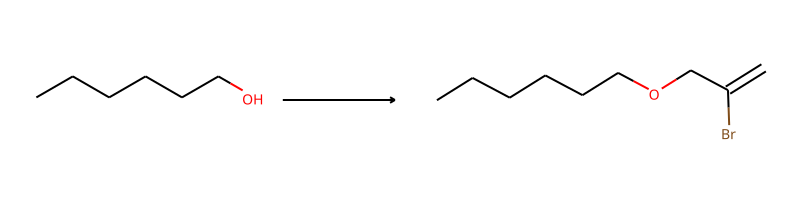

-> template: [C:2]-[OH;D1;+0:1]>>Br-C(=C)-C-[O;H0;D2;+0:1]-[C:2]


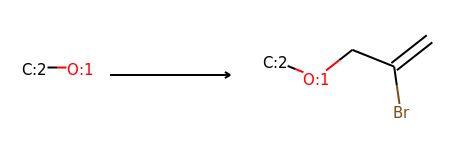

Product similarity 0.6, overall 0.3, smiles C=C(Br)COC(C)CC1(N)CCC1


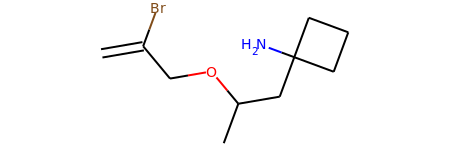

The proposed reaction is:


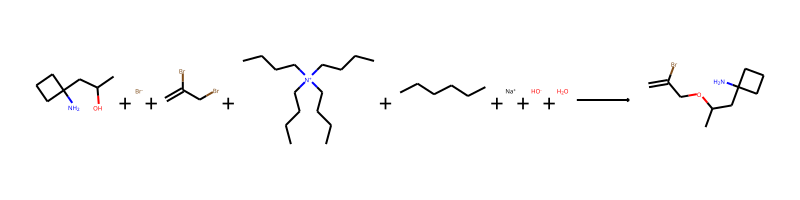

The reaction SMILES string is: CC(O)CC1(N)CCC1.[Br-].C=C(Br)CBr.CCCC[N+](CCCC)(CCCC)CCCC.CCCCCC.[Na+].[OH-].O>>C=C(Br)COC(C)CC1(N)CCC1


--------------------------------------------------

Train index: 40948
RANK 67 PRECEDENT
REACTANT MATCH SCORE: 0.5


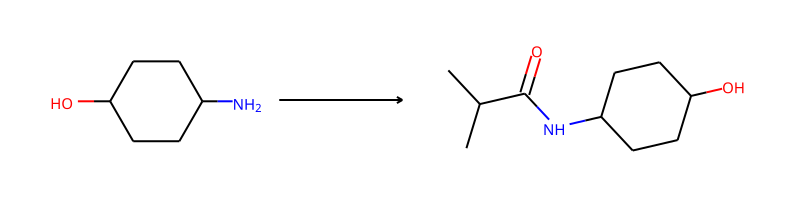

-> template: [C:2]-[NH2;D1;+0:1]>>C-C(-C)-C(=O)-[NH;D2;+0:1]-[C:2]


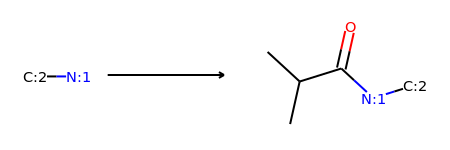

Product similarity 0.6136363636363636, overall 0.3068181818181818, smiles CC(O)CC1(NC(=O)C(C)C)CCC1


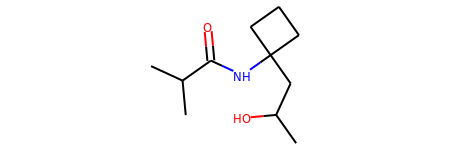

The proposed reaction is:


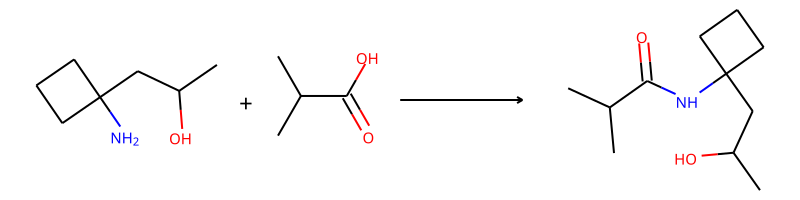

The reaction SMILES string is: CC(O)CC1(N)CCC1.CC(C)C(=O)O>>CC(O)CC1(NC(=O)C(C)C)CCC1


--------------------------------------------------

Train index: 320908
RANK 68 PRECEDENT
REACTANT MATCH SCORE: 0.5


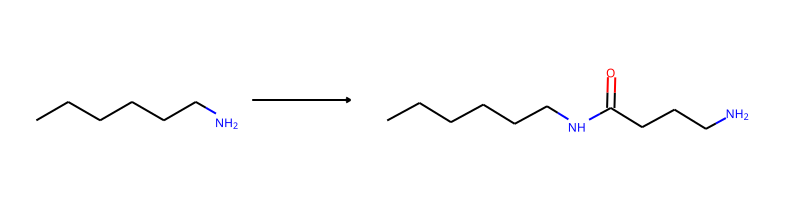

-> template: [C:2]-[NH2;D1;+0:1]>>N-C-C-C-C(=O)-[NH;D2;+0:1]-[C:2]


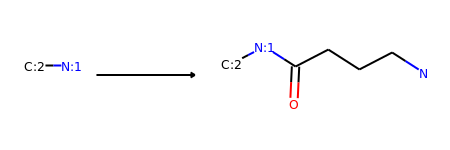

Product similarity 0.6521739130434783, overall 0.32608695652173914, smiles CC(O)CC1(NC(=O)CCCN)CCC1


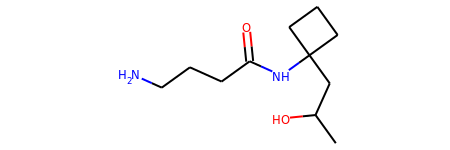

The proposed reaction is:


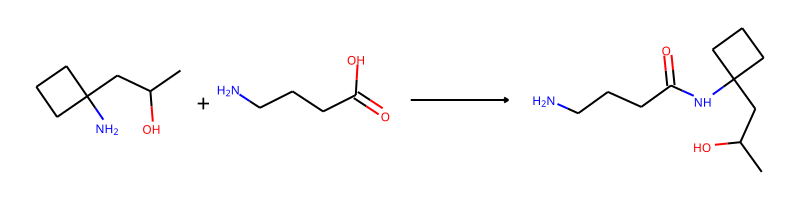

The reaction SMILES string is: CC(O)CC1(N)CCC1.NCCCC(=O)O>>CC(O)CC1(NC(=O)CCCN)CCC1


--------------------------------------------------

Train index: 351539
RANK 69 PRECEDENT
REACTANT MATCH SCORE: 0.5


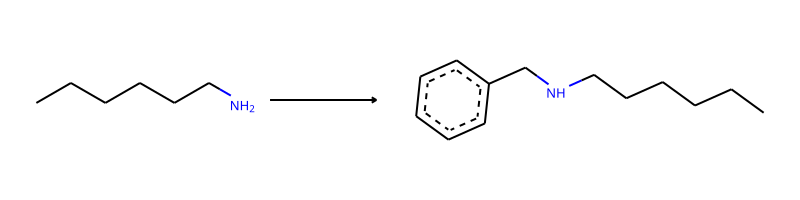

-> template: [C:1]-[NH2;D1;+0:2]>>[C:1]-[NH;D2;+0:2]-C-c1:c:c:c:c:c:1


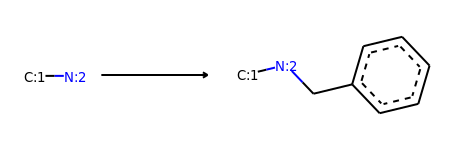

Product similarity 0.6862745098039216, overall 0.3431372549019608, smiles CC(O)CC1(NCc2ccccc2)CCC1


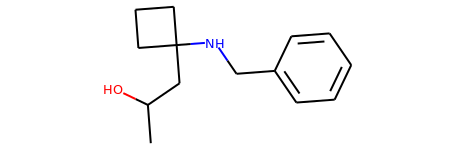

The proposed reaction is:


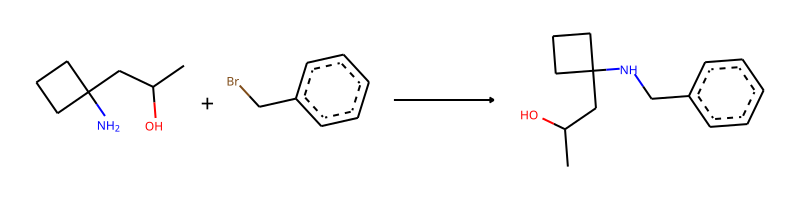

The reaction SMILES string is: CC(O)CC1(N)CCC1.BrCc1ccccc1>>CC(O)CC1(NCc2ccccc2)CCC1


--------------------------------------------------

Train index: 336380
RANK 70 PRECEDENT
REACTANT MATCH SCORE: 0.5


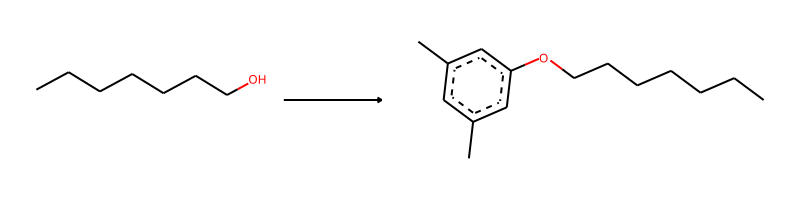

-> template: [C:2]-[OH;D1;+0:1]>>C-c1:c:c(-C):c:c(-[O;H0;D2;+0:1]-[C:2]):c:1


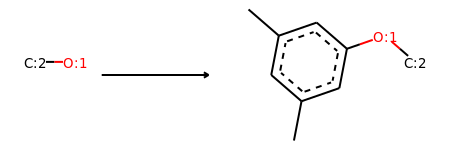

Product similarity 0.6851851851851852, overall 0.3425925925925926, smiles Cc1cc(C)cc(OC(C)CC2(N)CCC2)c1


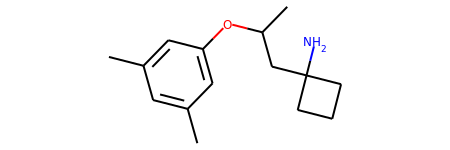

The proposed reaction is:


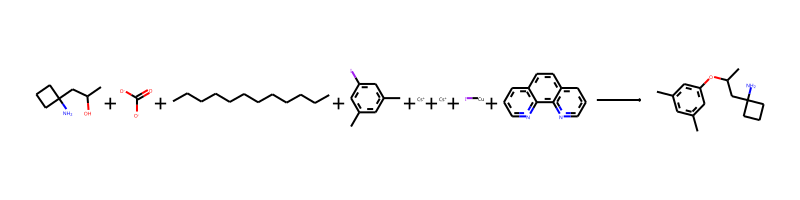

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C([O-])[O-].CCCCCCCCCCCC.Cc1cc(C)cc(I)c1.[Cs+].[Cs+].[Cu]I.c1cnc2c(c1)ccc1cccnc12>>Cc1cc(C)cc(OC(C)CC2(N)CCC2)c1


--------------------------------------------------

Train index: 101116
RANK 71 PRECEDENT
REACTANT MATCH SCORE: 0.5


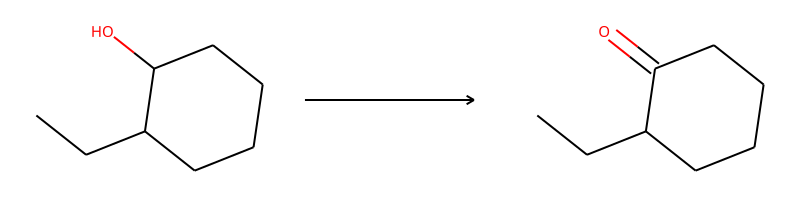

-> template: [C:1]-[CH;D3;+0:2](-[C:3])-[OH;D1;+0:4]>>[C:1]-[C;H0;D3;+0:2](-[C:3])=[O;H0;D1;+0:4]


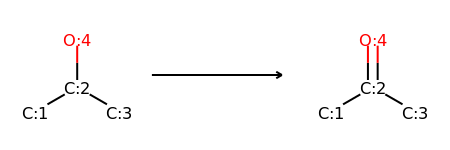

Product similarity 0.5, overall 0.25, smiles CC(=O)CC1(N)CCC1


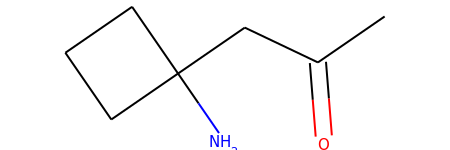

The proposed reaction is:


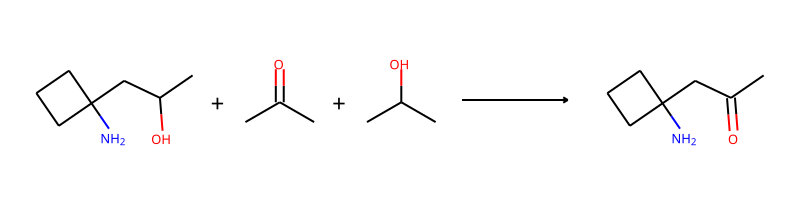

The reaction SMILES string is: CC(O)CC1(N)CCC1.CC(C)=O.CC(C)O>>CC(=O)CC1(N)CCC1


--------------------------------------------------

Train index: 250819
RANK 72 PRECEDENT
REACTANT MATCH SCORE: 0.5


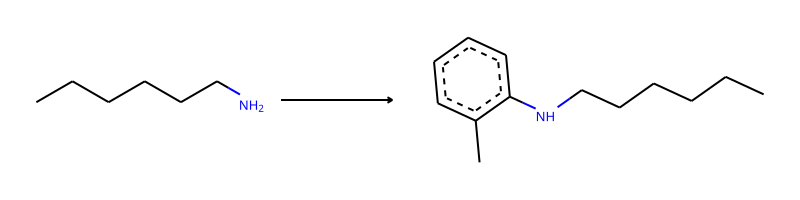

-> template: [C:2]-[NH2;D1;+0:1]>>C-c1:c:c:c:c:c:1-[NH;D2;+0:1]-[C:2]


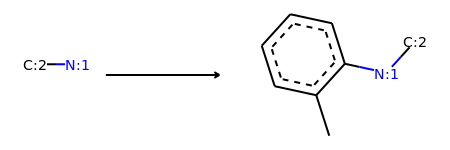

Product similarity 0.68, overall 0.34, smiles Cc1ccccc1NC1(CC(C)O)CCC1


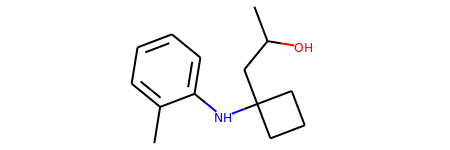

The proposed reaction is:


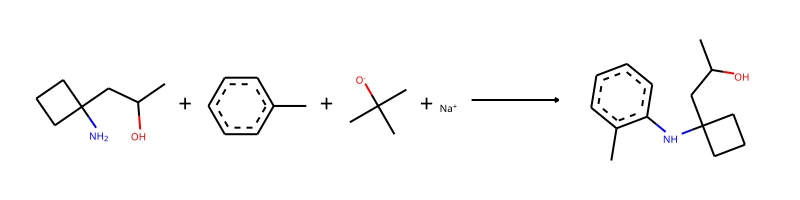

The reaction SMILES string is: CC(O)CC1(N)CCC1.Cc1ccccc1.CC(C)(C)[O-].[Na+]>>Cc1ccccc1NC1(CC(C)O)CCC1


--------------------------------------------------

Train index: 66804
RANK 73 PRECEDENT
REACTANT MATCH SCORE: 0.5


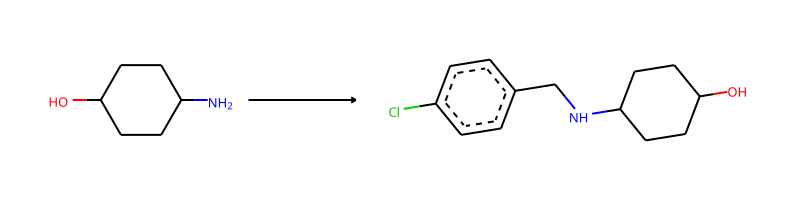

-> template: [C:2]-[NH2;D1;+0:1]>>Cl-c1:c:c:c(-C-[NH;D2;+0:1]-[C:2]):c:c:1


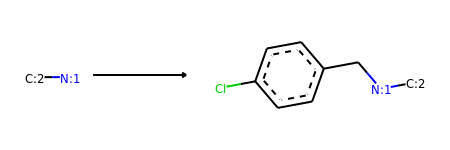

Product similarity 0.6909090909090909, overall 0.34545454545454546, smiles CC(O)CC1(NCc2ccc(Cl)cc2)CCC1


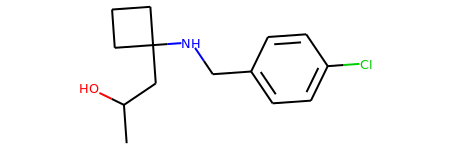

The proposed reaction is:


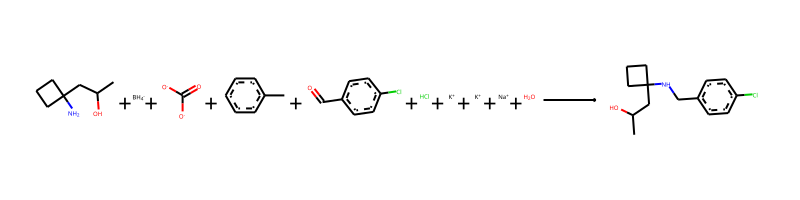

The reaction SMILES string is: CC(O)CC1(N)CCC1.[BH4-].O=C([O-])[O-].Cc1ccccc1.O=Cc1ccc(Cl)cc1.Cl.[K+].[K+].[Na+].O>>CC(O)CC1(NCc2ccc(Cl)cc2)CCC1


--------------------------------------------------

Train index: 383116
RANK 74 PRECEDENT
REACTANT MATCH SCORE: 0.5


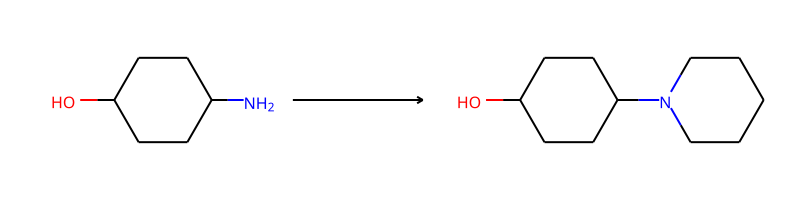

-> template: [C:1]-[NH2;D1;+0:2]>>[C:1]-[N;H0;D3;+0:2]1-C-C-C-C-C-1


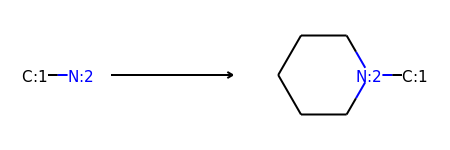

Product similarity 0.6382978723404256, overall 0.3191489361702128, smiles CC(O)CC1(N2CCCCC2)CCC1


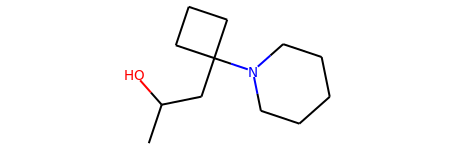

The proposed reaction is:


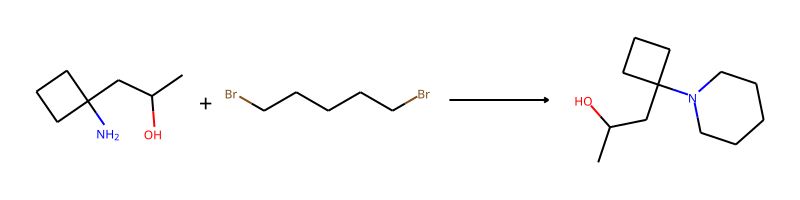

The reaction SMILES string is: CC(O)CC1(N)CCC1.BrCCCCCBr>>CC(O)CC1(N2CCCCC2)CCC1


--------------------------------------------------

Train index: 305205
RANK 75 PRECEDENT
REACTANT MATCH SCORE: 0.5


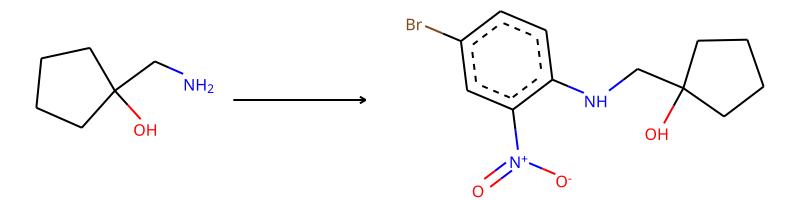

-> template: [C:2]-[NH2;D1;+0:1]>>Br-c1:c:c:c(-[NH;D2;+0:1]-[C:2]):c(-[N+](=O)-[O-]):c:1


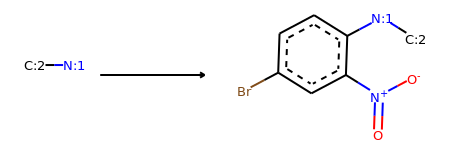

Product similarity 0.711864406779661, overall 0.3559322033898305, smiles CC(O)CC1(Nc2ccc(Br)cc2[N+](=O)[O-])CCC1


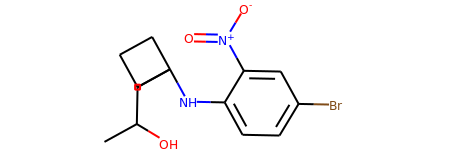

The proposed reaction is:


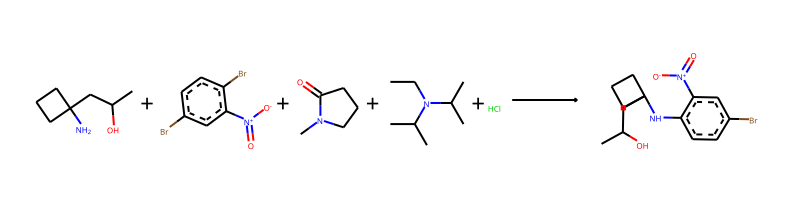

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=[N+]([O-])c1cc(Br)ccc1Br.CN1CCCC1=O.CCN(C(C)C)C(C)C.Cl>>CC(O)CC1(Nc2ccc(Br)cc2[N+](=O)[O-])CCC1


--------------------------------------------------

Train index: 49788
RANK 76 PRECEDENT
REACTANT MATCH SCORE: 0.5


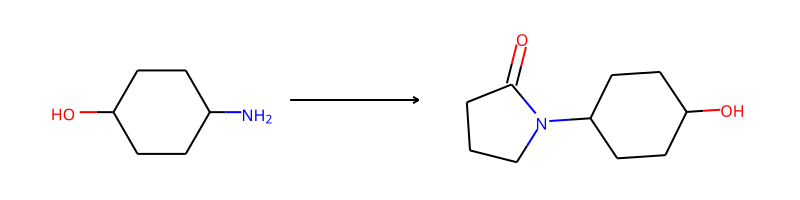

-> template: [C:2]-[NH2;D1;+0:1]>>O=C1-C-C-C-[N;H0;D3;+0:1]-1-[C:2]


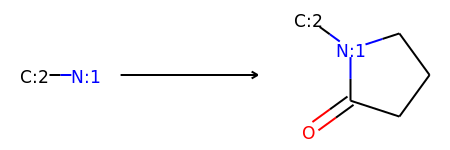

Product similarity 0.6304347826086957, overall 0.31521739130434784, smiles CC(O)CC1(N2CCCC2=O)CCC1


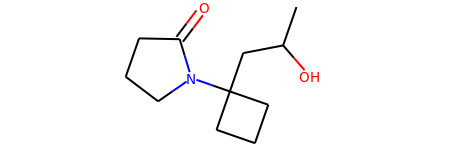

The proposed reaction is:


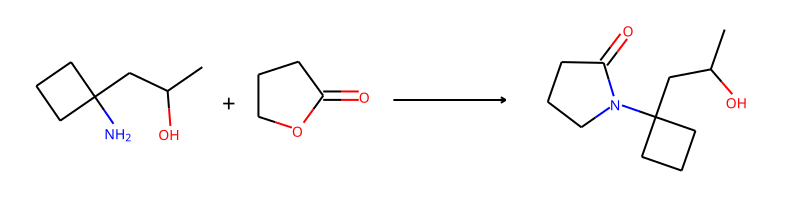

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C1CCCO1>>CC(O)CC1(N2CCCC2=O)CCC1


--------------------------------------------------

Train index: 324366
RANK 77 PRECEDENT
REACTANT MATCH SCORE: 0.5


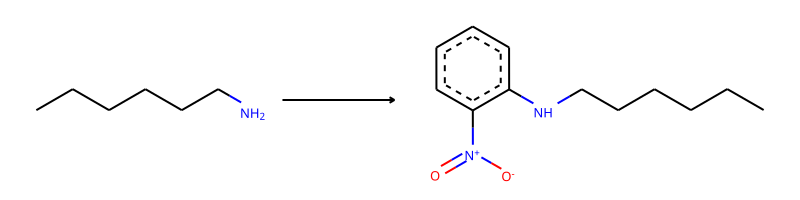

-> template: [C:2]-[NH2;D1;+0:1]>>O=[N+](-[O-])-c1:c:c:c:c:c:1-[NH;D2;+0:1]-[C:2]


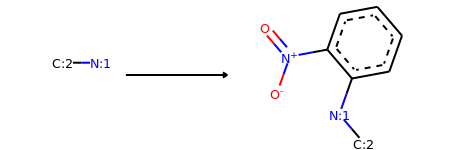

Product similarity 0.7090909090909091, overall 0.35454545454545455, smiles CC(O)CC1(Nc2ccccc2[N+](=O)[O-])CCC1


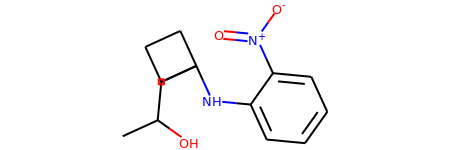

The proposed reaction is:


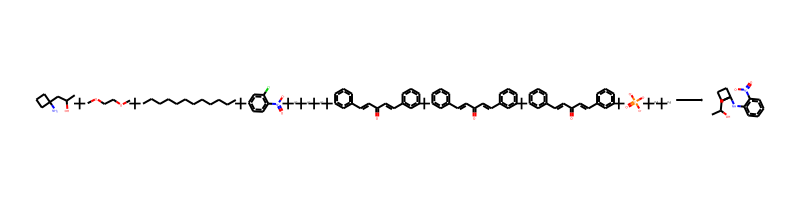

The reaction SMILES string is: CC(O)CC1(N)CCC1.COCCOC.CCCCCCCCCCCC.O=[N+]([O-])c1ccccc1Cl.[K+].[K+].[K+].O=C(C=Cc1ccccc1)C=Cc1ccccc1.O=C(C=Cc1ccccc1)C=Cc1ccccc1.O=C(C=Cc1ccccc1)C=Cc1ccccc1.O=P([O-])([O-])[O-].[Pd].[Pd]>>CC(O)CC1(Nc2ccccc2[N+](=O)[O-])CCC1


--------------------------------------------------

Train index: 238038
RANK 78 PRECEDENT
REACTANT MATCH SCORE: 0.5


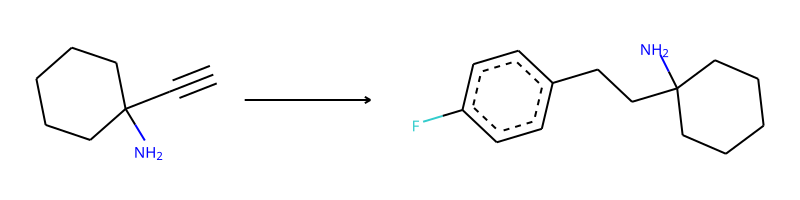

-> template: [C:3]-[C;H0;D2;+0:2]#[CH;D1;+0:1]>>F-c1:c:c:c(-[CH2;D2;+0:1]-[CH2;D2;+0:2]-[C:3]):c:c:1


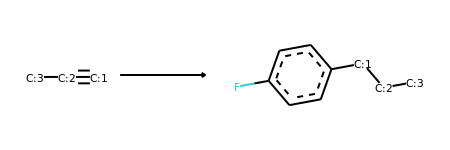

->No precursors could be generated!


--------------------------------------------------

Train index: 255617
RANK 79 PRECEDENT
REACTANT MATCH SCORE: 0.5


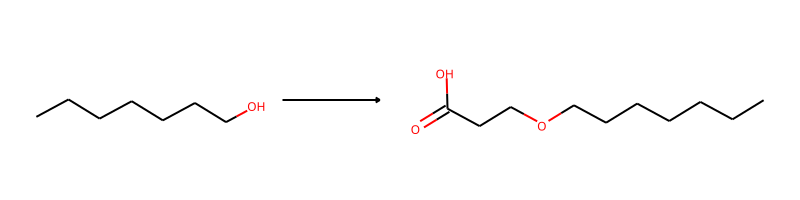

-> template: [C:2]-[OH;D1;+0:1]>>O-C(=O)-C-C-[O;H0;D2;+0:1]-[C:2]


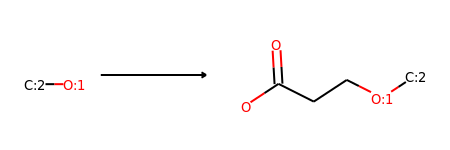

Product similarity 0.6222222222222222, overall 0.3111111111111111, smiles CC(CC1(N)CCC1)OCCC(=O)O


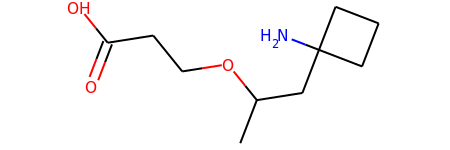

The proposed reaction is:


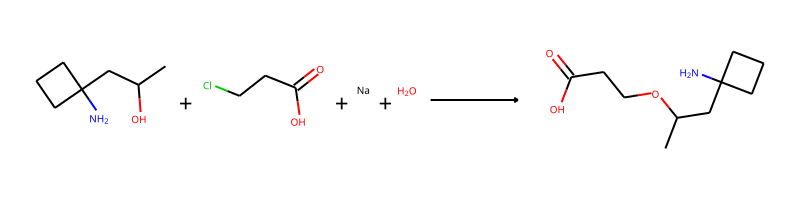

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C(O)CCCl.[Na].O>>CC(CC1(N)CCC1)OCCC(=O)O


--------------------------------------------------

Train index: 324359
RANK 80 PRECEDENT
REACTANT MATCH SCORE: 0.5


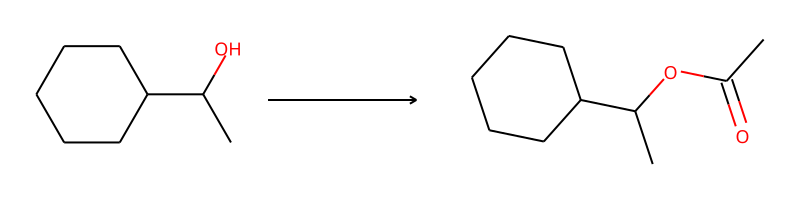

-> template: [C:2]-[OH;D1;+0:1]>>C-C(=O)-[O;H0;D2;+0:1]-[C:2]


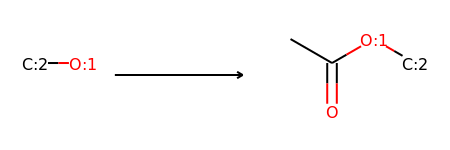

Product similarity 0.6, overall 0.3, smiles CC(=O)OC(C)CC1(N)CCC1


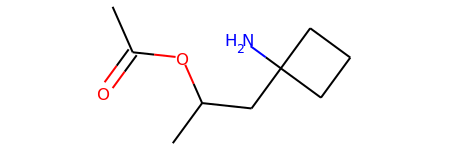

The proposed reaction is:


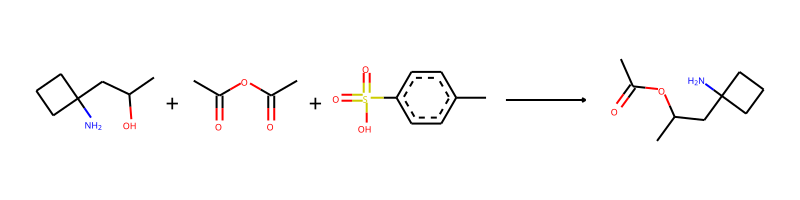

The reaction SMILES string is: CC(O)CC1(N)CCC1.CC(=O)OC(C)=O.Cc1ccc(S(=O)(=O)O)cc1>>CC(=O)OC(C)CC1(N)CCC1


--------------------------------------------------

Train index: 277682
RANK 81 PRECEDENT
REACTANT MATCH SCORE: 0.5


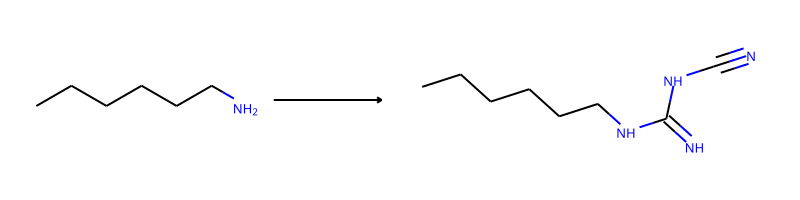

-> template: [C:2]-[NH2;D1;+0:1]>>N=C(-N-C#N)-[NH;D2;+0:1]-[C:2]


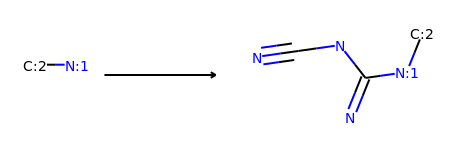

Product similarity 0.627906976744186, overall 0.313953488372093, smiles CC(O)CC1(NC(=N)NC#N)CCC1


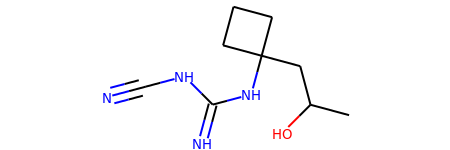

The proposed reaction is:


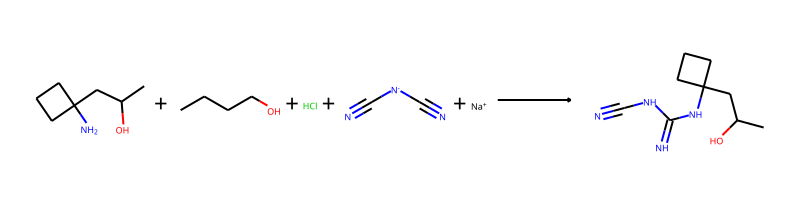

The reaction SMILES string is: CC(O)CC1(N)CCC1.CCCCO.Cl.N#C[N-]C#N.[Na+]>>CC(O)CC1(NC(=N)NC#N)CCC1


--------------------------------------------------

Train index: 209391
RANK 82 PRECEDENT
REACTANT MATCH SCORE: 0.5


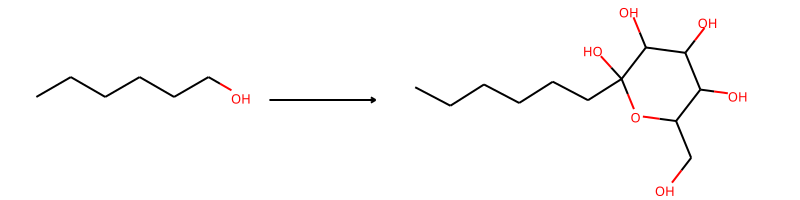

-> template: [C:2]-[CH2;D2;+0:1]-[O;H1;D1;+0]>>O-C-C1-O-C(-O)(-[CH2;D2;+0:1]-[C:2])-C(-O)-C(-O)-C-1-O


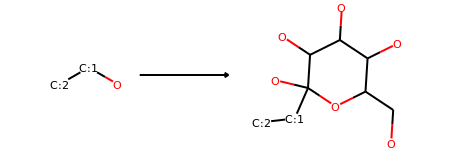

->No precursors could be generated!


--------------------------------------------------

Train index: 4943
RANK 83 PRECEDENT
REACTANT MATCH SCORE: 0.5


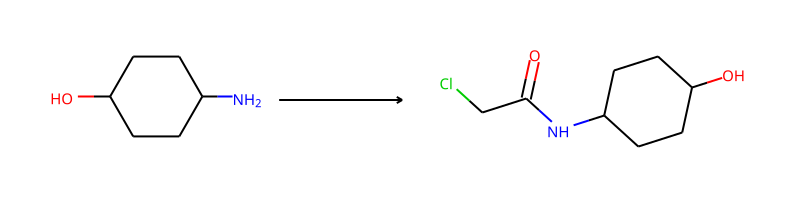

-> template: [C:2]-[NH2;D1;+0:1]>>Cl-C-C(=O)-[NH;D2;+0:1]-[C:2]


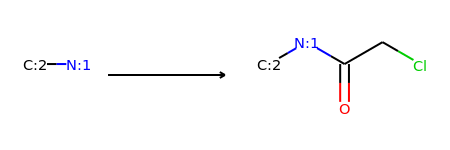

Product similarity 0.5952380952380952, overall 0.2976190476190476, smiles CC(O)CC1(NC(=O)CCl)CCC1


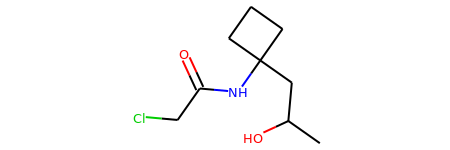

The proposed reaction is:


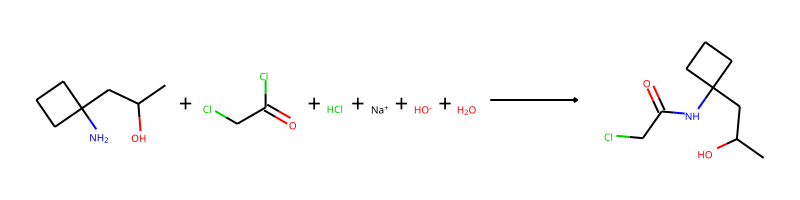

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C(Cl)CCl.Cl.[Na+].[OH-].O>>CC(O)CC1(NC(=O)CCl)CCC1


--------------------------------------------------

Train index: 32892
RANK 84 PRECEDENT
REACTANT MATCH SCORE: 0.5


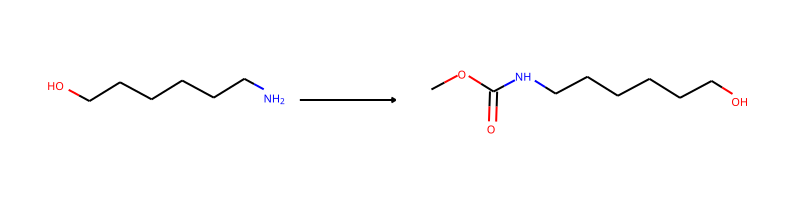

-> template: [C:2]-[NH2;D1;+0:1]>>C-O-C(=O)-[NH;D2;+0:1]-[C:2]


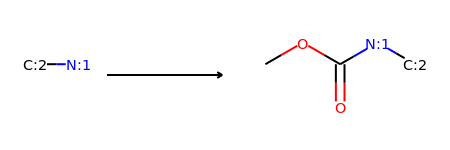

Product similarity 0.5952380952380952, overall 0.2976190476190476, smiles COC(=O)NC1(CC(C)O)CCC1


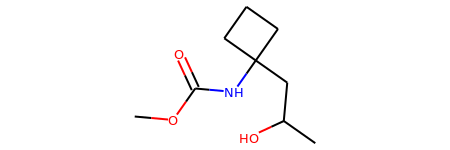

The proposed reaction is:


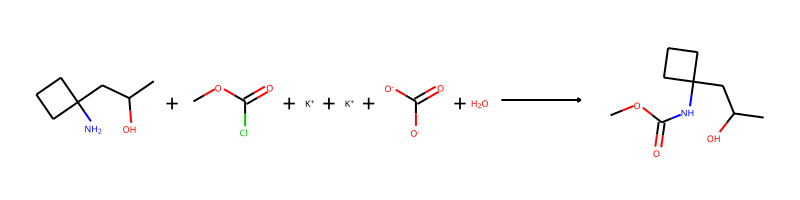

The reaction SMILES string is: CC(O)CC1(N)CCC1.COC(=O)Cl.[K+].[K+].O=C([O-])[O-].O>>COC(=O)NC1(CC(C)O)CCC1


--------------------------------------------------

Train index: 38080
RANK 85 PRECEDENT
REACTANT MATCH SCORE: 0.5


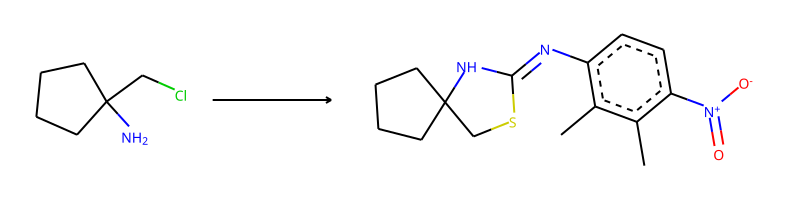

-> template: [Cl;H0;D1;+0]-[CH2;D2;+0:1]-[C:2]-[NH2;D1;+0:3]>>C-c1:c(-N=C2-S-[CH2;D2;+0:1]-[C:2]-[NH;D2;+0:3]-2):c:c:c(-[N+](=O)-[O-]):c:1-C


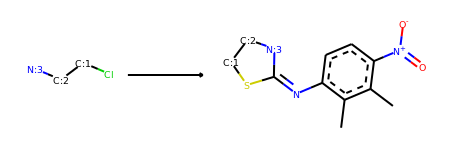

->No precursors could be generated!


--------------------------------------------------

Train index: 200244
RANK 86 PRECEDENT
REACTANT MATCH SCORE: 0.5


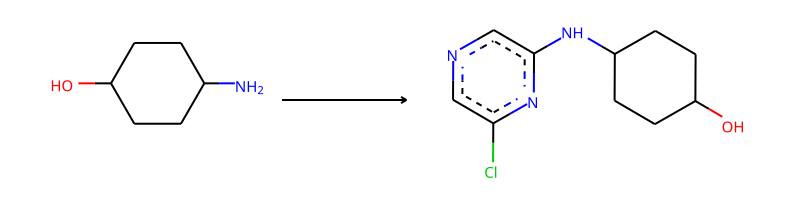

-> template: [C:2]-[NH2;D1;+0:1]>>Cl-c1:c:n:c:c(-[NH;D2;+0:1]-[C:2]):n:1


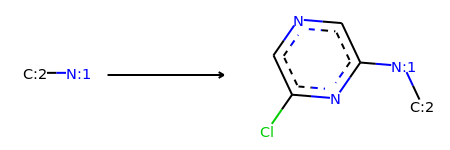

Product similarity 0.6730769230769231, overall 0.33653846153846156, smiles CC(O)CC1(Nc2cncc(Cl)n2)CCC1


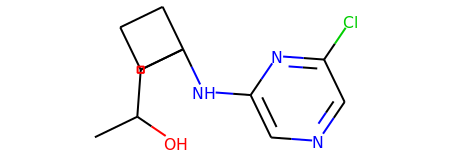

The proposed reaction is:


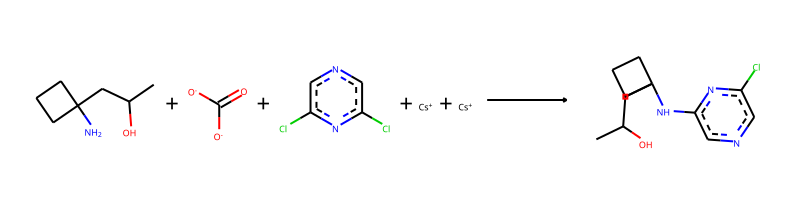

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C([O-])[O-].Clc1cncc(Cl)n1.[Cs+].[Cs+]>>CC(O)CC1(Nc2cncc(Cl)n2)CCC1


--------------------------------------------------

Train index: 90465
RANK 87 PRECEDENT
REACTANT MATCH SCORE: 0.5


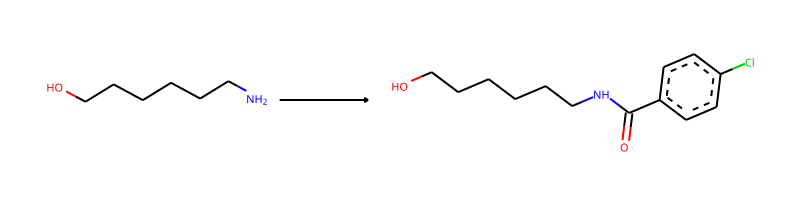

-> template: [C:2]-[NH2;D1;+0:1]>>Cl-c1:c:c:c(-C(=O)-[NH;D2;+0:1]-[C:2]):c:c:1


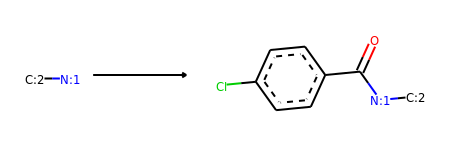

Product similarity 0.7017543859649122, overall 0.3508771929824561, smiles CC(O)CC1(NC(=O)c2ccc(Cl)cc2)CCC1


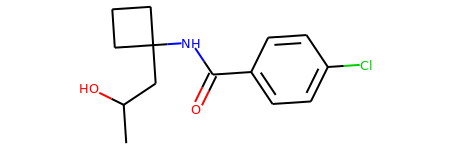

The proposed reaction is:


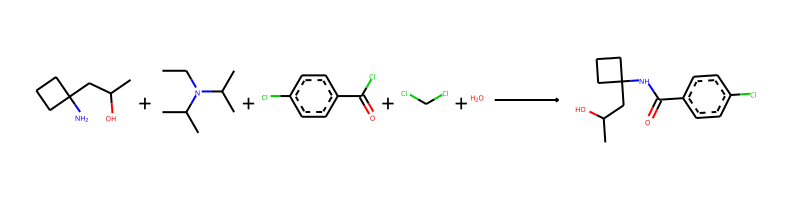

The reaction SMILES string is: CC(O)CC1(N)CCC1.CCN(C(C)C)C(C)C.O=C(Cl)c1ccc(Cl)cc1.ClCCl.O>>CC(O)CC1(NC(=O)c2ccc(Cl)cc2)CCC1


--------------------------------------------------

Train index: 25530
RANK 88 PRECEDENT
REACTANT MATCH SCORE: 0.5


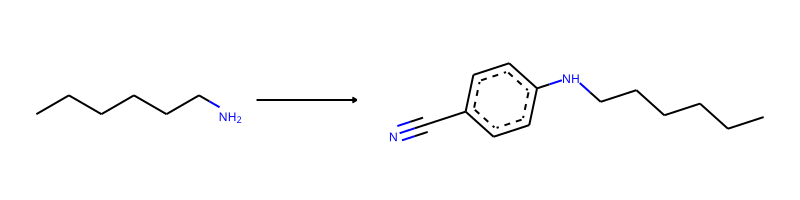

-> template: [C:2]-[NH2;D1;+0:1]>>N#C-c1:c:c:c(-[NH;D2;+0:1]-[C:2]):c:c:1


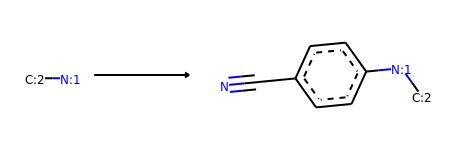

Product similarity 0.6981132075471698, overall 0.3490566037735849, smiles CC(O)CC1(Nc2ccc(C#N)cc2)CCC1


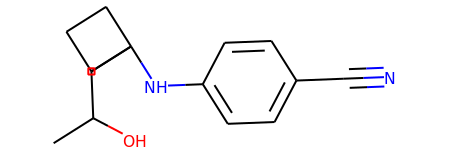

The proposed reaction is:


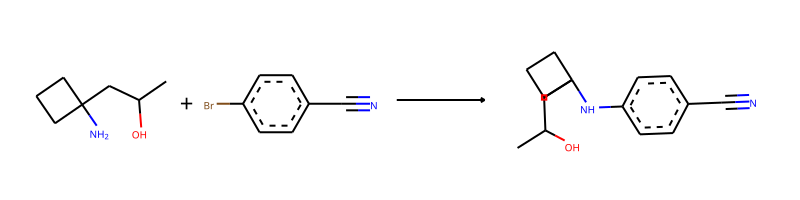

The reaction SMILES string is: CC(O)CC1(N)CCC1.N#Cc1ccc(Br)cc1>>CC(O)CC1(Nc2ccc(C#N)cc2)CCC1


--------------------------------------------------

Train index: 72066
RANK 89 PRECEDENT
REACTANT MATCH SCORE: 0.5


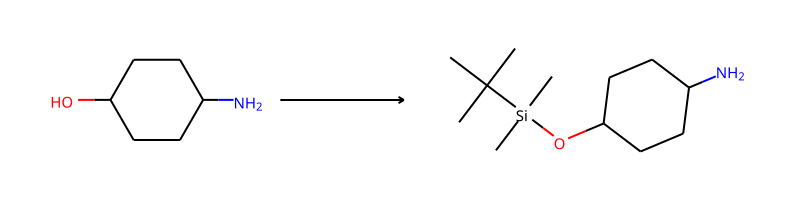

-> template: [C:2]-[OH;D1;+0:1]>>C-C(-C)(-C)-[Si](-C)(-C)-[O;H0;D2;+0:1]-[C:2]


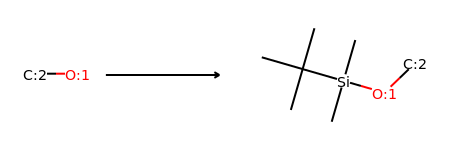

Product similarity 0.6808510638297872, overall 0.3404255319148936, smiles CC(CC1(N)CCC1)O[Si](C)(C)C(C)(C)C


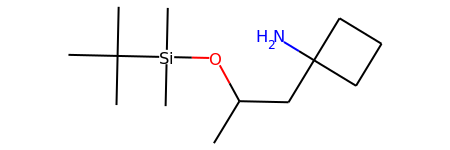

The proposed reaction is:


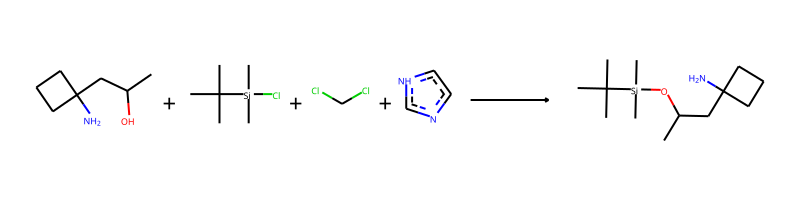

The reaction SMILES string is: CC(O)CC1(N)CCC1.CC(C)(C)[Si](C)(C)Cl.ClCCl.c1c[nH]cn1>>CC(CC1(N)CCC1)O[Si](C)(C)C(C)(C)C


--------------------------------------------------

Train index: 72118
RANK 90 PRECEDENT
REACTANT MATCH SCORE: 0.5


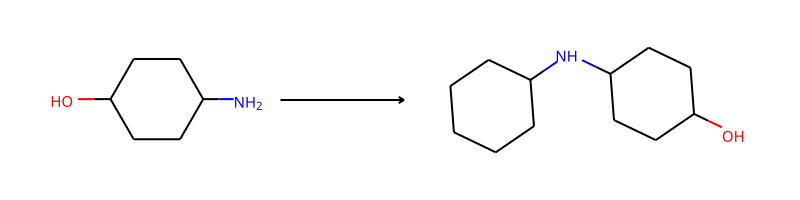

-> template: [C:1]-[NH2;D1;+0:2]>>[C:1]-[NH;D2;+0:2]-C1-C-C-C-C-C-1


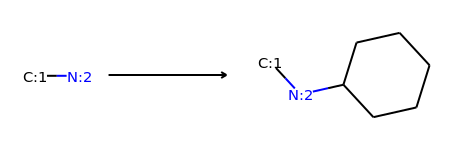

Product similarity 0.66, overall 0.33, smiles CC(O)CC1(NC2CCCCC2)CCC1


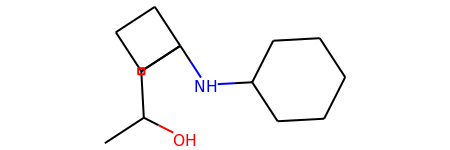

The proposed reaction is:


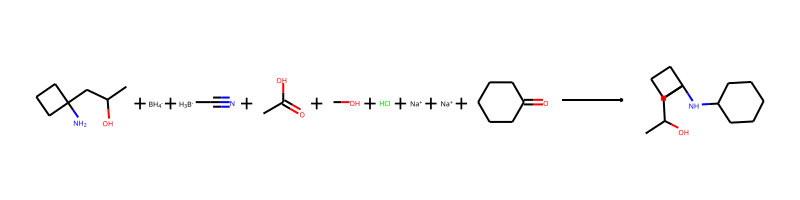

The reaction SMILES string is: CC(O)CC1(N)CCC1.[BH4-].[BH3-]C#N.CC(=O)O.CO.Cl.[Na+].[Na+].O=C1CCCCC1>>CC(O)CC1(NC2CCCCC2)CCC1


--------------------------------------------------

Train index: 167016
RANK 91 PRECEDENT
REACTANT MATCH SCORE: 0.5


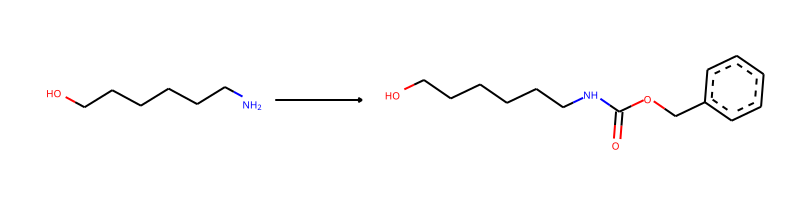

-> template: [C:2]-[NH2;D1;+0:1]>>O=C(-O-C-c1:c:c:c:c:c:1)-[NH;D2;+0:1]-[C:2]


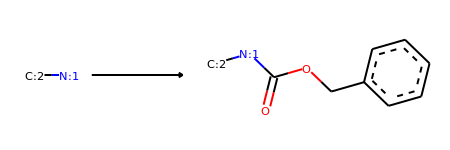

Product similarity 0.7213114754098361, overall 0.36065573770491804, smiles CC(O)CC1(NC(=O)OCc2ccccc2)CCC1


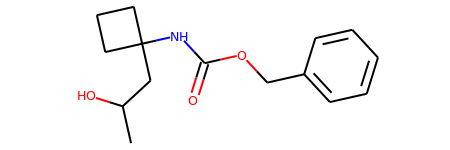

The proposed reaction is:


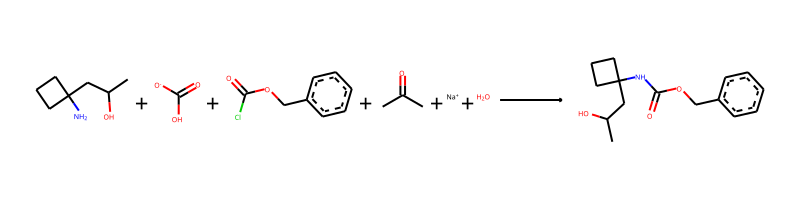

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C([O-])O.O=C(Cl)OCc1ccccc1.CC(C)=O.[Na+].O>>CC(O)CC1(NC(=O)OCc2ccccc2)CCC1


--------------------------------------------------

Train index: 204752
RANK 92 PRECEDENT
REACTANT MATCH SCORE: 0.5


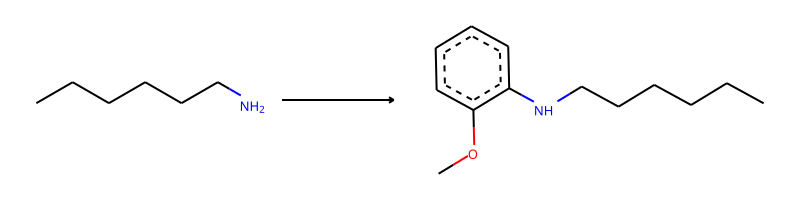

-> template: [C:2]-[NH2;D1;+0:1]>>C-O-c1:c:c:c:c:c:1-[NH;D2;+0:1]-[C:2]


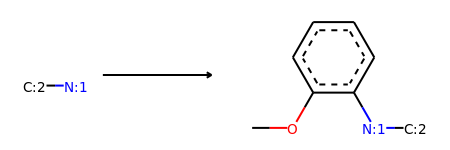

Product similarity 0.6981132075471698, overall 0.3490566037735849, smiles COc1ccccc1NC1(CC(C)O)CCC1


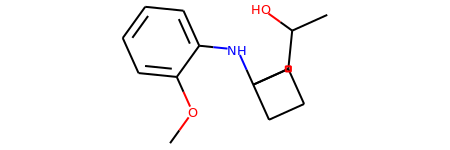

The proposed reaction is:


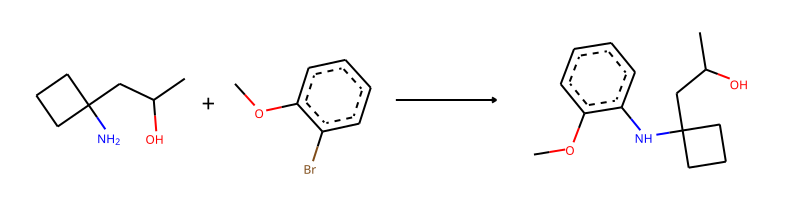

The reaction SMILES string is: CC(O)CC1(N)CCC1.COc1ccccc1Br>>COc1ccccc1NC1(CC(C)O)CCC1


--------------------------------------------------

Train index: 387206
RANK 93 PRECEDENT
REACTANT MATCH SCORE: 0.5


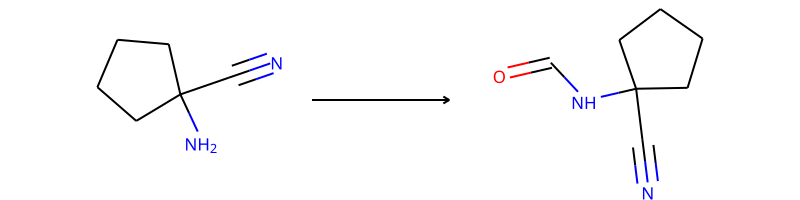

-> template: [C:2]-[NH2;D1;+0:1]>>O=C-[NH;D2;+0:1]-[C:2]


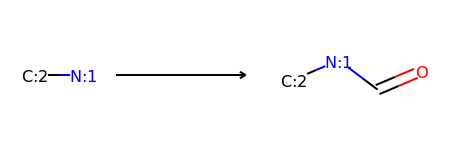

Product similarity 0.5833333333333334, overall 0.2916666666666667, smiles CC(O)CC1(NC=O)CCC1


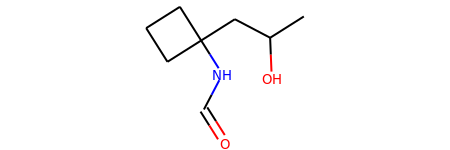

The proposed reaction is:


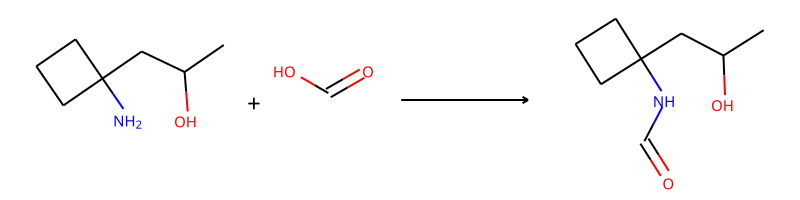

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=CO>>CC(O)CC1(NC=O)CCC1


--------------------------------------------------

Train index: 386694
RANK 94 PRECEDENT
REACTANT MATCH SCORE: 0.5


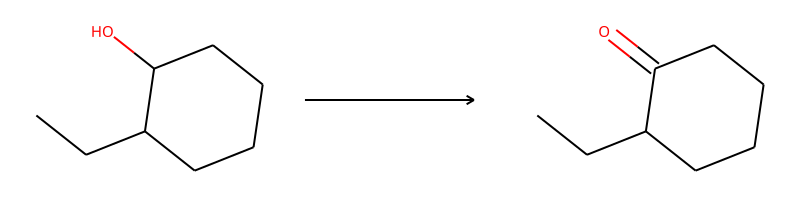

-> template: [C:1]-[CH;D3;+0:2](-[C:3])-[OH;D1;+0:4]>>[C:1]-[C;H0;D3;+0:2](-[C:3])=[O;H0;D1;+0:4]


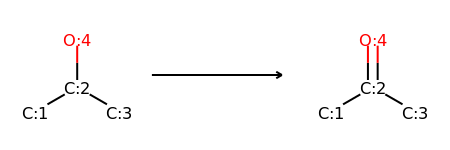

Product similarity 0.5, overall 0.25, smiles CC(=O)CC1(N)CCC1


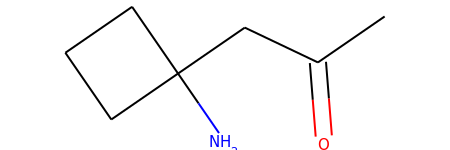

The proposed reaction is:


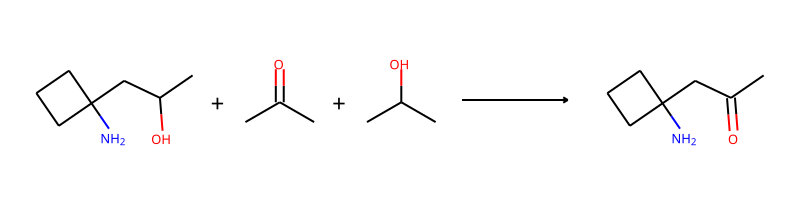

The reaction SMILES string is: CC(O)CC1(N)CCC1.CC(C)=O.CC(C)O>>CC(=O)CC1(N)CCC1


--------------------------------------------------

Train index: 428484
RANK 95 PRECEDENT
REACTANT MATCH SCORE: 0.5


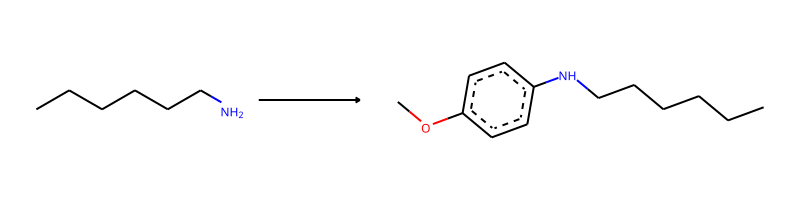

-> template: [C:2]-[NH2;D1;+0:1]>>C-O-c1:c:c:c(-[NH;D2;+0:1]-[C:2]):c:c:1


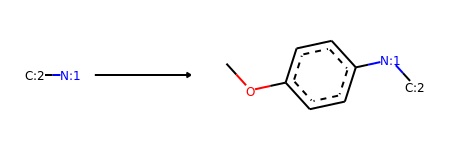

Product similarity 0.6981132075471698, overall 0.3490566037735849, smiles COc1ccc(NC2(CC(C)O)CCC2)cc1


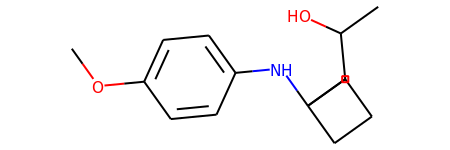

The proposed reaction is:


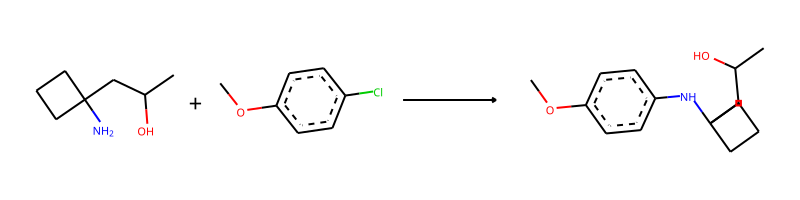

The reaction SMILES string is: CC(O)CC1(N)CCC1.COc1ccc(Cl)cc1>>COc1ccc(NC2(CC(C)O)CCC2)cc1


--------------------------------------------------

Train index: 332306
RANK 96 PRECEDENT
REACTANT MATCH SCORE: 0.5


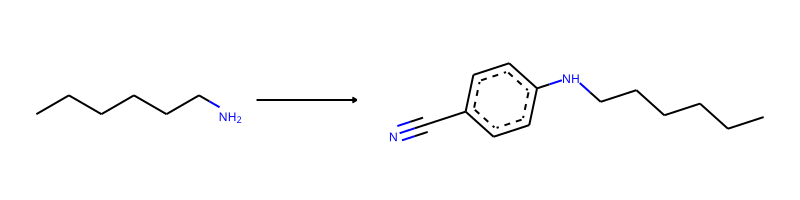

-> template: [C:2]-[NH2;D1;+0:1]>>N#C-c1:c:c:c(-[NH;D2;+0:1]-[C:2]):c:c:1


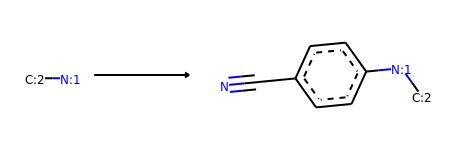

Product similarity 0.6981132075471698, overall 0.3490566037735849, smiles CC(O)CC1(Nc2ccc(C#N)cc2)CCC1


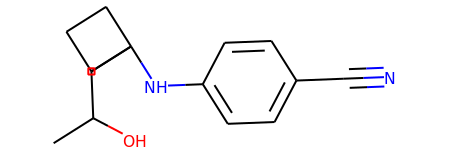

The proposed reaction is:


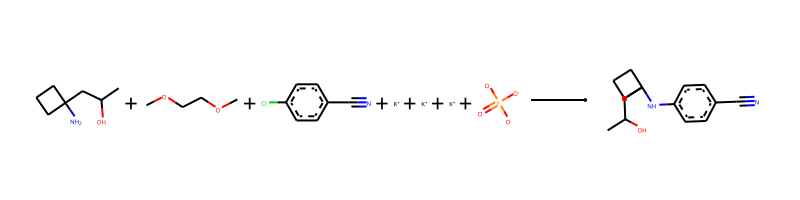

The reaction SMILES string is: CC(O)CC1(N)CCC1.COCCOC.N#Cc1ccc(Cl)cc1.[K+].[K+].[K+].O=P([O-])([O-])[O-]>>CC(O)CC1(Nc2ccc(C#N)cc2)CCC1


--------------------------------------------------

Train index: 29193
RANK 97 PRECEDENT
REACTANT MATCH SCORE: 0.5


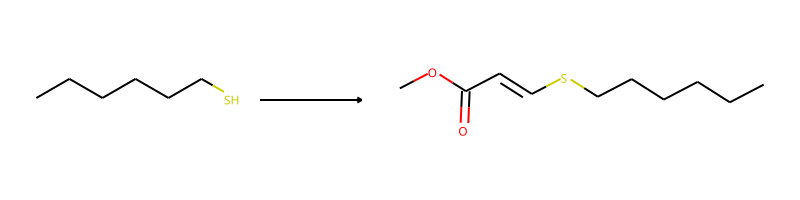

-> template: [C:2]-[SH;D1;+0:1]>>C-O-C(=O)-C=C-[S;H0;D2;+0:1]-[C:2]


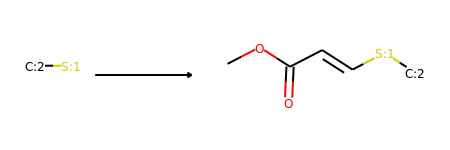

->No precursors could be generated!


--------------------------------------------------

Train index: 332862
RANK 98 PRECEDENT
REACTANT MATCH SCORE: 0.5


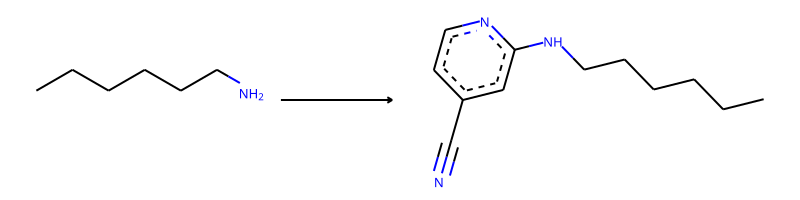

-> template: [C:2]-[NH2;D1;+0:1]>>N#C-c1:c:c:n:c(-[NH;D2;+0:1]-[C:2]):c:1


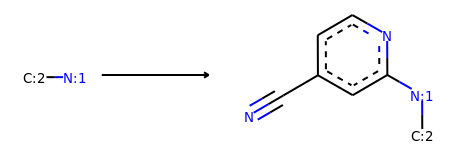

Product similarity 0.6981132075471698, overall 0.3490566037735849, smiles CC(O)CC1(Nc2cc(C#N)ccn2)CCC1


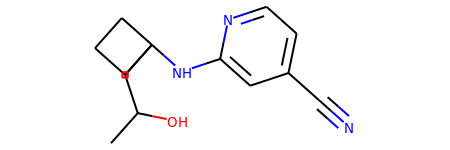

The proposed reaction is:


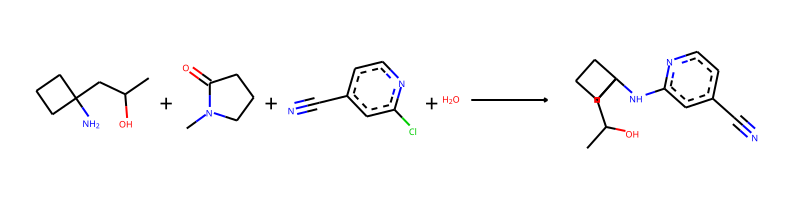

The reaction SMILES string is: CC(O)CC1(N)CCC1.CN1CCCC1=O.N#Cc1ccnc(Cl)c1.O>>CC(O)CC1(Nc2cc(C#N)ccn2)CCC1


--------------------------------------------------

Train index: 199866
RANK 99 PRECEDENT
REACTANT MATCH SCORE: 0.5


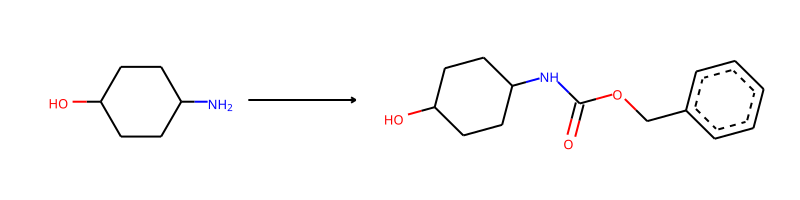

-> template: [C:2]-[NH2;D1;+0:1]>>O=C(-O-C-c1:c:c:c:c:c:1)-[NH;D2;+0:1]-[C:2]


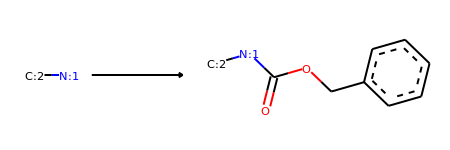

Product similarity 0.7213114754098361, overall 0.36065573770491804, smiles CC(O)CC1(NC(=O)OCc2ccccc2)CCC1


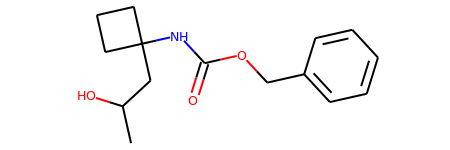

The proposed reaction is:


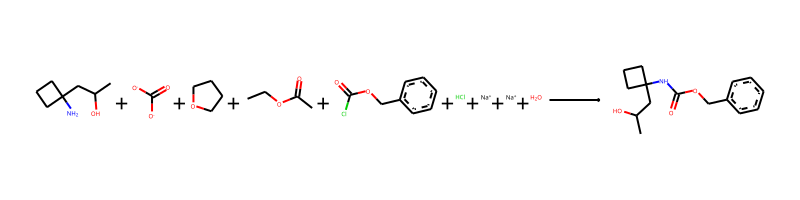

The reaction SMILES string is: CC(O)CC1(N)CCC1.O=C([O-])[O-].C1CCOC1.CCOC(C)=O.O=C(Cl)OCc1ccccc1.Cl.[Na+].[Na+].O>>CC(O)CC1(NC(=O)OCc2ccccc2)CCC1


--------------------------------------------------

Train index: 267312
RANK 100 PRECEDENT
REACTANT MATCH SCORE: 0.5


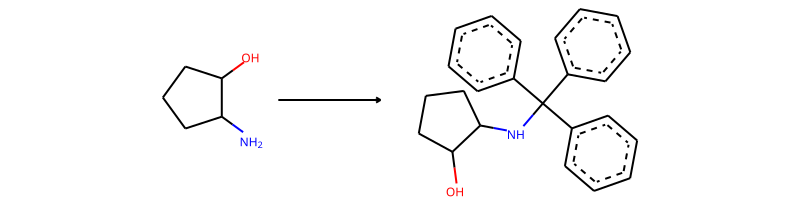

-> template: [C:1]-[NH2;D1;+0:2]>>[C:1]-[NH;D2;+0:2]-C(-c1:c:c:c:c:c:1)(-c1:c:c:c:c:c:1)-c1:c:c:c:c:c:1


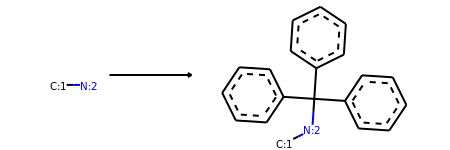

Product similarity 0.8160919540229885, overall 0.40804597701149425, smiles CC(O)CC1(NC(c2ccccc2)(c2ccccc2)c2ccccc2)CCC1


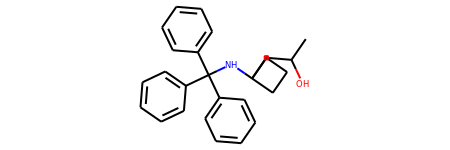

The proposed reaction is:


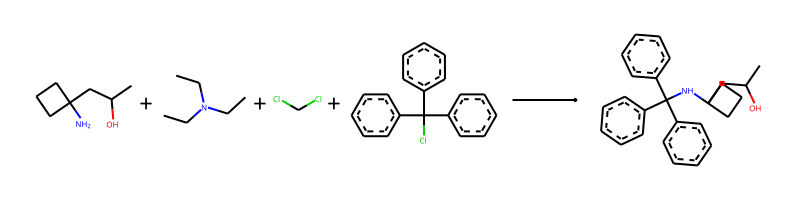

The reaction SMILES string is: CC(O)CC1(N)CCC1.CCN(CC)CC.ClCCl.ClC(c1ccccc1)(c1ccccc1)c1ccccc1>>CC(O)CC1(NC(c2ccccc2)(c2ccccc2)c2ccccc2)CCC1


In [18]:
do_one_v4_SMILES ('CC(O)CC1(N)CCC1')